In [1]:
import pandas as pd  
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.optimize as sco
import os
import plotly.graph_objects as go
from itertools import combinations
from sklearn.preprocessing import StandardScaler
from pathlib import Path

scaler = StandardScaler()

desired_path="/k_means_cluster_analysis/Results_without_sentiment/cluster_df_cl4/"

qtfilename="_qt_result.csv"

path = Path(os.getcwd())

dir1=path.parent.parent.parent.parent

final_path=str(dir1)+desired_path

## Efficient Frontier portfolio allocation technique.

In [2]:
def portfolio_annualised_performance(weights, mean_returns, cov_matrix, df_len):
    returns = np.sum(mean_returns*weights ) * df_len
    std = np.sqrt(np.dot(weights.T, np.dot(cov_matrix, weights))) * np.sqrt(df_len)
    return std, returns

def random_portfolios(num_portfolios, mean_returns, cov_matrix, risk_free_rate, stocks_len, df_len):
    results = np.zeros((3,num_portfolios))
    weights_record = []
    for i in range(num_portfolios):
        weights = np.random.random(stocks_len)
        weights /= np.sum(weights)
        weights_record.append(weights)
        portfolio_std_dev, portfolio_return_var = portfolio_annualised_performance(weights, mean_returns, cov_matrix, df_len)
        results[0,i] = portfolio_std_dev
        results[1,i] = portfolio_return_var
        results[2,i] = (portfolio_return_var - risk_free_rate) / portfolio_std_dev
        
    #max_sharpe = max(results[2])
    #for i in range(len(results[2])):
        #if results[2, i] == max_sharpe:
            #print("index {} and weights are {} max sharpe value {}".format(i, weights_record[i], max_sharpe))
            
    return results, weights_record

def pos_sharpe_ratio(weights, mean_returns, cov_matrix, risk_free_rate, df_len):
    p_var, p_ret = portfolio_annualised_performance(weights, mean_returns, cov_matrix, df_len)
    return (p_ret - risk_free_rate) / p_var

def neg_sharpe_ratio(weights, mean_returns, cov_matrix, risk_free_rate, df_len):
    p_var, p_ret = portfolio_annualised_performance(weights, mean_returns, cov_matrix, df_len)
    return -(p_ret - risk_free_rate) / p_var

def max_sharpe_ratio(mean_returns, cov_matrix, risk_free_rate, df_len):
    num_assets = len(mean_returns)
    args = (mean_returns, cov_matrix, risk_free_rate, df_len)
    constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})
    bound = (0.0,1.0)
    bounds = tuple(bound for asset in range(num_assets))
    result = sco.minimize(neg_sharpe_ratio, num_assets*[1./num_assets,], args=args,
                        method='SLSQP', bounds=bounds, constraints=constraints)
    return result

def portfolio_volatility(weights, mean_returns, cov_matrix, df_len): 
    return portfolio_annualised_performance(weights, mean_returns, cov_matrix, df_len)[0]

def min_variance(mean_returns, cov_matrix, df_len):
    num_assets = len(mean_returns)
    args = (mean_returns, cov_matrix, df_len)
    constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})
    bound = (0.0,1.0)
    bounds = tuple(bound for asset in range(num_assets))

    result = sco.minimize(portfolio_volatility, num_assets*[1./num_assets,], args=args,
                        method='SLSQP', bounds=bounds, constraints=constraints)

    return result

def efficient_return(mean_returns, cov_matrix, target, df_len):
    num_assets = len(mean_returns)
    args = (mean_returns, cov_matrix, df_len)
    
    def portfolio_return(weights, df_len):
        return portfolio_annualised_performance(weights, mean_returns, cov_matrix, df_len)[1]

    constraints = ({'type': 'eq', 'fun': lambda x: portfolio_return(x, df_len) - target},
                   {'type': 'eq', 'fun': lambda x: np.sum(x) - 1})
    bounds = tuple((0,1) for asset in range(num_assets))
    result = sco.minimize(portfolio_volatility, num_assets*[1./num_assets,], args=args, method='SLSQP', bounds=bounds, constraints=constraints)
    return result


def efficient_frontier(mean_returns, cov_matrix, returns_range, df_len):
    efficients = []
    for ret in returns_range:
        efficients.append(efficient_return(mean_returns, cov_matrix, ret, df_len))
    return efficients


def display_calculated_ef_with_random(mean_returns, cov_matrix, num_portfolios, risk_free_rate, table, stocks_len, df_len):
    results, _ = random_portfolios(num_portfolios,mean_returns, cov_matrix, risk_free_rate, stocks_len, df_len)
    #print("results == \n", max(results[2]))
    max_sharpe = max_sharpe_ratio(mean_returns, cov_matrix, risk_free_rate, df_len) 
    pos_sharpe = pos_sharpe_ratio(max_sharpe['x'], mean_returns, cov_matrix, risk_free_rate, df_len)
    #print("pos_sharpe == \n", pos_sharpe)
    
    sdp, rp = portfolio_annualised_performance(max_sharpe['x'], mean_returns, cov_matrix, df_len)
    max_sharpe_allocation = pd.DataFrame(max_sharpe.x,index=table.columns,columns=['allocation'])
    max_sharpe_allocation.allocation = [round(i*100,2)for i in max_sharpe_allocation.allocation]
    max_sharpe_allocation = max_sharpe_allocation.T
    max_sharpe_allocation

    min_vol = min_variance(mean_returns, cov_matrix, df_len)
    sdp_min, rp_min = portfolio_annualised_performance(min_vol['x'], mean_returns, cov_matrix, df_len)
    min_vol_allocation = pd.DataFrame(min_vol.x,index=table.columns,columns=['allocation'])
    min_vol_allocation.allocation = [round(i*100,2)for i in min_vol_allocation.allocation]
    min_vol_allocation = min_vol_allocation.T
    
    print("-"*80)
    print( "Maximum Sharpe Ratio Portfolio Allocation\n")
    print( "Annualised Return:", round(rp,2))
    print( "Annualised Volatility:", round(sdp,2))
    print ("\n")
    print (max_sharpe_allocation)
    print( "-"*80)
    print ("Minimum Volatility Portfolio Allocation\n")
    print( "Annualised Return:", round(rp_min,2))
    print( "Annualised Volatility:", round(sdp_min,2))
    print ("\n")
    print (min_vol_allocation)
    
    plt.figure(figsize=(10, 7))
    plt.scatter(results[0,:],results[1,:],c=results[2,:],cmap='YlGnBu', marker='o', s=10, alpha=0.3)
    plt.colorbar()
    plt.scatter(sdp,rp,marker='*',color='r',s=500, label='Maximum Sharpe ratio')
    plt.scatter(sdp_min,rp_min,marker='*',color='g',s=500, label='Minimum volatility')

    target = np.linspace(rp_min, 0.32, 50)
    efficient_portfolios = efficient_frontier(mean_returns, cov_matrix, target, df_len)
    plt.plot([p['fun'] for p in efficient_portfolios], target, linestyle='-.', color='black', label='efficient frontier')
    plt.title('Calculated Portfolio Optimization based on Efficient Frontier')
    plt.xlabel('annualised volatility')
    plt.ylabel('annualised returns')
    plt.legend(labelspacing=0.8)
    plt.show()
    return (pos_sharpe, round(rp,2), round(sdp,2), max_sharpe_allocation.values)


def display_ef_with_selected(mean_returns, cov_matrix, risk_free_rate,table, df_len):
    returns = table.pct_change()
    max_sharpe = max_sharpe_ratio(mean_returns, cov_matrix, risk_free_rate, df_len)
    #print("Max Sharpe ==\n", max_sharpe)
    sdp, rp = portfolio_annualised_performance(max_sharpe['x'], mean_returns, cov_matrix, df_len)
    max_sharpe_allocation = pd.DataFrame(max_sharpe.x,index=table.columns,columns=['allocation'])
    max_sharpe_allocation.allocation = [round(i*100,2)for i in max_sharpe_allocation.allocation]
    max_sharpe_allocation = max_sharpe_allocation.T
    max_sharpe_allocation
    

    min_vol = min_variance(mean_returns, cov_matrix, df_len)
    sdp_min, rp_min = portfolio_annualised_performance(min_vol['x'], mean_returns, cov_matrix, df_len)
    min_vol_allocation = pd.DataFrame(min_vol.x,index=table.columns,columns=['allocation'])
    min_vol_allocation.allocation = [round(i*100,2)for i in min_vol_allocation.allocation]
    min_vol_allocation = min_vol_allocation.T
    
    an_vol = np.std(returns) * np.sqrt(df_len)
    an_rt = mean_returns * df_len
    
    print ("-"*80)
    print ("Individual Stock Returns and Volatility\n")
    for i, txt in enumerate(table.columns):
        print (txt,":","annuaised return",round(an_rt[i],2),", annualised volatility:",round(an_vol[i],2))
    print ("-"*80)
    
    fig, ax = plt.subplots(figsize=(10, 7))
    ax.scatter(an_vol,an_rt,marker='o',s=200)

    for i, txt in enumerate(table.columns):
        ax.annotate(txt, (an_vol[i],an_rt[i]), xytext=(10,0), textcoords='offset points')
    ax.scatter(sdp,rp,marker='*',color='r',s=500, label='Maximum Sharpe ratio')
    ax.scatter(sdp_min,rp_min,marker='*',color='g',s=500, label='Minimum volatility')

    target = np.linspace(rp_min, 0.34, 50)
    efficient_portfolios = efficient_frontier(mean_returns, cov_matrix, target, df_len)
    ax.plot([p['fun'] for p in efficient_portfolios], target, linestyle='-.', color='black', label='efficient frontier')
    ax.set_title('Portfolio Optimization with Individual Stocks')
    ax.set_xlabel('annualised volatility')
    ax.set_ylabel('annualised returns')
    ax.legend(labelspacing=0.8)
    plt.show()

# display_calculated_ef_with_random(mean_returns, cov_matrix, num_portfolios, risk_free_rate)
# call this for different portfolios
# display_ef_with_selected(mean_returns, cov_matrix, risk_free_rate)
# call this for the companies selected for the portfolio

def efficient_frontier_stock_portfolio(stocks, stocks_len, risk_free_rate_in, start_date, end_date):
    data_temp = pd.read_csv('../../../../../Data-Acquisition/ohlcv-data/ohlcv.csv') 
    #print(data_temp)
    data_temp["time"] = pd.to_datetime(data_temp.time, format='%d/%m/%Y')
    start_date = pd.to_datetime(start_date)
    end_date = pd.to_datetime(end_date)
    data = data_temp[(data_temp["time"] >= start_date) & (data_temp["time"]< end_date)]
    #print(data)
    data["time"] = pd.to_datetime(data.time, format='%d/%m/%Y')
    data = data[['time','adjusted_close', 'symbol']]
    data = data.rename(columns={'time': 'date', 'adjusted_close': 'adj_close', 'symbol': 'ticker'})
    data = data[data['ticker'].isin(stocks)]
    #print(data)
    df_len = len(data.groupby("date"))
    #print("\nShape of the df {}, df len {}".format(df_len,data.shape))

    df = data.set_index('date')
    table = df.pivot(columns='ticker')
    # By specifying col[1] in below list comprehension
    # You can select the stock names under multi-level column
    table.columns = [col[1] for col in table.columns]
    table.head()

    plt.figure(figsize=(16, 9))
    for c in table.columns.values:
        plt.plot(table.index, table[c], lw=2, alpha=0.8,label=c)
    plt.legend(loc='upper right', fontsize=12)
    plt.ylabel('price in $')
    plt.title('Stocks Closing price in $')
    plt.show()

    returns = table.pct_change()
    plt.figure(figsize=(14, 7))
    for c in returns.columns.values:
        plt.plot(returns.index, returns[c], lw=3, alpha=0.8,label=c)
    plt.legend(loc='upper left', fontsize=12)
    plt.ylabel('daily returns')
    plt.title('Stocks Closing daily returns variation')
    plt.show()
    
    returns = table.pct_change()
    mean_returns = returns.mean()
    cov_matrix = returns.cov()
    num_portfolios = 25000
    risk_free_rate = 0.0095
    

    pos_sharpe, Annualised_Return, Annualised_Volatility, allocation_weights = display_calculated_ef_with_random(mean_returns, cov_matrix, num_portfolios, risk_free_rate, table, stocks_len, df_len)
    display_ef_with_selected(mean_returns, cov_matrix, risk_free_rate, table, df_len)
    
    return (pos_sharpe, Annualised_Return, Annualised_Volatility, allocation_weights)

In [3]:
def check_cor_cov_relation(covariance, correlation, mean_covariance, stocks):
    paired_stocks = np.zeros(covariance.shape)

    for i in range(len(stocks)):
        for j in range(len(stocks)-i):
            if(covariance[i,j] > mean_covariance[i] or covariance[i,j] > mean_covariance[j] or correlation[i][j]>0.5):
                paired_stocks[i,j] = 0
            else:
                paired_stocks[i,j] = 1

    return paired_stocks

In [4]:
def stocks_pair_lookup(stockspair, stocks_range_values, paired_stocks):
    nostockspair = []
    for i in stocks_range_values:
        if(i not in stockspair):
            nostockspair.append(i)
        else:
            continue
            
    for stock_ticker in nostockspair:
        cummulative_stockpair = len(stockspair)
        for i in stockspair:
            if(paired_stocks[stock_ticker,i]!=1 or paired_stocks[i,stock_ticker]!=1):
                cummulative_stockpair -= 1
        if(float(cummulative_stockpair)/len(stockspair) > 0.5):
            stockspair.add(stock_ticker)              
    return stockspair

In [5]:
def make_company_portfolios(stocks_combination, stocks_range, paired_stocks, portfolio_collection):  
    stockpair = set(stocks_combination)
    stockpair = stocks_pair_lookup(stockpair, stocks_range, paired_stocks)
    if stockpair not in portfolio_collection:
        portfolio_collection.append(stockpair)
    return portfolio_collection

In [6]:
def generate_portfolio_pairs(stocks):
    print(stocks)
    data = pd.read_csv('../../../../../Data-Acquisition/ohlcv-data/ohlcv.csv')  
    data["time"] = pd.to_datetime(data.time, format='%d/%m/%Y')
    data = data[['time','adjusted_close', 'symbol']]
    data = data.rename(columns={'time': 'date', 'adjusted_close': 'adj_close', 'symbol': 'ticker'})
    data = data[data['ticker'].isin(stocks)]

    df = data.set_index('date')
    table = df.pivot(columns='ticker')
    # By specifying col[1] in below list comprehension
    # You can select the stock names under multi-level column
    table.columns = [col[1] for col in table.columns]
    
    returns = table.pct_change()
    mean_returns = returns.mean()
    cov_matrix = returns.cov()
    correlation_matrix = returns.corr()
    np.round(correlation_matrix,3)
    mean_covariance = cov_matrix.mean()

    paired_stocks = check_cor_cov_relation(np.array(cov_matrix), np.array(correlation_matrix), mean_covariance, stocks)
    
    return paired_stocks

In [7]:
def get_portfolio_pairs(stocks):
    paired_stocks = generate_portfolio_pairs(stocks)
    stocks_range_values = range(len(stocks))
    count=0
    port_list = list(combinations(stocks_range_values,2))
    portfolio_collection = []
    for stocks_combination in port_list:
        count +=1
        if(paired_stocks[stocks_combination[0],stocks_combination[1]]!=1 or paired_stocks[stocks_combination[1],stocks_combination[0]]!=1):
            continue
        else:
            portfolio_collection = make_company_portfolios(stocks_combination, stocks_range_values, paired_stocks, portfolio_collection)

    company_name = []
    for i in portfolio_collection:
        company_name_list =[]
        for j in i:
            company_name_list.append(stocks[j])
        company_name.append(company_name_list)
    
        #print(company_name)
    
    return company_name

In [8]:
new_df = pd.DataFrame(columns=["symbol", "start_date", "sector"])
for i in range (1,9):
        df_read = pd.read_csv(final_path+str(i)+qtfilename)
        df_roc = df_read.groupby("label")["EMA"].max().reset_index()
        df_companies = pd.merge(left=df_roc, right=df_read, left_on='EMA', right_on='EMA').drop(["label_x"], axis=1)
        potential_comp = df_companies[["symbol", "start_date", "sector"]]
        new_df = new_df.append(potential_comp, ignore_index="true")

new_df.sort_values("start_date").to_csv("ohlcnews_stocks_subset1.csv")

In [9]:
new_df = pd.DataFrame(columns=["symbol", "start_date", "sector"])
for i in range (1,9):
        df_read = pd.read_csv(final_path+str(i)+qtfilename)
        df_roc = df_read.groupby("label")["ROC"].max().reset_index()
        df_companies = pd.merge(left=df_roc, right=df_read, left_on='ROC', right_on='ROC').drop(["label_x"], axis=1)
        potential_comp = df_companies[["symbol", "start_date", "sector"]]
        new_df = new_df.append(potential_comp, ignore_index="true")

new_df.sort_values("start_date").to_csv("ohlcnews_stocks_subset2.csv")

In [10]:
new_df = pd.DataFrame(columns=["symbol", "start_date", "sector"])
for i in range (1,9):
        df_read = pd.read_csv(final_path+str(i)+qtfilename)
        df_read = df_read[(df_read["RSI"] >= 30) | (df_read["RSI"] <= 70)]
        df_read = df_read[df_read["ROC"] > 0]
        df_roc = df_read.groupby("label")["ROC"].max().reset_index()
        df_companies = pd.merge(left=df_roc, right=df_read, left_on='ROC', right_on='ROC').drop(["label_x"], axis=1)
        potential_comp = df_companies[["symbol", "start_date", "sector"]]
        new_df = new_df.append(potential_comp, ignore_index="true")

new_df.sort_values("start_date").to_csv("ohlcnews_stocks_subset3.csv")

In [11]:
new_df = pd.DataFrame(columns=["symbol", "start_date", "sector"])
for i in range (1,9):
        df_read = pd.read_csv(final_path+str(i)+qtfilename)
        df_read = df_read[(df_read["RSI"] >= 30) | (df_read["RSI"] <= 70)]
        df_read = df_read[df_read["ROC"] > 0]
        df_roc = df_read.groupby("label")["EMA"].max().reset_index()
        #Inner join on the values to identify the stock with max EMA for the cluster.
        df_companies = pd.merge(left=df_roc, right=df_read, left_on='EMA', right_on='EMA').drop(["label_x"], axis=1)
        potential_comp = df_companies[["symbol", "start_date", "sector"]]
        new_df = new_df.append(potential_comp, ignore_index="true")

new_df.sort_values("start_date").to_csv("ohlcnews_stocks_subset4.csv")

In [12]:
new_df = pd.DataFrame(columns=["symbol", "start_date", "sector"])
for i in range (1,9):
        df_read = pd.read_csv(final_path+str(i)+qtfilename)
        df_read = df_read[(df_read["RSI"] >= 30) | (df_read["RSI"] <= 70)]
        #having a +ve ROC ensures "risk" of losing out on profit is taken into consideration.
        df_read = df_read[df_read["ROC"] > 0]
        #higher value of ATR says that the volitility is more.
        #high value of the ATR and positive ROC indicates that the stock is on increasing trend and also return can be higher.
        df_roc = df_read.groupby("label")["ATR"].max().reset_index()
        #Inner join on the values to identify the stock with max EMA for the cluster.
        df_companies = pd.merge(left=df_roc, right=df_read, left_on='ATR', right_on='ATR').drop(["label_x"], axis=1)
        potential_comp = df_companies[["symbol", "start_date", "sector"]]
        new_df = new_df.append(potential_comp, ignore_index="true")

new_df.sort_values("start_date").to_csv("ohlcnews_stocks_subset5.csv")

In [13]:
new_df = pd.DataFrame(columns=["symbol", "start_date", "sector"])
for filename in os.listdir():
    if filename.startswith("ohlcnews_stocks"):
        df_read = pd.read_csv(filename)
        #combine all the stocks taken into a dataframe and take the unique set from it to arrive 
        #at your stock portfolio.
        new_df = new_df.append(df_read, ignore_index="true")
        
portfolio_list = new_df["symbol"].unique()
print("These are the best stocks to be from among the 200 companies for the 2 year period data")
print("using the linear methods of stock portfolio creation:")
print(portfolio_list)

These are the best stocks to be from among the 200 companies for the 2 year period data
using the linear methods of stock portfolio creation:
['EQIX' 'AMZN' 'AZO' 'AMD' 'CMG' 'BKNG' 'AAP' 'BA' 'BLK' 'AMGN' 'AAPL'
 'BIIB' 'ALGN' 'ANTM' 'SHW' 'STZ' 'ECL' 'ADSK' 'DVN' 'AYI' 'BHF' 'NEM'
 'COTY' 'FCX' 'DISCK' 'APC' 'DHI' 'ALXN' 'GOOGL' 'CTXS' 'BAC' 'BXP' 'GOOG'
 'HST' 'BMY' 'PPG']


/home/abhishek/anaconda3/anaconda/lib/python3.7/site-packages/pandas/core/frame.py:7138: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.




In [14]:
quarter_list=["2018-04-01", "2018-07-01", "2018-10-01", "2019-01-01", "2019-04-01", "2019-07-01", "2019-10-01", "2020-01-01", "2020-04-01"]

for idx in range(1, len(quarter_list)):
    df_quarter_data = new_df[(new_df["start_date"] >= quarter_list[idx-1]) & (new_df["start_date"]< quarter_list[idx])]
    print("Companies listed in quarter {} which is between {} and {}".format(idx, quarter_list[idx-1], quarter_list[idx]))
    list_of_companies = df_quarter_data["symbol"].unique()
    df_read = pd.read_csv(final_path+str(idx)+qtfilename)
    df_unscaled = df_read.copy()
    df_unscaled_required = df_unscaled[["RSI", "ROC", "ADOSC", "ATR", "EMA", "Sharpe_ratio"]]
    df_read_scaled = pd.DataFrame(scaler.fit_transform(df_unscaled_required))
    df_read_scaled.columns = list(df_unscaled_required)
    df_read_scaled["symbol"] = df_unscaled["symbol"]
    rsi_list = []
    roc_list = []
    adosc_list = []
    atr_list = []
    ema_list = []
    sharpe_list = []
    avgret_list = []
    wt_senti_list = []
    for comp in list_of_companies:
        df_comp = df_read_scaled[df_read_scaled["symbol"] == comp]
        rsi_list.append(df_comp["RSI"].values[0])
        roc_list.append(df_comp["ROC"].values[0])
        adosc_list.append(df_comp["ADOSC"].values[0])
        atr_list.append(df_comp["ATR"].values[0])
        ema_list.append(df_comp["EMA"].values[0])
        sharpe_list.append(df_comp["Sharpe_ratio"].values[0])
    
    fig = go.Figure(data=[
        go.Bar(name='RSI', x=list_of_companies, y=rsi_list),
        go.Bar(name='ROC', x=list_of_companies, y=roc_list),
        go.Bar(name='ADOSC', x=list_of_companies, y=adosc_list),
        go.Bar(name='ATR', x=list_of_companies, y=atr_list),
        go.Bar(name='EMA', x=list_of_companies, y=ema_list),
        go.Bar(name='Sharpe_ratio', x=list_of_companies, y=sharpe_list)
    ])
    fig.update_layout(
    barmode='group',
    title="Feature distribution for the comapnies selected in the quarter",
    xaxis_title="Company names",
    yaxis_title="Scaled values of the features",
    font=dict(
        family="Courier New, monospace",
        size=12,
        color="#7f7f7f"
    ))
        
    fig.show()

Companies listed in quarter 1 which is between 2018-04-01 and 2018-07-01


Companies listed in quarter 2 which is between 2018-07-01 and 2018-10-01


Companies listed in quarter 3 which is between 2018-10-01 and 2019-01-01


Companies listed in quarter 4 which is between 2019-01-01 and 2019-04-01


Companies listed in quarter 5 which is between 2019-04-01 and 2019-07-01


Companies listed in quarter 6 which is between 2019-07-01 and 2019-10-01


Companies listed in quarter 7 which is between 2019-10-01 and 2020-01-01


Companies listed in quarter 8 which is between 2020-01-01 and 2020-04-01


Companies listed in quarter 1 which is between 2018-04-01 and 2018-07-01
['EQIX' 'AMZN' 'AZO' 'AMD' 'BLK' 'BKNG' 'ADSK' 'DVN']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AMD']


/home/abhishek/anaconda3/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/abhishek/anaconda3/anaconda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/converter.py:103: FutureWarning:

Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()



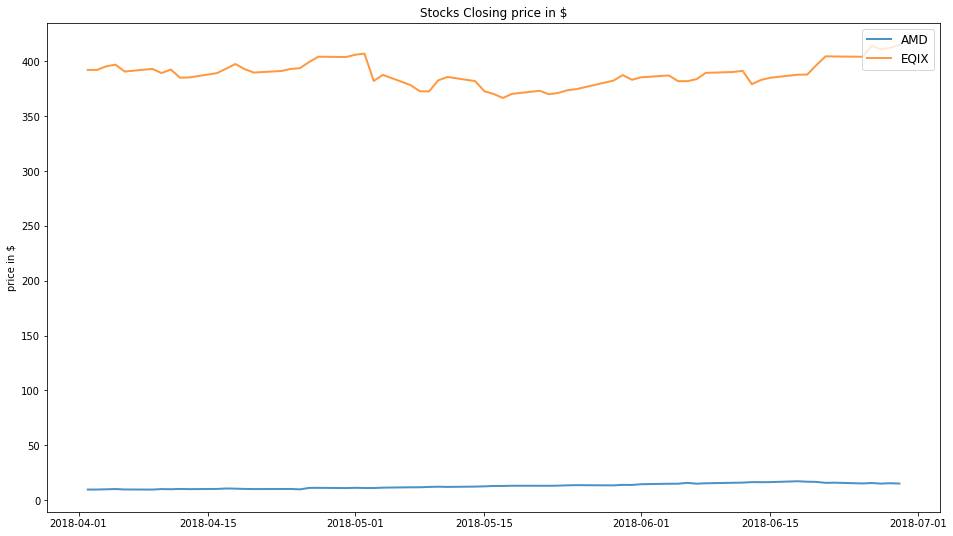

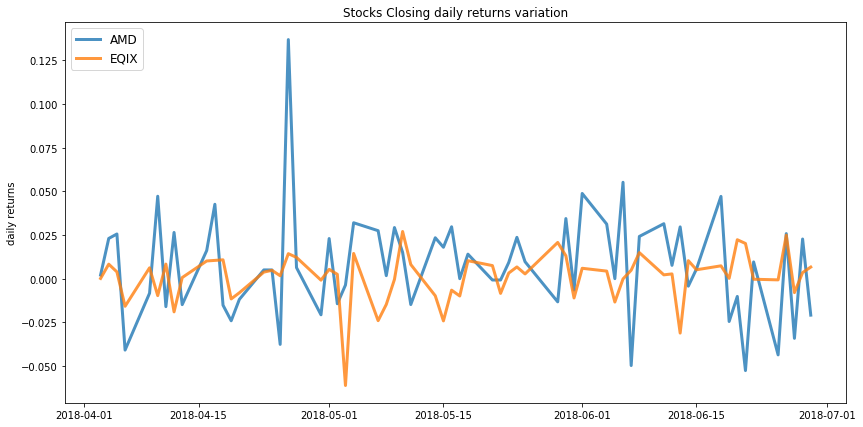

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.38
Annualised Volatility: 0.18


              AMD   EQIX
allocation  73.06  26.94
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.13
Annualised Volatility: 0.11


             AMD  EQIX
allocation  16.3  83.7


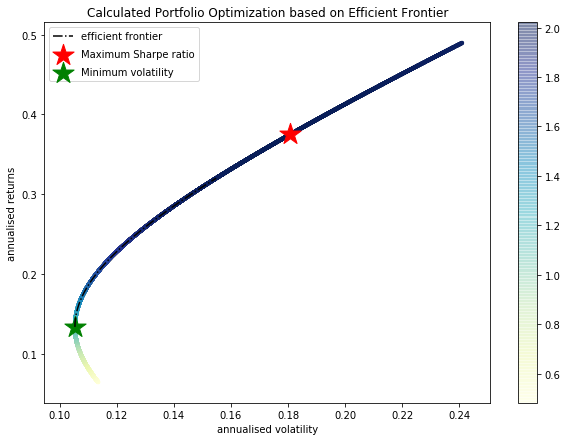

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 0.49 , annualised volatility: 0.24
EQIX : annuaised return 0.06 , annualised volatility: 0.11
--------------------------------------------------------------------------------


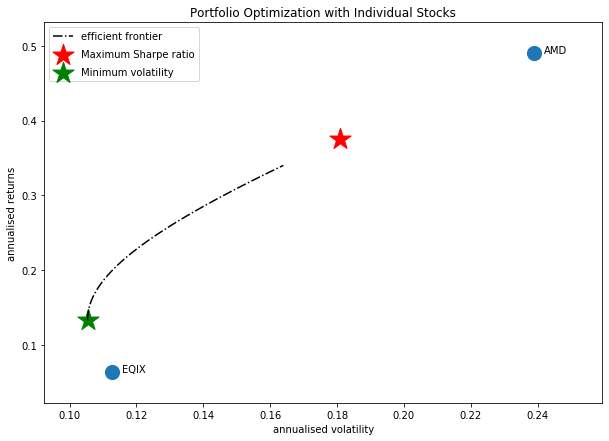

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'DVN']


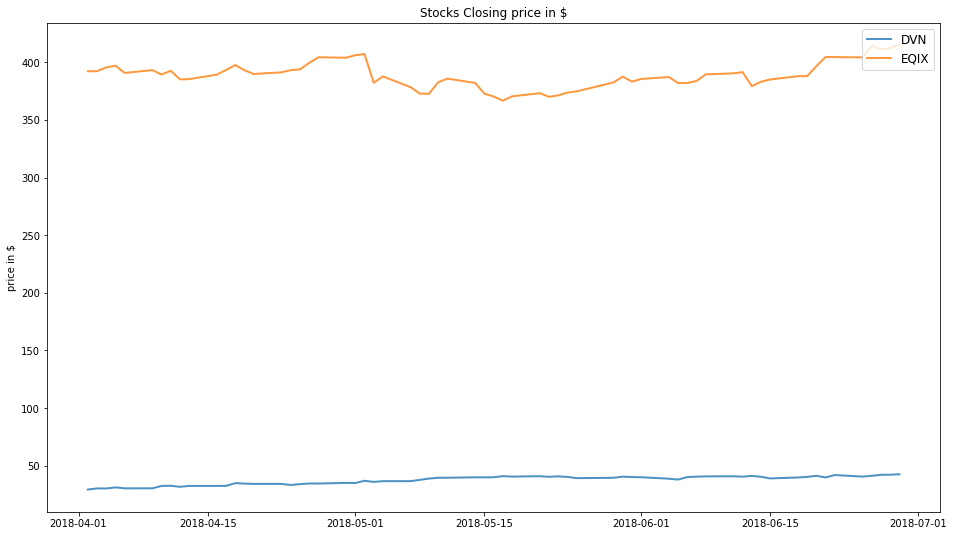

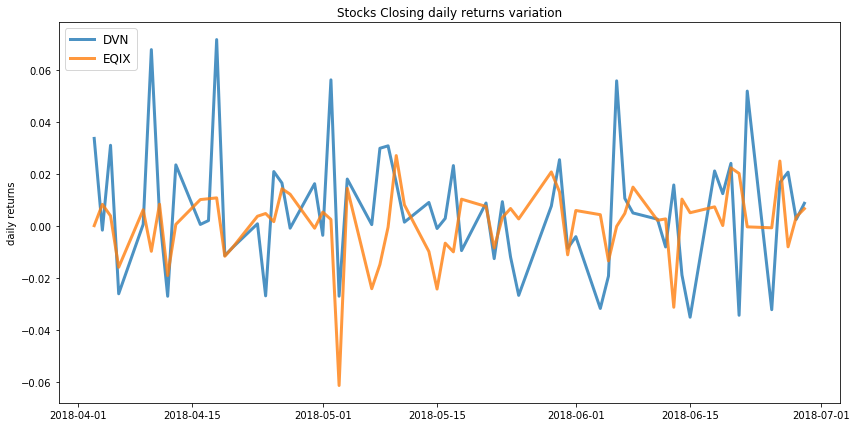

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.35
Annualised Volatility: 0.17


              DVN   EQIX
allocation  86.04  13.96
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.14
Annualised Volatility: 0.1


              DVN   EQIX
allocation  22.34  77.66


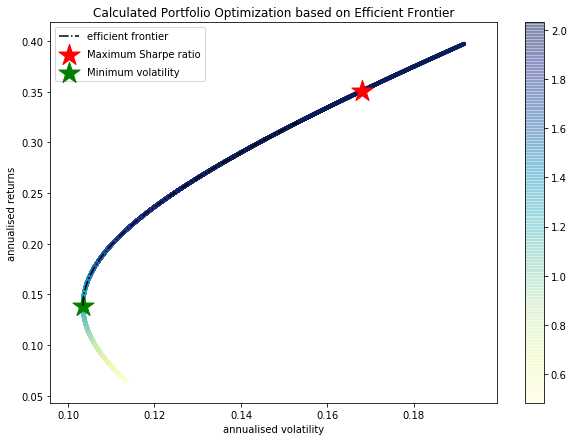

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

DVN : annuaised return 0.4 , annualised volatility: 0.19
EQIX : annuaised return 0.06 , annualised volatility: 0.11
--------------------------------------------------------------------------------


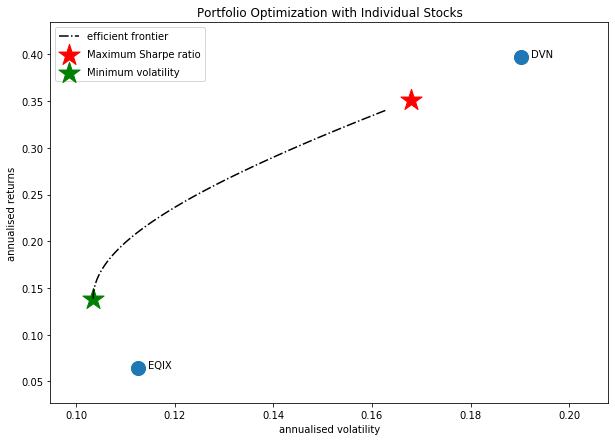

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'AMD']


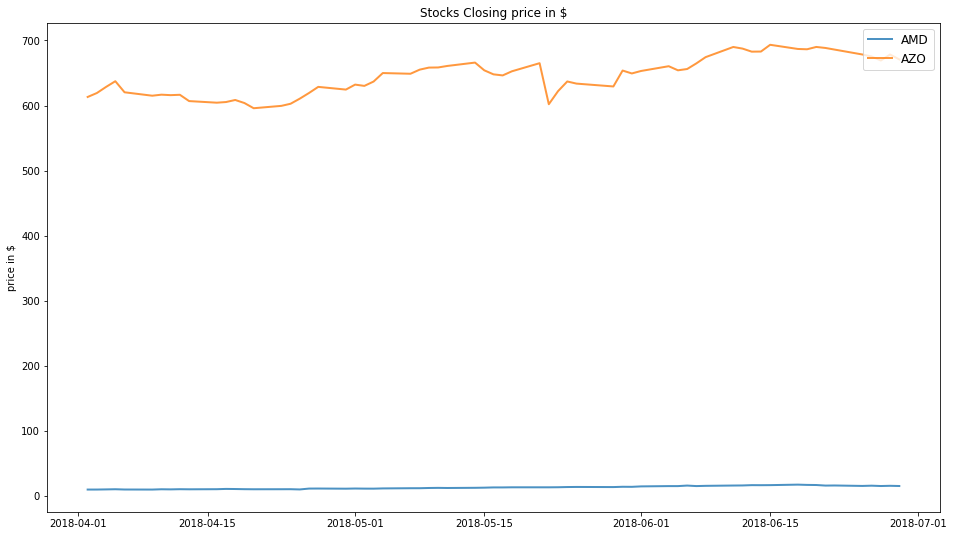

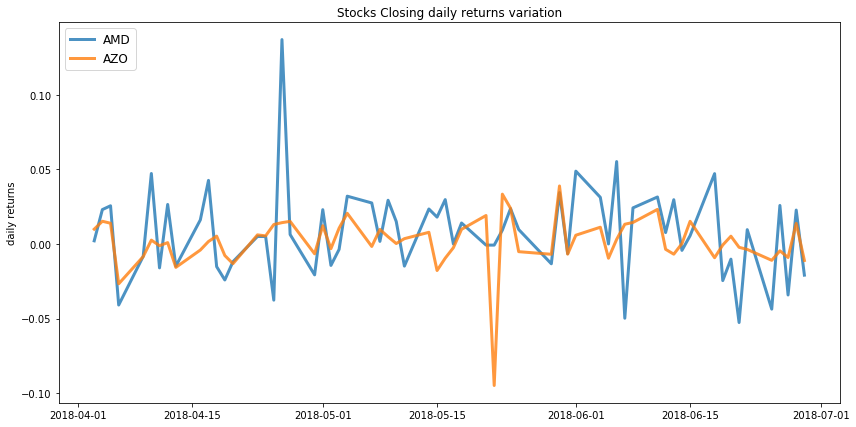

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.45
Annualised Volatility: 0.22


              AMD    AZO
allocation  88.53  11.47
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.17
Annualised Volatility: 0.13


              AMD    AZO
allocation  17.49  82.51


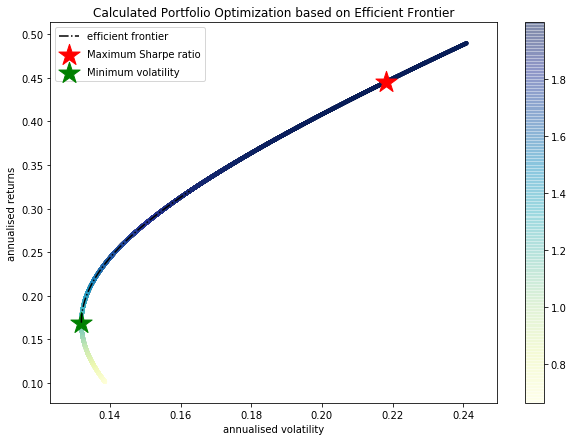

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 0.49 , annualised volatility: 0.24
AZO : annuaised return 0.1 , annualised volatility: 0.14
--------------------------------------------------------------------------------


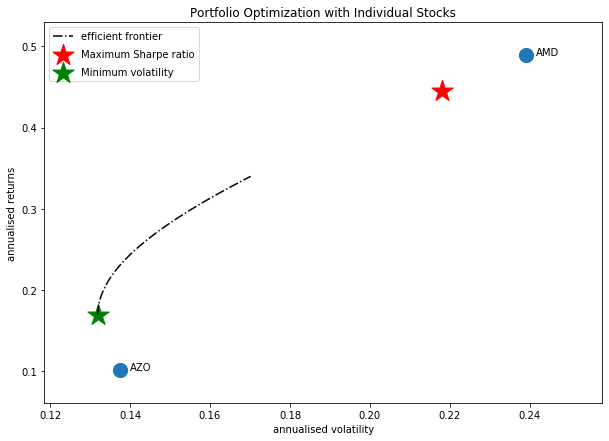

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMD', 'BLK']


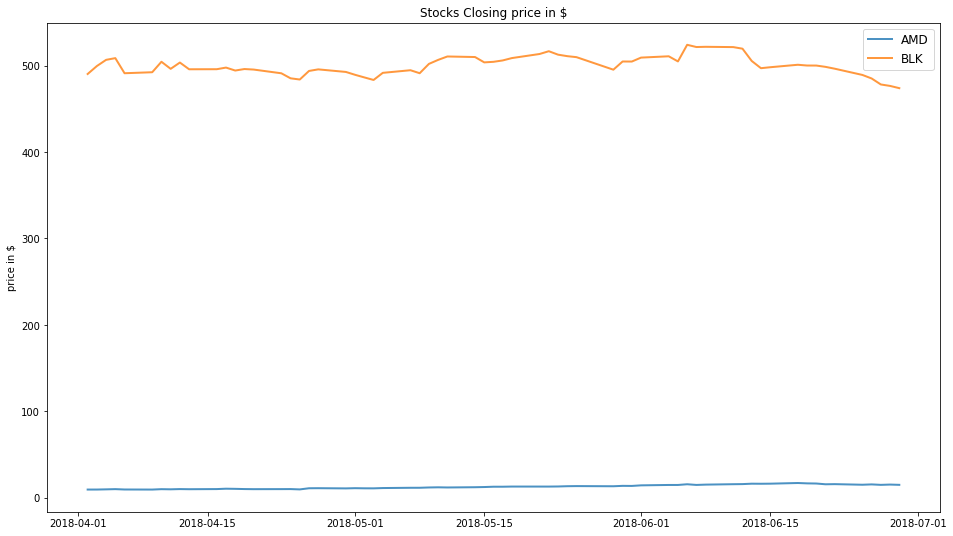

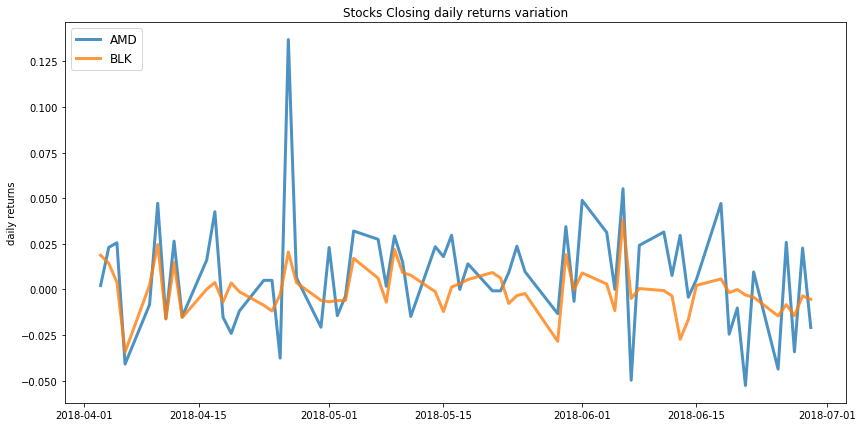

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.49
Annualised Volatility: 0.24


              AMD  BLK
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.03
Annualised Volatility: 0.1


            AMD    BLK
allocation  0.0  100.0


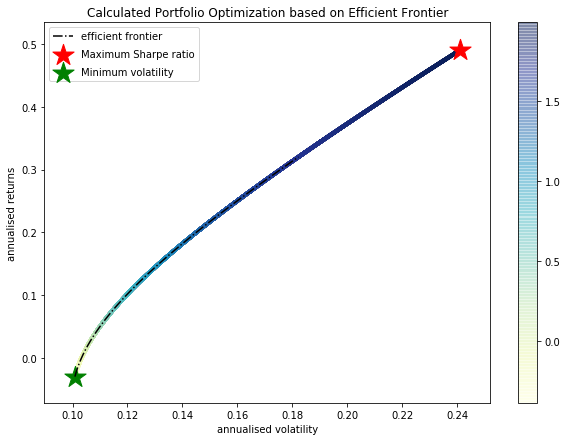

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 0.49 , annualised volatility: 0.24
BLK : annuaised return -0.03 , annualised volatility: 0.1
--------------------------------------------------------------------------------


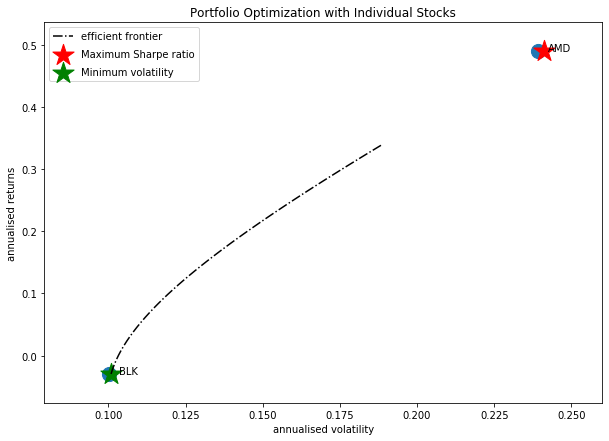

Companies listed in quarter 2 which is between 2018-07-01 and 2018-10-01
['AMD' 'AMZN' 'AZO' 'CMG' 'BKNG' 'BLK' 'AYI' 'BHF']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMD', 'CMG']


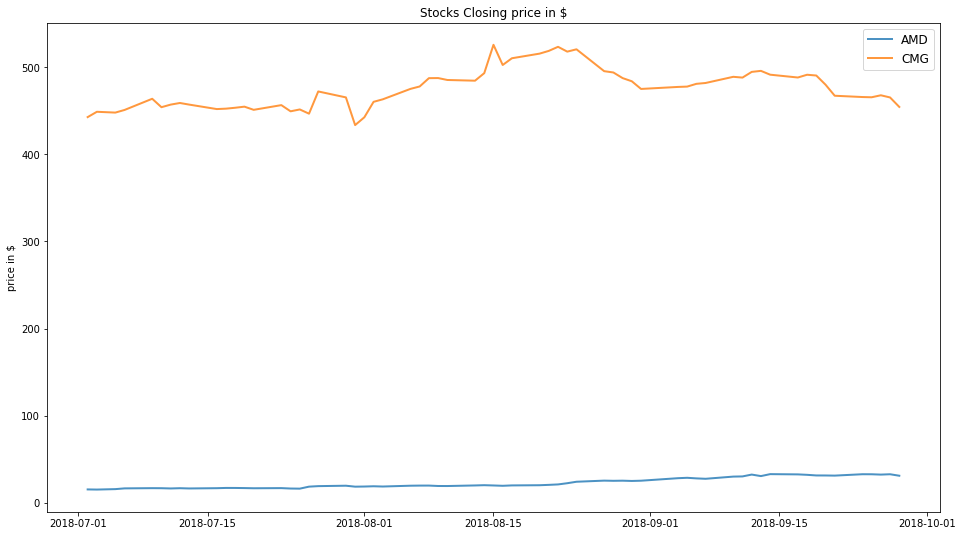

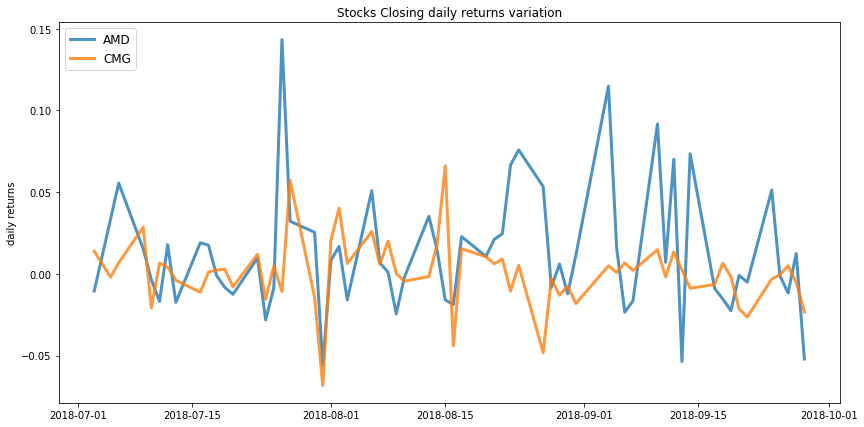

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.77
Annualised Volatility: 0.3


              AMD  CMG
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.18
Annualised Volatility: 0.15


              AMD    CMG
allocation  19.22  80.78


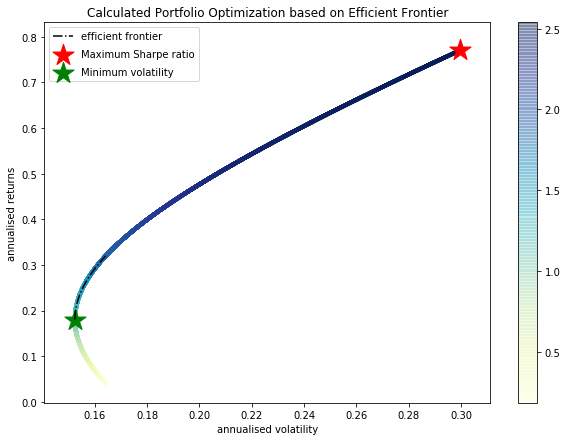

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 0.77 , annualised volatility: 0.3
CMG : annuaised return 0.04 , annualised volatility: 0.16
--------------------------------------------------------------------------------


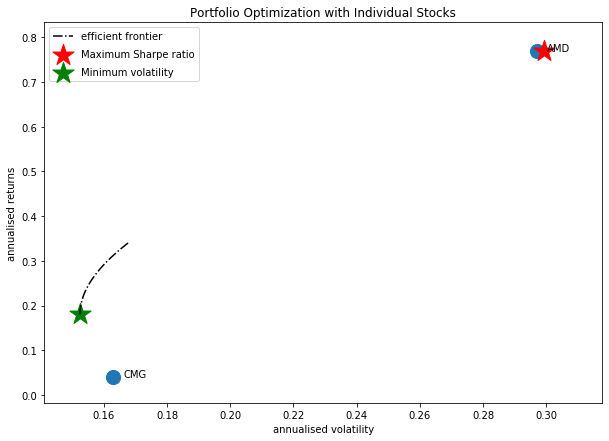

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'AZO', 'CMG']


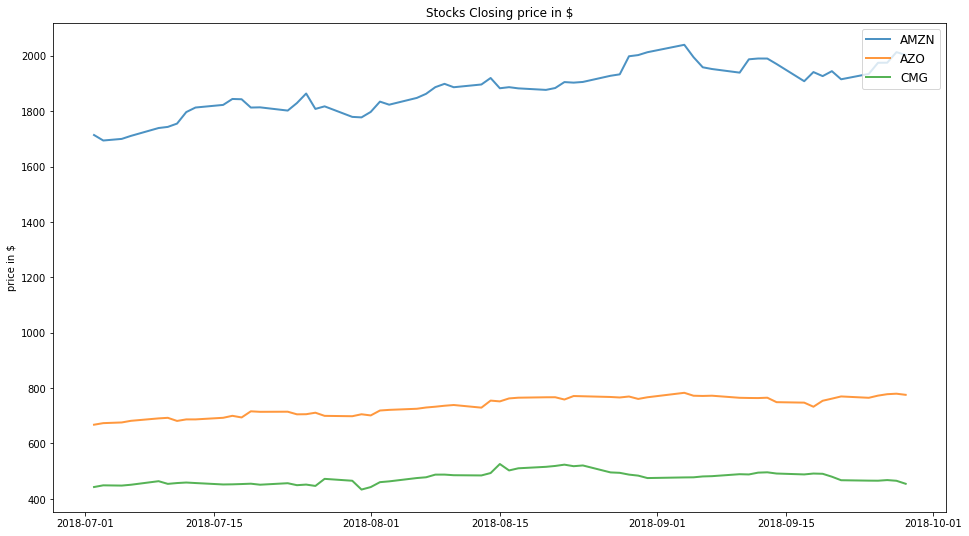

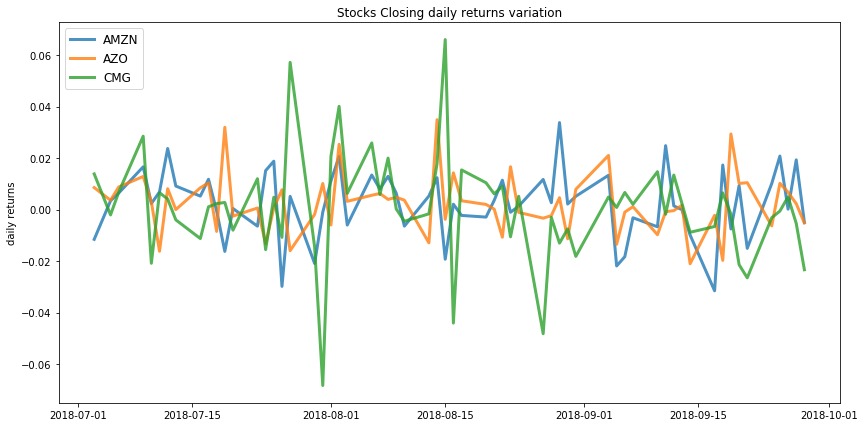

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.16
Annualised Volatility: 0.07


            AMZN    AZO   CMG
allocation  42.1  54.13  3.77
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.14
Annualised Volatility: 0.07


             AMZN    AZO    CMG
allocation  34.42  49.62  15.96


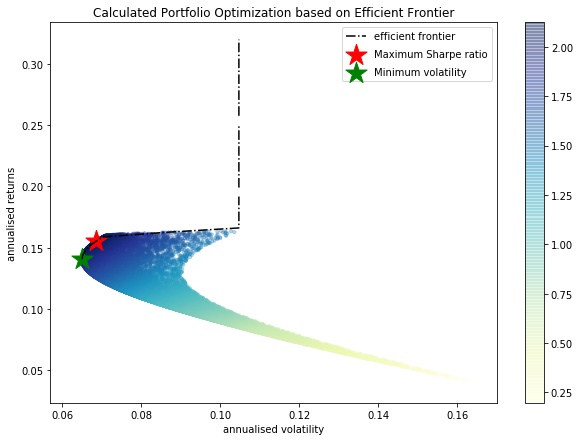

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.16 , annualised volatility: 0.1
AZO : annuaised return 0.16 , annualised volatility: 0.09
CMG : annuaised return 0.04 , annualised volatility: 0.16
--------------------------------------------------------------------------------


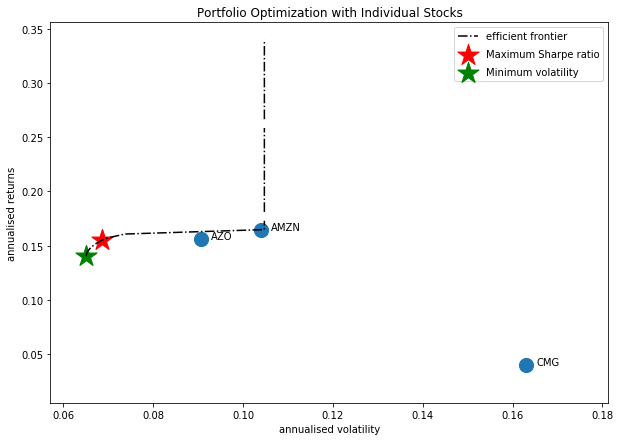

Companies listed in quarter 3 which is between 2018-10-01 and 2019-01-01
['AZO' 'ALGN' 'BLK' 'BKNG' 'NEM' 'BAC' 'BXP' 'GOOG']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['ALGN', 'BLK']


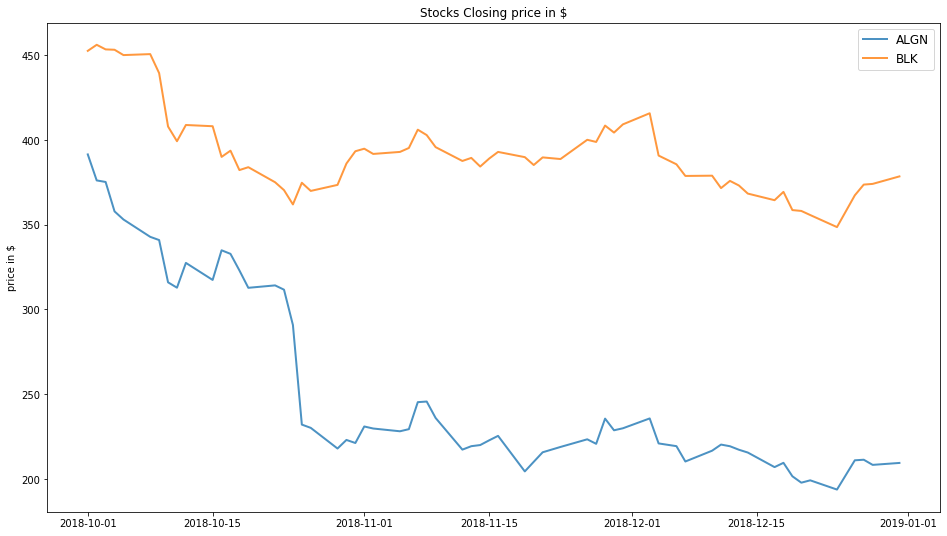

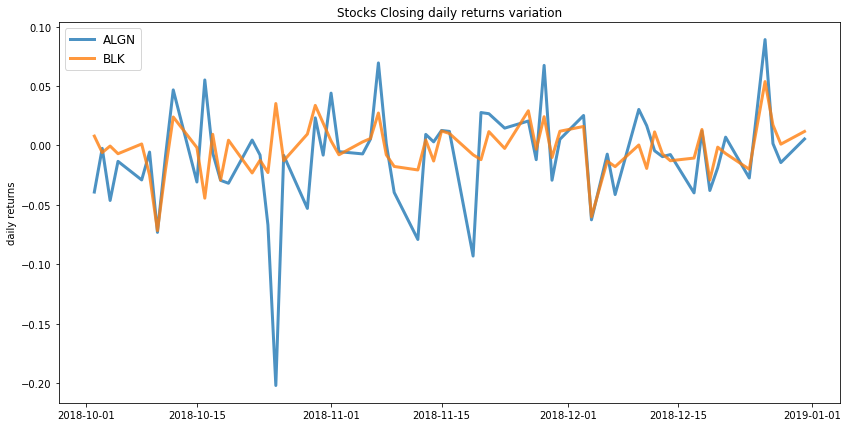

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: -0.17
Annualised Volatility: 0.17


            ALGN    BLK
allocation   0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.21
Annualised Volatility: 0.17


            ALGN    BLK
allocation  9.42  90.58


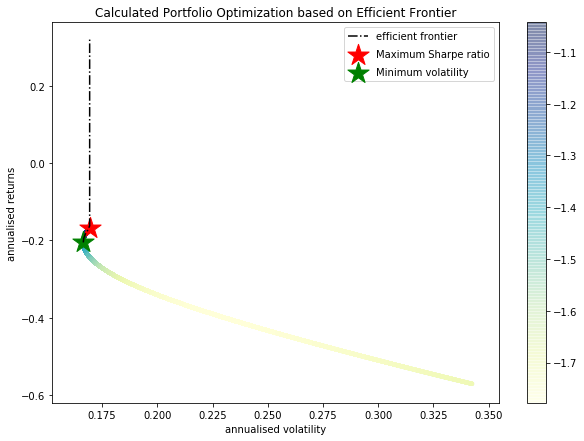

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ALGN : annuaised return -0.57 , annualised volatility: 0.34
BLK : annuaised return -0.17 , annualised volatility: 0.17
--------------------------------------------------------------------------------


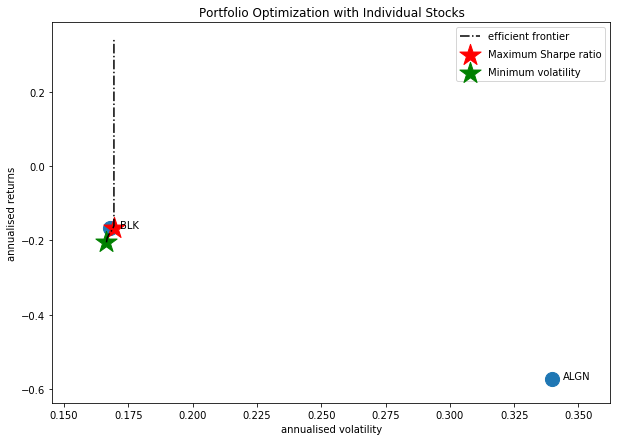

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['ALGN', 'BKNG']


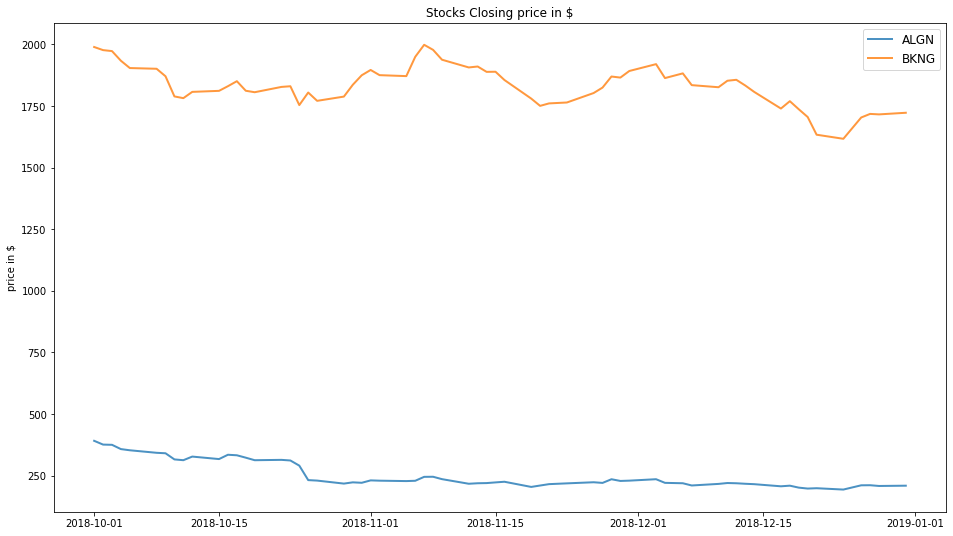

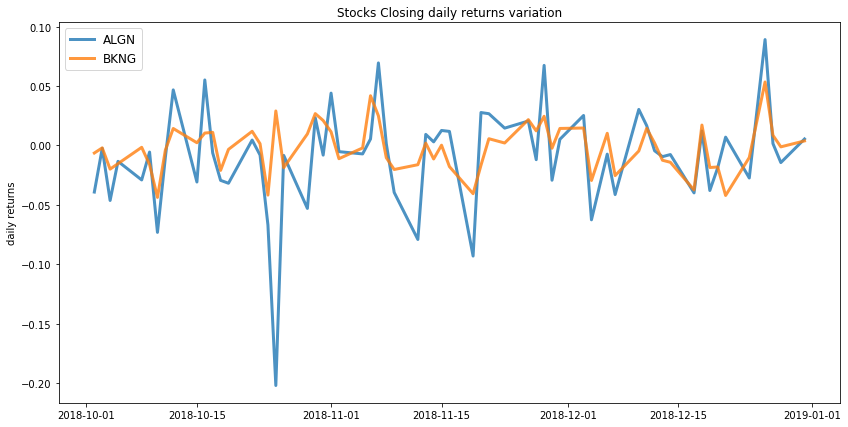

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: -0.13
Annualised Volatility: 0.16


            ALGN   BKNG
allocation   0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.14
Annualised Volatility: 0.16


            ALGN   BKNG
allocation  1.32  98.68


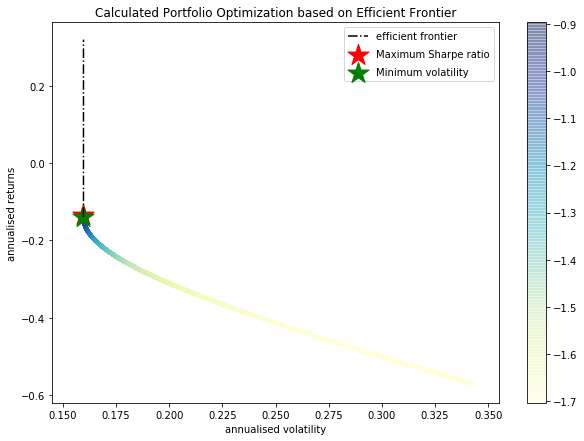

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ALGN : annuaised return -0.57 , annualised volatility: 0.34
BKNG : annuaised return -0.13 , annualised volatility: 0.16
--------------------------------------------------------------------------------


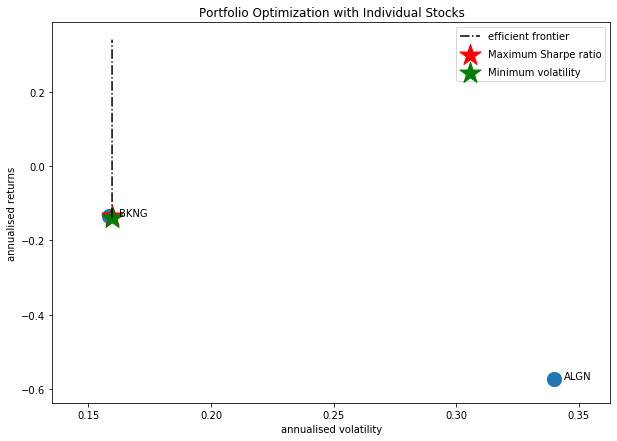

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['ALGN', 'BXP']


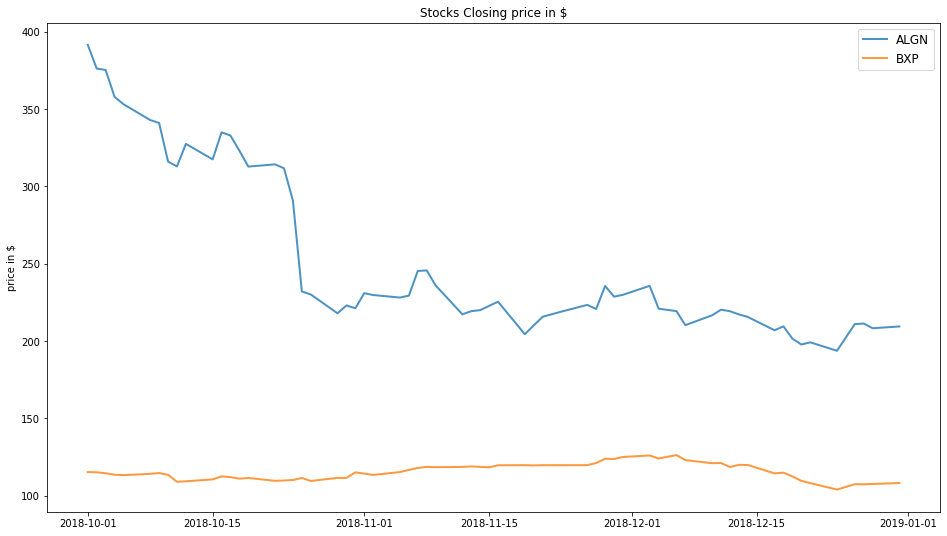

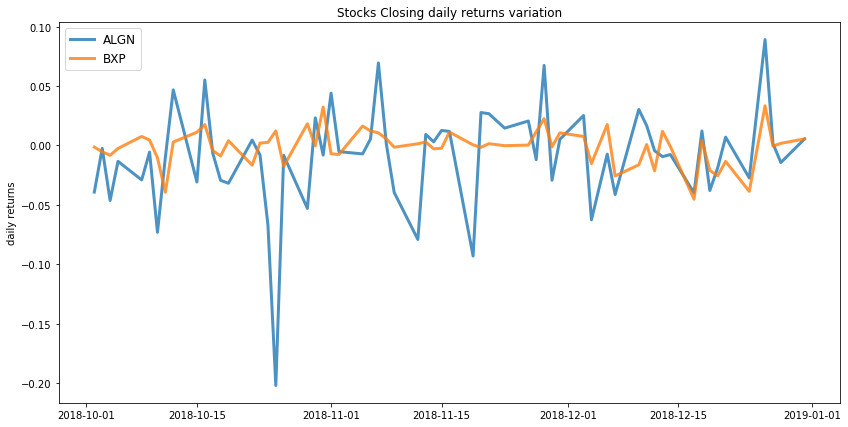

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: -0.06
Annualised Volatility: 0.12


            ALGN    BXP
allocation   0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.08
Annualised Volatility: 0.12


            ALGN    BXP
allocation  5.05  94.95


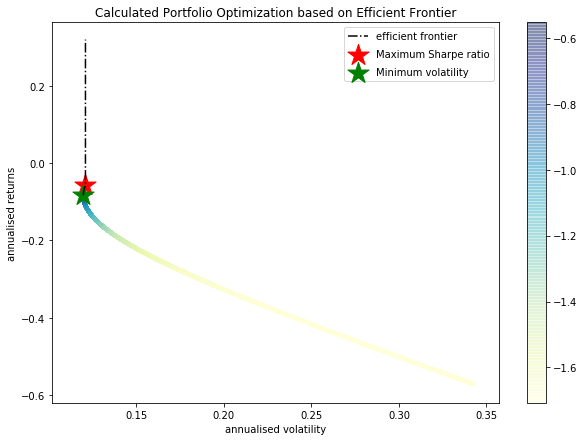

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ALGN : annuaised return -0.57 , annualised volatility: 0.34
BXP : annuaised return -0.06 , annualised volatility: 0.12
--------------------------------------------------------------------------------


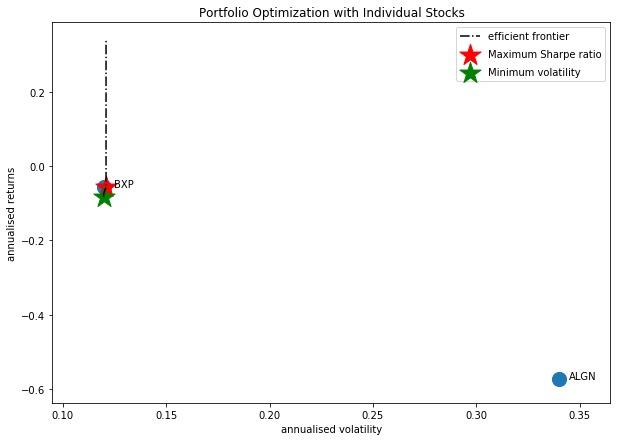

Companies listed in quarter 4 which is between 2019-01-01 and 2019-04-01
['BKNG' 'CMG' 'AAP' 'BA' 'BIIB' 'BLK' 'STZ' 'AZO' 'COTY' 'FCX']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'BA', 'BIIB', 'STZ']


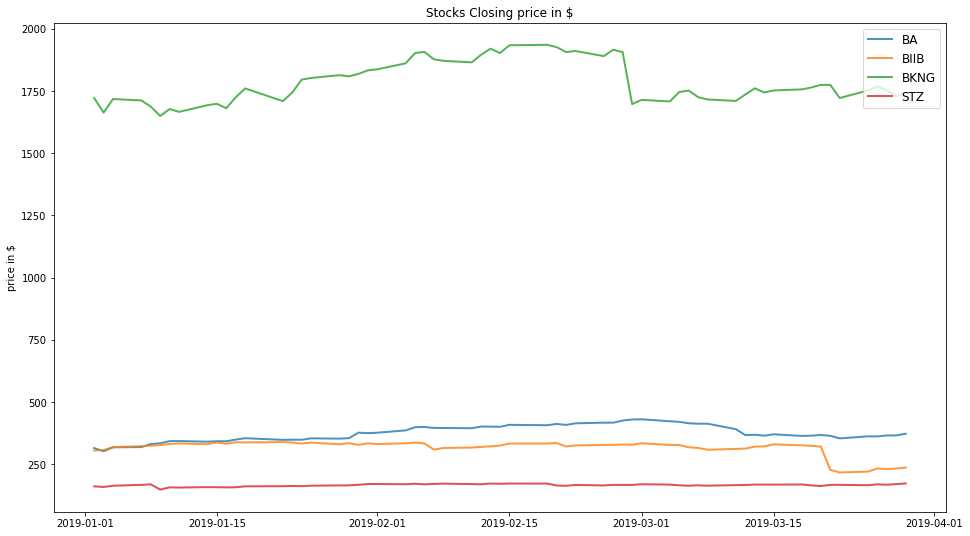

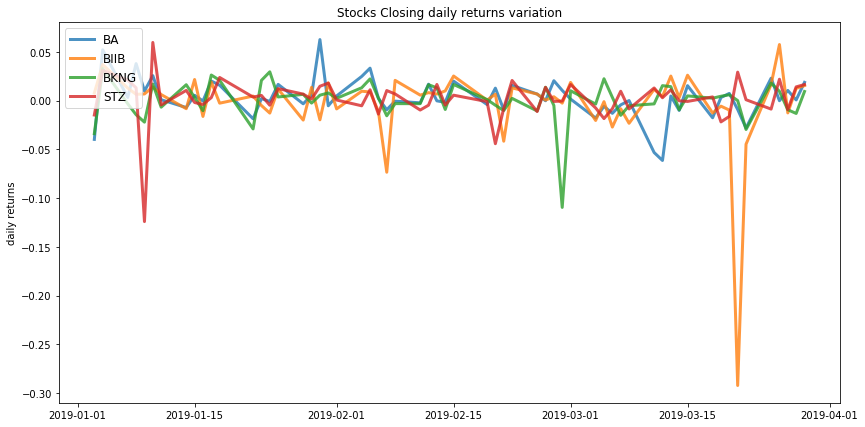

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.16
Annualised Volatility: 0.13


               BA  BIIB  BKNG    STZ
allocation  77.95   0.0   0.0  22.05
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.08
Annualised Volatility: 0.11


               BA  BIIB  BKNG    STZ
allocation  33.67  6.92  29.8  29.61


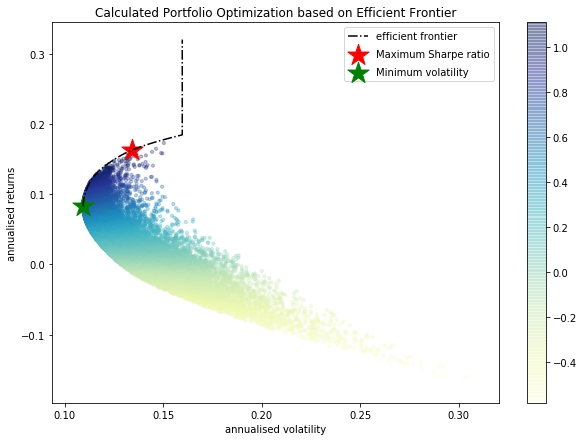

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BA : annuaised return 0.18 , annualised volatility: 0.16
BIIB : annuaised return -0.19 , annualised volatility: 0.33
BKNG : annuaised return 0.03 , annualised volatility: 0.16
STZ : annuaised return 0.09 , annualised volatility: 0.17
--------------------------------------------------------------------------------


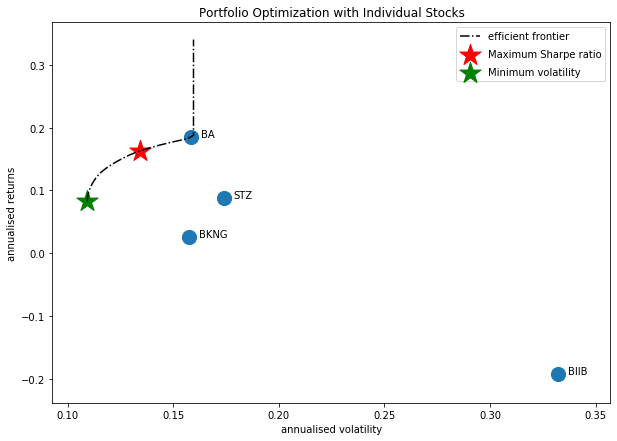

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'FCX']


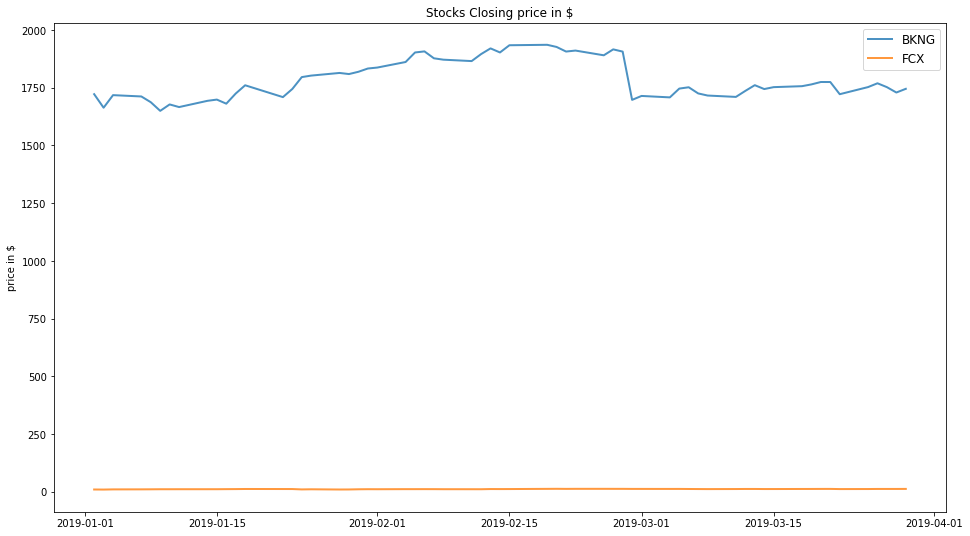

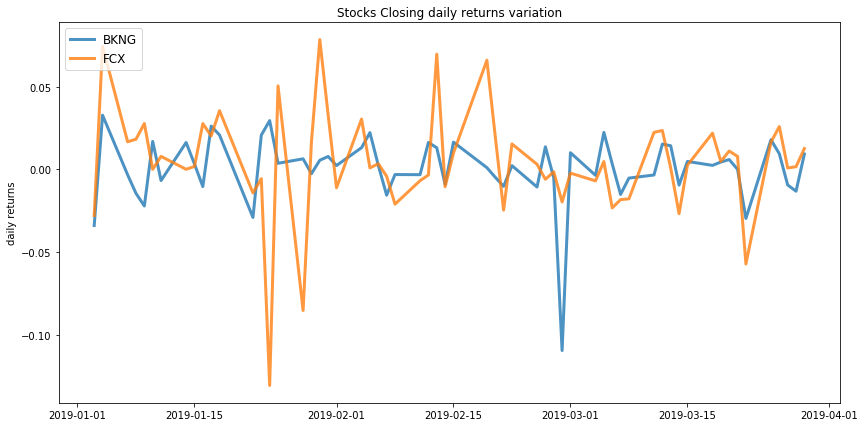

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.26
Annualised Volatility: 0.26


            BKNG    FCX
allocation   0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.08
Annualised Volatility: 0.15


             BKNG    FCX
allocation  77.09  22.91


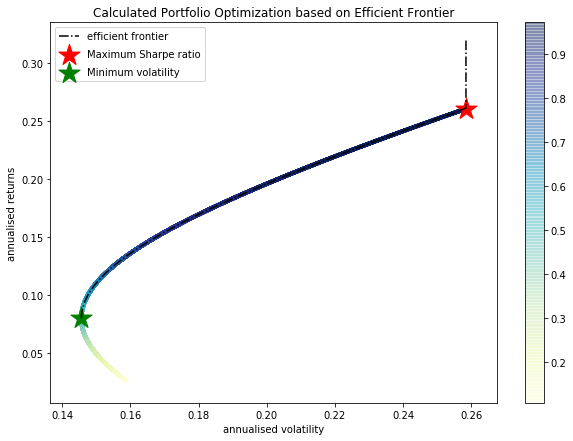

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BKNG : annuaised return 0.03 , annualised volatility: 0.16
FCX : annuaised return 0.26 , annualised volatility: 0.26
--------------------------------------------------------------------------------


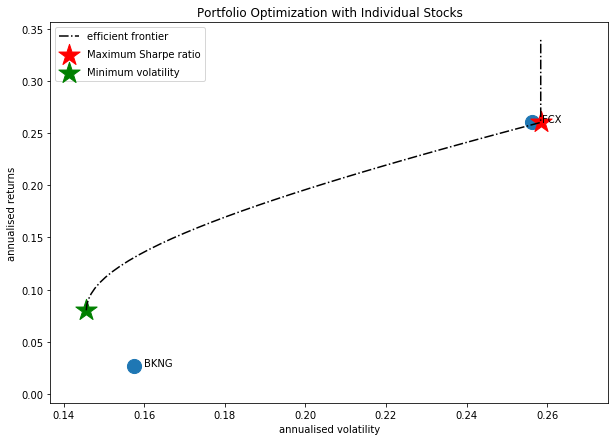

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CMG', 'BA', 'BIIB', 'STZ']


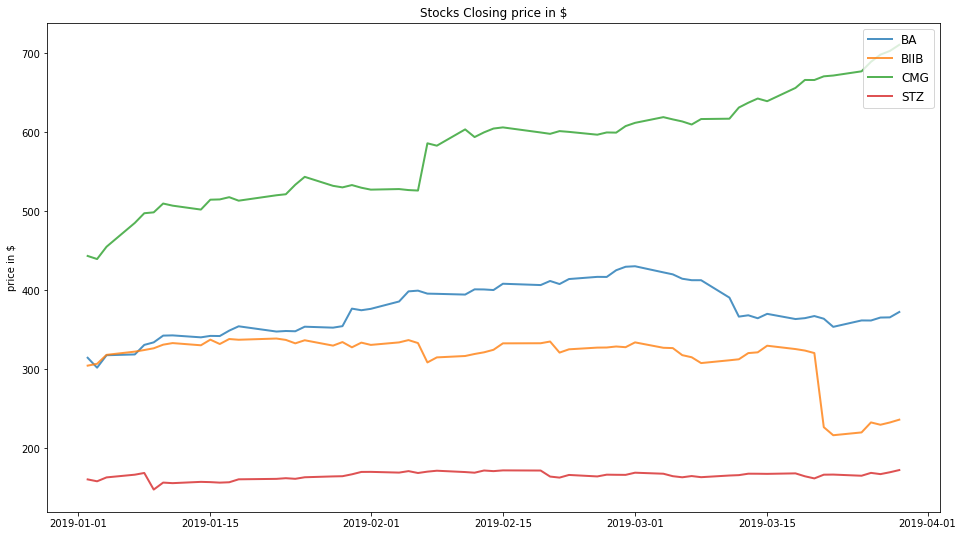

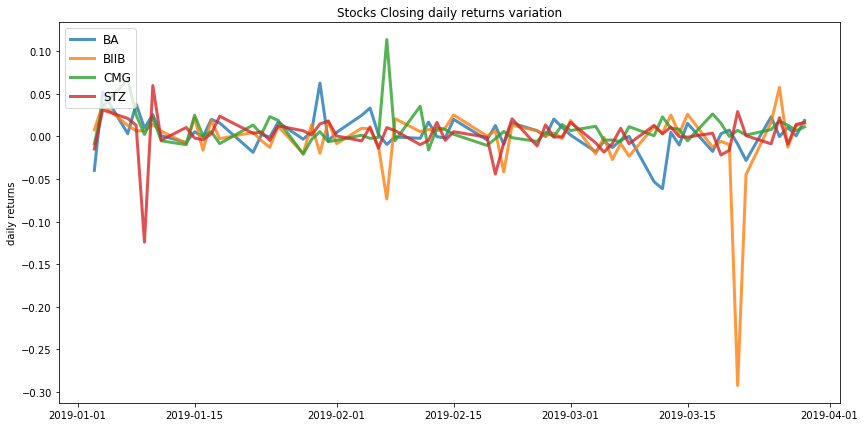

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.41
Annualised Volatility: 0.12


              BA  BIIB   CMG  STZ
allocation  25.4   0.0  74.6  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.25
Annualised Volatility: 0.1


               BA  BIIB    CMG    STZ
allocation  31.72  8.15  36.96  23.18


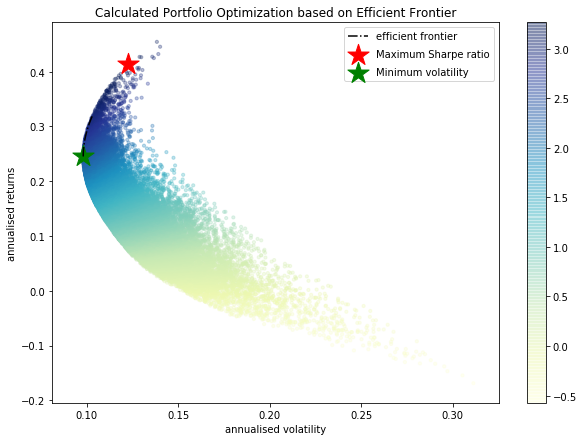

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BA : annuaised return 0.18 , annualised volatility: 0.16
BIIB : annuaised return -0.19 , annualised volatility: 0.33
CMG : annuaised return 0.49 , annualised volatility: 0.15
STZ : annuaised return 0.09 , annualised volatility: 0.17
--------------------------------------------------------------------------------


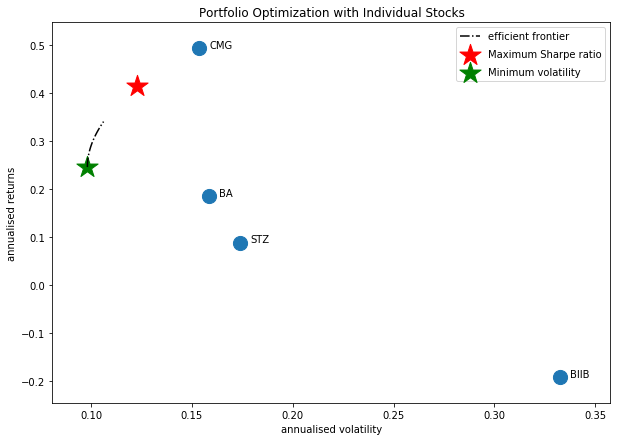

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CMG', 'AZO']


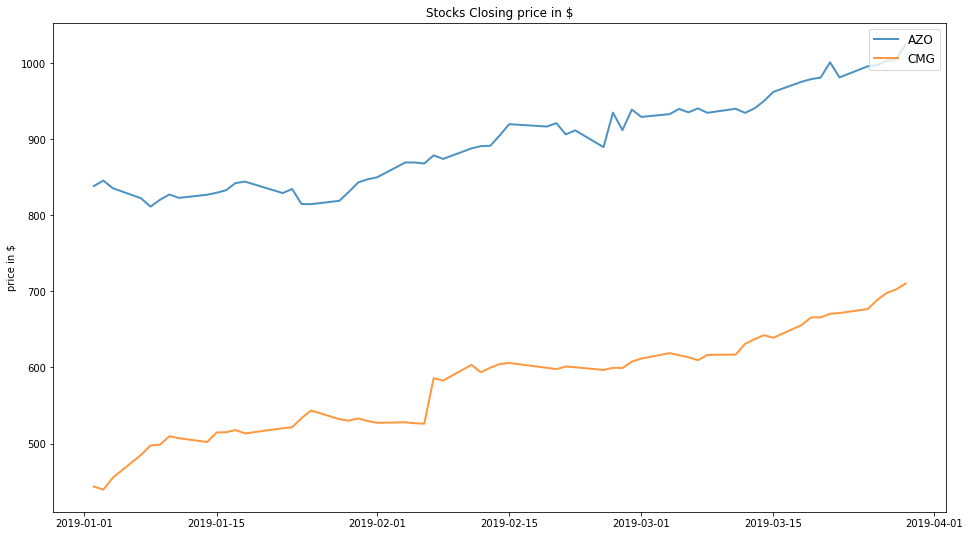

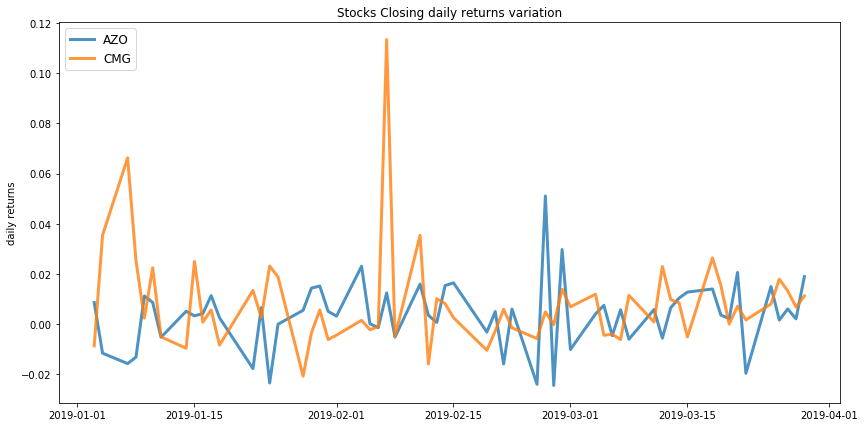

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.36
Annualised Volatility: 0.09


              AZO    CMG
allocation  48.45  51.55
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.3
Annualised Volatility: 0.09


             AZO   CMG
allocation  68.3  31.7


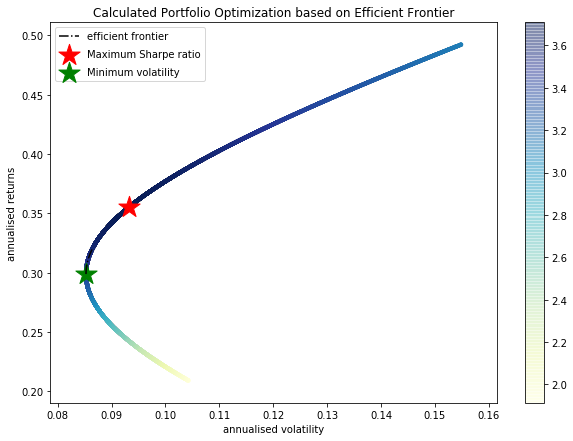

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AZO : annuaised return 0.21 , annualised volatility: 0.1
CMG : annuaised return 0.49 , annualised volatility: 0.15
--------------------------------------------------------------------------------


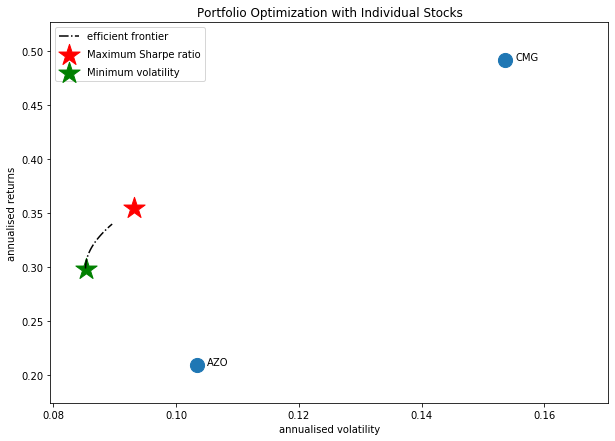

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'CMG', 'BA', 'BIIB', 'STZ']


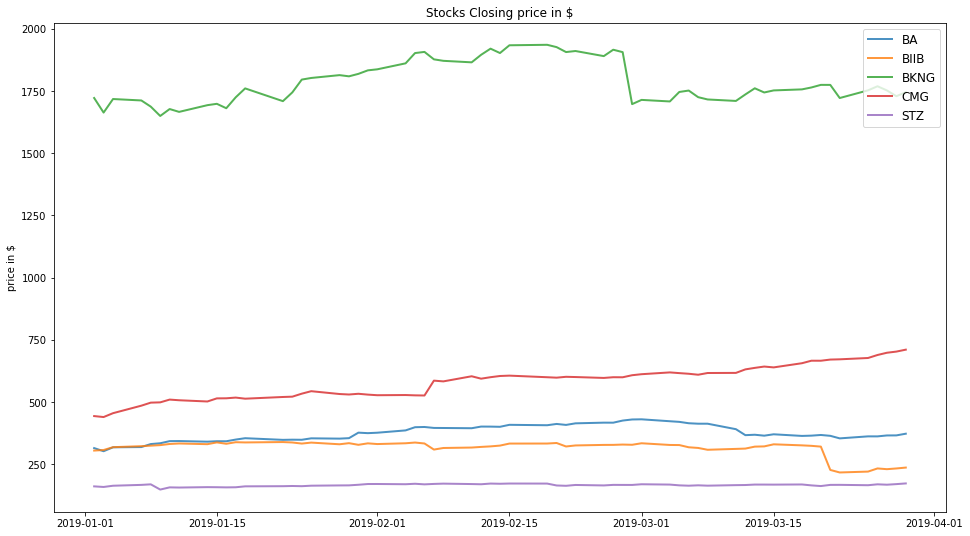

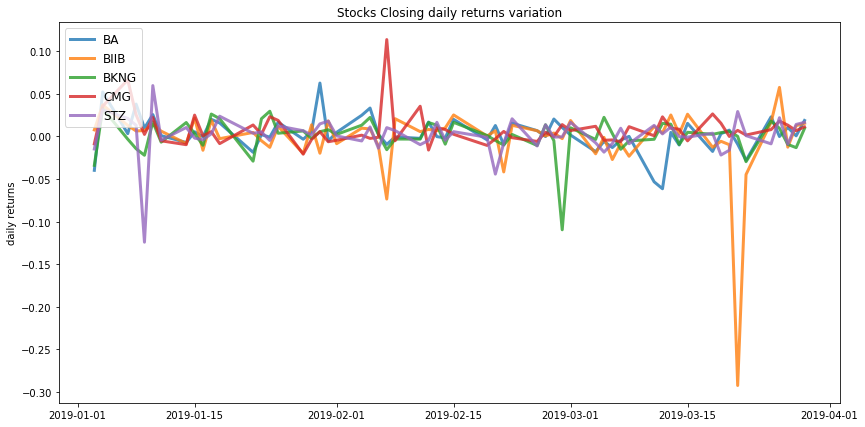

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.41
Annualised Volatility: 0.12


               BA  BIIB  BKNG    CMG  STZ
allocation  24.46   0.0  2.04  73.51  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.22
Annualised Volatility: 0.09


               BA  BIIB   BKNG    CMG    STZ
allocation  22.31  5.86  23.96  33.83  14.03


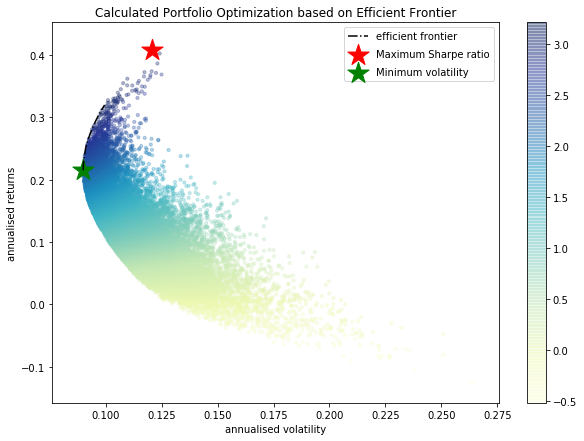

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BA : annuaised return 0.18 , annualised volatility: 0.16
BIIB : annuaised return -0.19 , annualised volatility: 0.33
BKNG : annuaised return 0.03 , annualised volatility: 0.16
CMG : annuaised return 0.49 , annualised volatility: 0.15
STZ : annuaised return 0.09 , annualised volatility: 0.17
--------------------------------------------------------------------------------


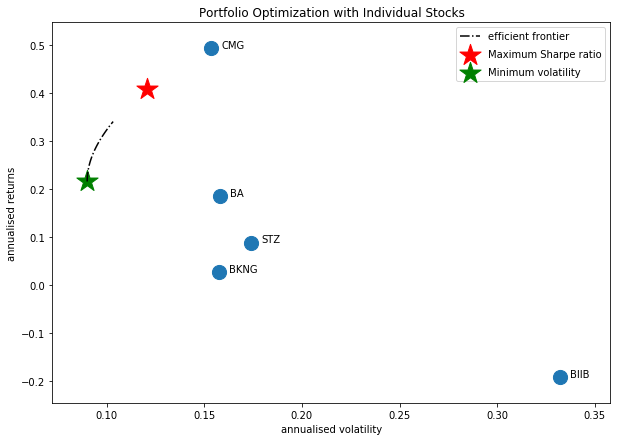

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BA', 'BLK']


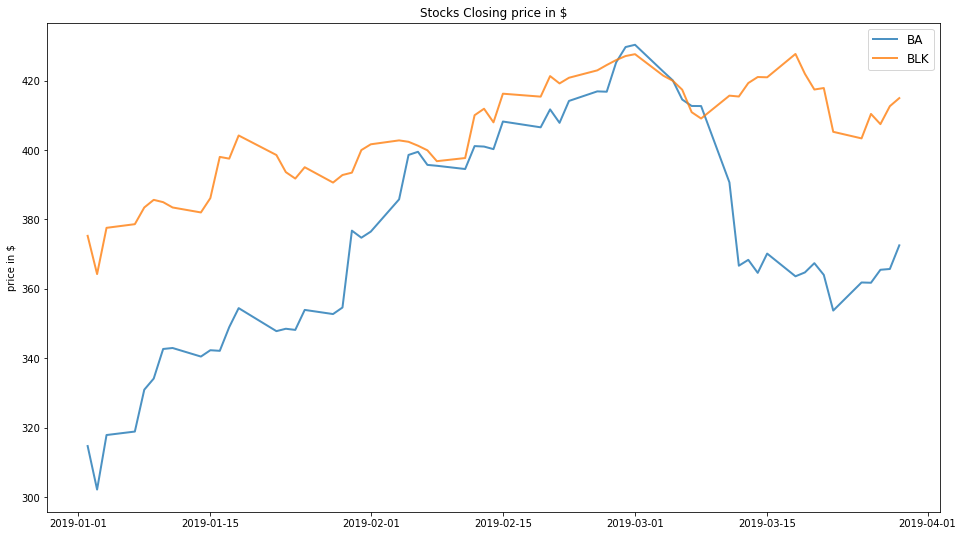

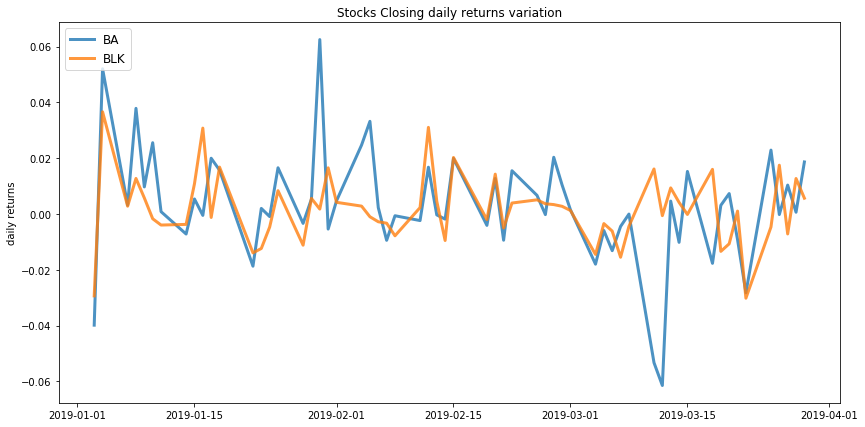

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.14
Annualised Volatility: 0.1


               BA    BLK
allocation  43.07  56.93
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.12
Annualised Volatility: 0.09


               BA    BLK
allocation  16.73  83.27


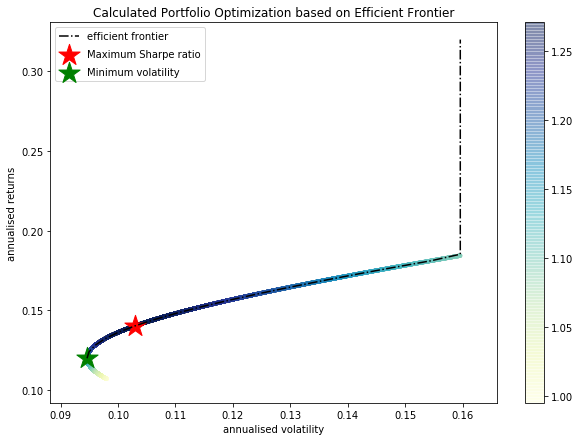

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BA : annuaised return 0.18 , annualised volatility: 0.16
BLK : annuaised return 0.11 , annualised volatility: 0.1
--------------------------------------------------------------------------------


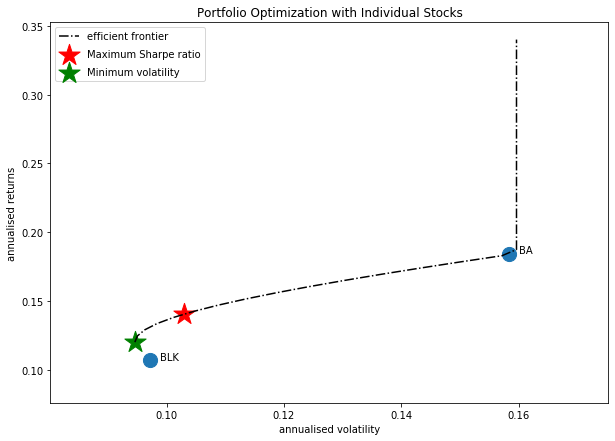

Companies listed in quarter 5 which is between 2019-04-01 and 2019-07-01
['BLK' 'BKNG' 'EQIX' 'BA' 'AMZN' 'DISCK' 'AZO' 'APC' 'HST']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BLK', 'BKNG', 'EQIX', 'AMZN', 'AZO']


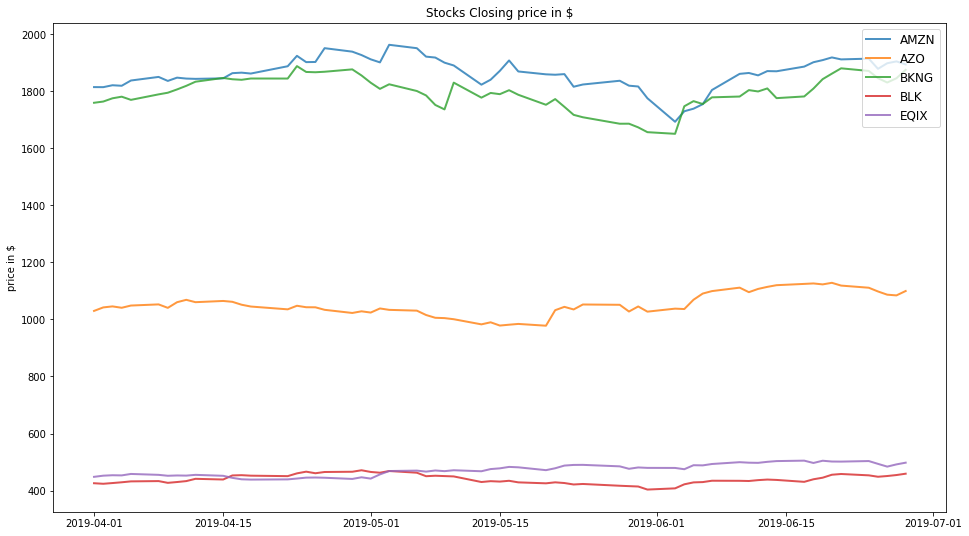

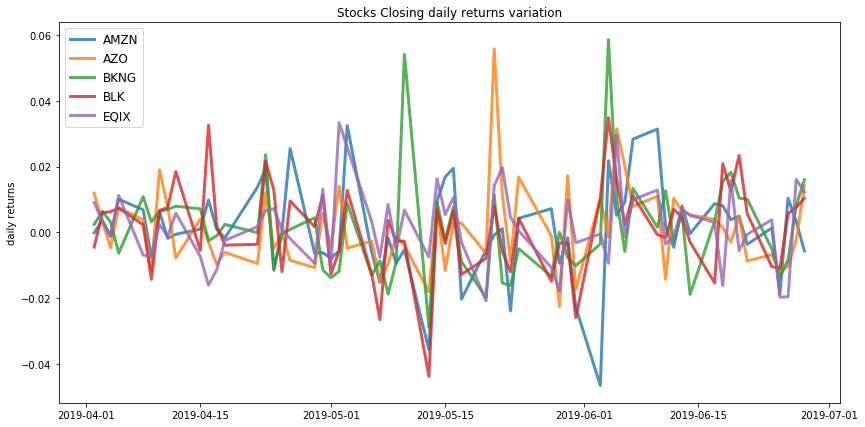

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.1
Annualised Volatility: 0.07


            AMZN  AZO  BKNG    BLK   EQIX
allocation   0.0  0.0  8.92  23.84  67.24
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.08
Annualised Volatility: 0.07


             AMZN    AZO  BKNG    BLK   EQIX
allocation  13.78  18.73  16.4  13.67  37.43


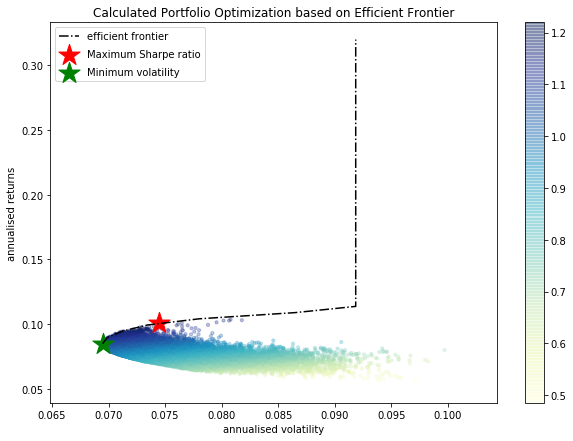

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.05 , annualised volatility: 0.11
AZO : annuaised return 0.07 , annualised volatility: 0.1
BKNG : annuaised return 0.07 , annualised volatility: 0.12
BLK : annuaised return 0.08 , annualised volatility: 0.11
EQIX : annuaised return 0.11 , annualised volatility: 0.09
--------------------------------------------------------------------------------


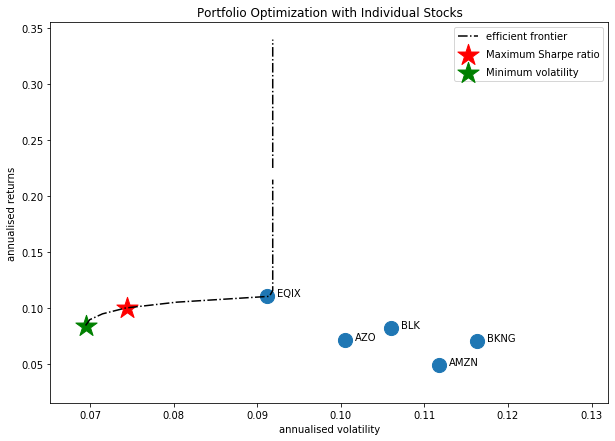

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BLK', 'BKNG', 'EQIX', 'AZO']


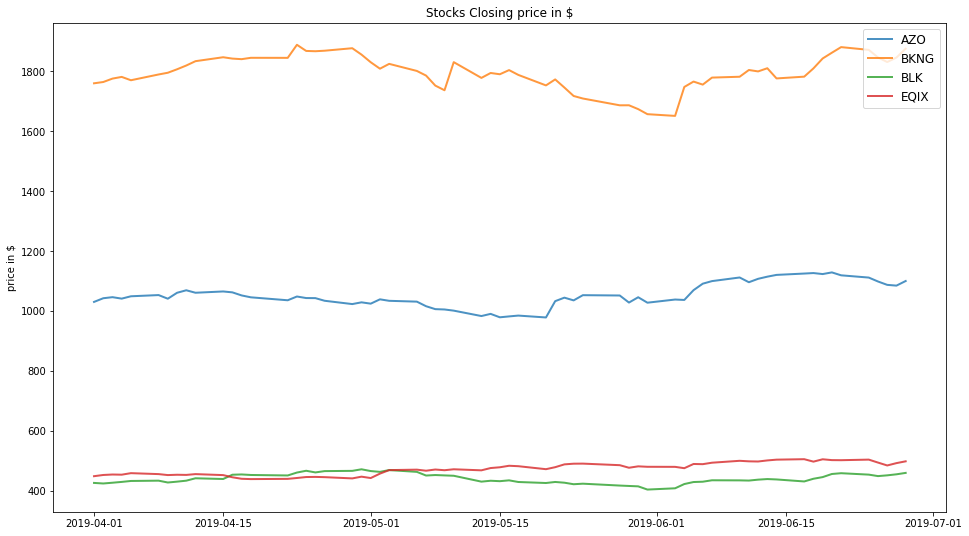

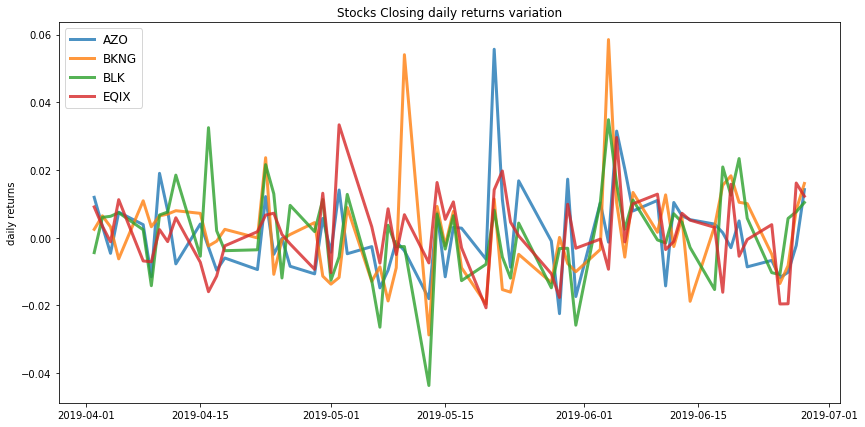

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.1
Annualised Volatility: 0.07


            AZO  BKNG    BLK   EQIX
allocation  0.0  8.91  23.85  67.24
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.09
Annualised Volatility: 0.07


              AZO   BKNG    BLK   EQIX
allocation  18.67  20.26  18.85  42.22


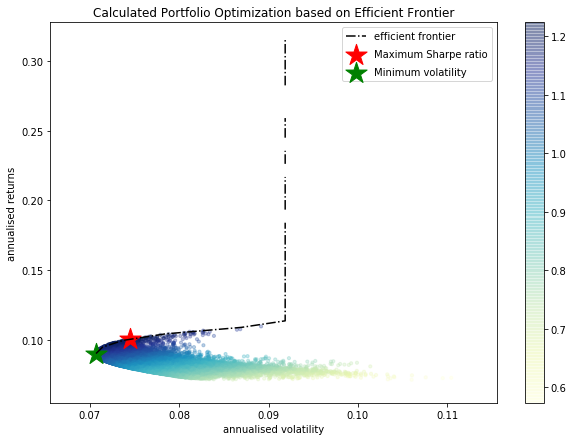

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AZO : annuaised return 0.07 , annualised volatility: 0.1
BKNG : annuaised return 0.07 , annualised volatility: 0.12
BLK : annuaised return 0.08 , annualised volatility: 0.11
EQIX : annuaised return 0.11 , annualised volatility: 0.09
--------------------------------------------------------------------------------


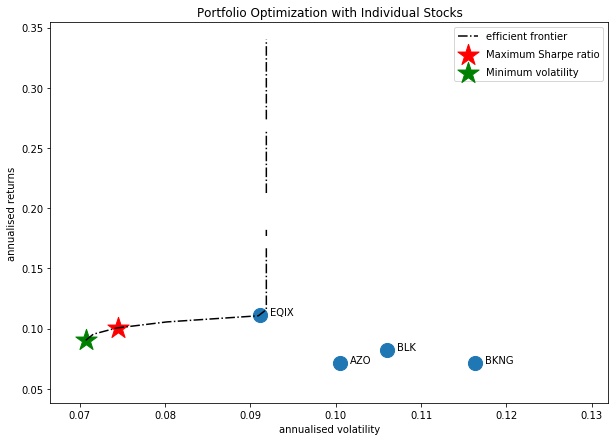

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BLK', 'BKNG', 'EQIX', 'AZO', 'APC']


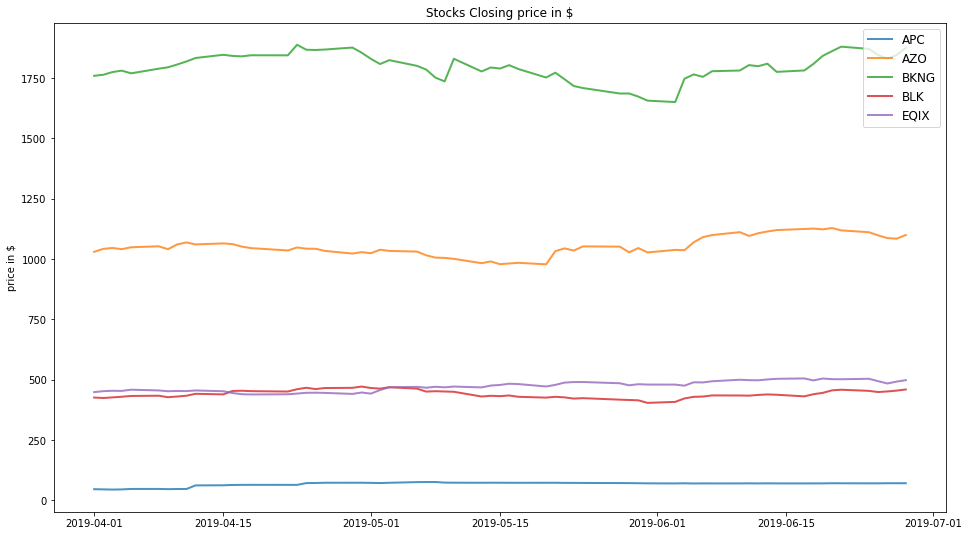

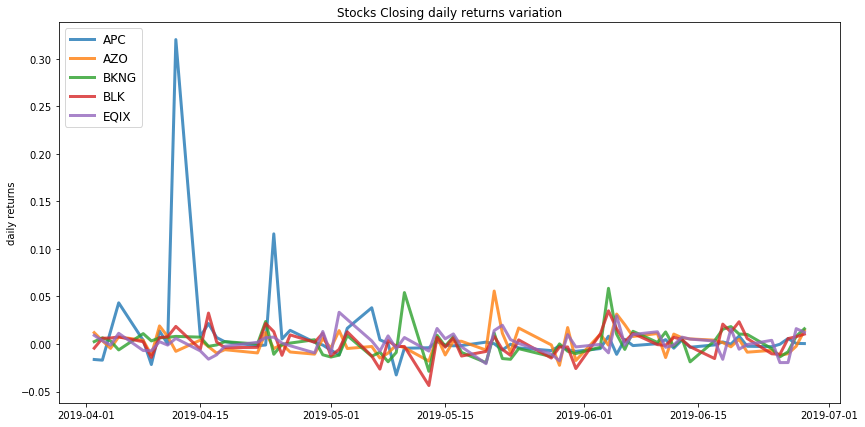

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.18
Annualised Volatility: 0.09


              APC    AZO   BKNG  BLK   EQIX
allocation  20.45  14.51  15.11  0.0  49.92
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.1
Annualised Volatility: 0.07


             APC   AZO   BKNG    BLK   EQIX
allocation  2.87  21.5  21.26  14.74  39.63


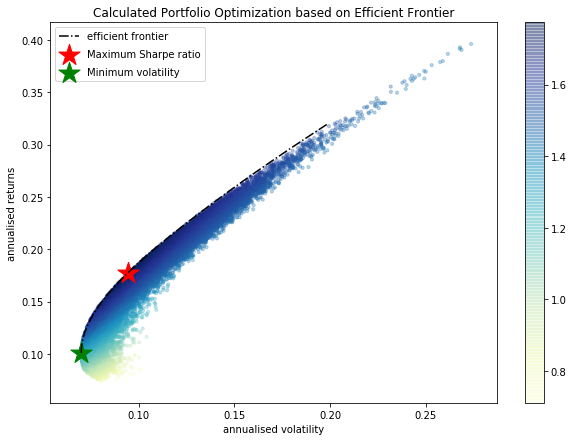

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

APC : annuaised return 0.49 , annualised volatility: 0.35
AZO : annuaised return 0.07 , annualised volatility: 0.1
BKNG : annuaised return 0.07 , annualised volatility: 0.12
BLK : annuaised return 0.08 , annualised volatility: 0.11
EQIX : annuaised return 0.11 , annualised volatility: 0.09
--------------------------------------------------------------------------------


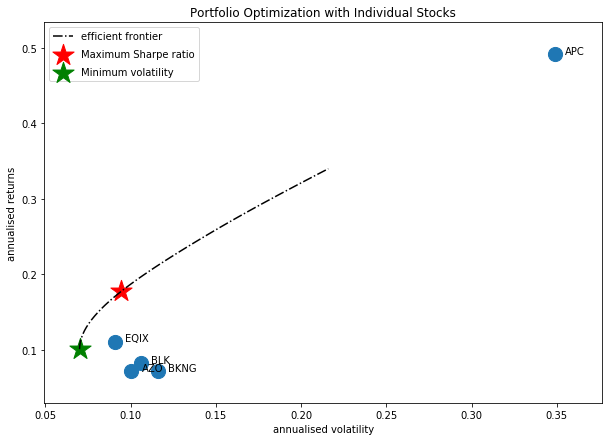

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BLK', 'HST']


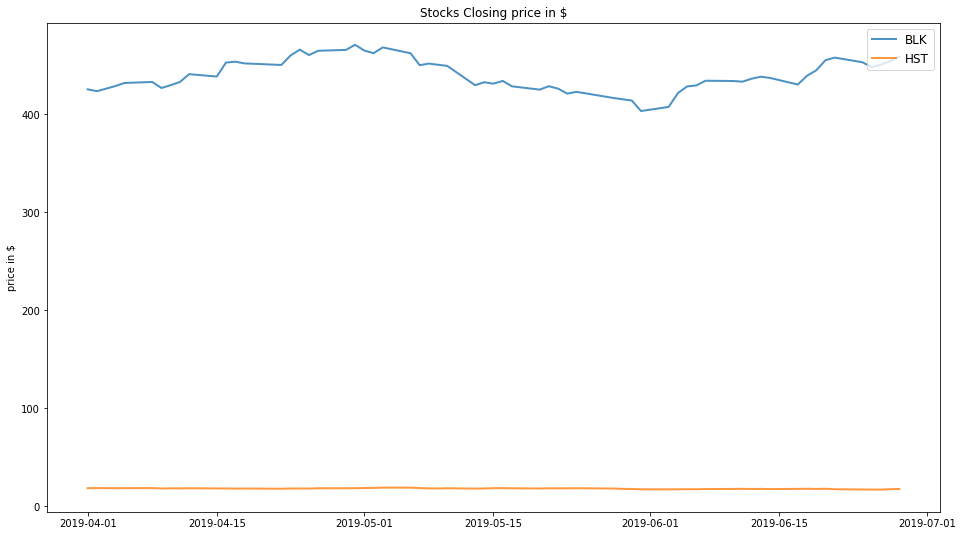

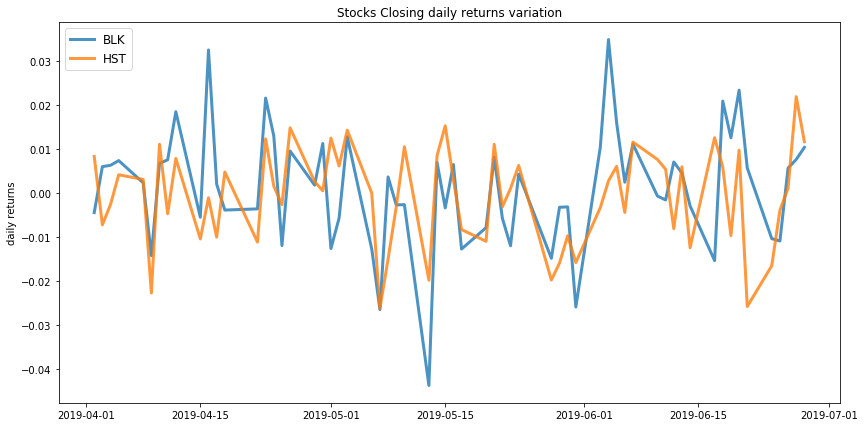

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.08
Annualised Volatility: 0.11


              BLK  HST
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.0
Annualised Volatility: 0.08


              BLK    HST
allocation  32.71  67.29


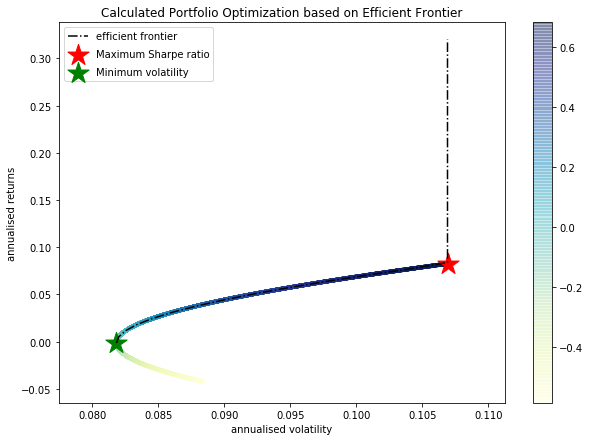

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BLK : annuaised return 0.08 , annualised volatility: 0.11
HST : annuaised return -0.04 , annualised volatility: 0.09
--------------------------------------------------------------------------------


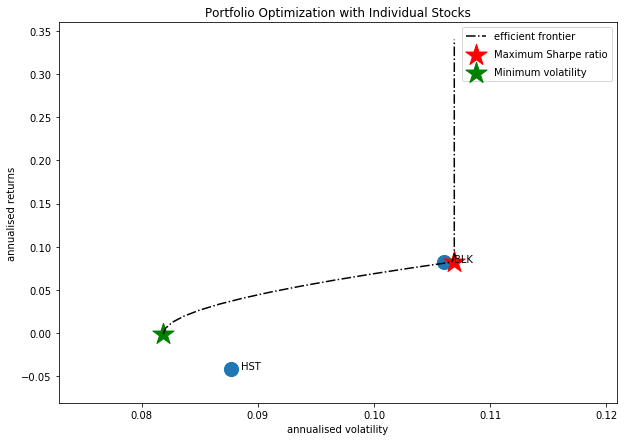

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'BA']


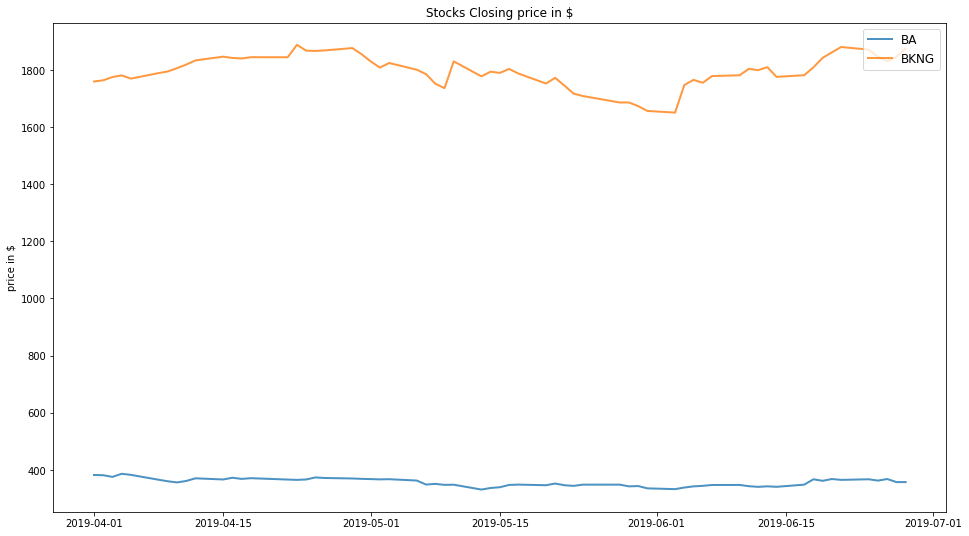

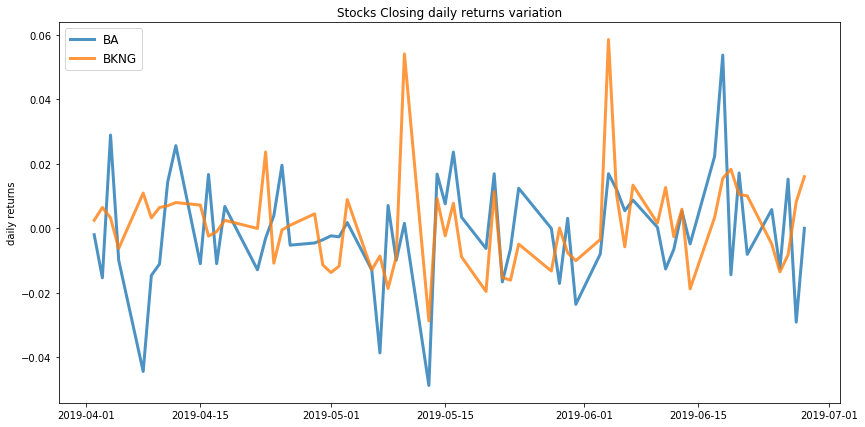

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.07
Annualised Volatility: 0.12


             BA   BKNG
allocation  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.02
Annualised Volatility: 0.1


               BA   BKNG
allocation  38.87  61.13


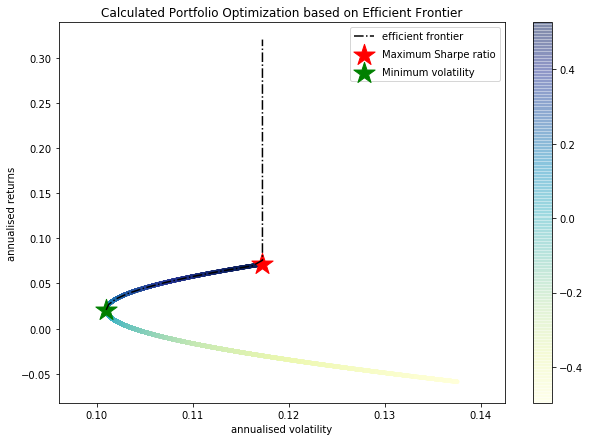

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BA : annuaised return -0.06 , annualised volatility: 0.14
BKNG : annuaised return 0.07 , annualised volatility: 0.12
--------------------------------------------------------------------------------


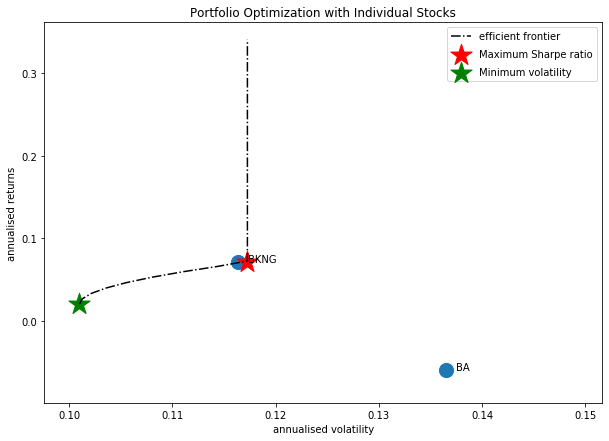

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'EQIX', 'AMZN', 'AZO']


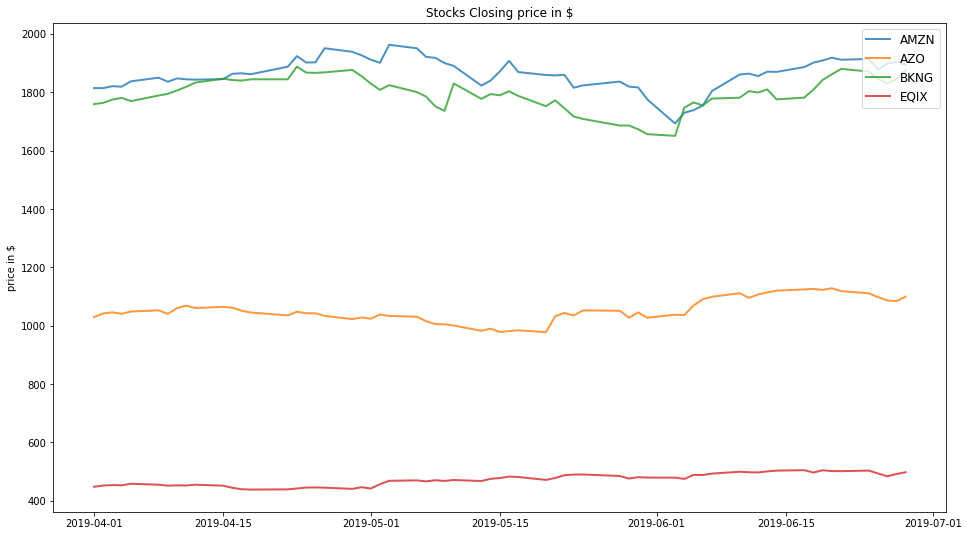

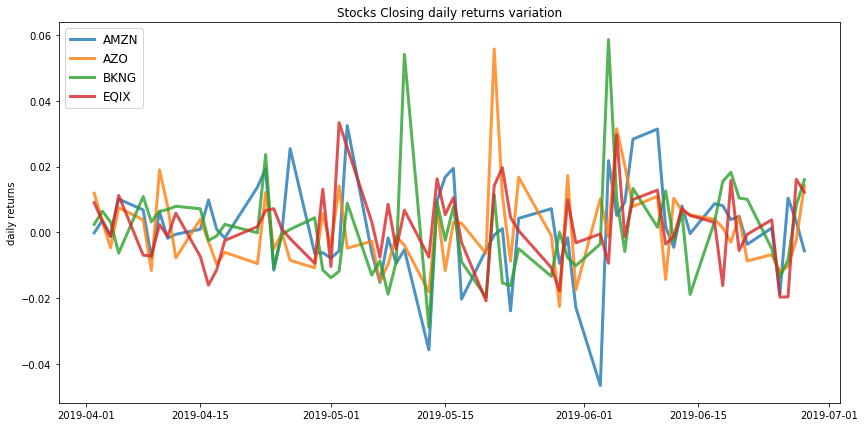

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.1
Annualised Volatility: 0.08


            AMZN   AZO   BKNG   EQIX
allocation   0.0  0.96  22.78  76.26
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.08
Annualised Volatility: 0.07


             AMZN    AZO   BKNG   EQIX
allocation  17.65  22.98  22.11  37.26


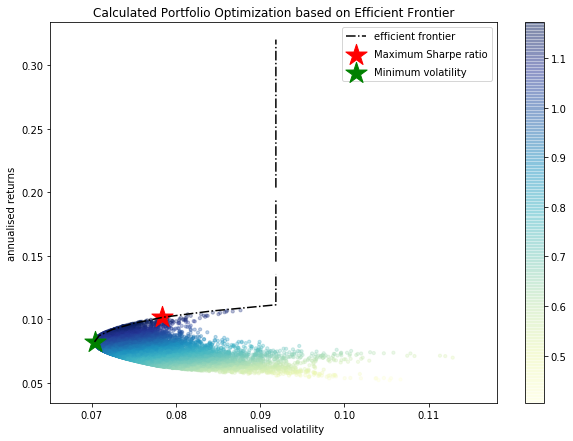

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.05 , annualised volatility: 0.11
AZO : annuaised return 0.07 , annualised volatility: 0.1
BKNG : annuaised return 0.07 , annualised volatility: 0.12
EQIX : annuaised return 0.11 , annualised volatility: 0.09
--------------------------------------------------------------------------------


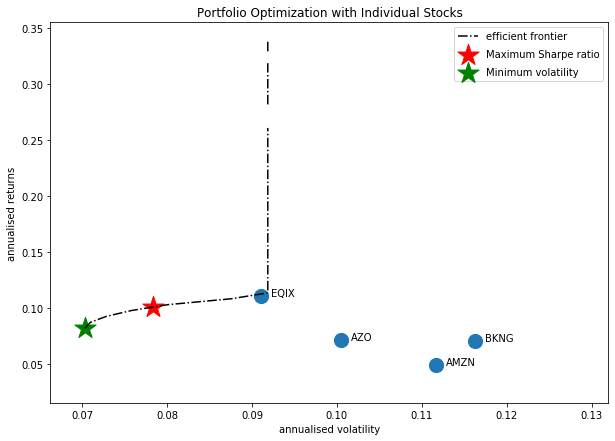

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'DISCK']


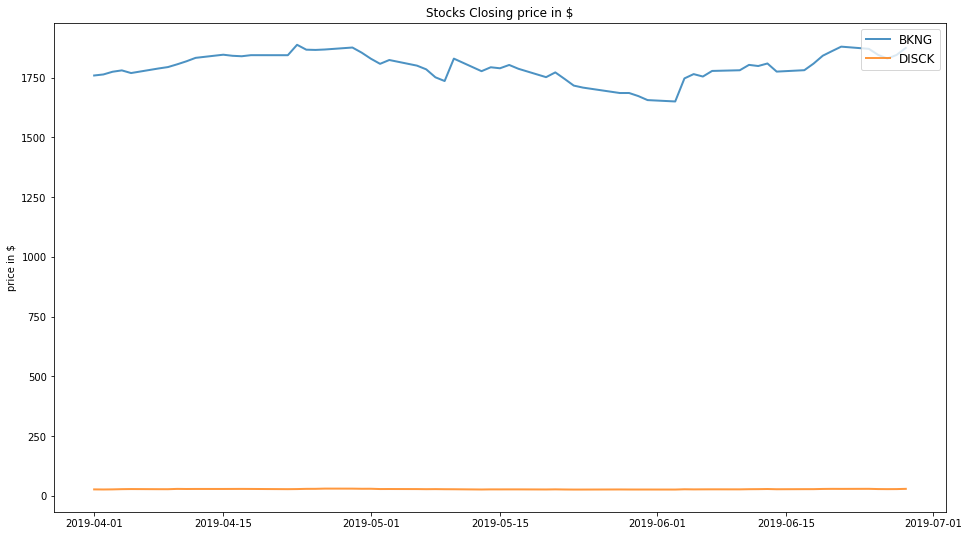

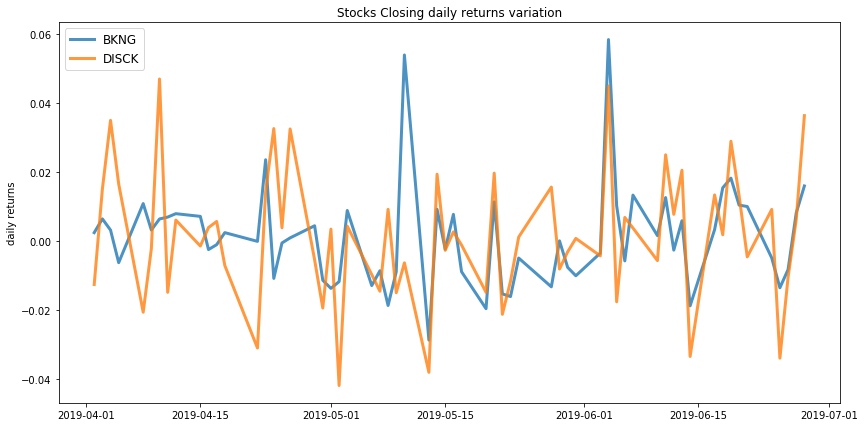

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.08
Annualised Volatility: 0.12


            BKNG  DISCK
allocation  52.3   47.7
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.08
Annualised Volatility: 0.11


            BKNG  DISCK
allocation  73.7   26.3


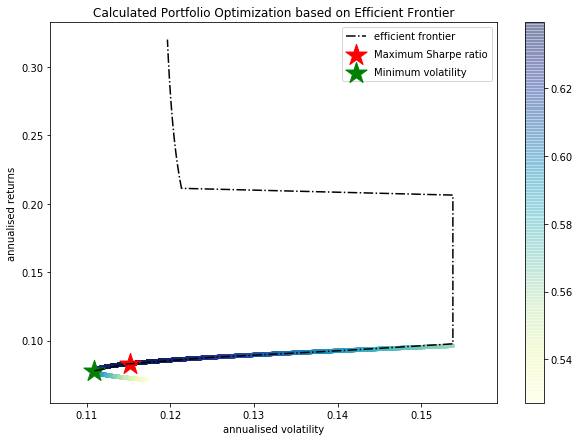

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BKNG : annuaised return 0.07 , annualised volatility: 0.12
DISCK : annuaised return 0.1 , annualised volatility: 0.15
--------------------------------------------------------------------------------


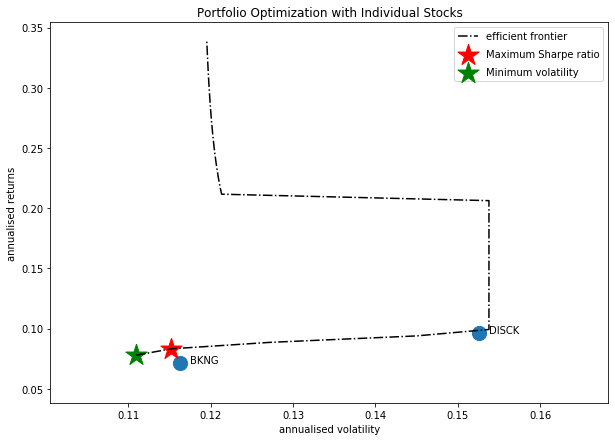

Companies listed in quarter 6 which is between 2019-07-01 and 2019-10-01
['BKNG' 'AMGN' 'EQIX' 'BLK' 'ANTM' 'ECL' 'CMG' 'DHI' 'AMD']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMGN', 'ECL']


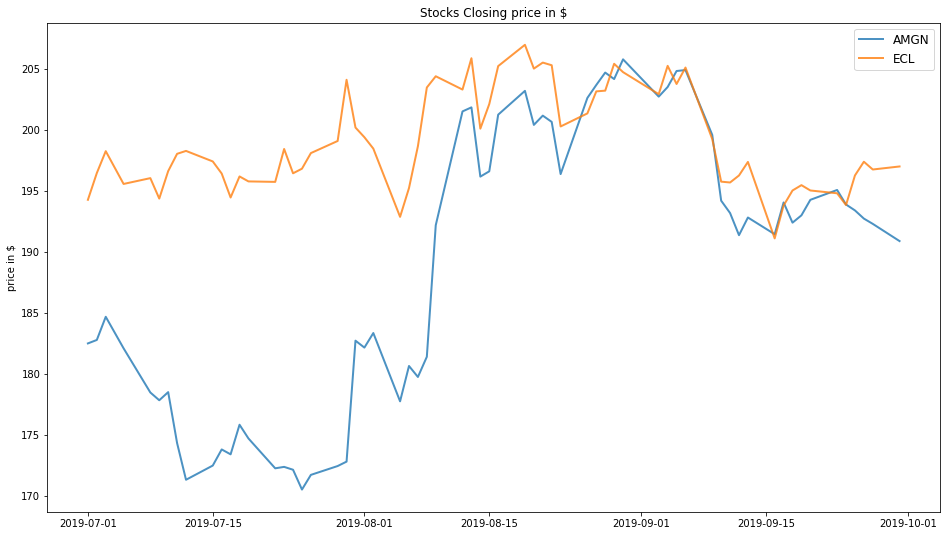

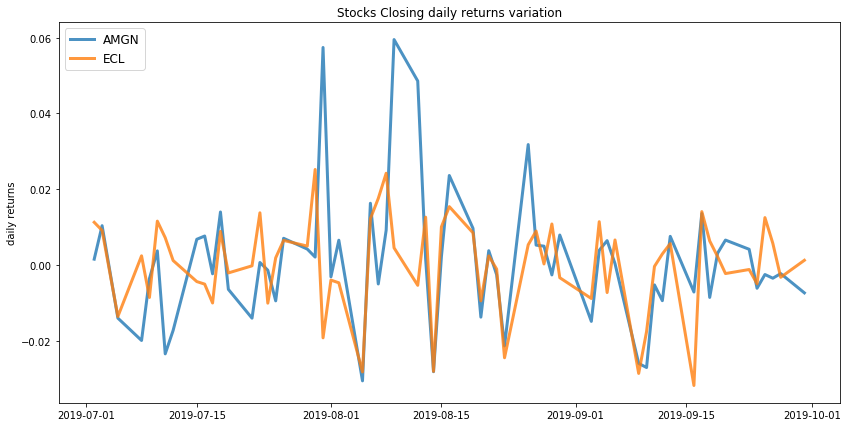

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.05
Annualised Volatility: 0.14


             AMGN  ECL
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.03
Annualised Volatility: 0.09


             AMGN    ECL
allocation  26.86  73.14


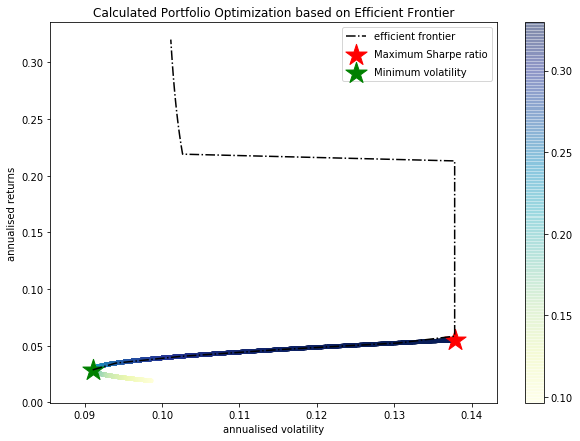

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.05 , annualised volatility: 0.14
ECL : annuaised return 0.02 , annualised volatility: 0.1
--------------------------------------------------------------------------------


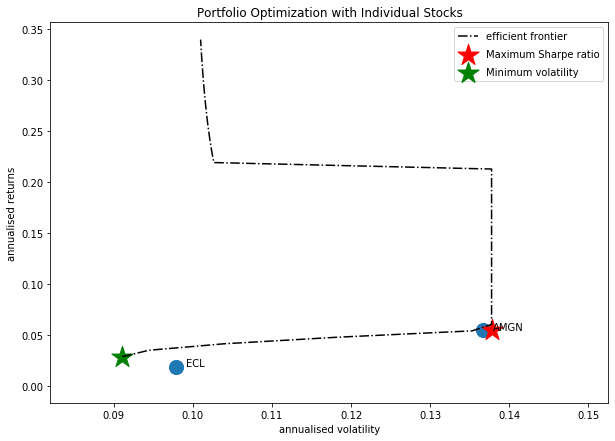

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMGN', 'CMG']


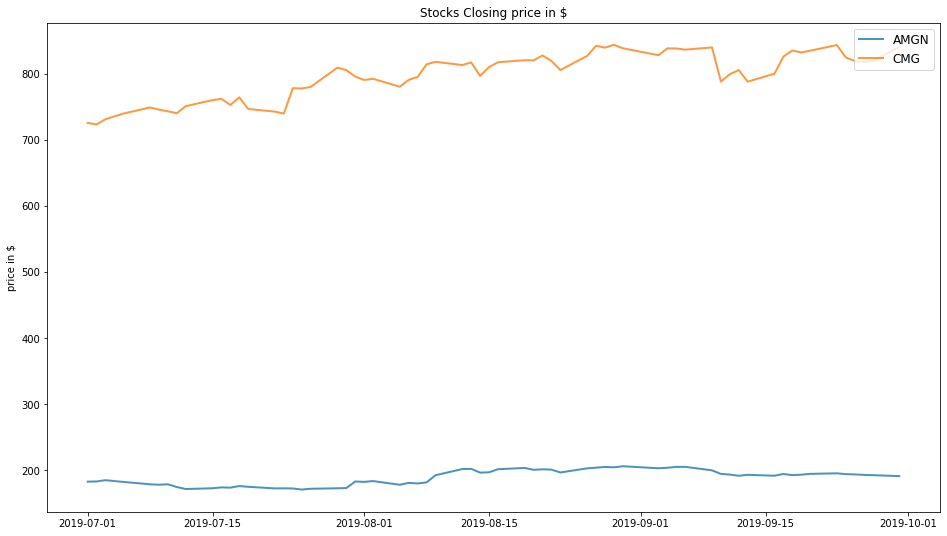

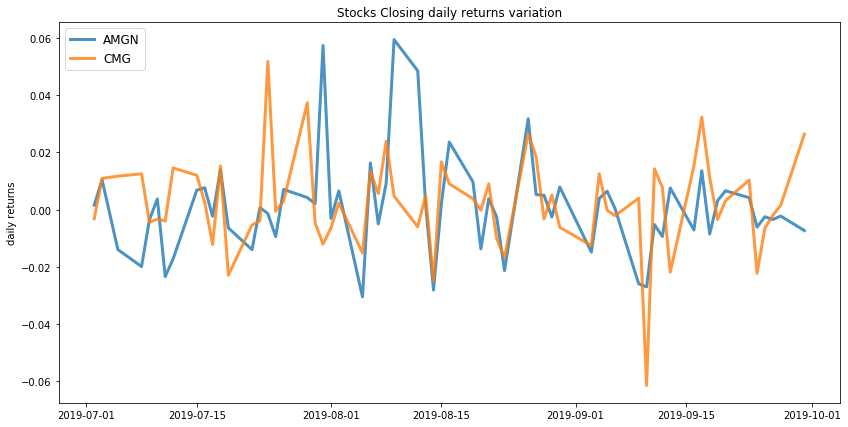

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.15
Annualised Volatility: 0.13


            AMGN    CMG
allocation  5.01  94.99
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.11
Annualised Volatility: 0.11


             AMGN    CMG
allocation  47.46  52.54


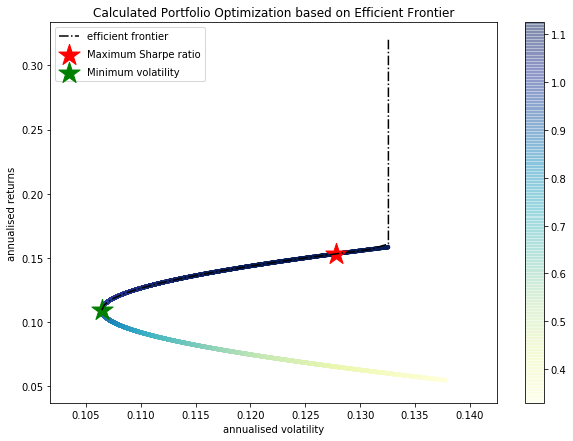

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.05 , annualised volatility: 0.14
CMG : annuaised return 0.16 , annualised volatility: 0.13
--------------------------------------------------------------------------------


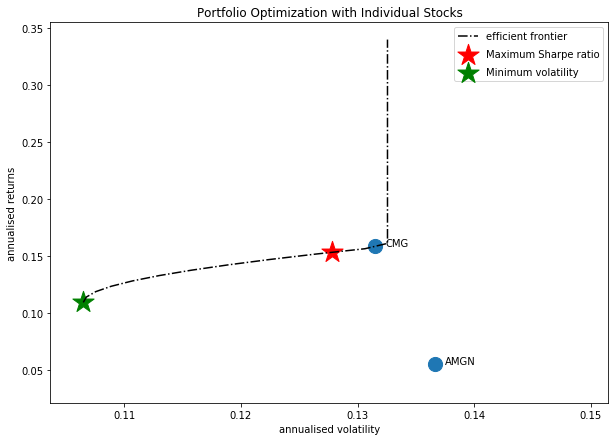

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'ECL']


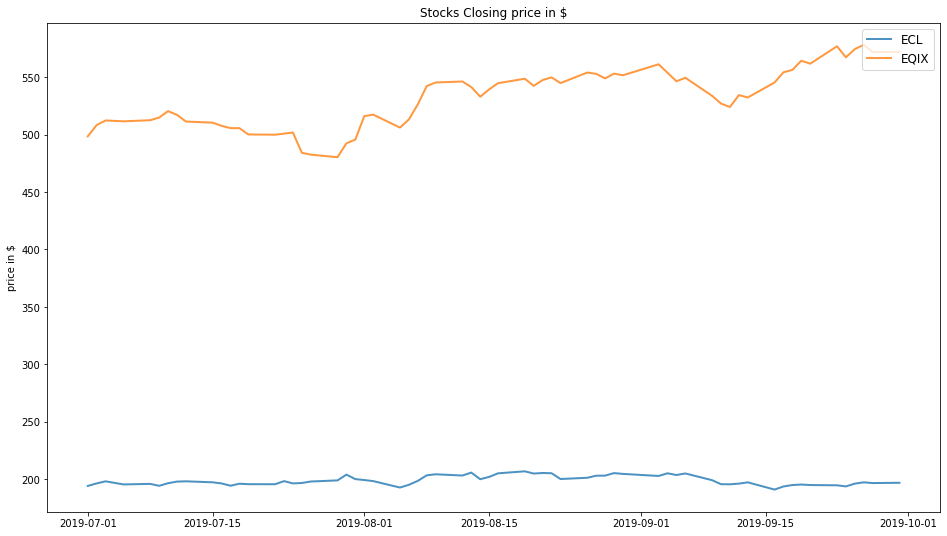

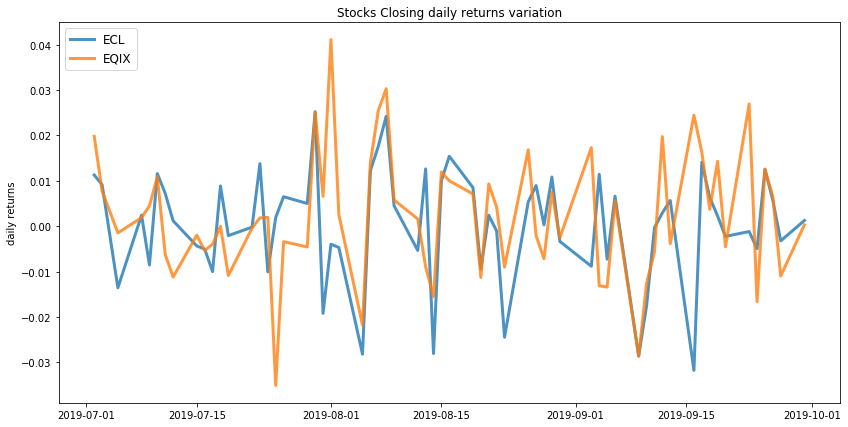

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.15
Annualised Volatility: 0.11


            ECL   EQIX
allocation  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.07
Annualised Volatility: 0.09


              ECL   EQIX
allocation  61.59  38.41


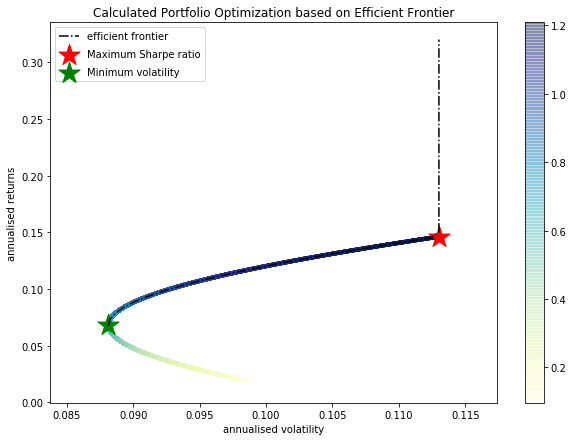

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ECL : annuaised return 0.02 , annualised volatility: 0.1
EQIX : annuaised return 0.15 , annualised volatility: 0.11
--------------------------------------------------------------------------------


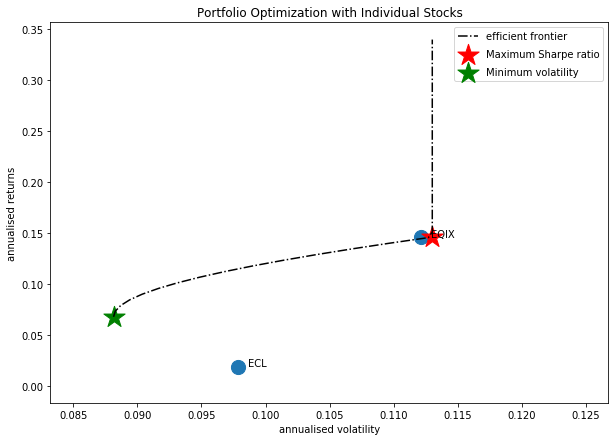

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'CMG']


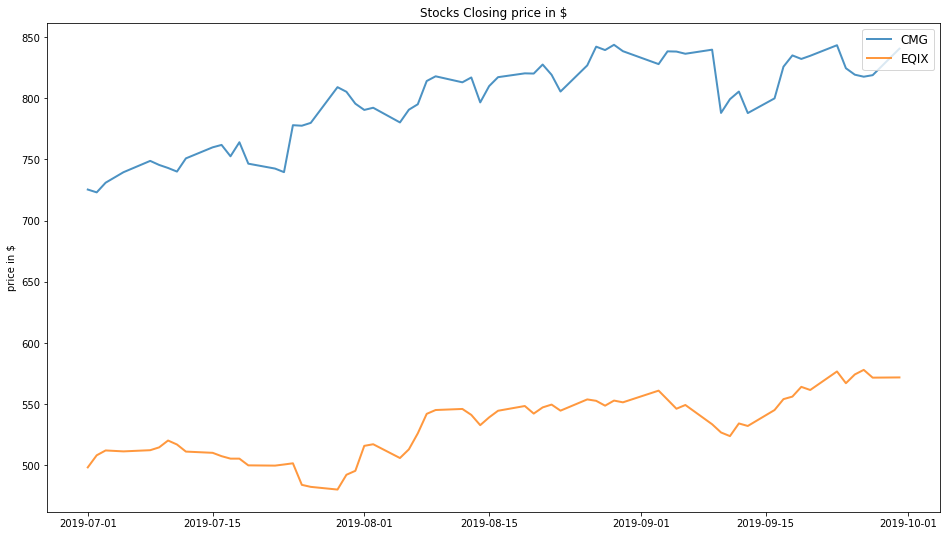

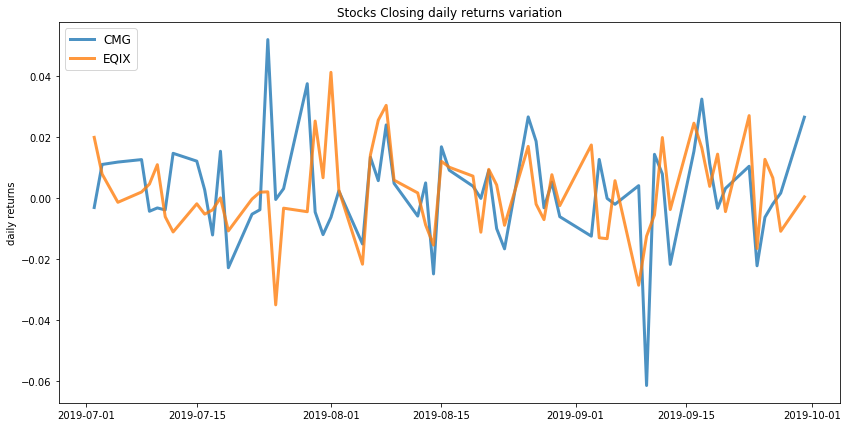

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.15
Annualised Volatility: 0.1


              CMG   EQIX
allocation  42.91  57.09
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.15
Annualised Volatility: 0.1


              CMG   EQIX
allocation  39.26  60.74


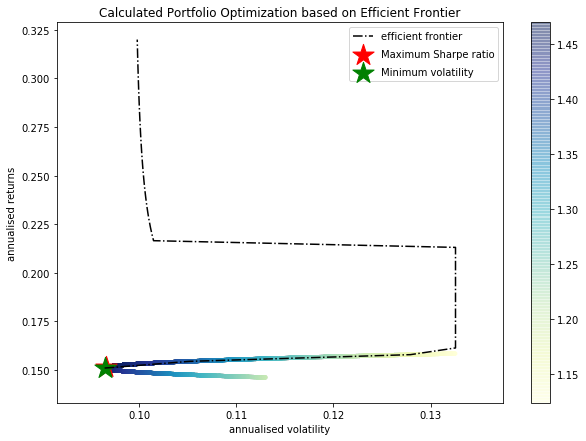

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

CMG : annuaised return 0.16 , annualised volatility: 0.13
EQIX : annuaised return 0.15 , annualised volatility: 0.11
--------------------------------------------------------------------------------


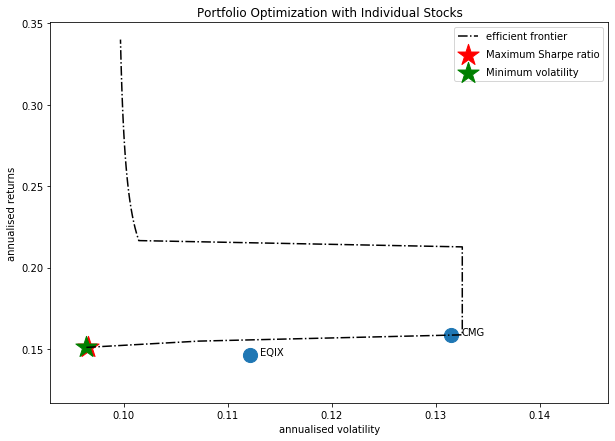

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BLK', 'ECL']


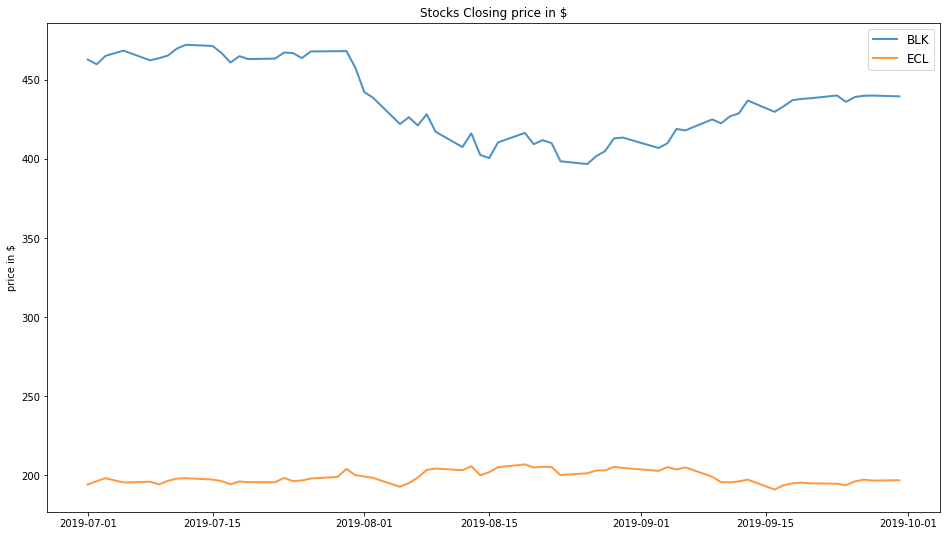

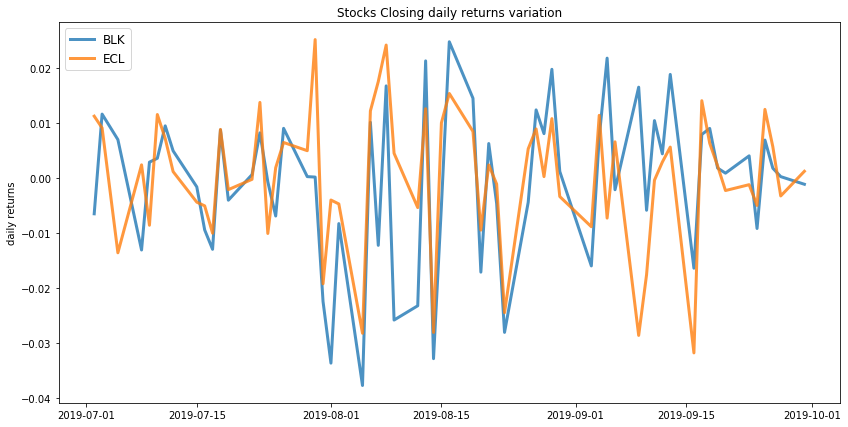

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.02
Annualised Volatility: 0.1


            BLK    ECL
allocation  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.0
Annualised Volatility: 0.09


              BLK    ECL
allocation  35.64  64.36


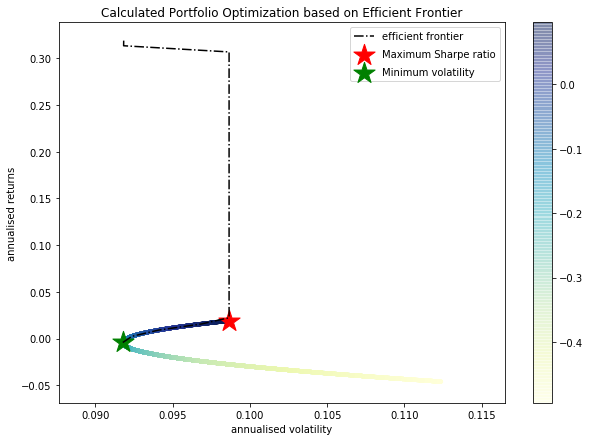

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BLK : annuaised return -0.05 , annualised volatility: 0.11
ECL : annuaised return 0.02 , annualised volatility: 0.1
--------------------------------------------------------------------------------


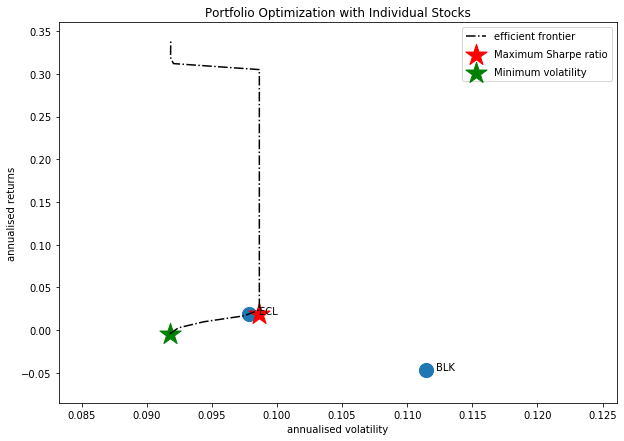

Companies listed in quarter 7 which is between 2019-10-01 and 2020-01-01
['AAPL' 'BIIB' 'EQIX' 'BKNG' 'BLK' 'SHW' 'AMD' 'ALGN' 'ALXN' 'GOOGL']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AAPL', 'EQIX', 'BLK', 'SHW']


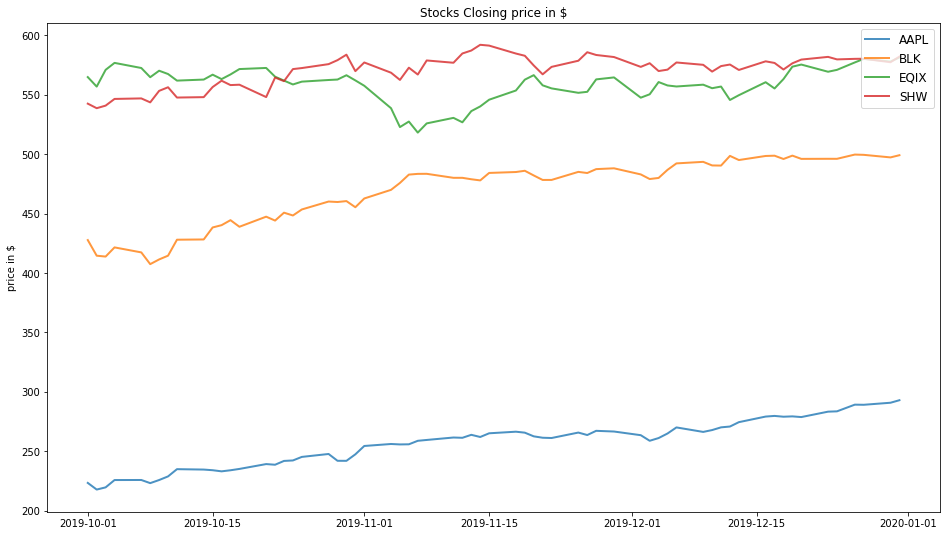

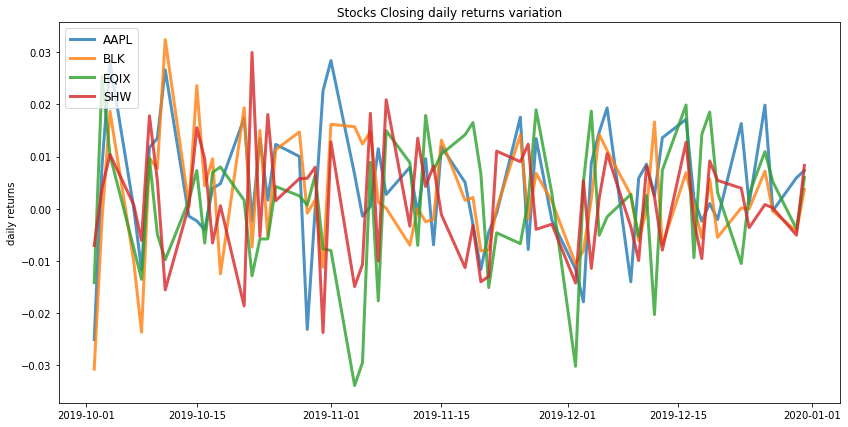

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.23
Annualised Volatility: 0.07


             AAPL  BLK  EQIX    SHW
allocation  77.17  0.0   0.0  22.83
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.13
Annualised Volatility: 0.06


             AAPL   BLK   EQIX    SHW
allocation  23.05  22.3  20.46  34.19


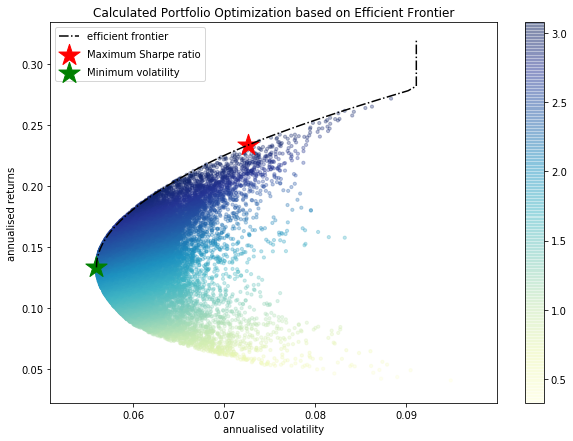

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.28 , annualised volatility: 0.09
BLK : annuaised return 0.16 , annualised volatility: 0.09
EQIX : annuaised return 0.03 , annualised volatility: 0.1
SHW : annuaised return 0.08 , annualised volatility: 0.09
--------------------------------------------------------------------------------


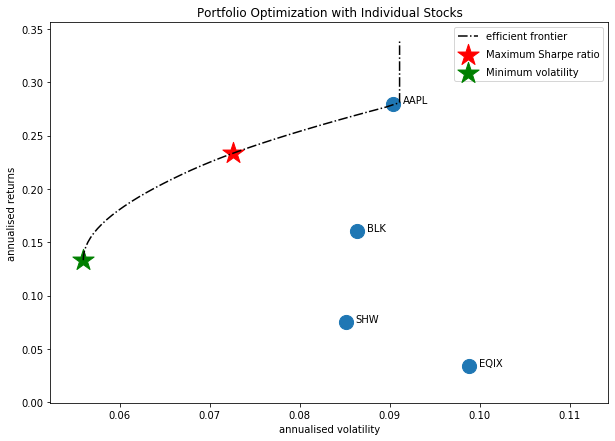

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'BLK', 'SHW']


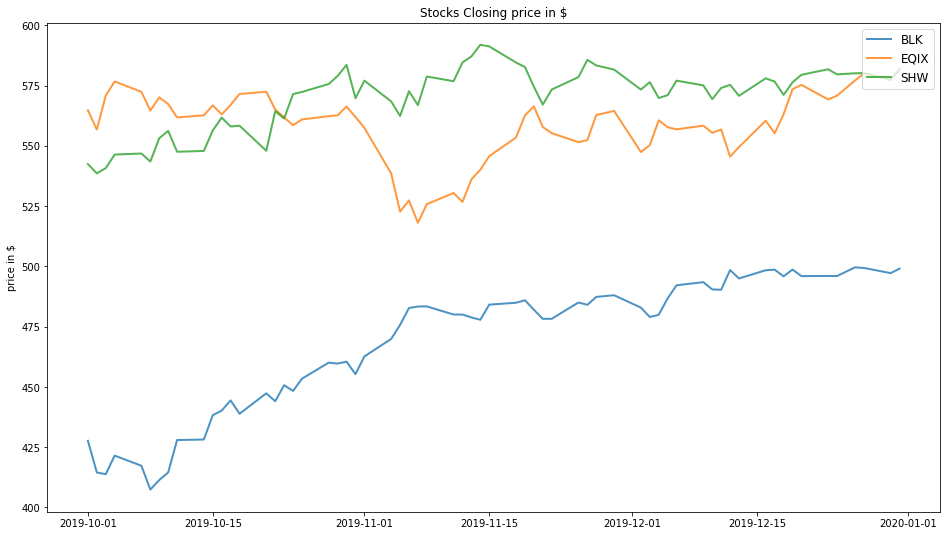

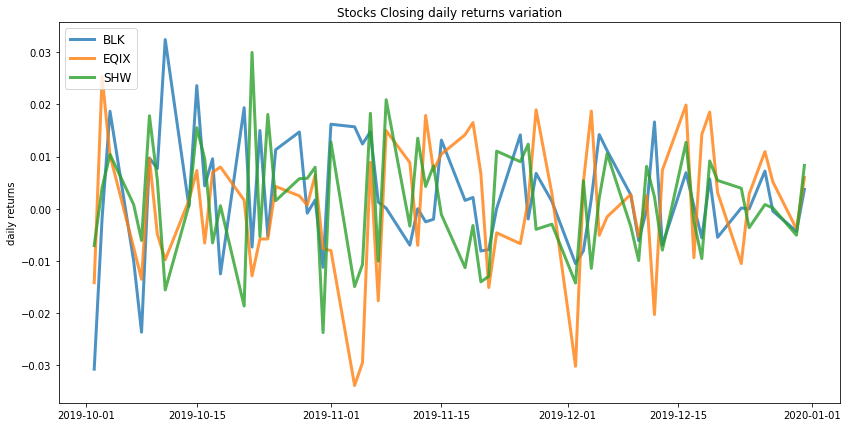

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.14
Annualised Volatility: 0.07


              BLK  EQIX    SHW
allocation  74.22  1.65  24.13
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.1
Annualised Volatility: 0.06


              BLK  EQIX    SHW
allocation  39.92  26.1  33.98


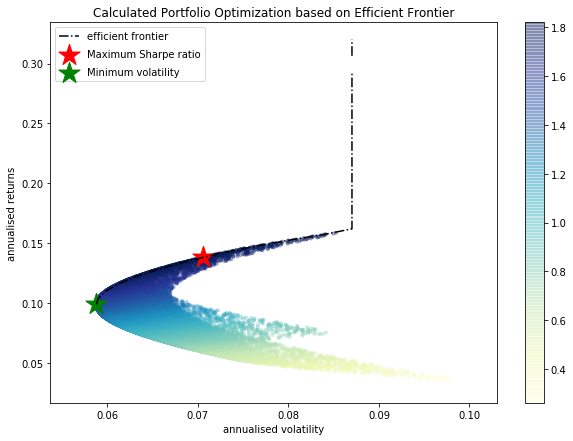

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BLK : annuaised return 0.16 , annualised volatility: 0.09
EQIX : annuaised return 0.03 , annualised volatility: 0.1
SHW : annuaised return 0.08 , annualised volatility: 0.09
--------------------------------------------------------------------------------


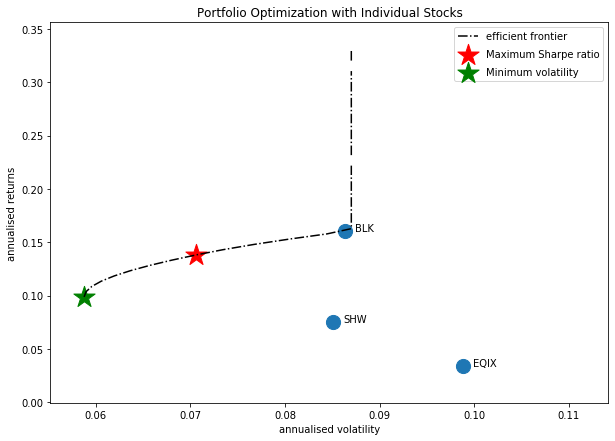

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AMD']


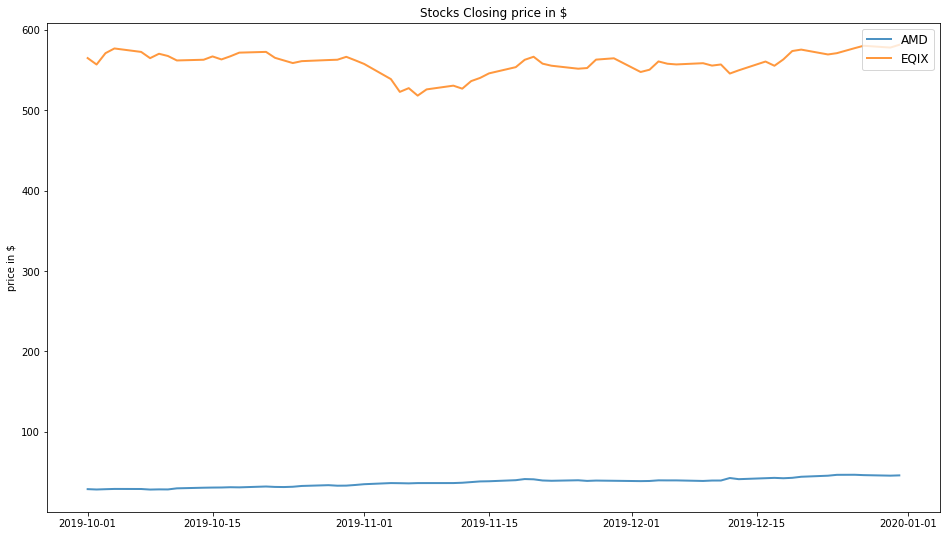

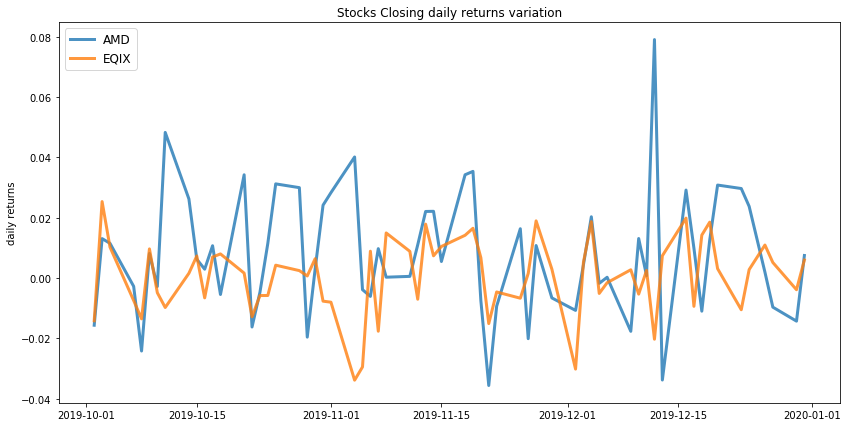

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.45
Annualised Volatility: 0.15


              AMD  EQIX
allocation  91.79  8.21
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.15
Annualised Volatility: 0.09


              AMD   EQIX
allocation  26.33  73.67


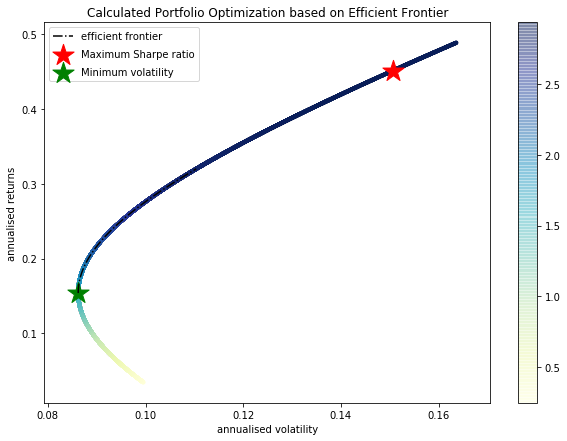

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 0.49 , annualised volatility: 0.16
EQIX : annuaised return 0.03 , annualised volatility: 0.1
--------------------------------------------------------------------------------


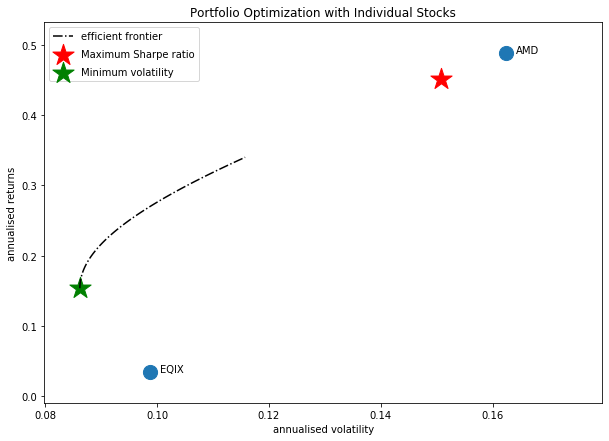

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'ALGN']


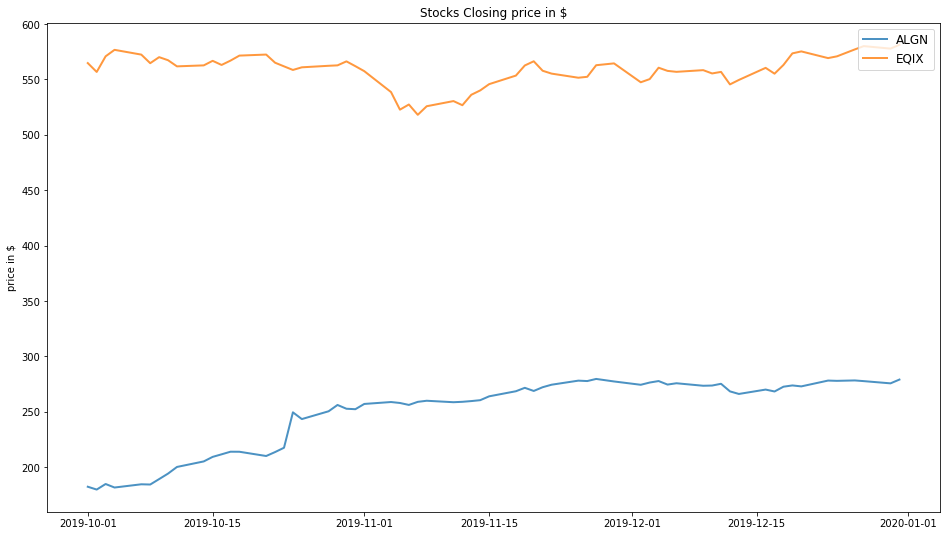

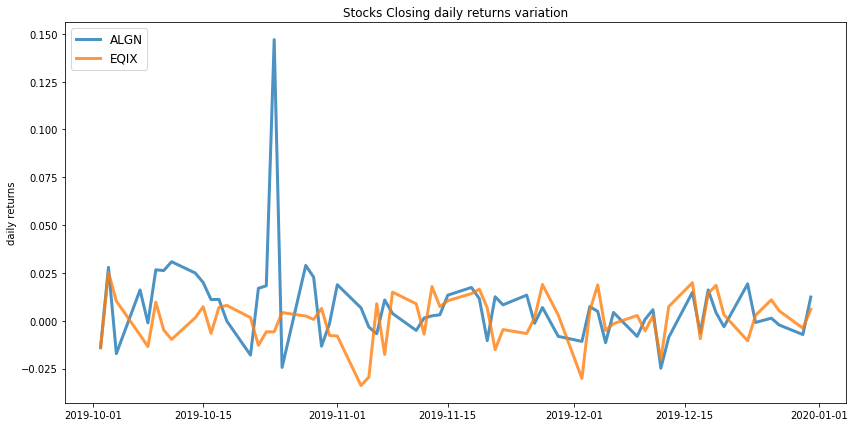

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.4
Annualised Volatility: 0.16


             ALGN   EQIX
allocation  88.11  11.89
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.13
Annualised Volatility: 0.09


             ALGN   EQIX
allocation  23.27  76.73


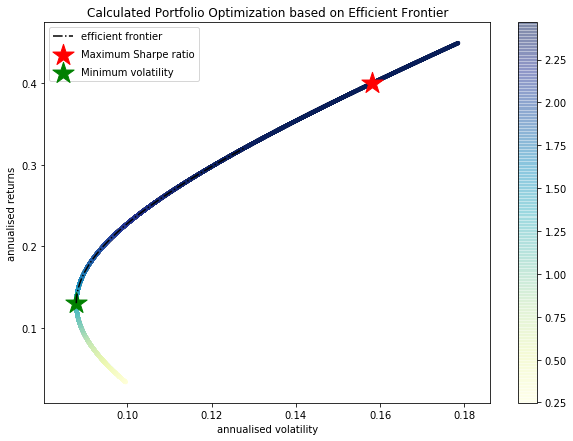

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ALGN : annuaised return 0.45 , annualised volatility: 0.18
EQIX : annuaised return 0.03 , annualised volatility: 0.1
--------------------------------------------------------------------------------


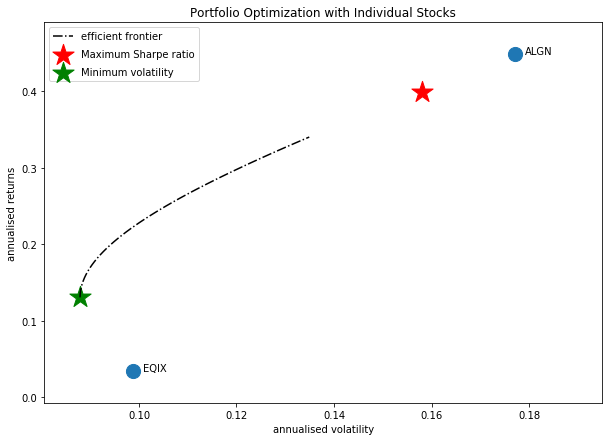

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'BLK']


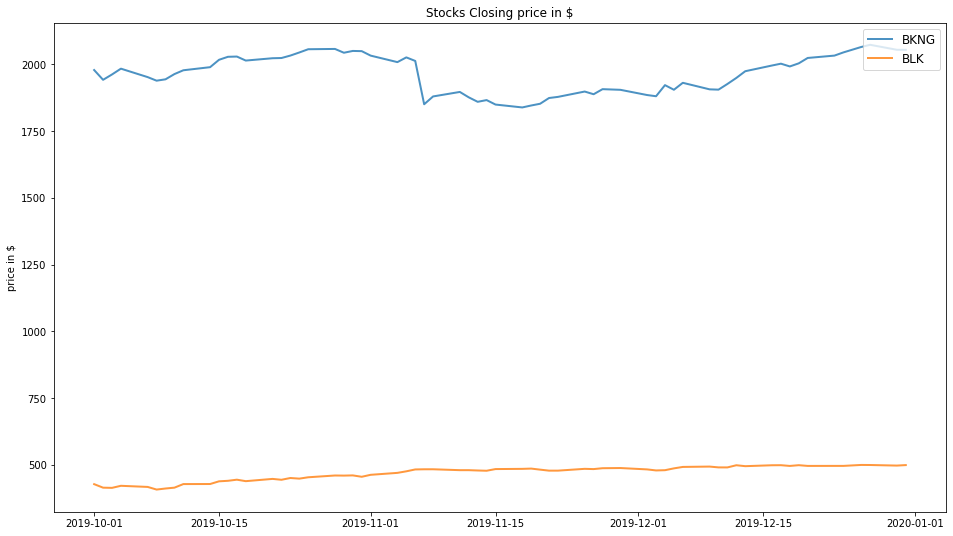

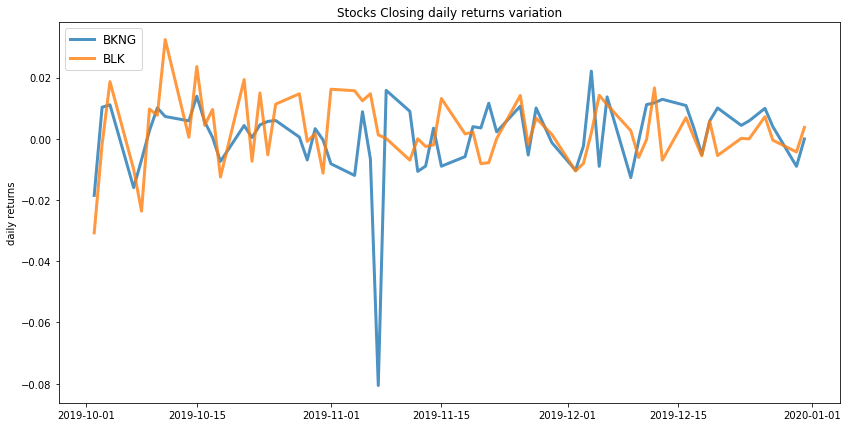

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.16
Annualised Volatility: 0.09


            BKNG    BLK
allocation   0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.12
Annualised Volatility: 0.07


             BKNG    BLK
allocation  36.15  63.85


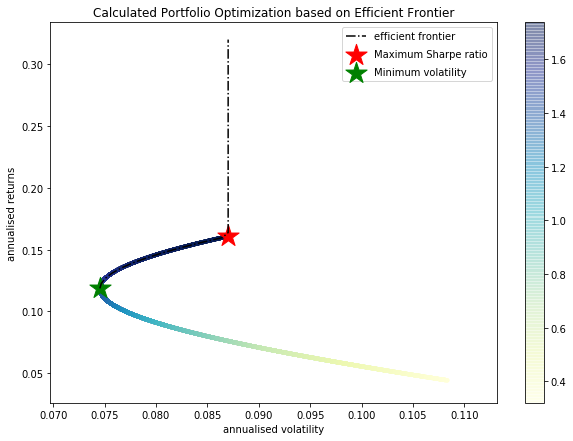

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BKNG : annuaised return 0.04 , annualised volatility: 0.11
BLK : annuaised return 0.16 , annualised volatility: 0.09
--------------------------------------------------------------------------------


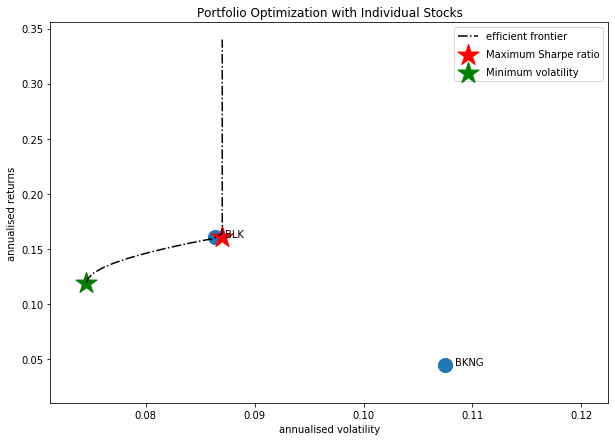

Companies listed in quarter 8 which is between 2020-01-01 and 2020-04-01
['AMZN' 'EQIX' 'SHW' 'BA' 'CTXS' 'BMY' 'PPG']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'SHW', 'CTXS']


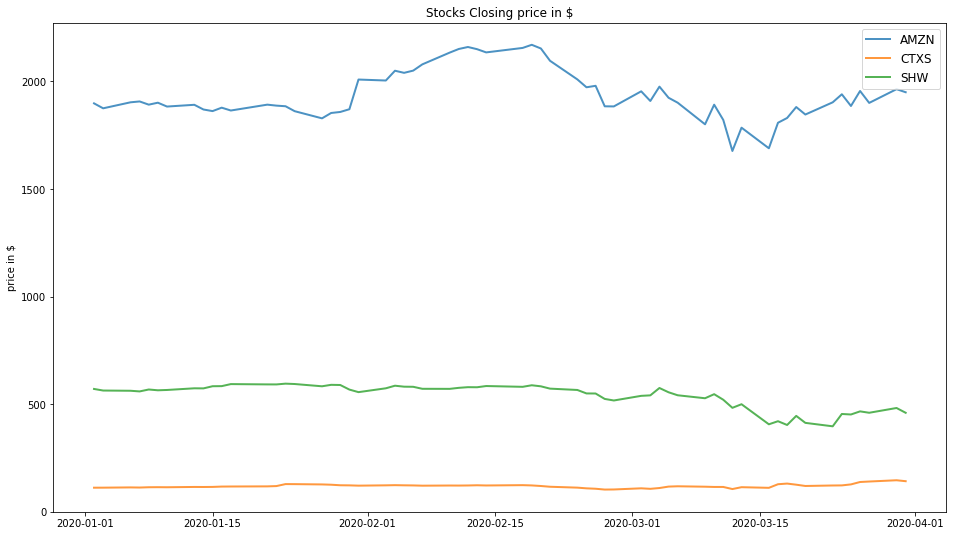

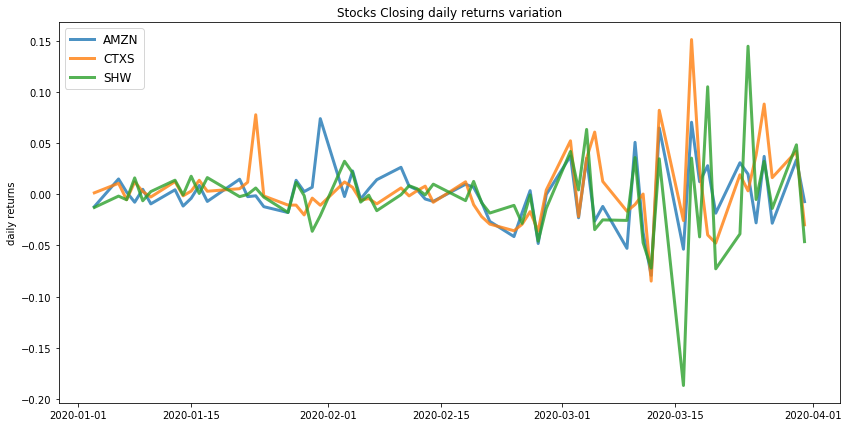

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.28
Annualised Volatility: 0.28


            AMZN   CTXS  SHW
allocation   0.0  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.09
Annualised Volatility: 0.22


             AMZN   CTXS   SHW
allocation  64.38  26.77  8.85


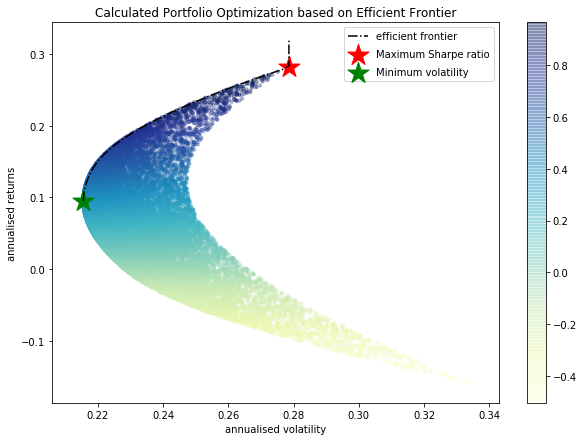

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.05 , annualised volatility: 0.22
CTXS : annuaised return 0.28 , annualised volatility: 0.28
SHW : annuaised return -0.16 , annualised volatility: 0.33
--------------------------------------------------------------------------------


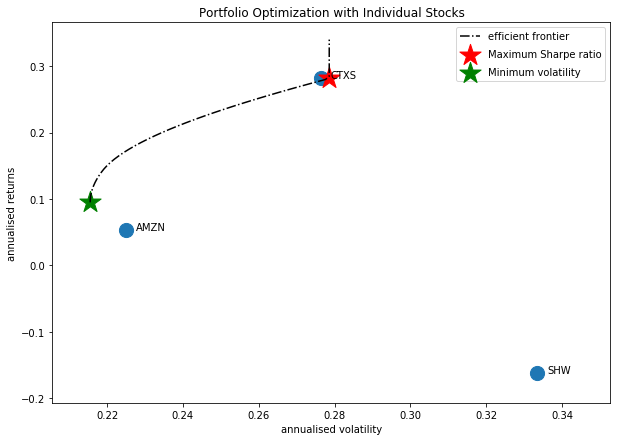

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'BMY']


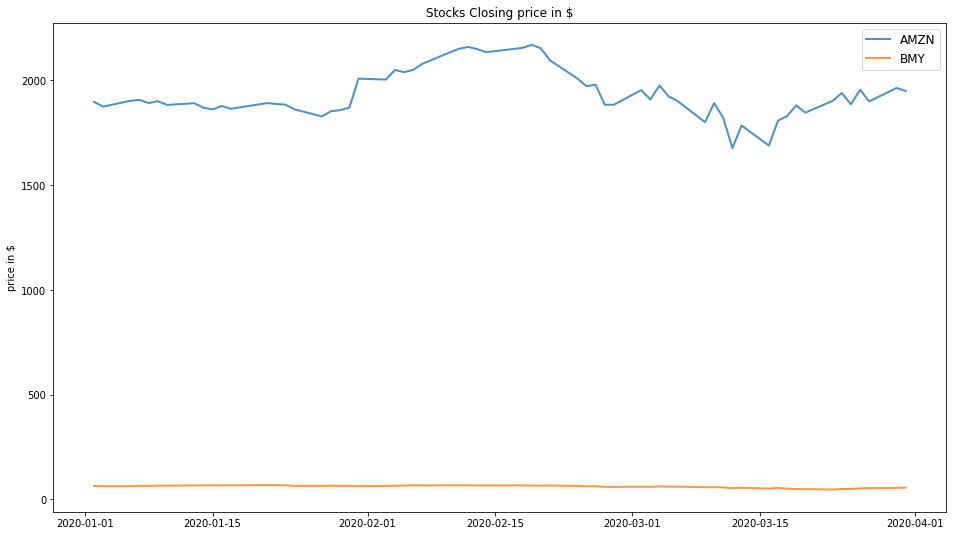

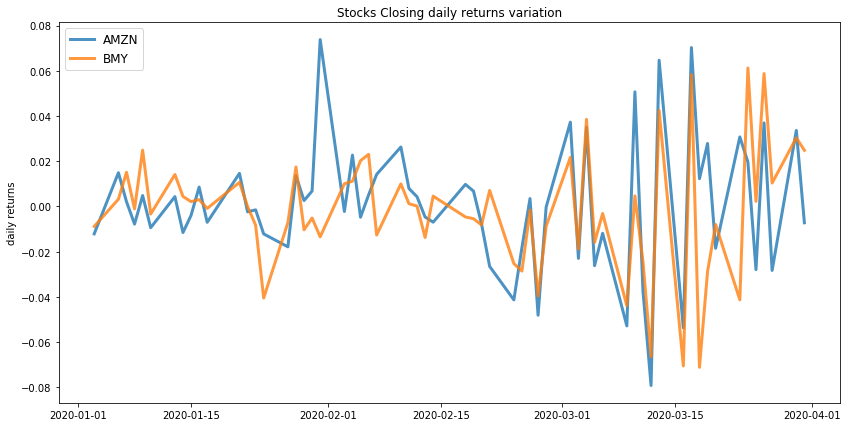

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.05
Annualised Volatility: 0.23


             AMZN  BMY
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.04
Annualised Volatility: 0.2


             AMZN    BMY
allocation  43.46  56.54


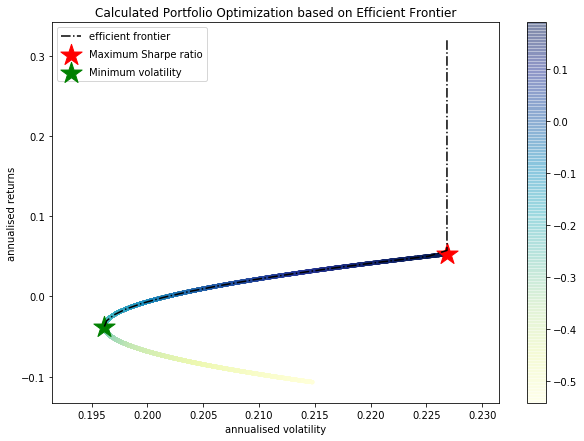

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.05 , annualised volatility: 0.22
BMY : annuaised return -0.11 , annualised volatility: 0.21
--------------------------------------------------------------------------------


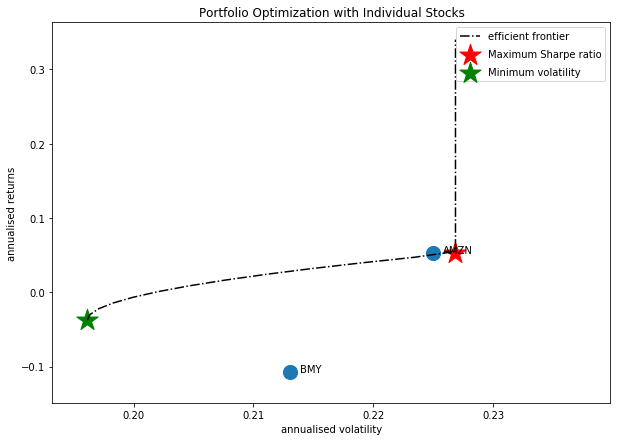

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'PPG']


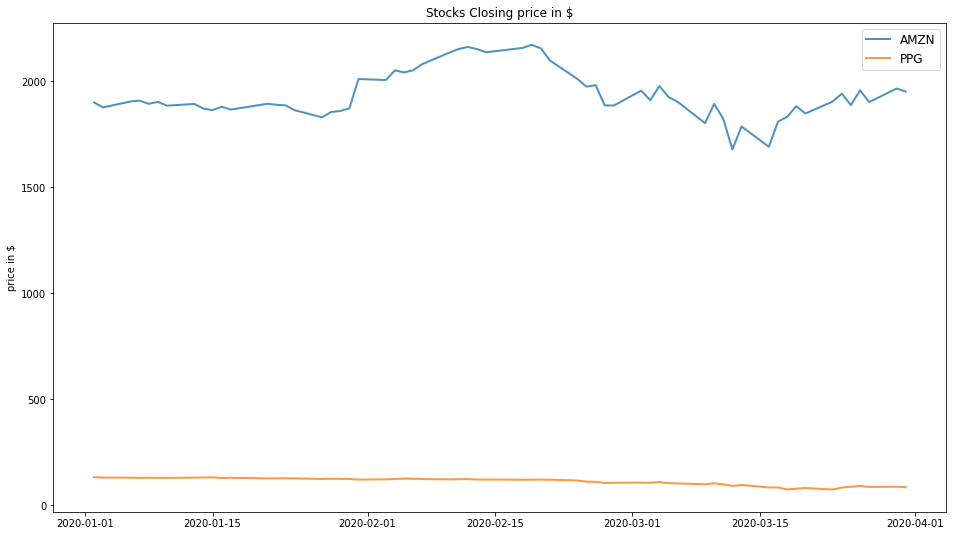

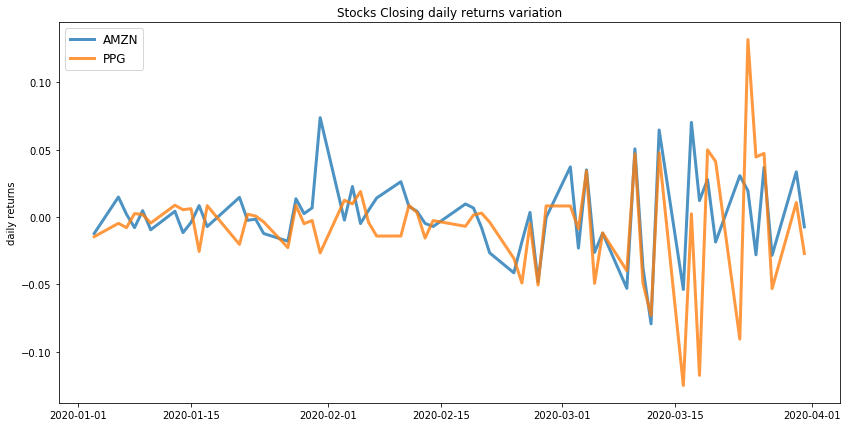

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.05
Annualised Volatility: 0.23


             AMZN  PPG
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.06
Annualised Volatility: 0.22


             AMZN    PPG
allocation  75.59  24.41


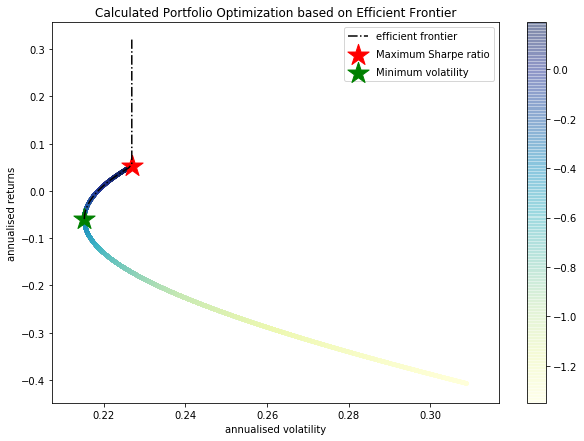

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.05 , annualised volatility: 0.22
PPG : annuaised return -0.41 , annualised volatility: 0.31
--------------------------------------------------------------------------------


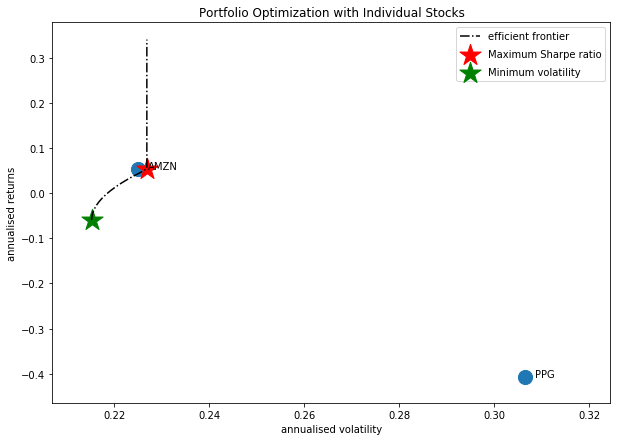

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['SHW', 'BA']


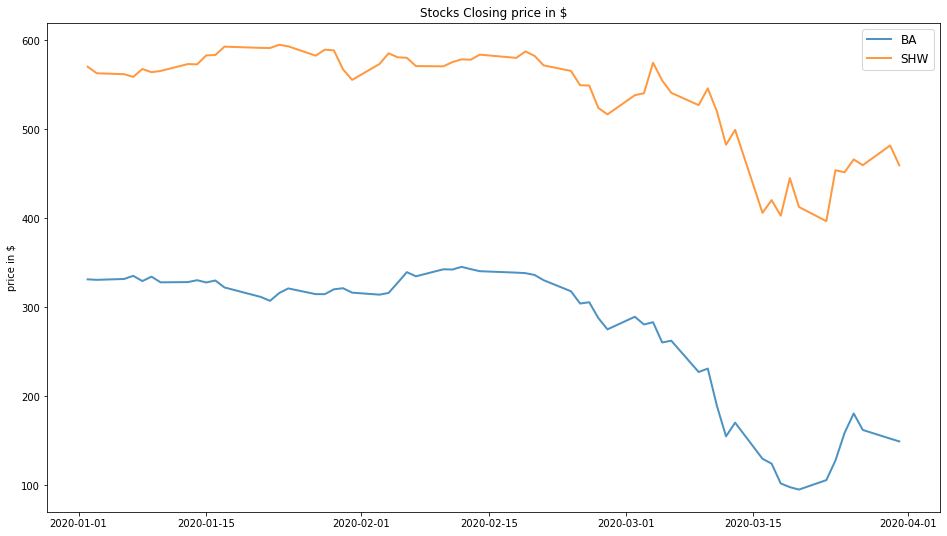

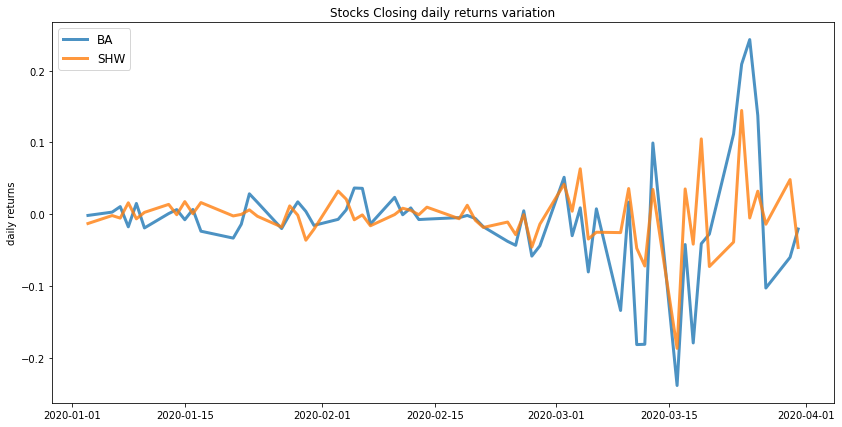

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: -0.16
Annualised Volatility: 0.34


             BA    SHW
allocation  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.16
Annualised Volatility: 0.34


             BA    SHW
allocation  0.0  100.0


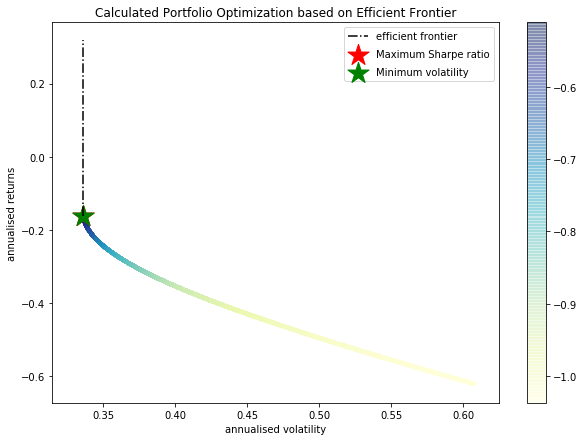

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BA : annuaised return -0.62 , annualised volatility: 0.6
SHW : annuaised return -0.16 , annualised volatility: 0.33
--------------------------------------------------------------------------------


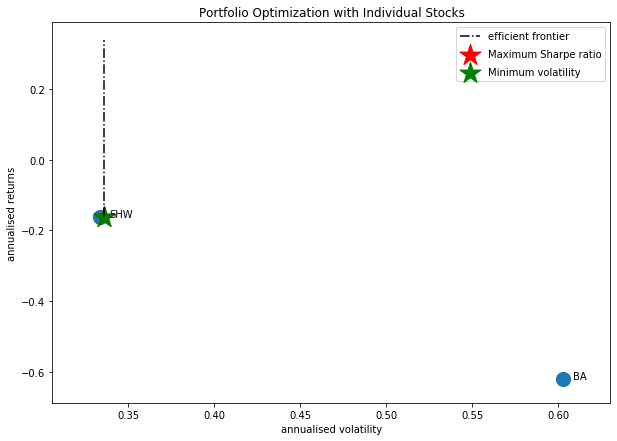

[[2.0216826797934853, 0.38, 0.18, ['EQIX', 'AMD'], array([[73.06, 26.94]]), '2018-04-01'], [2.031828159346357, 0.35, 0.17, ['EQIX', 'DVN'], array([[86.04, 13.96]]), '2018-04-01'], [1.997683077368238, 0.45, 0.22, ['AZO', 'AMD'], array([[88.53, 11.47]]), '2018-04-01'], [1.992680293392031, 0.49, 0.24, ['AMD', 'BLK'], array([[100.,   0.]]), '2018-04-01'], [2.539573199888295, 0.77, 0.3, ['AMD', 'CMG'], array([[100.,   0.]]), '2018-07-01'], [2.1243390043589025, 0.16, 0.07, ['AMZN', 'AZO', 'CMG'], array([[42.1 , 54.13,  3.77]]), '2018-07-01'], [-1.0428061076844541, -0.17, 0.17, ['ALGN', 'BLK'], array([[  0., 100.]]), '2018-10-01'], [-0.8963456103259252, -0.13, 0.16, ['ALGN', 'BKNG'], array([[  0., 100.]]), '2018-10-01'], [-0.5529007107408587, -0.06, 0.12, ['ALGN', 'BXP'], array([[  0., 100.]]), '2018-10-01'], [1.1437729780265893, 0.16, 0.13, ['BKNG', 'BA', 'BIIB', 'STZ'], array([[77.95,  0.  ,  0.  , 22.05]]), '2019-01-01'], [0.9712795501526286, 0.26, 0.26, ['BKNG', 'FCX'], array([[  0., 100.

In [15]:
quarter_list=["2018-04-01", "2018-07-01", "2018-10-01", "2019-01-01", "2019-04-01", "2019-07-01", "2019-10-01", "2020-01-01", "2020-04-01"]
## Taken from
# https://www.treasury.gov/resource-center/data-chart-center/interest-rates/Pages/TextView.aspx?data=billRatesYear&year=2018
# 13 weeks period, COUPON EQUIVALENT, based on last possible date of each quarter
risk_free_rates = [1.93, 2.19, 2.45, 2.40, 2.13, 1.88, 1.55, 0.03]

returns_sharpe_company_list = []
for idx in range(1, len(quarter_list)):
    df_quarter_data = new_df[(new_df["start_date"] >= quarter_list[idx-1]) & (new_df["start_date"]< quarter_list[idx])]
    print("Companies listed in quarter {} which is between {} and {}".format(idx, quarter_list[idx-1], quarter_list[idx]))
    list_of_companies = df_quarter_data["symbol"].unique()
    #generate the stocks pairs which are uncorrelated and having covariance less than mean covariance 
    stocks_pair = get_portfolio_pairs(list_of_companies)
    #print(stocks_pair)
    for stock_list in stocks_pair:
        print("perform efficient_frontier_stock_portfolio Pairs of the companies we got {}".format(stock_list))
        pos_sharpe, Annualised_Return, Annualised_Volatility, allocation_weights = efficient_frontier_stock_portfolio(stock_list, len(stock_list), risk_free_rates[idx-1], quarter_list[idx-1], quarter_list[idx])
        returns_sharpe_company_list.append([pos_sharpe, Annualised_Return, Annualised_Volatility, stock_list, allocation_weights, quarter_list[idx-1]])
print(returns_sharpe_company_list)

In [16]:
shortlisted_portfolio_df = pd.DataFrame(returns_sharpe_company_list)

In [17]:
shortlisted_portfolio_df.columns = ["Sharpe Ratio", "Portfolio Annualised Return", "Portfolio Annualised_Volatility", "Stock Portfolio", "Stocks Weight Allocation", "Quarter Start Date"]

### we know that higher the sharpe ratio value the stocks have a good returns with consideration of the risk in  the investment and for the portfolio we tag quantitative values such as below for the portfolio generated:

#### Sharpe Ratio >=  3 ---> "Excellent Portfolio"

#### Sharpe Ratio >=  2 ---> "Very Good Portfolio"

#### Sharpe Ratio >= 1 ---> "Good Portfolio"

#### Sharpe Ratio < 1 ---> "Bad Portfolio"

In [18]:
# creating a blank series 
Portfolio_Tag = pd.Series([]) 

for row in range(len(shortlisted_portfolio_df)):
    if (shortlisted_portfolio_df["Sharpe Ratio"][row] >= 3):
        Portfolio_Tag[row] = "Excellent"
    elif (shortlisted_portfolio_df["Sharpe Ratio"][row] >= 2 and (shortlisted_portfolio_df["Sharpe Ratio"][row] < 3)):
        Portfolio_Tag[row] = "Very Good"
    elif ((shortlisted_portfolio_df["Sharpe Ratio"][row] >= 1)  and (shortlisted_portfolio_df["Sharpe Ratio"][row] < 2)):
        Portfolio_Tag[row] = "Good"
    else:
        Portfolio_Tag[row] = "Bad"
        
# inserting new column with values of list made above         
shortlisted_portfolio_df.insert(5, "Portfolio Tag", Portfolio_Tag) 

## Possible combinations of the company from which we will take the final Portfolio list

In [19]:
shortlisted_portfolio_df

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag,Quarter Start Date
0,2.021683,0.38,0.18,"[EQIX, AMD]","[[73.06, 26.94]]",Very Good,2018-04-01
1,2.031828,0.35,0.17,"[EQIX, DVN]","[[86.04, 13.96]]",Very Good,2018-04-01
2,1.997683,0.45,0.22,"[AZO, AMD]","[[88.53, 11.47]]",Good,2018-04-01
3,1.992680,0.49,0.24,"[AMD, BLK]","[[100.0, 0.0]]",Good,2018-04-01
4,2.539573,0.77,0.30,"[AMD, CMG]","[[100.0, 0.0]]",Very Good,2018-07-01
5,2.124339,0.16,0.07,"[AMZN, AZO, CMG]","[[42.1, 54.13, 3.77]]",Very Good,2018-07-01
6,-1.042806,-0.17,0.17,"[ALGN, BLK]","[[0.0, 100.0]]",Bad,2018-10-01
7,-0.896346,-0.13,0.16,"[ALGN, BKNG]","[[0.0, 100.0]]",Bad,2018-10-01
8,-0.552901,-0.06,0.12,"[ALGN, BXP]","[[0.0, 100.0]]",Bad,2018-10-01
9,1.143773,0.16,0.13,"[BKNG, BA, BIIB, STZ]","[[77.95, 0.0, 0.0, 22.05]]",Good,2019-01-01


In [20]:
shortlisted_portfolio = shortlisted_portfolio_df[(shortlisted_portfolio_df["Portfolio Tag"] == "Excellent") | (shortlisted_portfolio_df["Portfolio Tag"] == "Very Good") |
                                                    (shortlisted_portfolio_df["Portfolio Tag"] == "Good")]

In [21]:
shortlisted_portfolio = shortlisted_portfolio.sort_values(by="Sharpe Ratio", ascending=False)

In [22]:
shortlisted_portfolio

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag,Quarter Start Date
12,3.709027,0.36,0.09,"[CMG, AZO]","[[48.45, 51.55]]",Excellent,2019-01-01
13,3.303548,0.41,0.12,"[BKNG, CMG, BA, BIIB, STZ]","[[24.46, 0.0, 2.04, 73.51, 0.0]]",Excellent,2019-01-01
11,3.302400,0.41,0.12,"[CMG, BA, BIIB, STZ]","[[25.4, 0.0, 74.6, 0.0]]",Excellent,2019-01-01
27,3.083840,0.23,0.07,"[AAPL, EQIX, BLK, SHW]","[[77.17, 0.0, 0.0, 22.83]]",Excellent,2019-10-01
29,2.932984,0.45,0.15,"[EQIX, AMD]","[[91.79, 8.21]]",Very Good,2019-10-01
4,2.539573,0.77,0.30,"[AMD, CMG]","[[100.0, 0.0]]",Very Good,2018-07-01
30,2.467127,0.40,0.16,"[EQIX, ALGN]","[[88.11, 11.89]]",Very Good,2019-10-01
5,2.124339,0.16,0.07,"[AMZN, AZO, CMG]","[[42.1, 54.13, 3.77]]",Very Good,2018-07-01
1,2.031828,0.35,0.17,"[EQIX, DVN]","[[86.04, 13.96]]",Very Good,2018-04-01
0,2.021683,0.38,0.18,"[EQIX, AMD]","[[73.06, 26.94]]",Very Good,2018-04-01


# Top 5 stock portfolios to be taken from the data (User to choose)

In [23]:
shortlisted_portfolio[:5]

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag,Quarter Start Date
12,3.709027,0.36,0.09,"[CMG, AZO]","[[48.45, 51.55]]",Excellent,2019-01-01
13,3.303548,0.41,0.12,"[BKNG, CMG, BA, BIIB, STZ]","[[24.46, 0.0, 2.04, 73.51, 0.0]]",Excellent,2019-01-01
11,3.302400,0.41,0.12,"[CMG, BA, BIIB, STZ]","[[25.4, 0.0, 74.6, 0.0]]",Excellent,2019-01-01
27,3.083840,0.23,0.07,"[AAPL, EQIX, BLK, SHW]","[[77.17, 0.0, 0.0, 22.83]]",Excellent,2019-10-01
29,2.932984,0.45,0.15,"[EQIX, AMD]","[[91.79, 8.21]]",Very Good,2019-10-01


## portfolio generated quarterwise from 2018 - 2020

In [24]:
shortlisted_portfolio_quarterwise_max_df = shortlisted_portfolio_df.groupby("Quarter Start Date")["Sharpe Ratio"].max().reset_index()

In [25]:
portfolio_quarterwise_max = pd.merge(left=shortlisted_portfolio_quarterwise_max_df, right=shortlisted_portfolio_df,left_on='Sharpe Ratio', right_on='Sharpe Ratio').drop(["Quarter Start Date_y"], axis=1)

In [26]:
portfolio_quarterwise_max

,Quarter Start Date_x,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag
0,2018-04-01,2.031828,0.35,0.17,"[EQIX, DVN]","[[86.04, 13.96]]",Very Good
1,2018-07-01,2.539573,0.77,0.30,"[AMD, CMG]","[[100.0, 0.0]]",Very Good
2,2018-10-01,-0.552901,-0.06,0.12,"[ALGN, BXP]","[[0.0, 100.0]]",Bad
3,2019-01-01,3.709027,0.36,0.09,"[CMG, AZO]","[[48.45, 51.55]]",Excellent
4,2019-04-01,1.777473,0.18,0.09,"[BLK, BKNG, EQIX, AZO, APC]","[[20.45, 14.51, 15.11, 0.0, 49.92]]",Good
5,2019-07-01,1.469454,0.15,0.10,"[EQIX, CMG]","[[42.91, 57.09]]",Good
6,2019-10-01,3.083840,0.23,0.07,"[AAPL, EQIX, BLK, SHW]","[[77.17, 0.0, 0.0, 22.83]]",Excellent
7,2020-01-01,0.976113,0.28,0.28,"[AMZN, SHW, CTXS]","[[0.0, 100.0, 0.0]]",Bad


## portfolio generated for the shortlisted companies for overall 2 yr period

In [27]:
portfolio_list

array(['EQIX', 'AMZN', 'AZO', 'AMD', 'CMG', 'BKNG', 'AAP', 'BA', 'BLK',
       'AMGN', 'AAPL', 'BIIB', 'ALGN', 'ANTM', 'SHW', 'STZ', 'ECL',
       'ADSK', 'DVN', 'AYI', 'BHF', 'NEM', 'COTY', 'FCX', 'DISCK', 'APC',
       'DHI', 'ALXN', 'GOOGL', 'CTXS', 'BAC', 'BXP', 'GOOG', 'HST', 'BMY',
       'PPG'], dtype=object)

['EQIX' 'AMZN' 'AZO' 'AMD' 'CMG' 'BKNG' 'AAP' 'BA' 'BLK' 'AMGN' 'AAPL'
 'BIIB' 'ALGN' 'ANTM' 'SHW' 'STZ' 'ECL' 'ADSK' 'DVN' 'AYI' 'BHF' 'NEM'
 'COTY' 'FCX' 'DISCK' 'APC' 'DHI' 'ALXN' 'GOOGL' 'CTXS' 'BAC' 'BXP' 'GOOG'
 'HST' 'BMY' 'PPG']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AMZN', 'AMGN', 'AAPL', 'STZ', 'BHF']


/home/abhishek/anaconda3/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



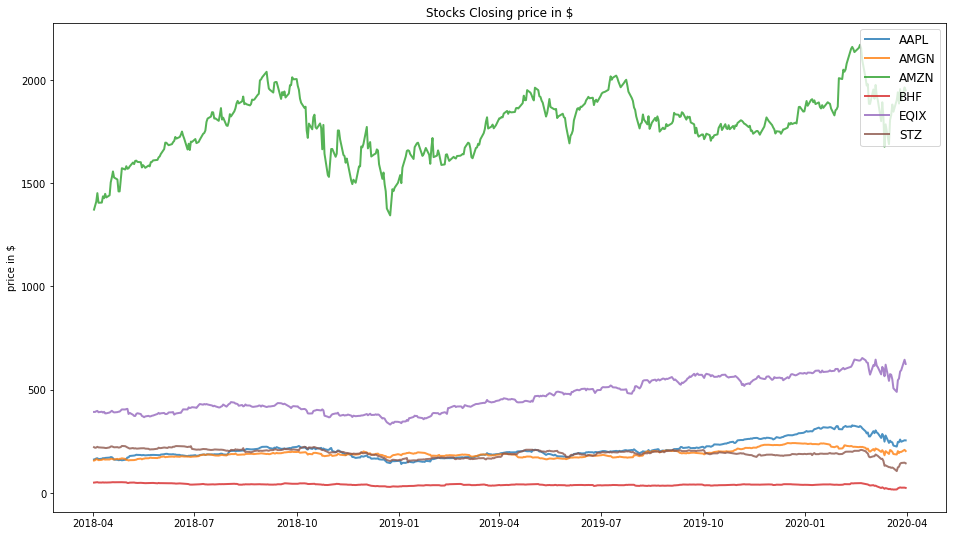

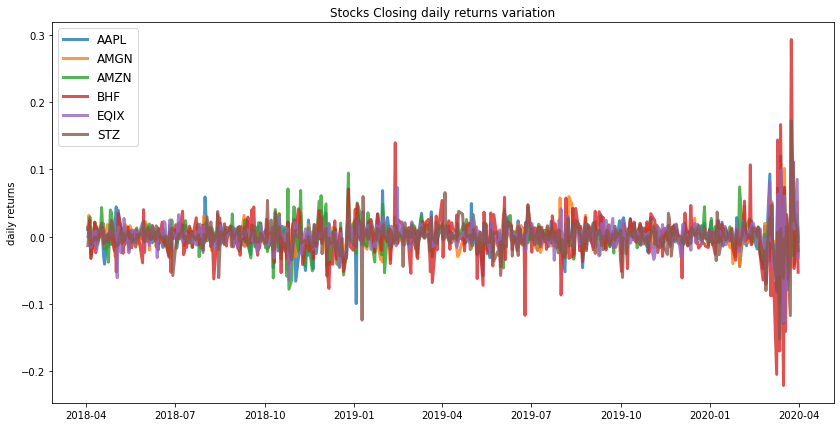

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.54
Annualised Volatility: 0.37


            AAPL  AMGN   AMZN  BHF   EQIX  STZ
allocation  23.7   0.0  18.35  0.0  57.96  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.3
Annualised Volatility: 0.33


            AAPL   AMGN   AMZN  BHF   EQIX    STZ
allocation   0.0  34.22  23.98  0.0  24.02  17.77


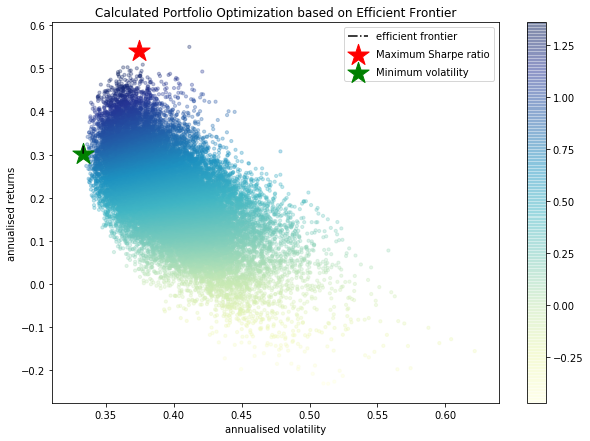

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
AMGN : annuaised return 0.34 , annualised volatility: 0.4
AMZN : annuaised return 0.46 , annualised volatility: 0.45
BHF : annuaised return -0.41 , annualised volatility: 0.8
EQIX : annuaised return 0.56 , annualised volatility: 0.42
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


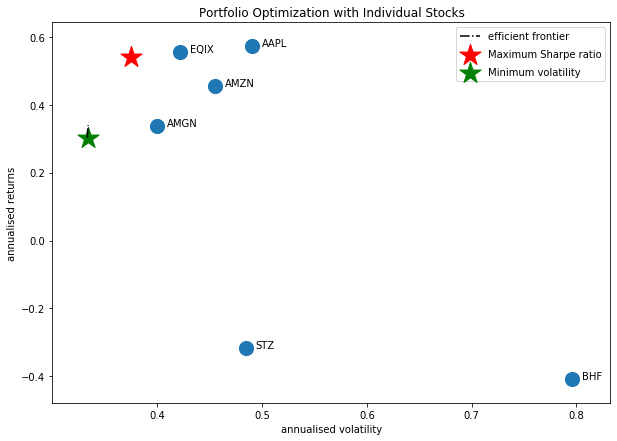

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AZO', 'GOOG']


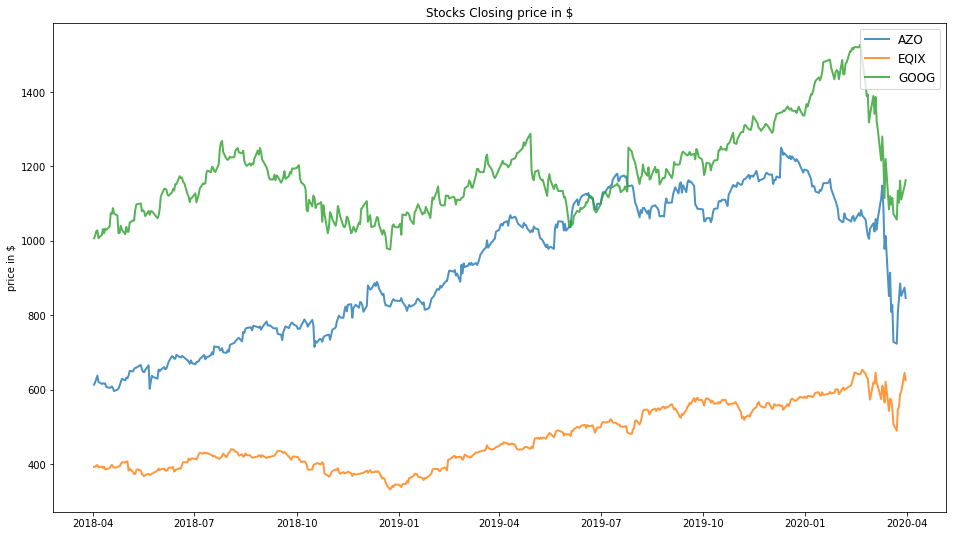

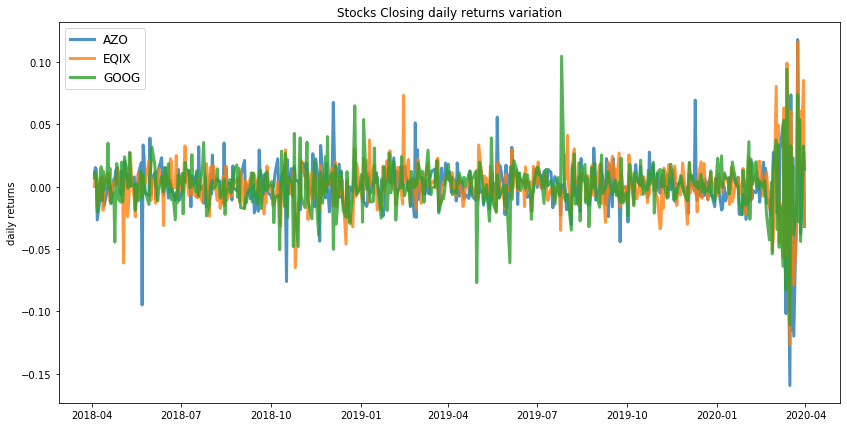

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.52
Annualised Volatility: 0.37


              AZO   EQIX  GOOG
allocation  28.28  71.72   0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.4
Annualised Volatility: 0.34


              AZO   EQIX   GOOG
allocation  31.88  33.51  34.61


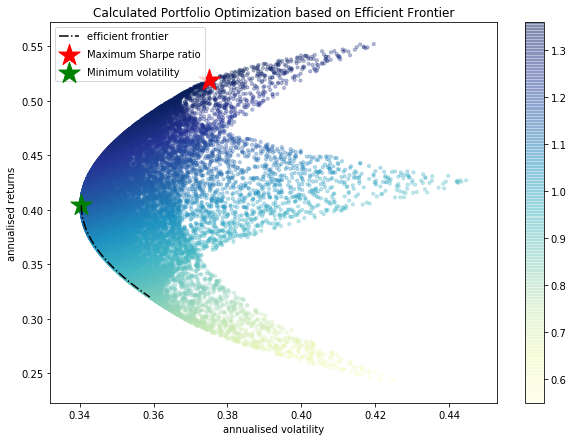

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AZO : annuaised return 0.43 , annualised volatility: 0.45
EQIX : annuaised return 0.56 , annualised volatility: 0.42
GOOG : annuaised return 0.24 , annualised volatility: 0.43
--------------------------------------------------------------------------------


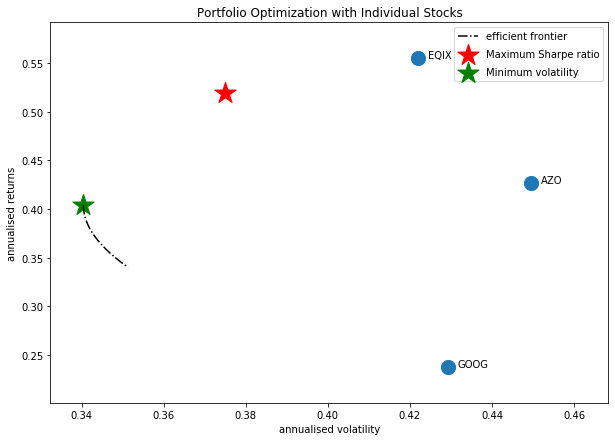

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'DISCK', 'CMG', 'BHF']


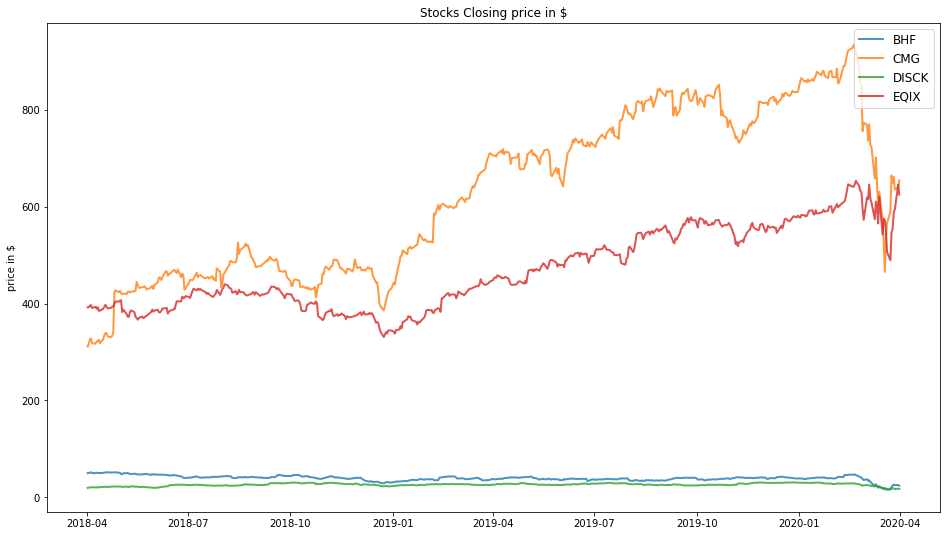

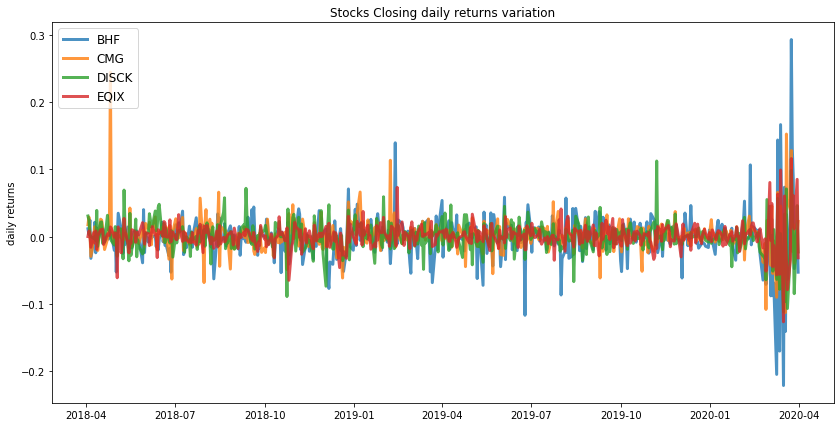

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.73
Annualised Volatility: 0.4


            BHF    CMG  DISCK   EQIX
allocation  0.0  50.35    0.0  49.65
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.49
Annualised Volatility: 0.36


            BHF    CMG  DISCK   EQIX
allocation  0.0  20.41  26.18  53.41


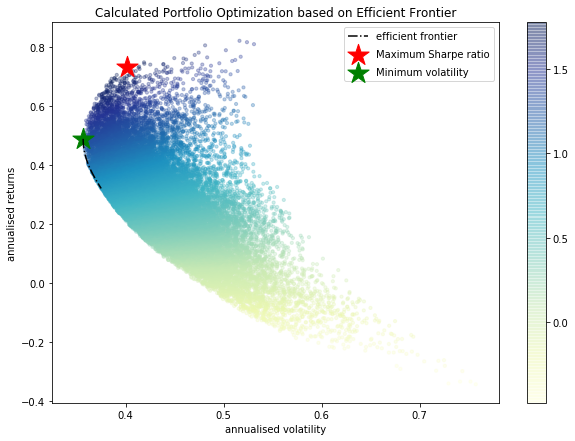

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BHF : annuaised return -0.41 , annualised volatility: 0.8
CMG : annuaised return 0.91 , annualised volatility: 0.58
DISCK : annuaised return 0.02 , annualised volatility: 0.52
EQIX : annuaised return 0.56 , annualised volatility: 0.42
--------------------------------------------------------------------------------


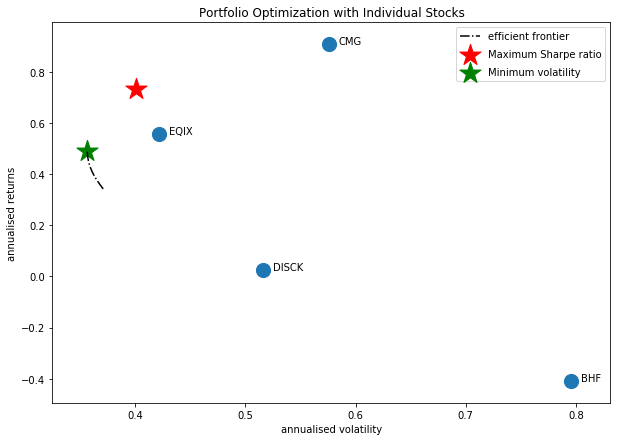

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AAP', 'BA', 'AMGN', 'BIIB', 'STZ', 'DVN', 'BHF', 'DISCK']


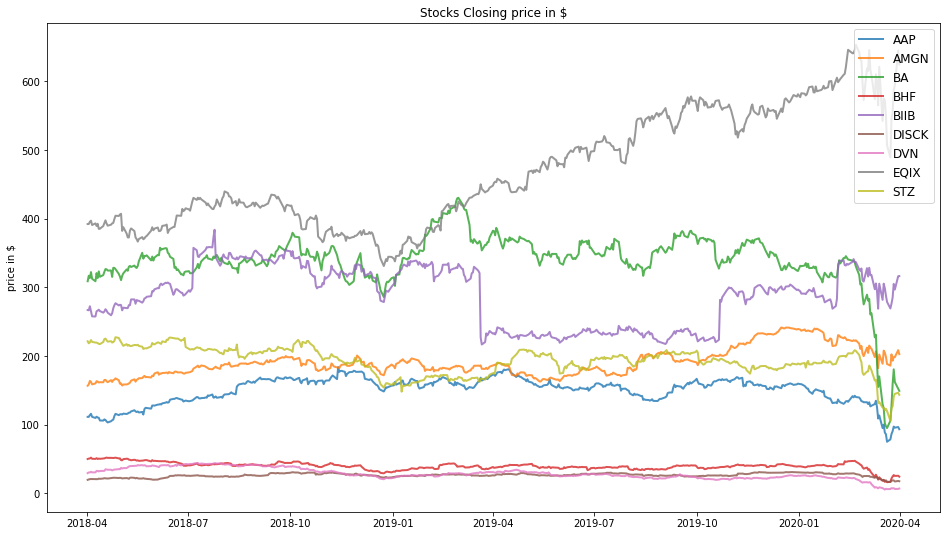

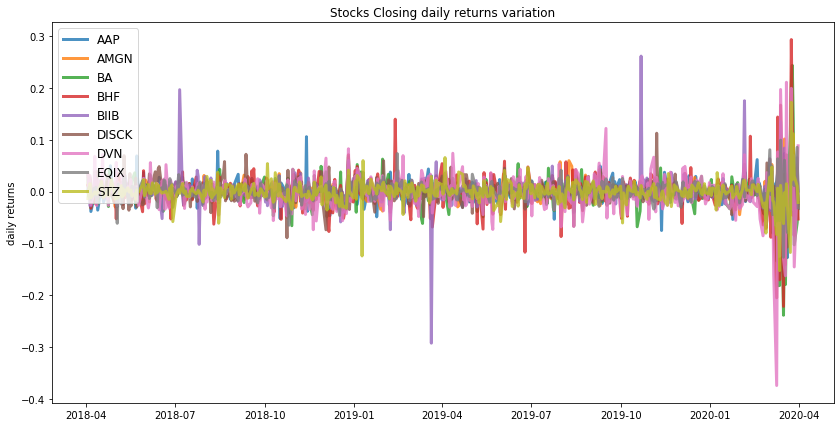

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.53
Annualised Volatility: 0.4


            AAP  AMGN   BA  BHF  BIIB  DISCK  DVN   EQIX  STZ
allocation  0.0  3.24  0.0  0.0  9.03    0.0  0.0  87.73  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.19
Annualised Volatility: 0.33


              AAP   AMGN   BA  BHF  BIIB  DISCK  DVN   EQIX    STZ
allocation  12.93  30.25  0.0  0.0  3.79  15.22  0.0  22.46  15.36


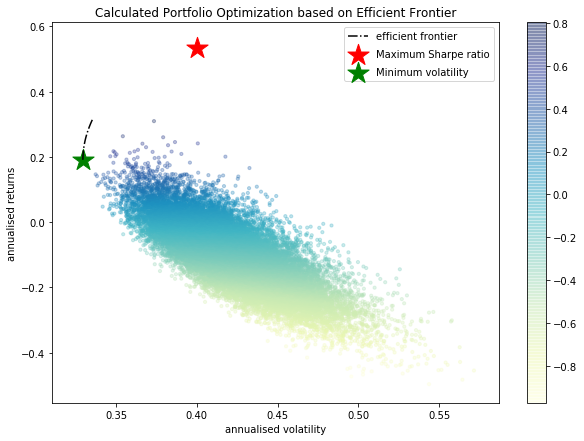

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAP : annuaised return -0.04 , annualised volatility: 0.51
AMGN : annuaised return 0.34 , annualised volatility: 0.4
BA : annuaised return -0.47 , annualised volatility: 0.72
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
DISCK : annuaised return 0.02 , annualised volatility: 0.52
DVN : annuaised return -1.05 , annualised volatility: 0.87
EQIX : annuaised return 0.56 , annualised volatility: 0.42
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


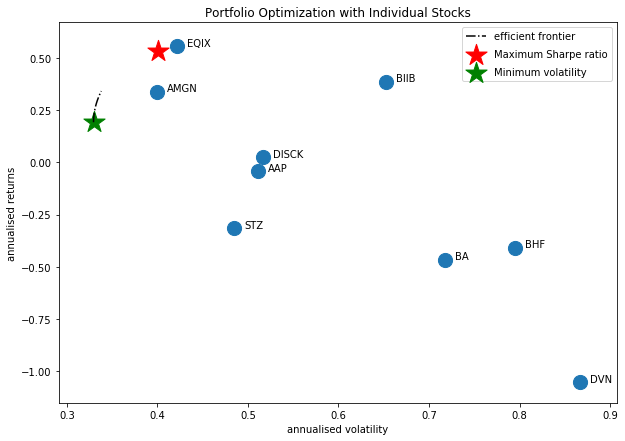

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AMZN', 'AAP', 'AMGN', 'BIIB', 'STZ', 'BHF', 'DISCK']


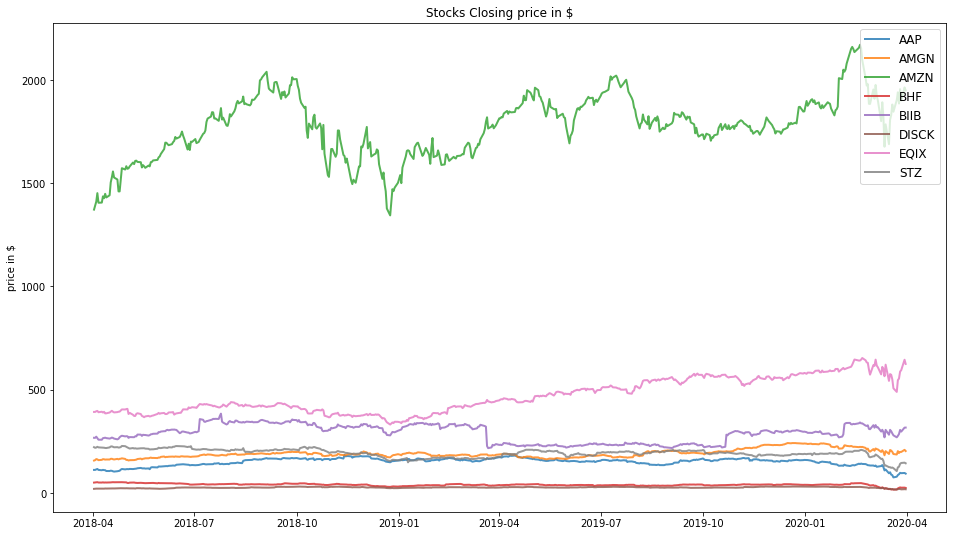

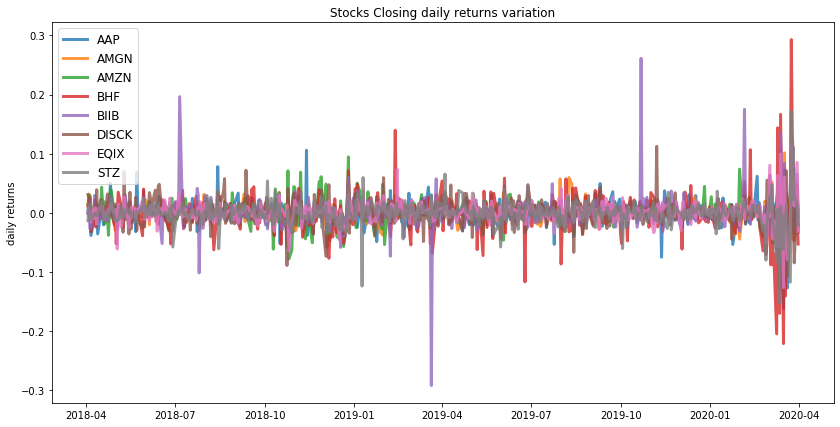

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.52
Annualised Volatility: 0.37


            AAP  AMGN   AMZN  BHF  BIIB  DISCK   EQIX  STZ
allocation  0.0   0.0  30.37  0.0  4.04    0.0  65.59  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.24
Annualised Volatility: 0.32


              AAP   AMGN   AMZN  BHF  BIIB  DISCK   EQIX    STZ
allocation  10.88  24.65  17.94  0.0  2.57  12.53  19.13  12.29


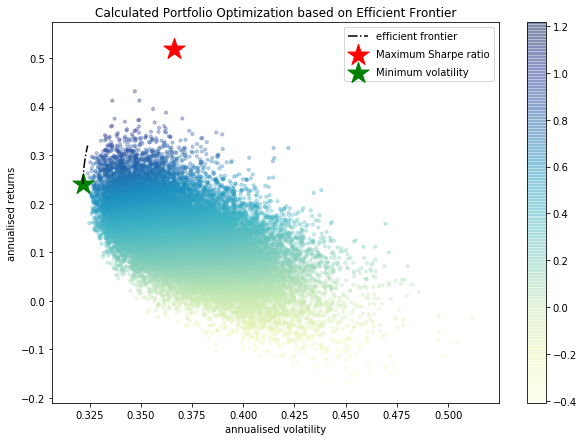

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAP : annuaised return -0.04 , annualised volatility: 0.51
AMGN : annuaised return 0.34 , annualised volatility: 0.4
AMZN : annuaised return 0.46 , annualised volatility: 0.45
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
DISCK : annuaised return 0.02 , annualised volatility: 0.52
EQIX : annuaised return 0.56 , annualised volatility: 0.42
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


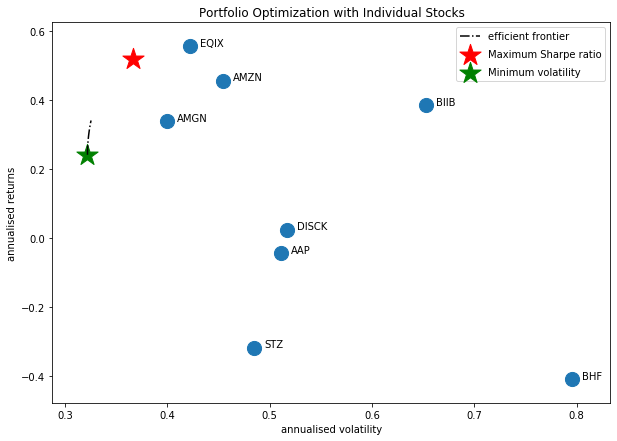

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'BA', 'AMGN', 'AAPL', 'BIIB', 'STZ', 'DVN', 'BHF']


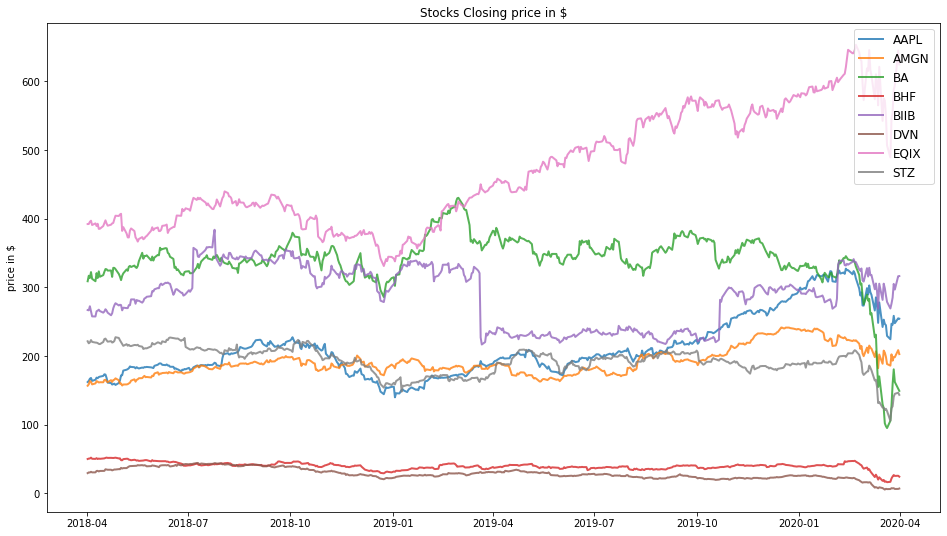

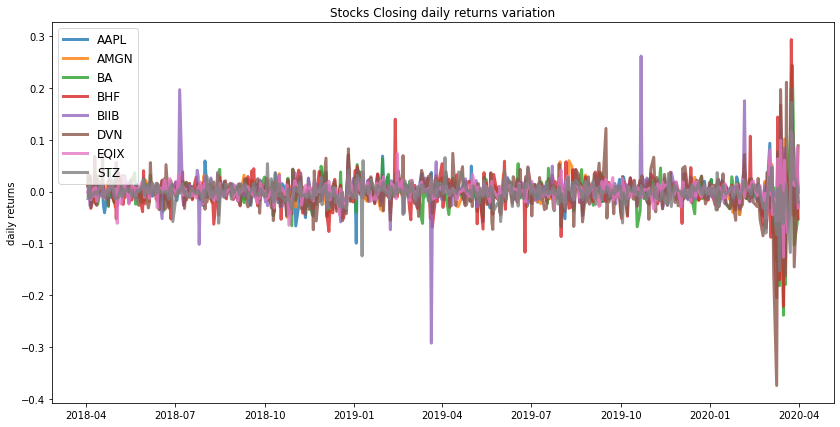

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.56
Annualised Volatility: 0.39


             AAPL  AMGN   BA  BHF  BIIB  DVN   EQIX  STZ
allocation  34.73   0.0  0.0  0.0  3.45  0.0  61.82  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.27
Annualised Volatility: 0.35


            AAPL   AMGN   BA  BHF  BIIB  DVN   EQIX    STZ
allocation  5.12  38.65  0.0  0.0  5.44  0.0  28.46  22.32


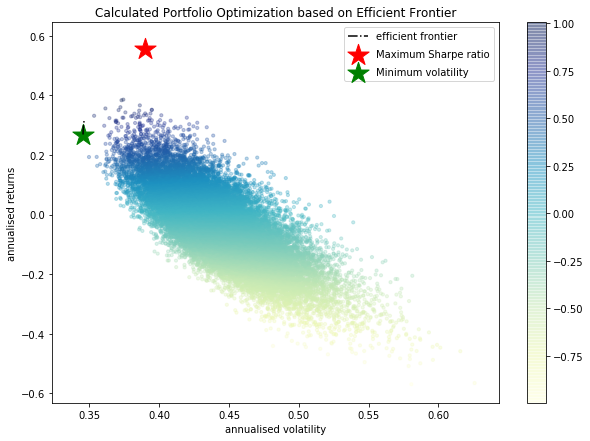

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
AMGN : annuaised return 0.34 , annualised volatility: 0.4
BA : annuaised return -0.47 , annualised volatility: 0.72
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
DVN : annuaised return -1.05 , annualised volatility: 0.87
EQIX : annuaised return 0.56 , annualised volatility: 0.42
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


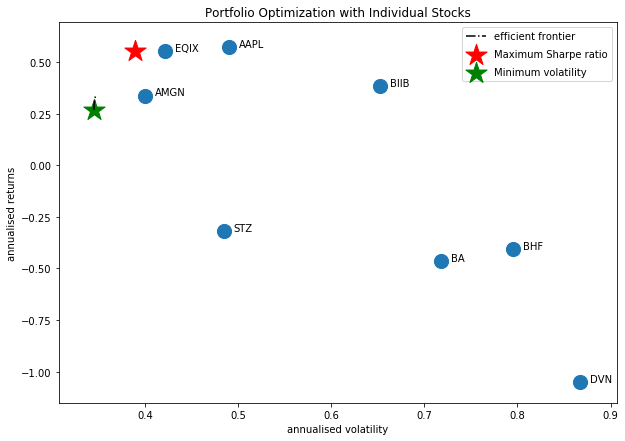

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AMGN', 'BIIB', 'STZ', 'ECL', 'DVN', 'BHF']


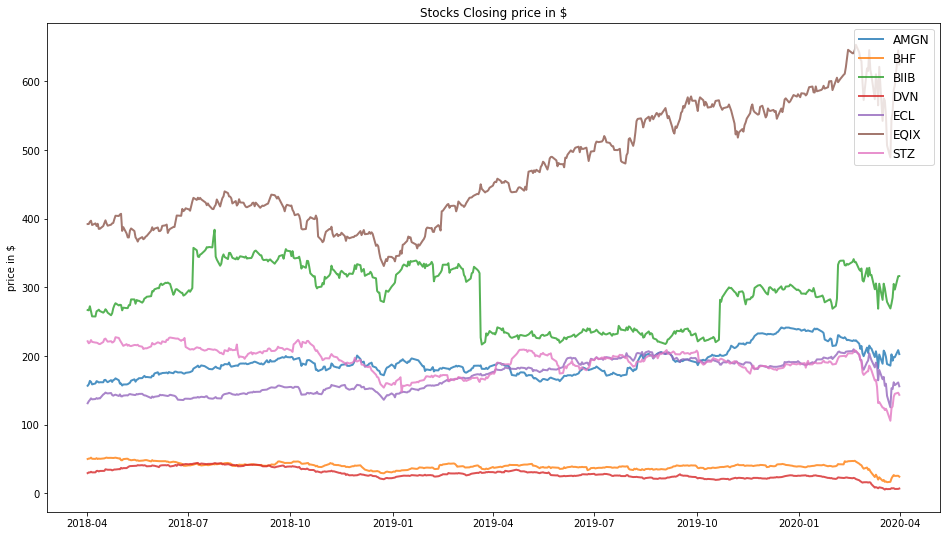

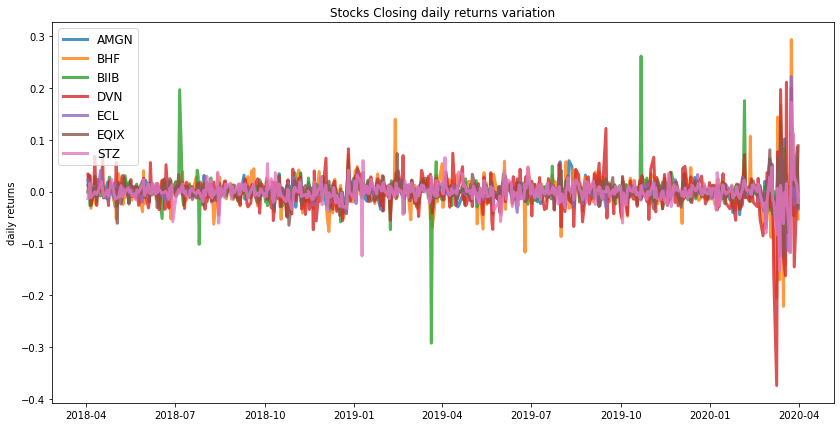

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.53
Annualised Volatility: 0.4


            AMGN  BHF  BIIB  DVN  ECL   EQIX  STZ
allocation  3.15  0.0  9.04  0.0  0.0  87.81  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.26
Annualised Volatility: 0.34


             AMGN  BHF  BIIB  DVN    ECL   EQIX    STZ
allocation  37.89  0.0  5.77  0.0  10.24  26.41  19.69


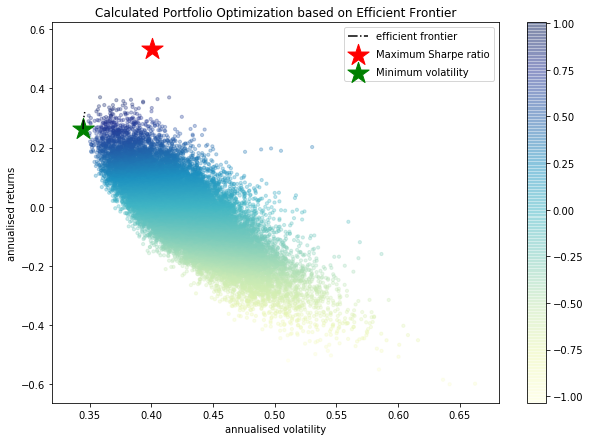

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.34 , annualised volatility: 0.4
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
DVN : annuaised return -1.05 , annualised volatility: 0.87
ECL : annuaised return 0.27 , annualised volatility: 0.44
EQIX : annuaised return 0.56 , annualised volatility: 0.42
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


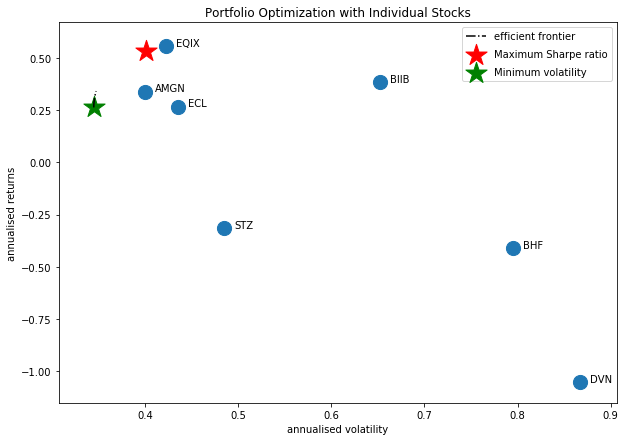

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'BA', 'AMGN', 'BIIB', 'STZ', 'DVN', 'BHF', 'DISCK']


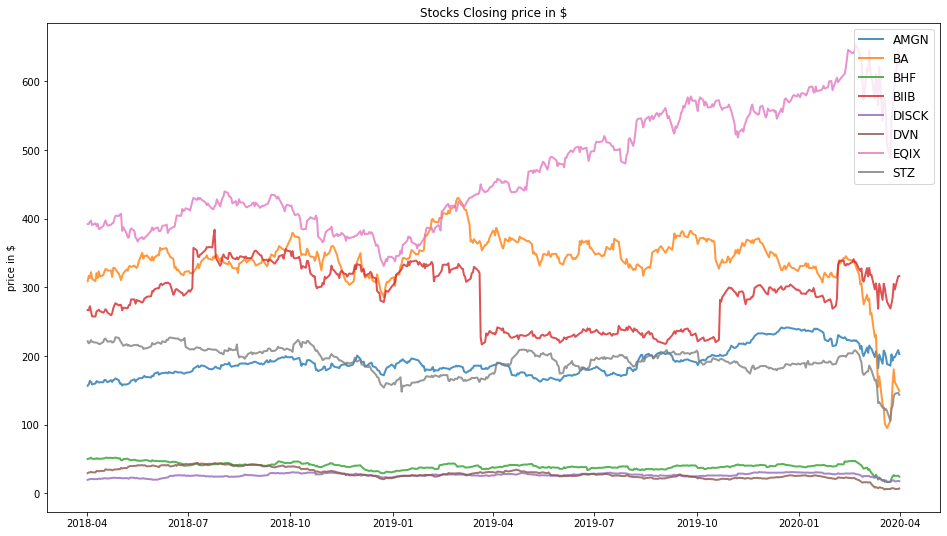

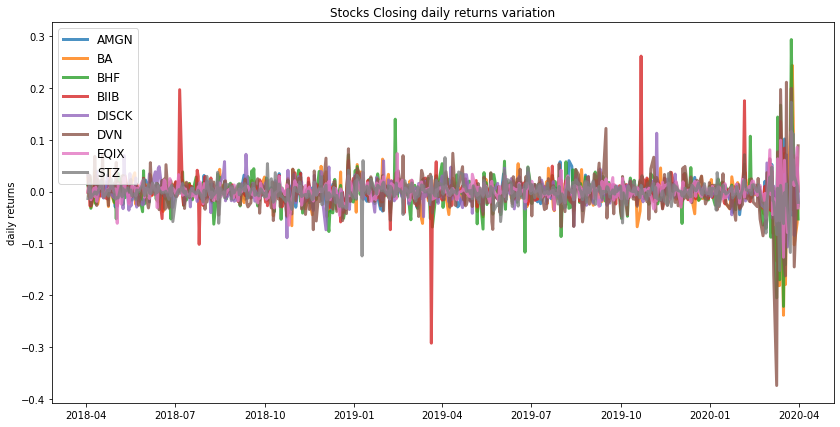

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.53
Annualised Volatility: 0.4


            AMGN   BA  BHF  BIIB  DISCK  DVN   EQIX  STZ
allocation  3.22  0.0  0.0   9.0    0.0  0.0  87.78  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.22
Annualised Volatility: 0.33


             AMGN   BA  BHF  BIIB  DISCK  DVN   EQIX    STZ
allocation  33.59  0.0  0.0  4.54  18.33  0.0  25.72  17.83


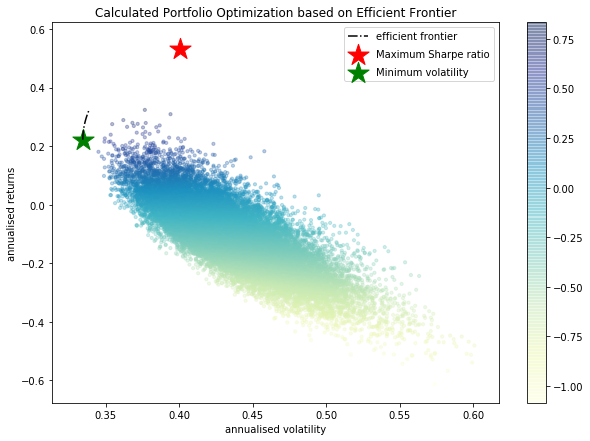

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.34 , annualised volatility: 0.4
BA : annuaised return -0.47 , annualised volatility: 0.72
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
DISCK : annuaised return 0.02 , annualised volatility: 0.52
DVN : annuaised return -1.05 , annualised volatility: 0.87
EQIX : annuaised return 0.56 , annualised volatility: 0.42
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


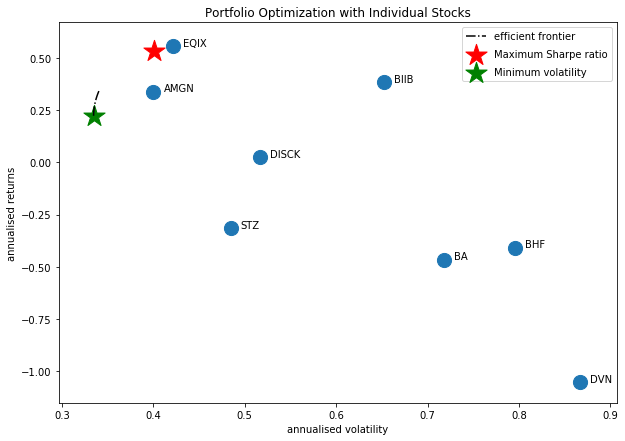

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AMZN', 'CMG', 'AMGN', 'AAPL', 'BIIB', 'STZ', 'BHF', 'DISCK']


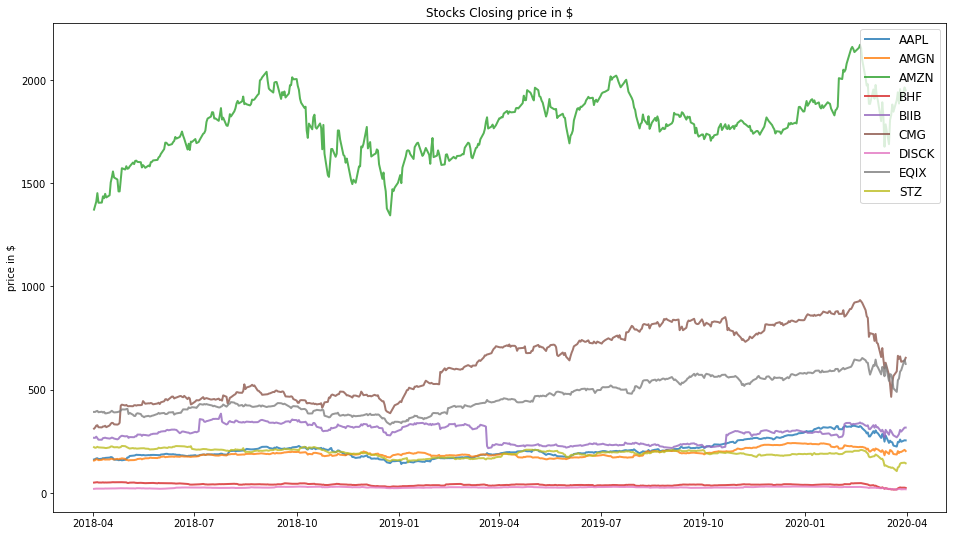

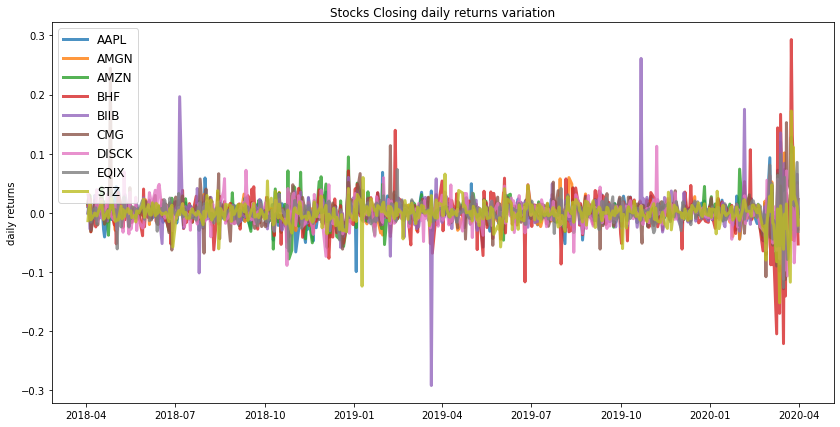

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.71
Annualised Volatility: 0.39


            AAPL  AMGN  AMZN  BHF  BIIB    CMG  DISCK   EQIX  STZ
allocation  9.19   0.0  1.31  0.0   3.6  45.73    0.0  40.18  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.35
Annualised Volatility: 0.32


            AAPL   AMGN   AMZN  BHF  BIIB    CMG  DISCK   EQIX    STZ
allocation   0.0  26.76  15.22  0.0  3.39  11.62  12.04  19.61  11.36


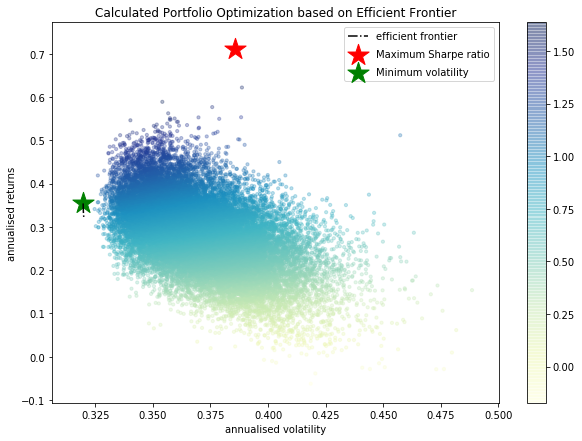

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
AMGN : annuaised return 0.34 , annualised volatility: 0.4
AMZN : annuaised return 0.46 , annualised volatility: 0.45
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CMG : annuaised return 0.91 , annualised volatility: 0.58
DISCK : annuaised return 0.02 , annualised volatility: 0.52
EQIX : annuaised return 0.56 , annualised volatility: 0.42
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


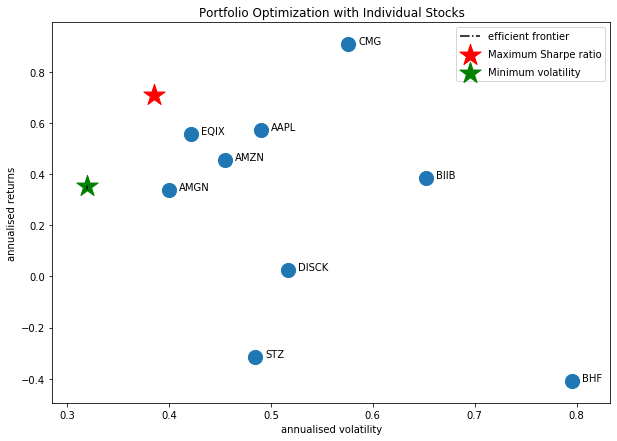

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'CMG', 'BA', 'BHF', 'DISCK', 'DHI']


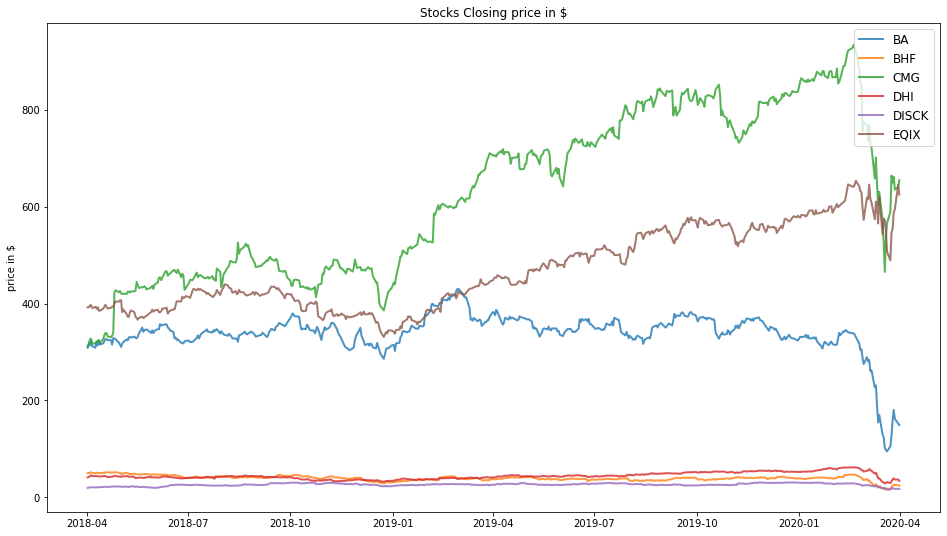

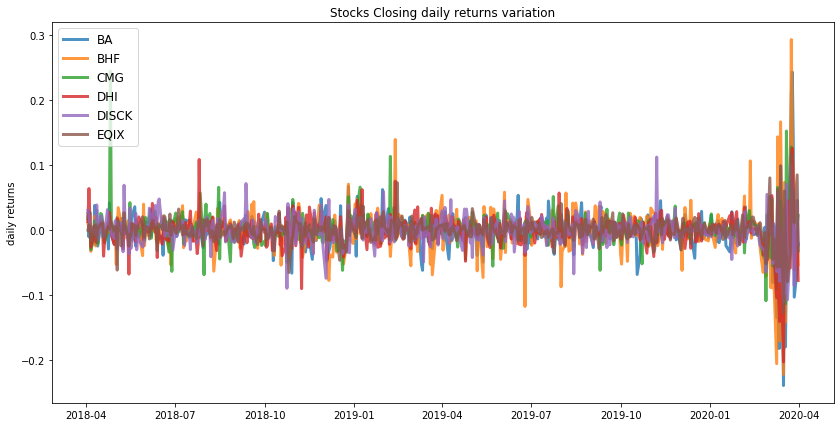

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.73
Annualised Volatility: 0.4


             BA  BHF    CMG  DHI  DISCK   EQIX
allocation  0.0  0.0  50.39  0.0    0.0  49.61
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.43
Annualised Volatility: 0.35


             BA  BHF    CMG  DHI  DISCK   EQIX
allocation  0.0  0.0  17.78  9.8   23.7  48.72


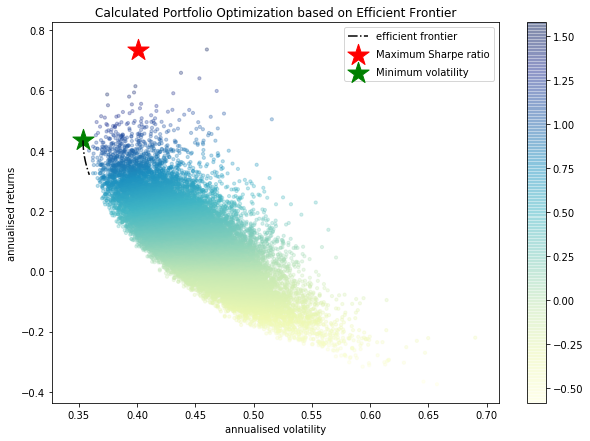

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BA : annuaised return -0.47 , annualised volatility: 0.72
BHF : annuaised return -0.41 , annualised volatility: 0.8
CMG : annuaised return 0.91 , annualised volatility: 0.58
DHI : annuaised return -0.03 , annualised volatility: 0.55
DISCK : annuaised return 0.02 , annualised volatility: 0.52
EQIX : annuaised return 0.56 , annualised volatility: 0.42
--------------------------------------------------------------------------------


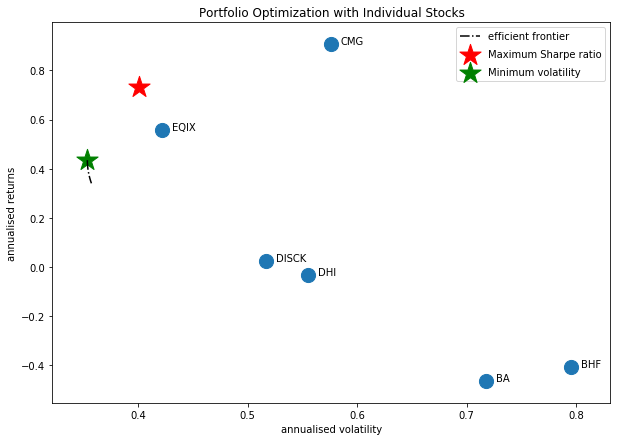

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'CMG', 'BA', 'BHF', 'DISCK', 'ALXN']


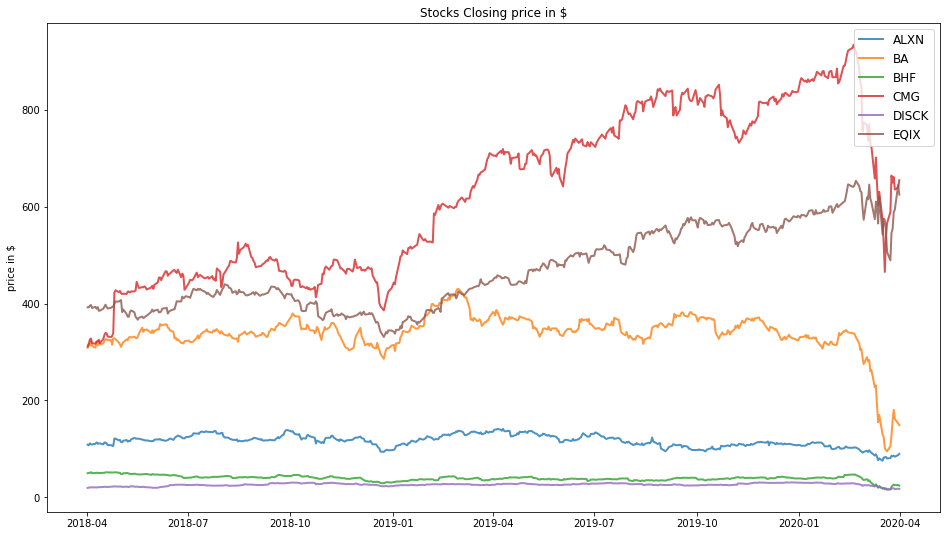

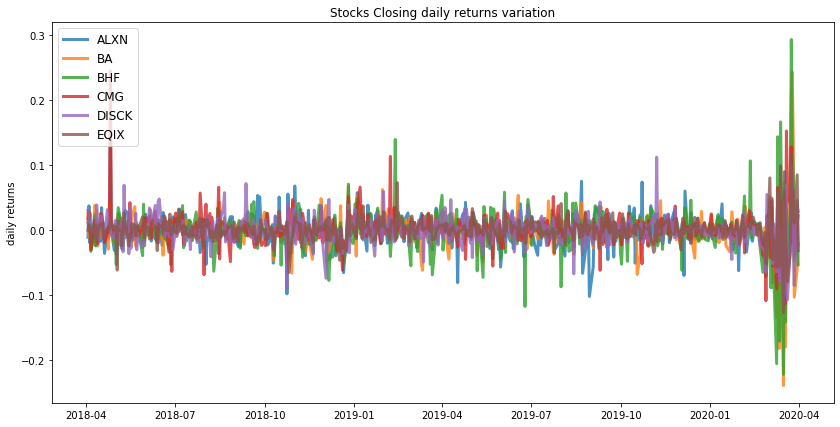

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.73
Annualised Volatility: 0.4


            ALXN   BA  BHF    CMG  DISCK   EQIX
allocation   0.0  0.0  0.0  50.39    0.0  49.61
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.41
Annualised Volatility: 0.35


             ALXN   BA  BHF    CMG  DISCK   EQIX
allocation  16.26  0.0  0.0  16.84  20.62  46.28


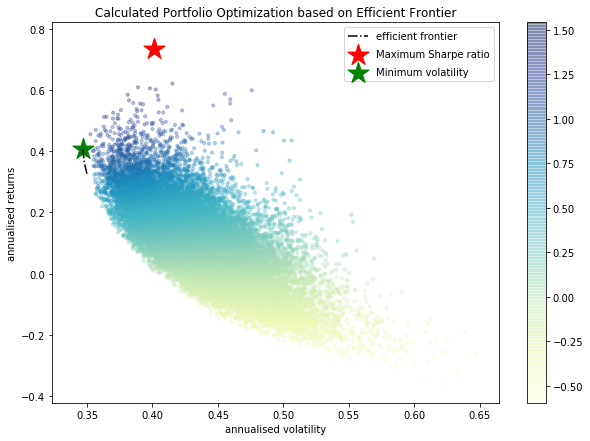

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ALXN : annuaised return -0.04 , annualised volatility: 0.55
BA : annuaised return -0.47 , annualised volatility: 0.72
BHF : annuaised return -0.41 , annualised volatility: 0.8
CMG : annuaised return 0.91 , annualised volatility: 0.58
DISCK : annuaised return 0.02 , annualised volatility: 0.52
EQIX : annuaised return 0.56 , annualised volatility: 0.42
--------------------------------------------------------------------------------


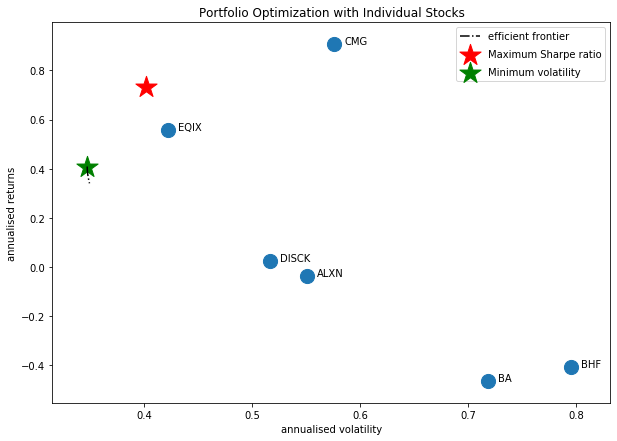

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'CTXS']


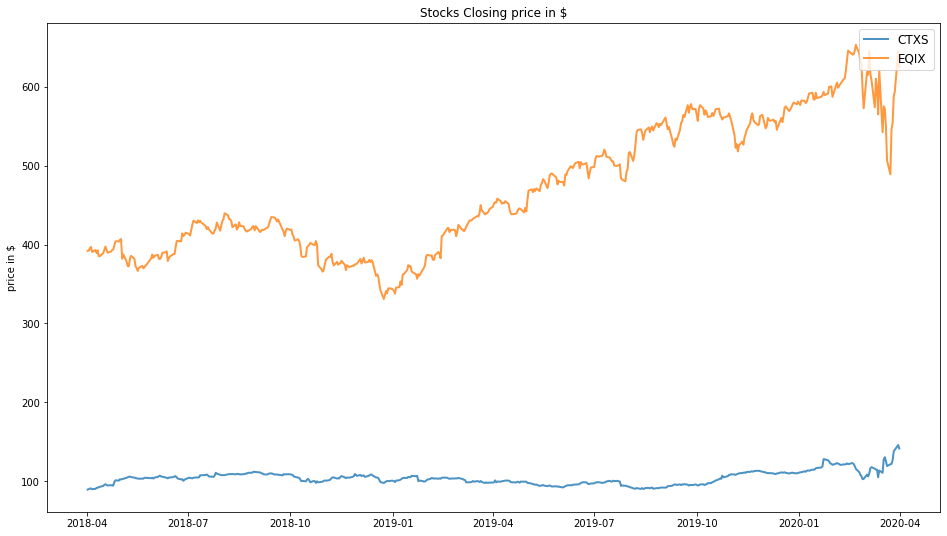

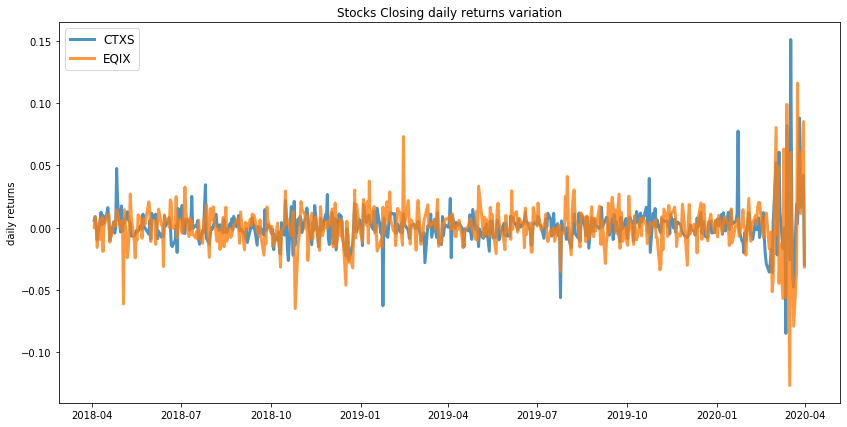

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.53
Annualised Volatility: 0.32


             CTXS   EQIX
allocation  62.25  37.75
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.53
Annualised Volatility: 0.32


             CTXS   EQIX
allocation  66.38  33.62


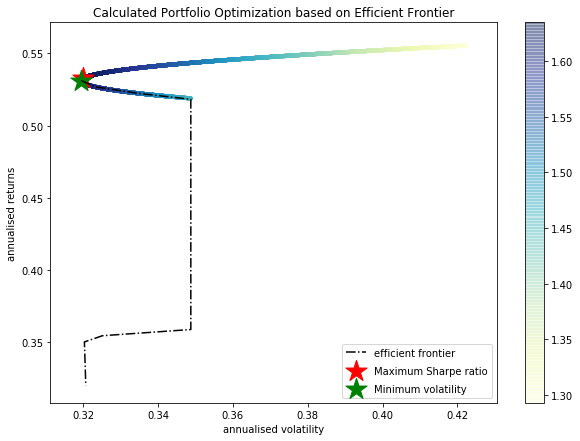

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

CTXS : annuaised return 0.52 , annualised volatility: 0.35
EQIX : annuaised return 0.56 , annualised volatility: 0.42
--------------------------------------------------------------------------------


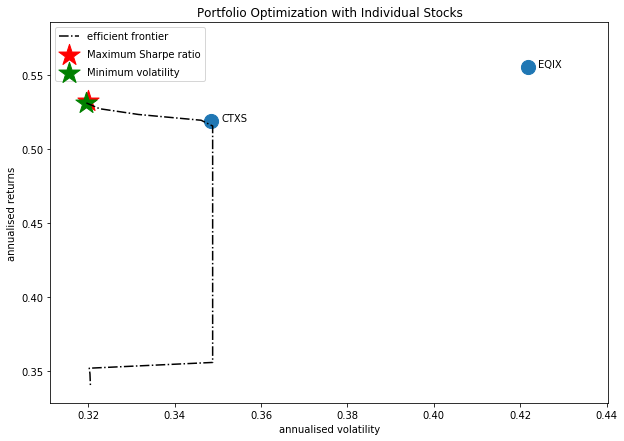

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'BAC']


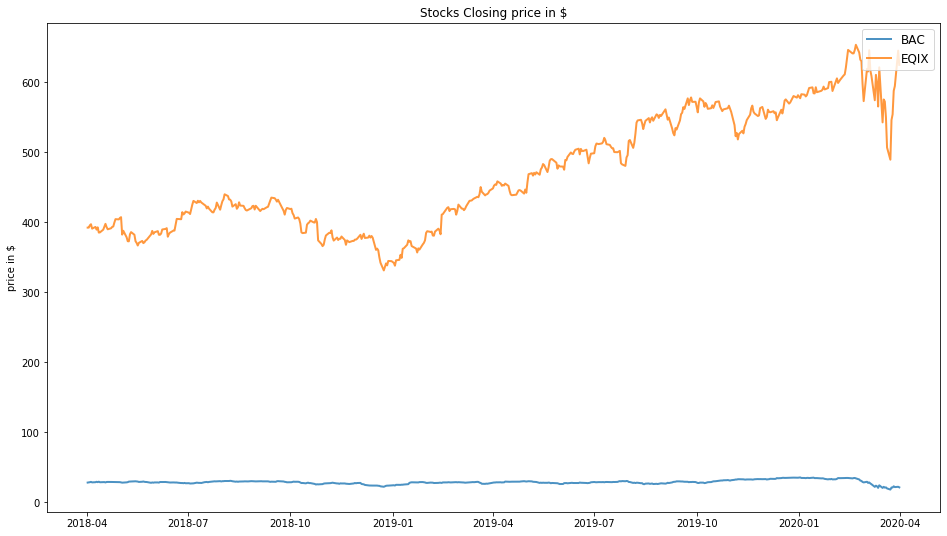

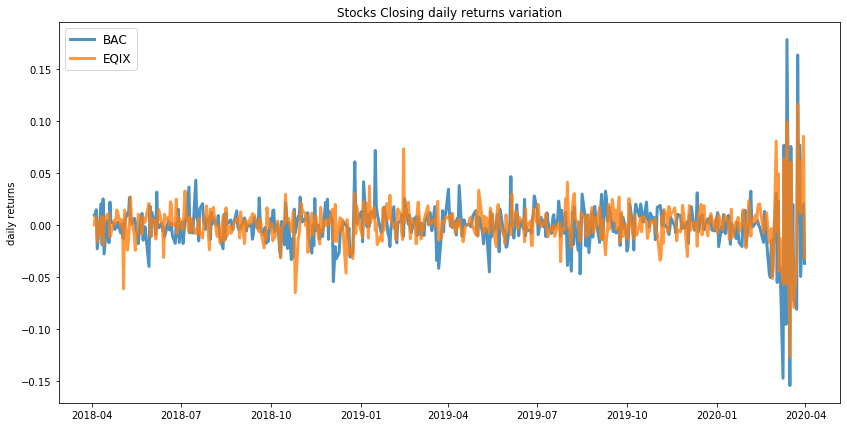

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.56
Annualised Volatility: 0.42


            BAC   EQIX
allocation  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.35
Annualised Volatility: 0.4


              BAC   EQIX
allocation  29.69  70.31


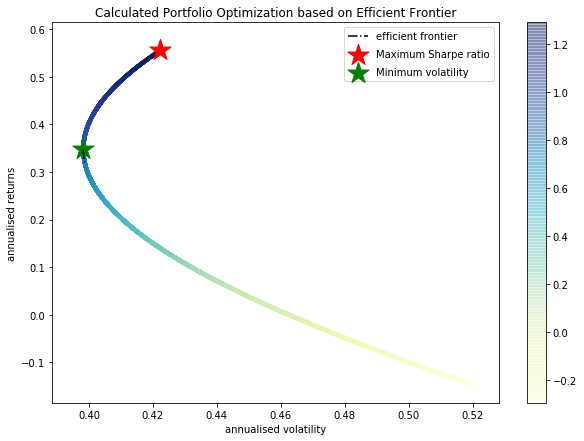

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BAC : annuaised return -0.14 , annualised volatility: 0.52
EQIX : annuaised return 0.56 , annualised volatility: 0.42
--------------------------------------------------------------------------------


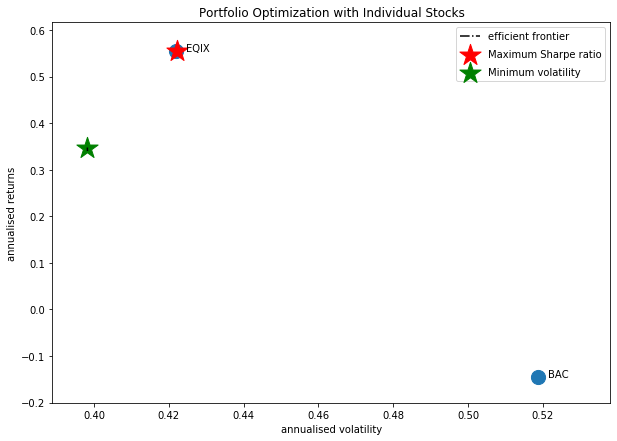

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'CMG', 'BHF', 'BXP']


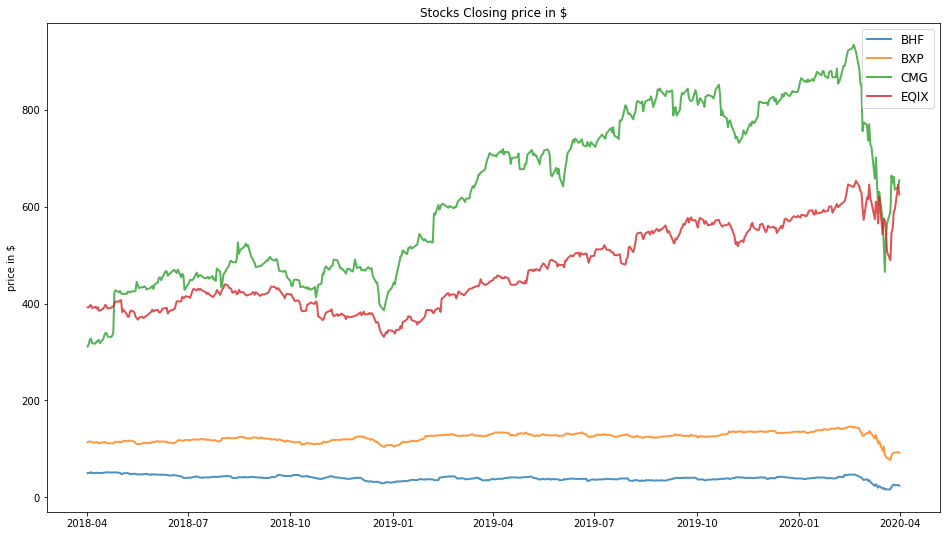

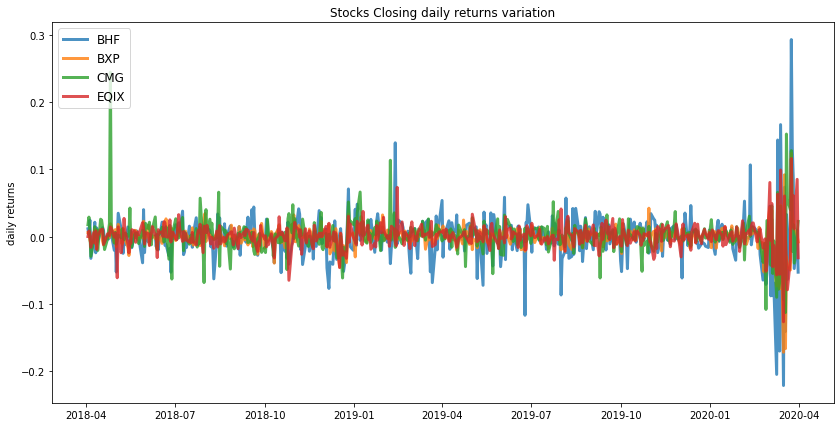

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.73
Annualised Volatility: 0.4


            BHF  BXP    CMG   EQIX
allocation  0.0  0.0  50.36  49.64
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.38
Annualised Volatility: 0.36


            BHF    BXP    CMG   EQIX
allocation  0.0  36.21  21.04  42.75


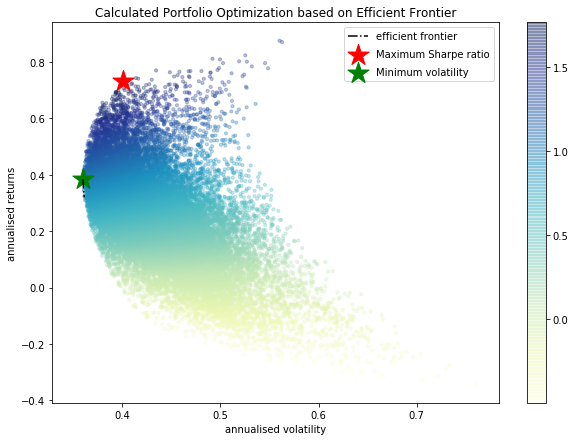

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BHF : annuaised return -0.41 , annualised volatility: 0.8
BXP : annuaised return -0.12 , annualised volatility: 0.42
CMG : annuaised return 0.91 , annualised volatility: 0.58
EQIX : annuaised return 0.56 , annualised volatility: 0.42
--------------------------------------------------------------------------------


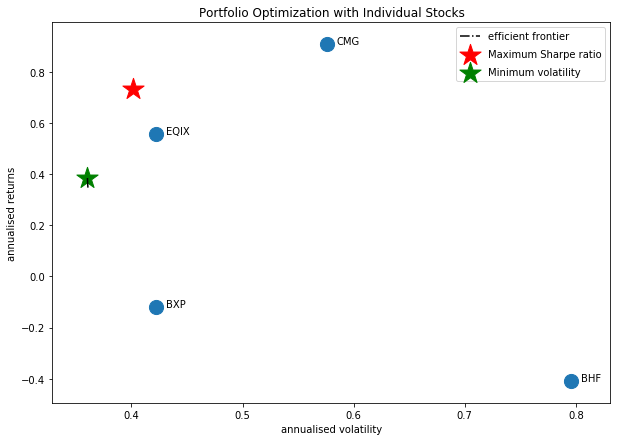

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AMZN', 'GOOG', 'AZO']


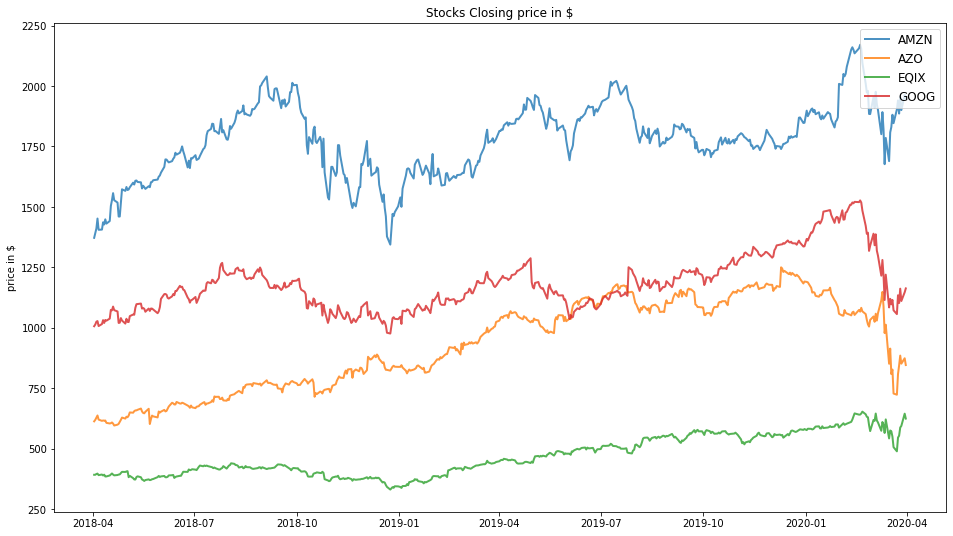

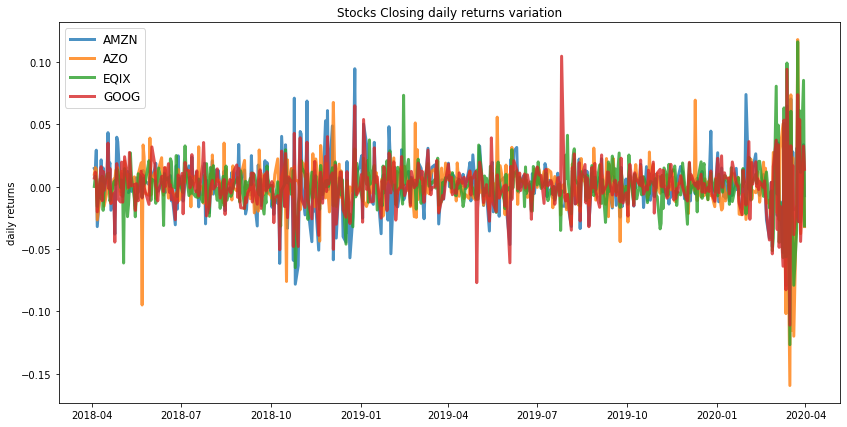

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.5
Annualised Volatility: 0.34


             AMZN    AZO   EQIX  GOOG
allocation  26.59  21.86  51.55   0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.44
Annualised Volatility: 0.33


             AMZN    AZO   EQIX   GOOG
allocation  23.93  31.16  29.65  15.26


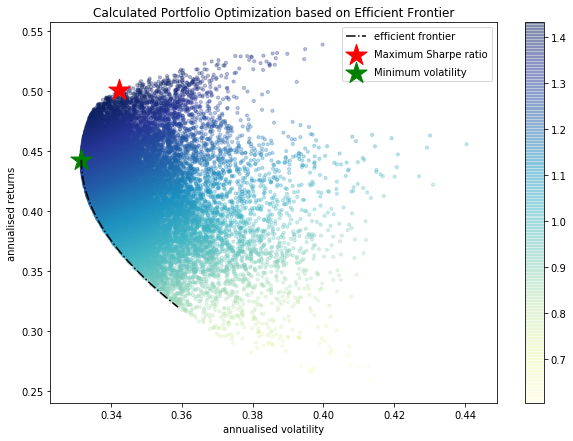

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.46 , annualised volatility: 0.45
AZO : annuaised return 0.43 , annualised volatility: 0.45
EQIX : annuaised return 0.56 , annualised volatility: 0.42
GOOG : annuaised return 0.24 , annualised volatility: 0.43
--------------------------------------------------------------------------------


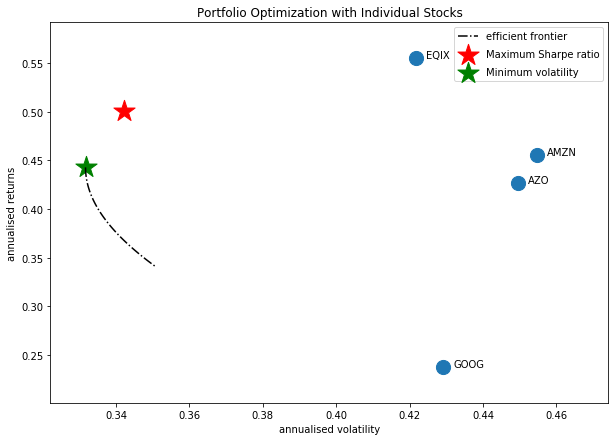

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'HST']


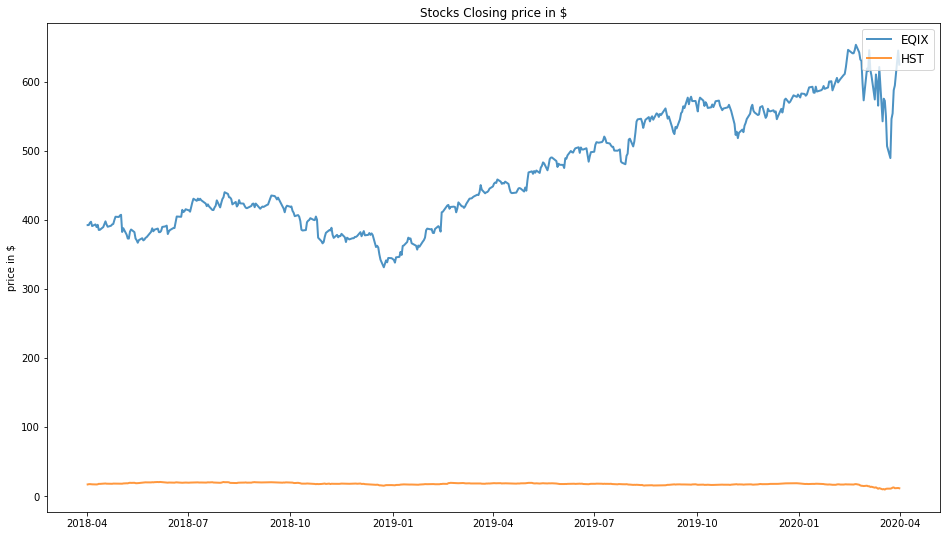

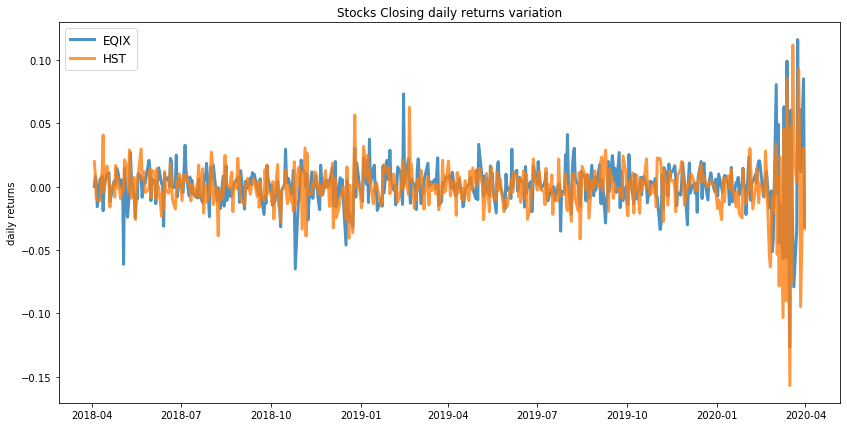

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.56
Annualised Volatility: 0.42


             EQIX  HST
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.18
Annualised Volatility: 0.37


             EQIX    HST
allocation  56.41  43.59


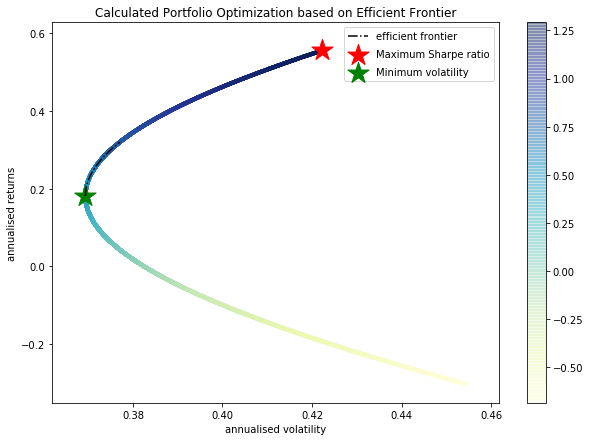

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

EQIX : annuaised return 0.56 , annualised volatility: 0.42
HST : annuaised return -0.3 , annualised volatility: 0.45
--------------------------------------------------------------------------------


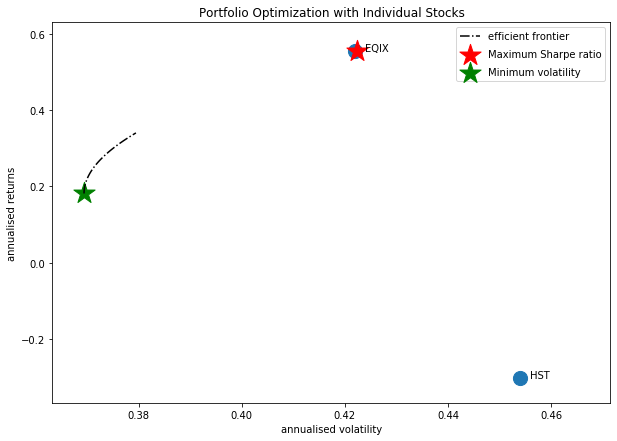

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'BMY']


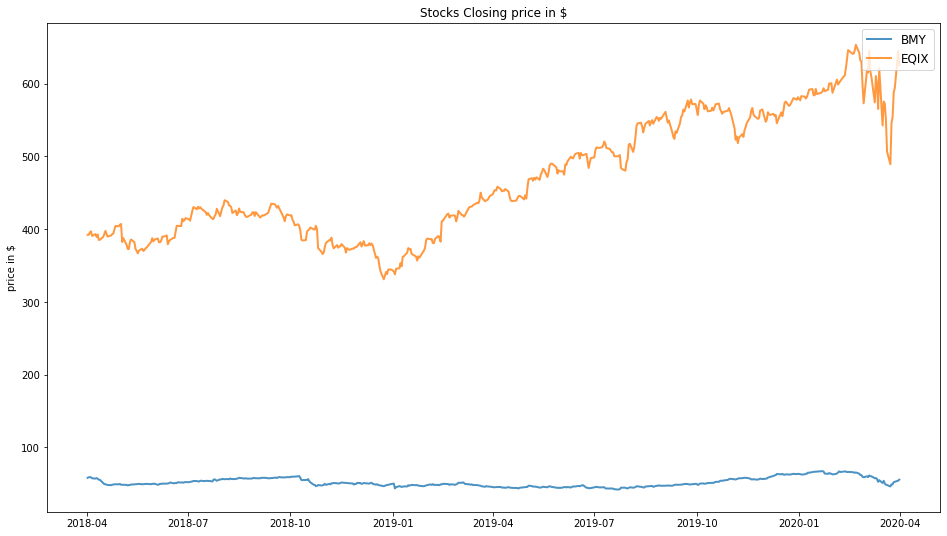

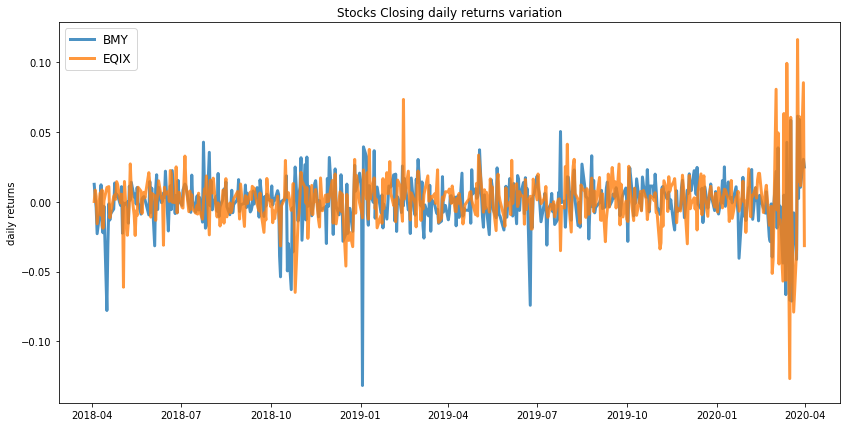

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.56
Annualised Volatility: 0.42


            BMY   EQIX
allocation  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.27
Annualised Volatility: 0.34


              BMY   EQIX
allocation  54.31  45.69


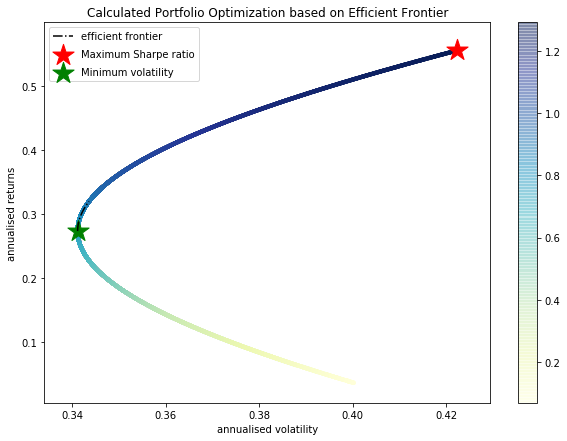

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BMY : annuaised return 0.04 , annualised volatility: 0.4
EQIX : annuaised return 0.56 , annualised volatility: 0.42
--------------------------------------------------------------------------------


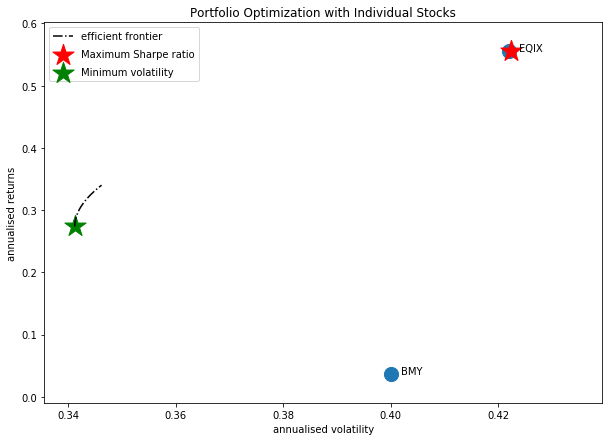

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'PPG']


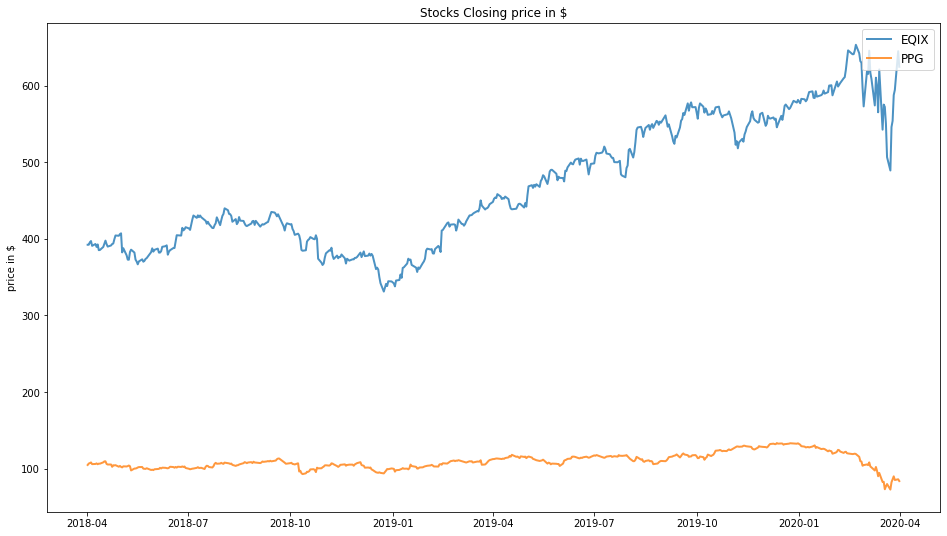

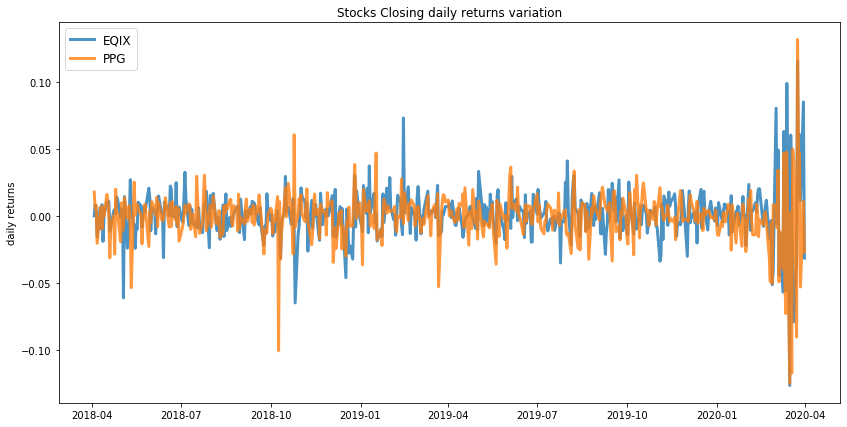

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.56
Annualised Volatility: 0.42


             EQIX  PPG
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.22
Annualised Volatility: 0.36


             EQIX    PPG
allocation  50.58  49.42


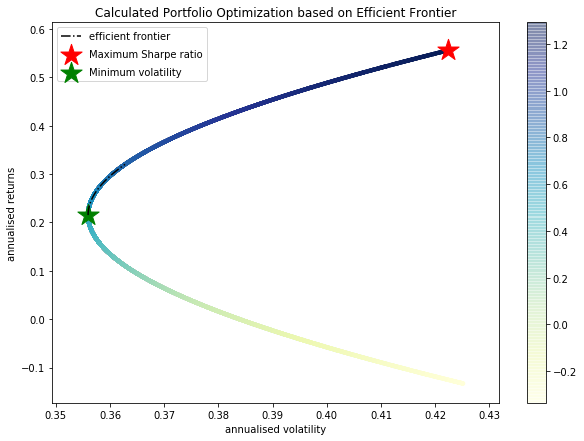

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

EQIX : annuaised return 0.56 , annualised volatility: 0.42
PPG : annuaised return -0.13 , annualised volatility: 0.42
--------------------------------------------------------------------------------


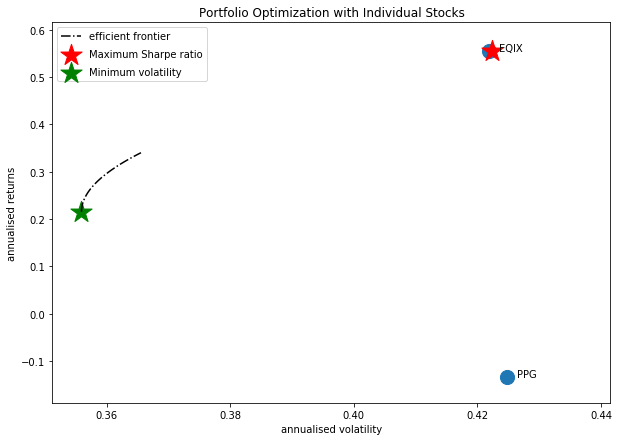

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'AMGN', 'AAPL', 'BIIB', 'STZ', 'BHF']


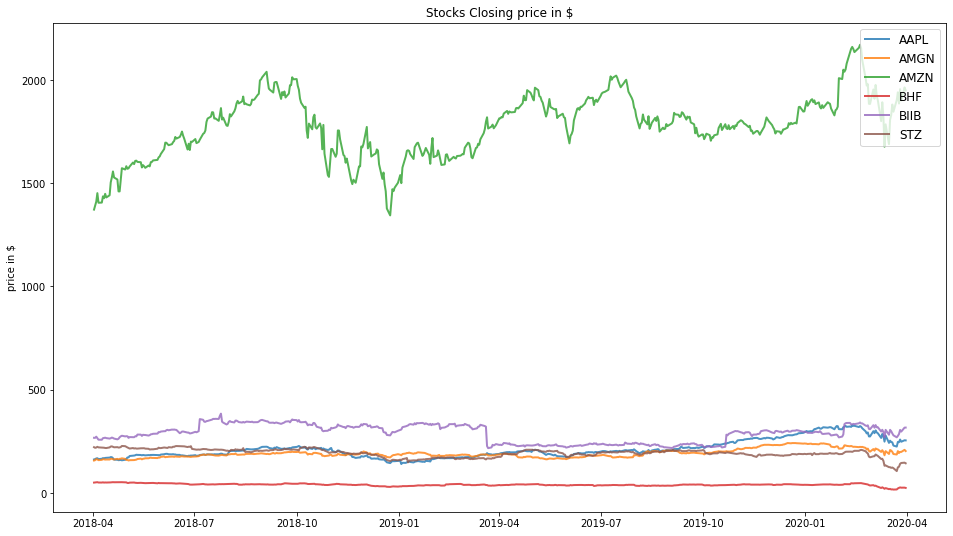

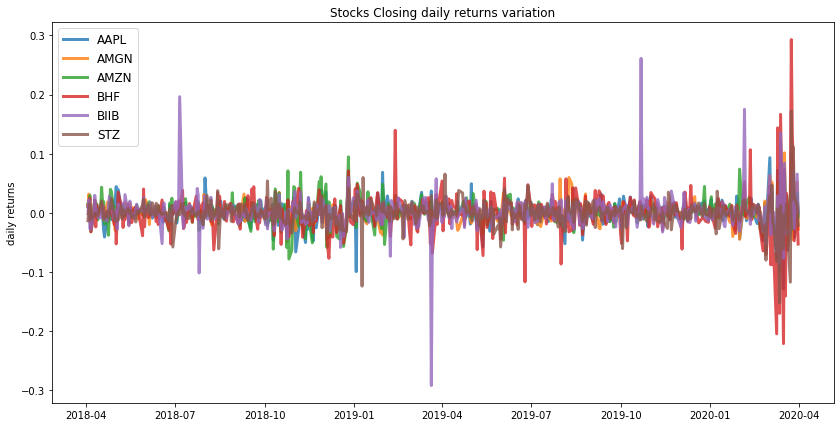

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.5
Annualised Volatility: 0.41


             AAPL   AMGN   AMZN  BHF  BIIB  STZ
allocation  55.04  10.33  27.98  0.0  6.65  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.21
Annualised Volatility: 0.34


            AAPL   AMGN   AMZN  BHF  BIIB    STZ
allocation   0.0  44.05  27.64  0.0  3.89  24.41


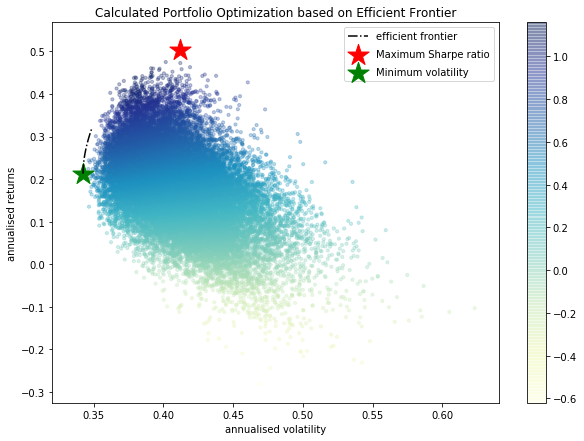

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
AMGN : annuaised return 0.34 , annualised volatility: 0.4
AMZN : annuaised return 0.46 , annualised volatility: 0.45
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


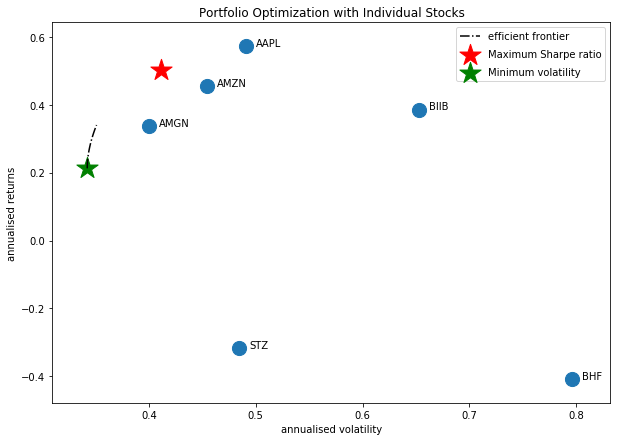

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'AAPL', 'AMGN', 'FCX']


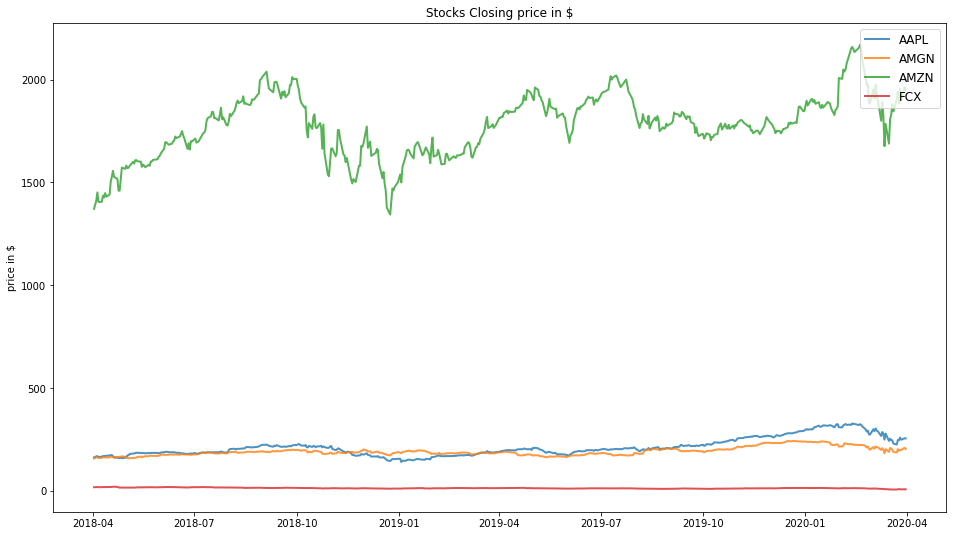

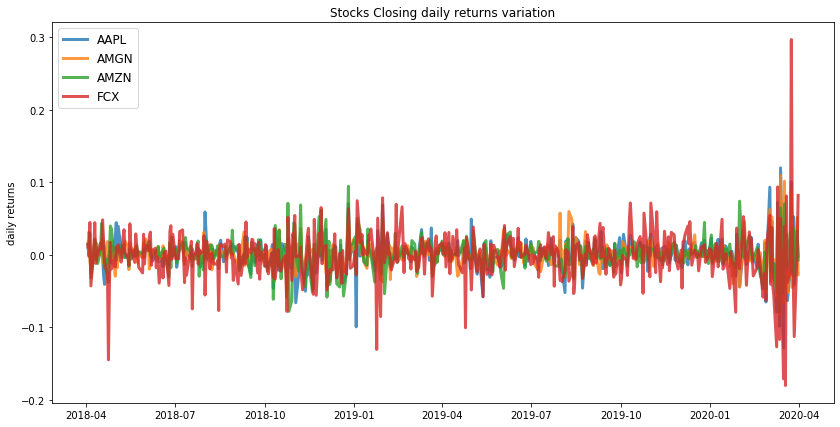

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.5
Annualised Volatility: 0.41


             AAPL   AMGN  AMZN  FCX
allocation  55.93  15.08  29.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.39
Annualised Volatility: 0.36


            AAPL  AMGN   AMZN  FCX
allocation  1.85  60.7  37.46  0.0


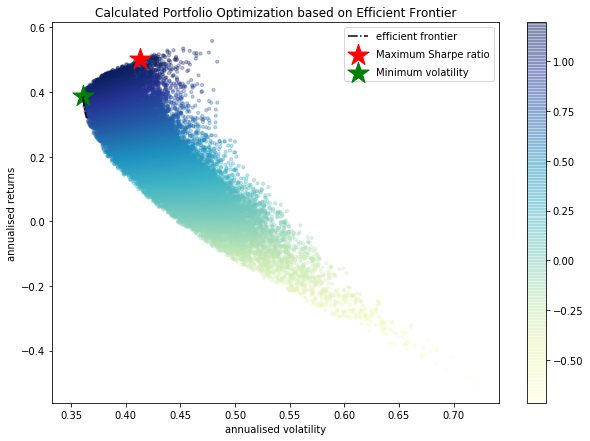

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
AMGN : annuaised return 0.34 , annualised volatility: 0.4
AMZN : annuaised return 0.46 , annualised volatility: 0.45
FCX : annuaised return -0.6 , annualised volatility: 0.78
--------------------------------------------------------------------------------


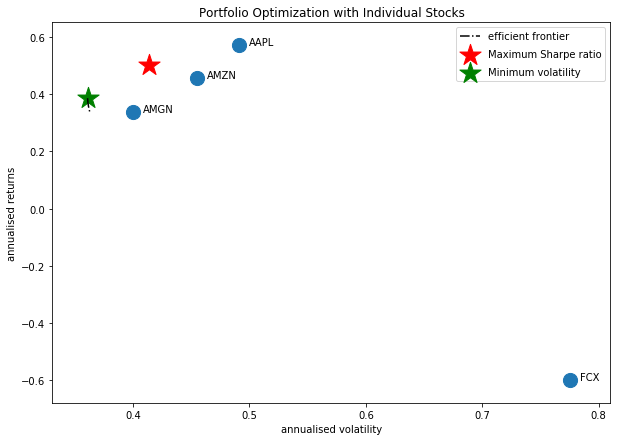

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'BIIB']


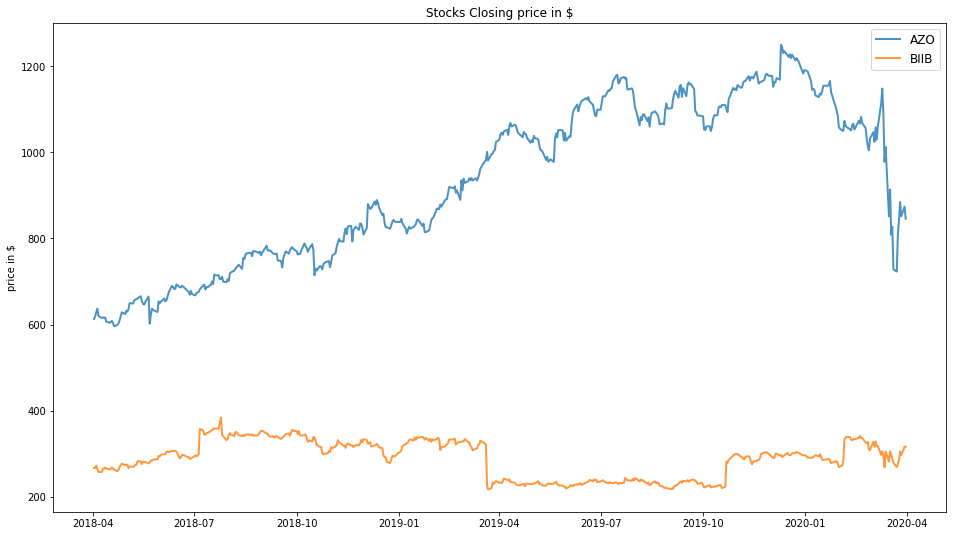

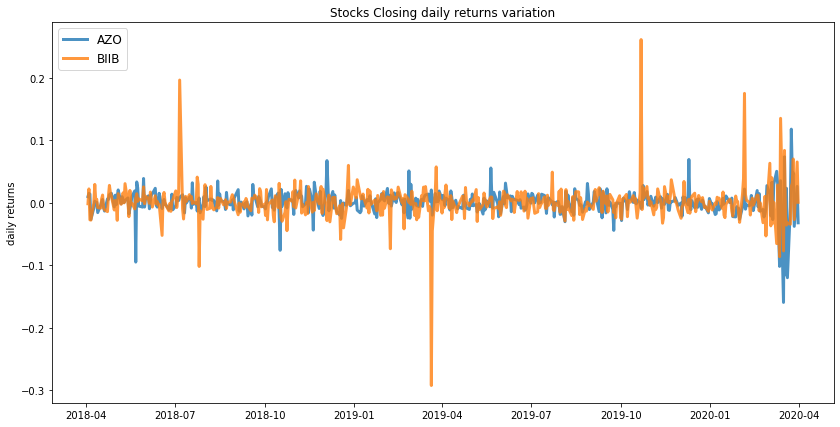

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.42
Annualised Volatility: 0.41


              AZO   BIIB
allocation  75.88  24.12
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.42
Annualised Volatility: 0.41


             AZO  BIIB
allocation  72.5  27.5


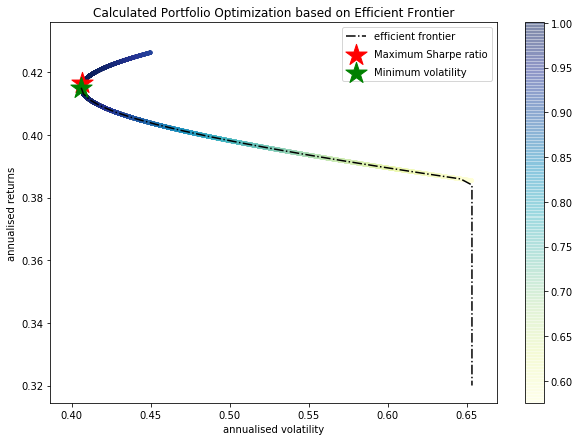

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AZO : annuaised return 0.43 , annualised volatility: 0.45
BIIB : annuaised return 0.39 , annualised volatility: 0.65
--------------------------------------------------------------------------------


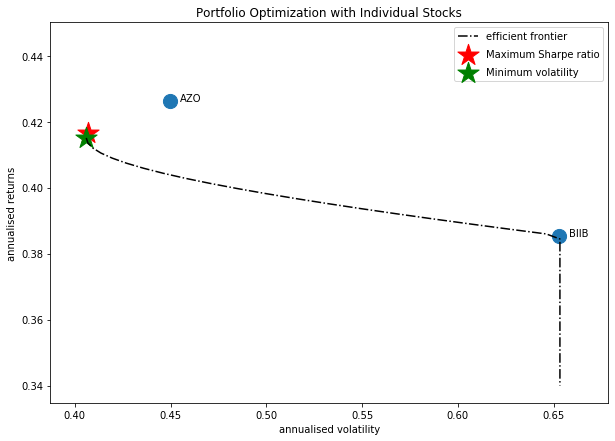

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'AYI']


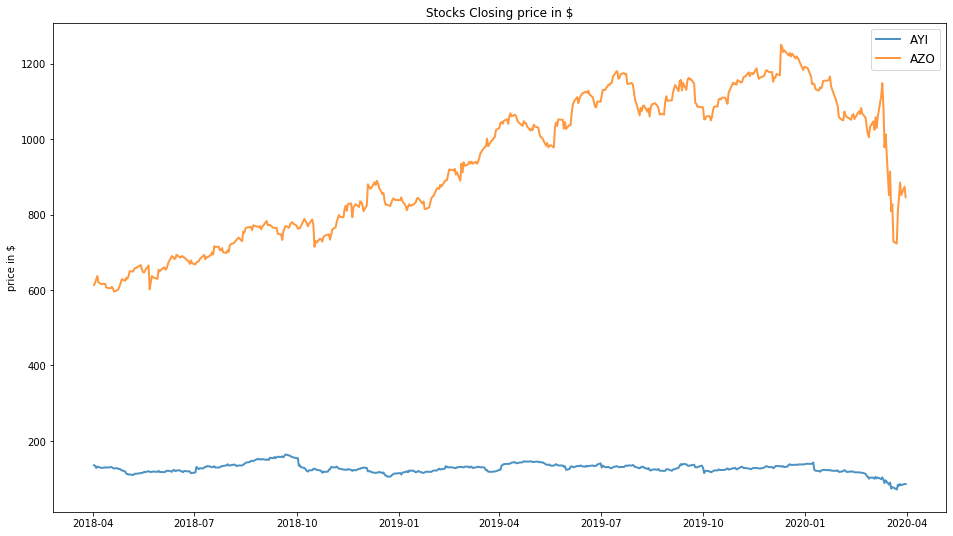

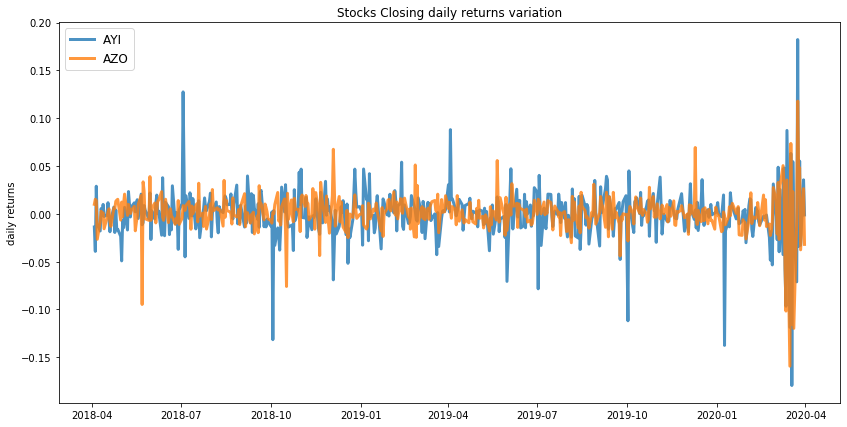

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.43
Annualised Volatility: 0.45


            AYI    AZO
allocation  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.24
Annualised Volatility: 0.42


              AYI    AZO
allocation  26.07  73.93


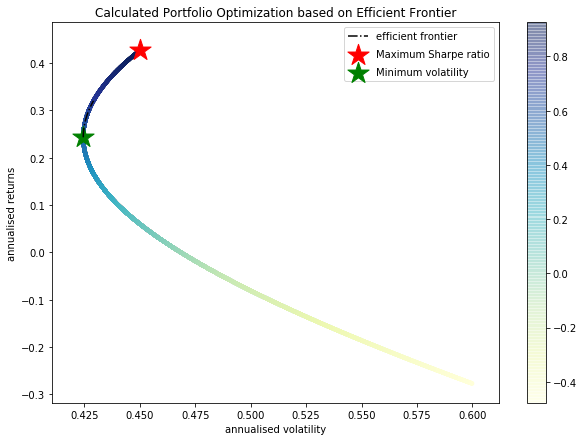

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AYI : annuaised return -0.28 , annualised volatility: 0.6
AZO : annuaised return 0.43 , annualised volatility: 0.45
--------------------------------------------------------------------------------


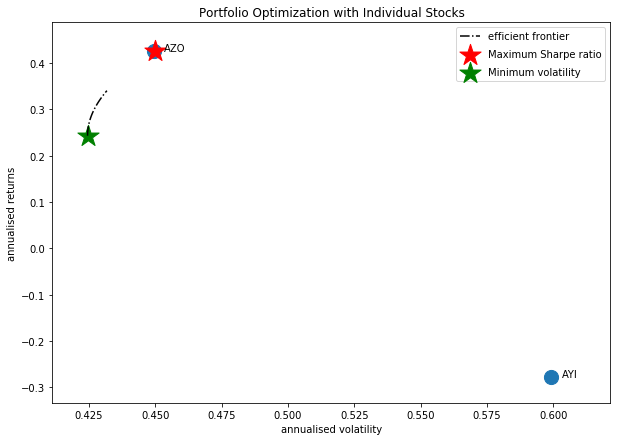

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'FCX']


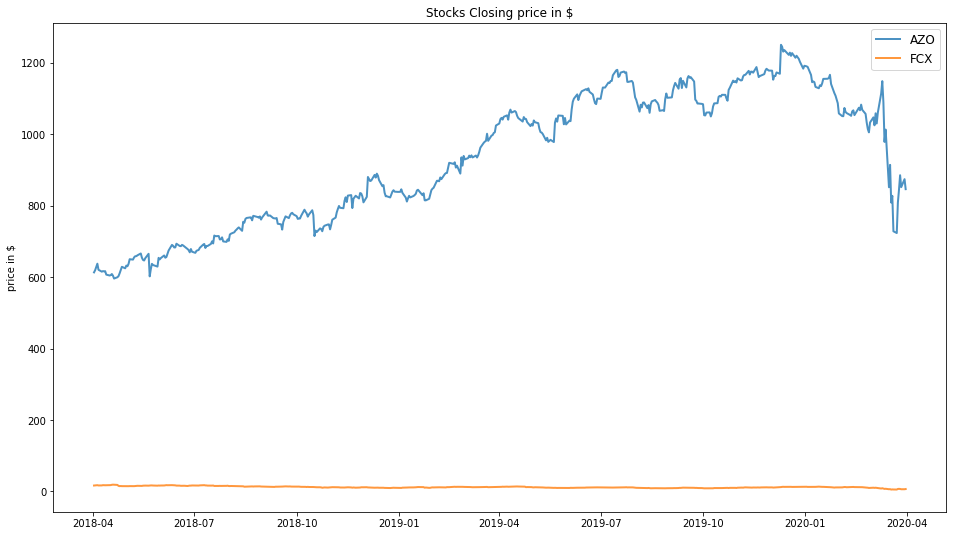

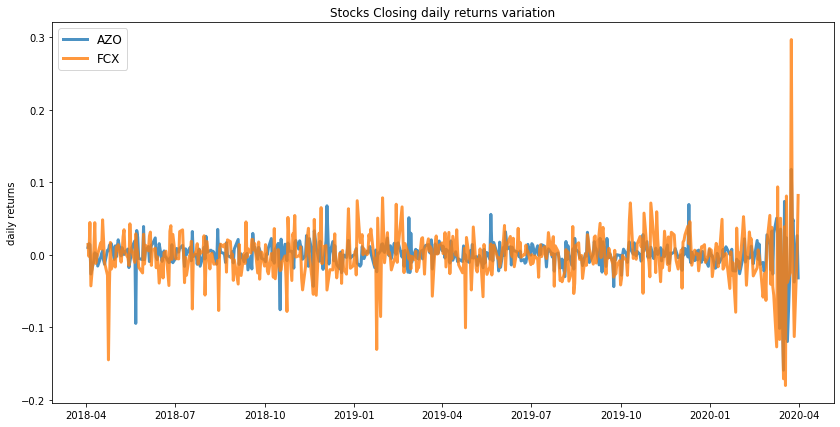

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.43
Annualised Volatility: 0.45


              AZO  FCX
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.31
Annualised Volatility: 0.44


              AZO    FCX
allocation  88.45  11.55


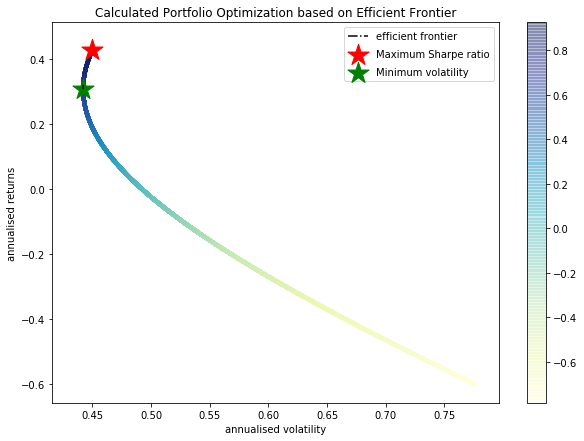

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AZO : annuaised return 0.43 , annualised volatility: 0.45
FCX : annuaised return -0.6 , annualised volatility: 0.78
--------------------------------------------------------------------------------


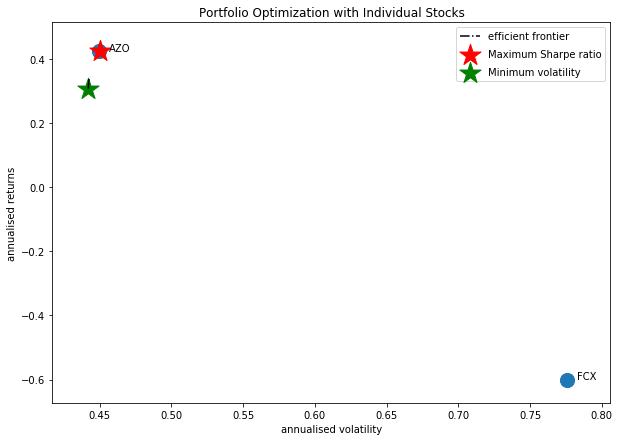

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BLK', 'CMG', 'BHF']


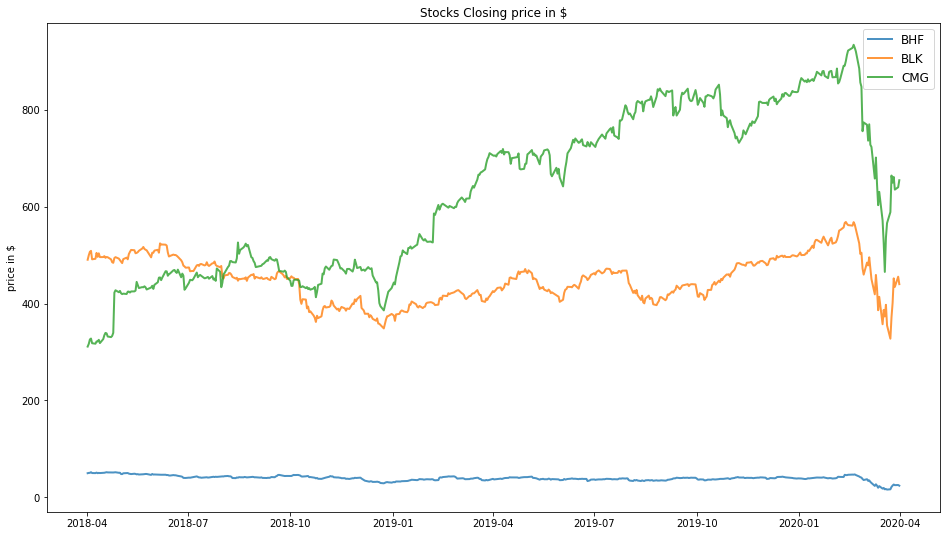

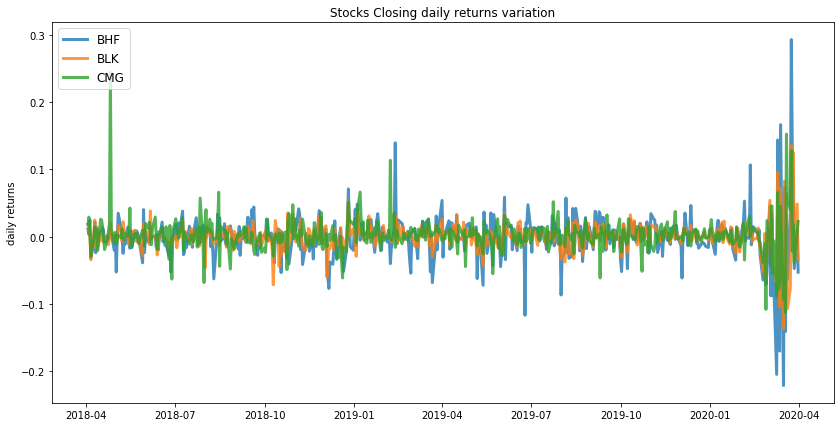

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.91
Annualised Volatility: 0.58


            BHF  BLK    CMG
allocation  0.0  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.34
Annualised Volatility: 0.43


            BHF    BLK    CMG
allocation  0.0  62.82  37.18


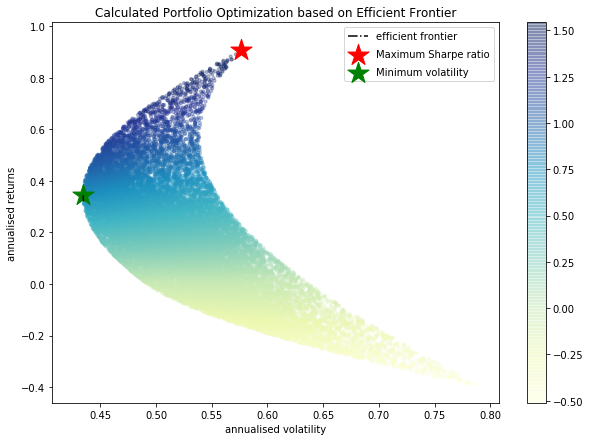

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BHF : annuaised return -0.41 , annualised volatility: 0.8
BLK : annuaised return 0.01 , annualised volatility: 0.49
CMG : annuaised return 0.91 , annualised volatility: 0.58
--------------------------------------------------------------------------------


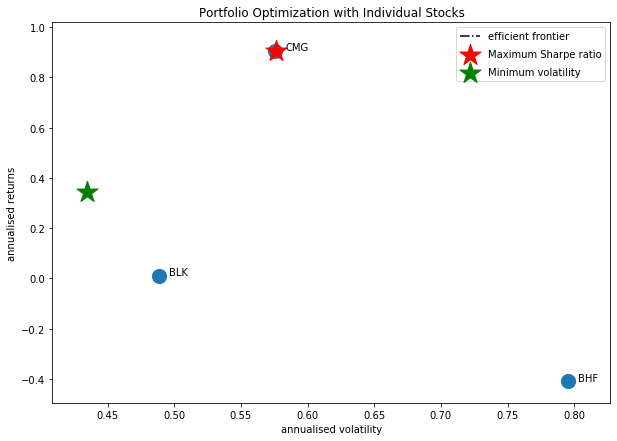

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AAPL', 'CMG']


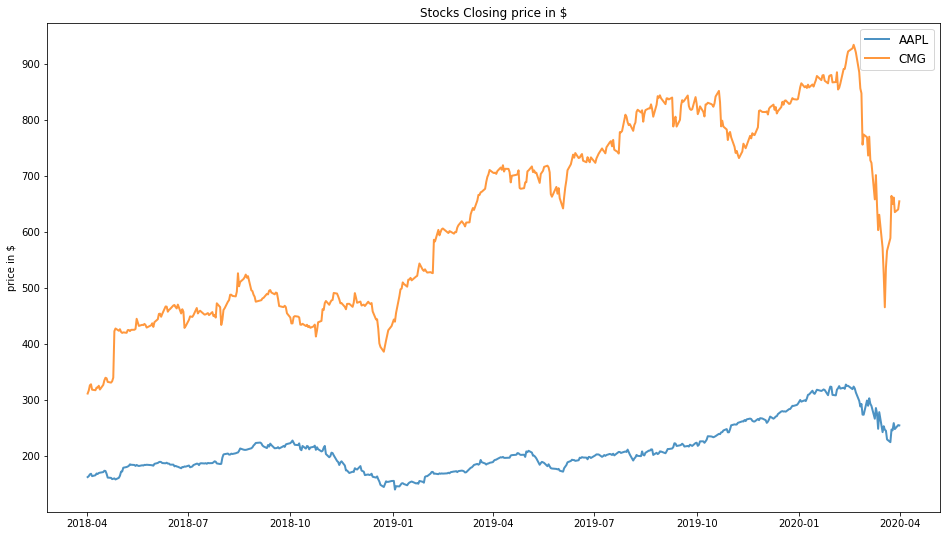

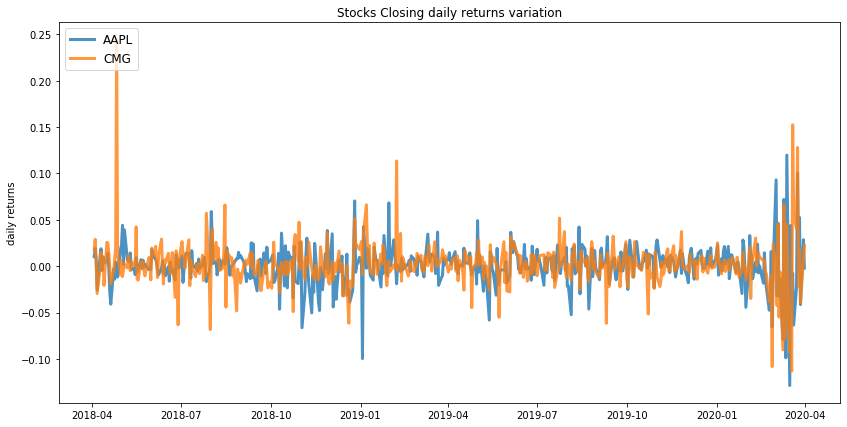

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.78
Annualised Volatility: 0.46


             AAPL    CMG
allocation  37.57  62.43
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.7
Annualised Volatility: 0.43


             AAPL    CMG
allocation  62.29  37.71


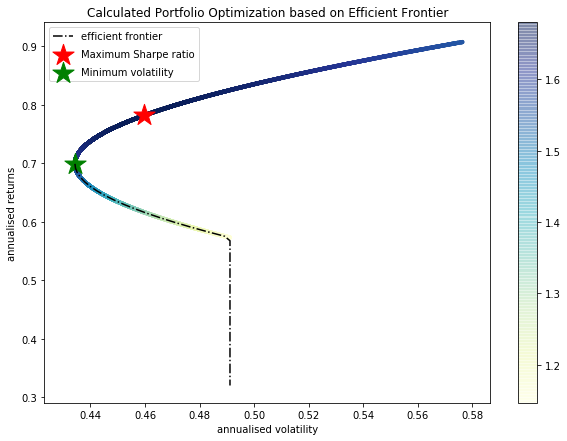

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
CMG : annuaised return 0.91 , annualised volatility: 0.58
--------------------------------------------------------------------------------


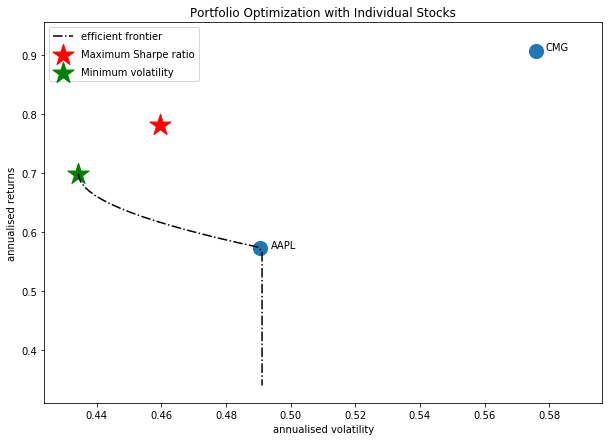

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['DISCK', 'BIIB', 'CMG', 'BHF']


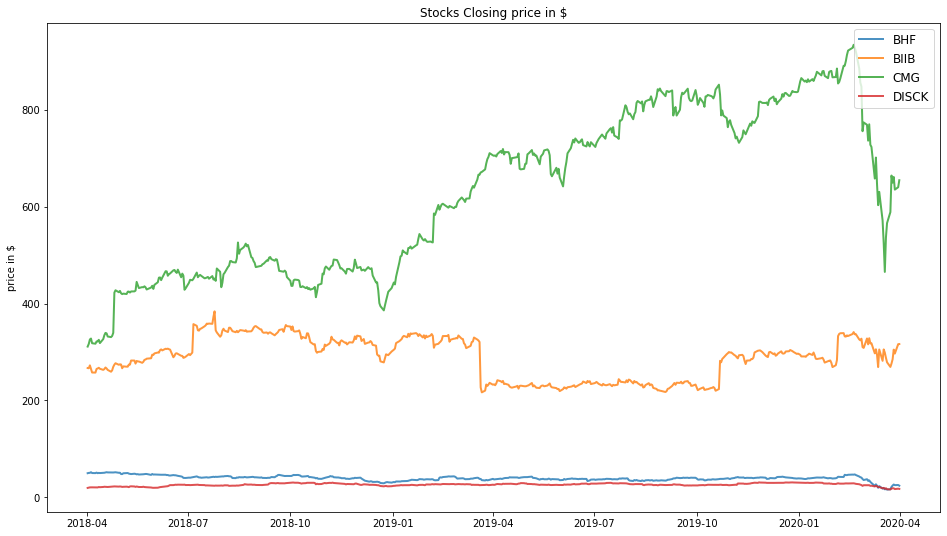

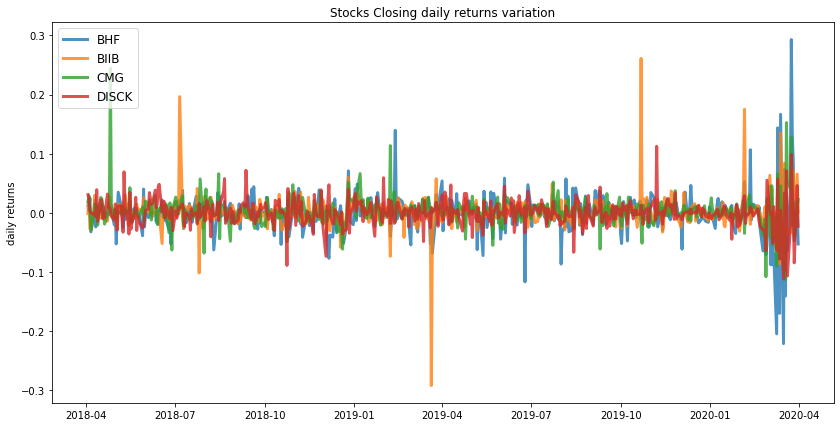

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.81
Annualised Volatility: 0.5


            BHF   BIIB    CMG  DISCK
allocation  0.0  19.01  80.99    0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.41
Annualised Volatility: 0.4


            BHF   BIIB    CMG  DISCK
allocation  0.0  26.54  33.29  40.17


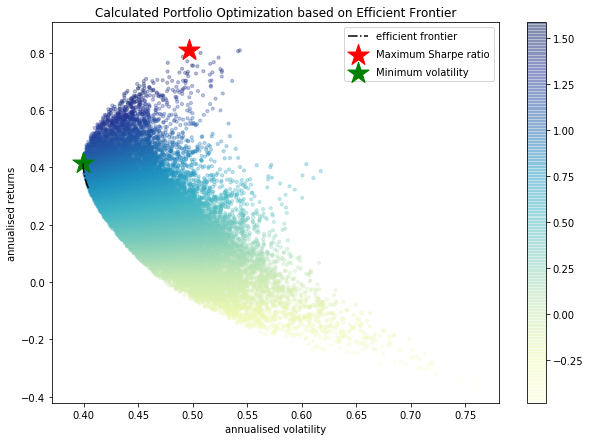

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CMG : annuaised return 0.91 , annualised volatility: 0.58
DISCK : annuaised return 0.02 , annualised volatility: 0.52
--------------------------------------------------------------------------------


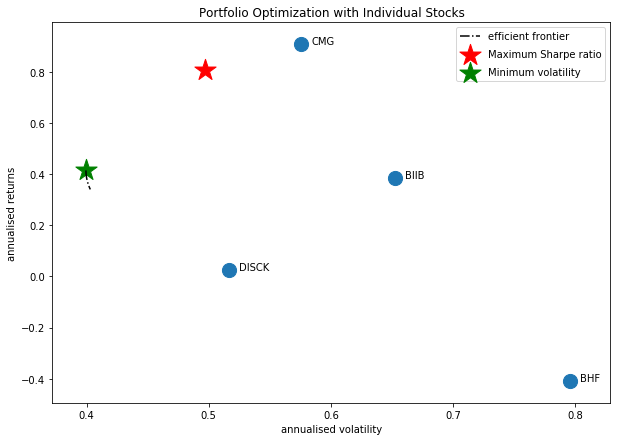

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AYI', 'CMG']


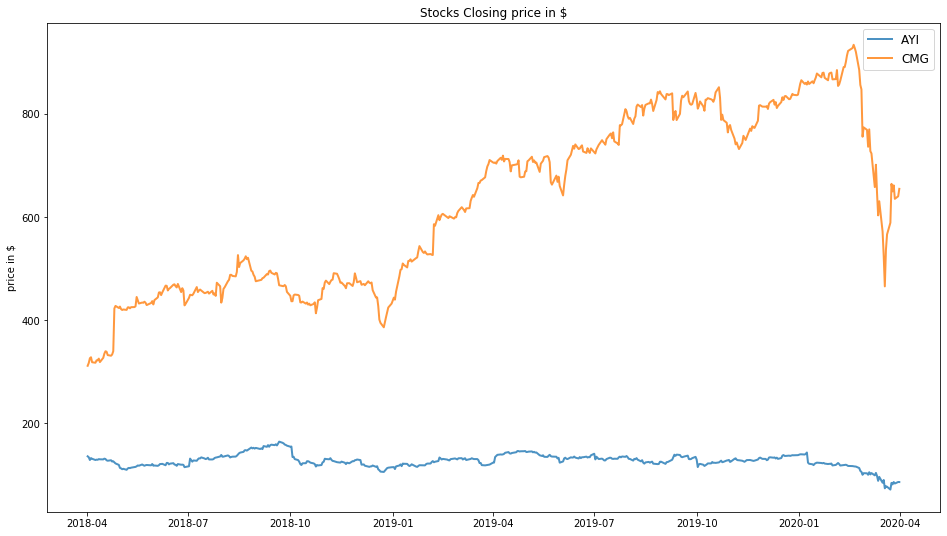

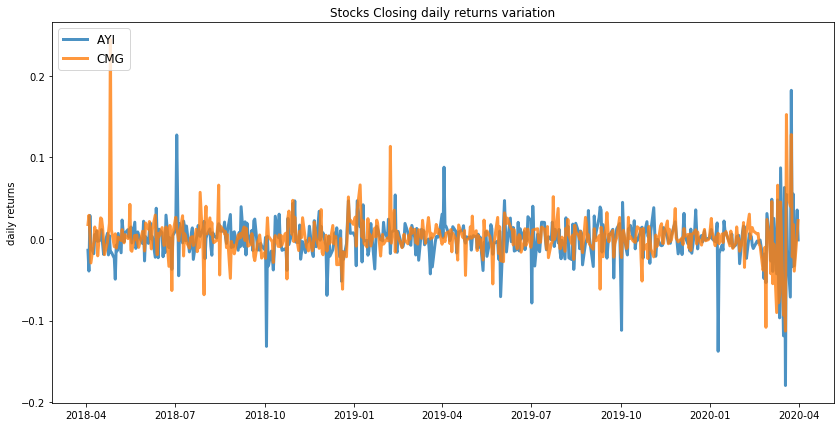

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.91
Annualised Volatility: 0.58


            AYI    CMG
allocation  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.35
Annualised Volatility: 0.48


              AYI    CMG
allocation  46.91  53.09


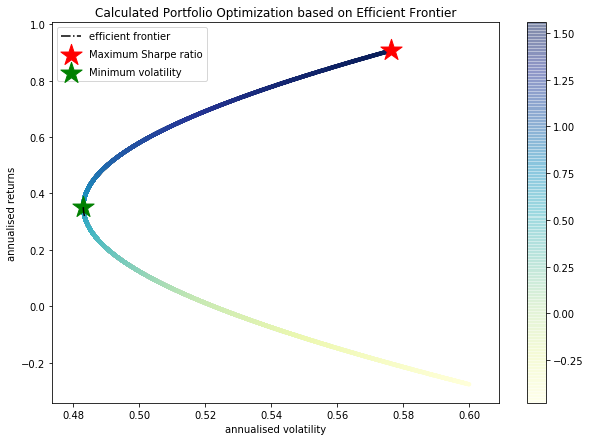

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AYI : annuaised return -0.28 , annualised volatility: 0.6
CMG : annuaised return 0.91 , annualised volatility: 0.58
--------------------------------------------------------------------------------


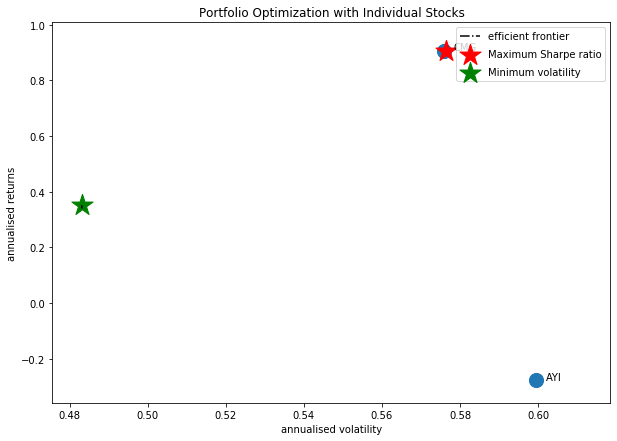

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CMG', 'NEM']


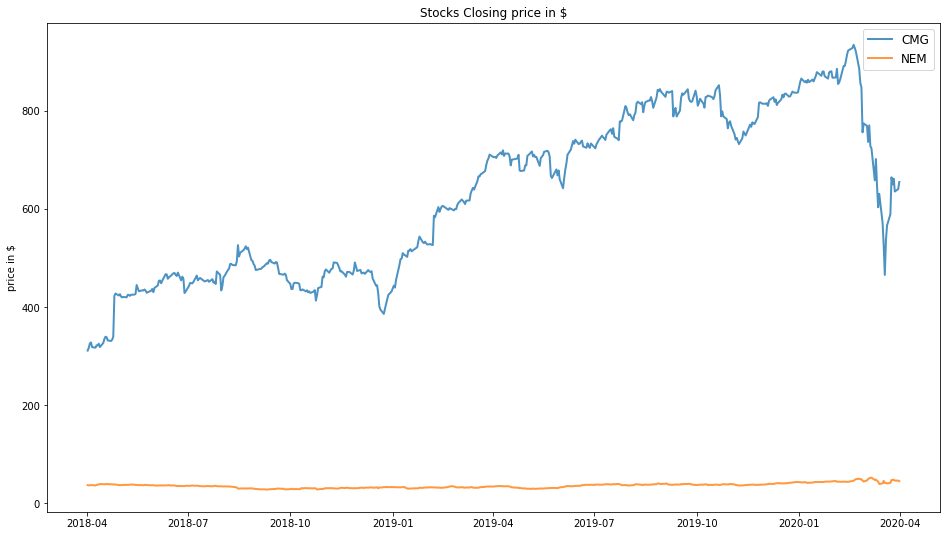

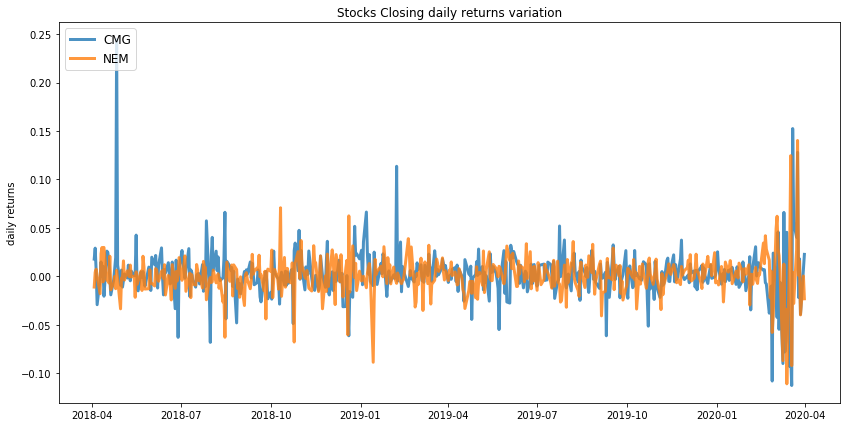

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.73
Annualised Volatility: 0.44


              CMG    NEM
allocation  70.34  29.66
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.53
Annualised Volatility: 0.37


              CMG    NEM
allocation  37.32  62.68


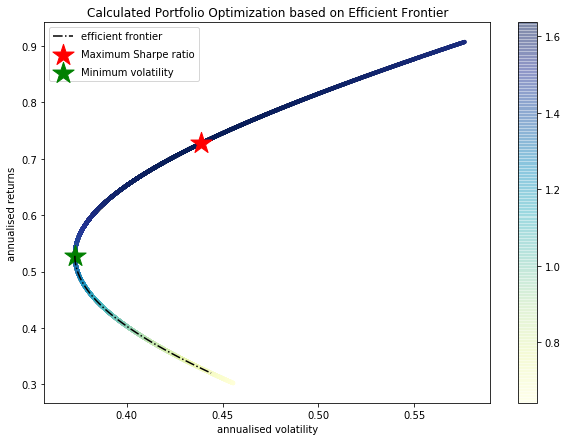

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

CMG : annuaised return 0.91 , annualised volatility: 0.58
NEM : annuaised return 0.3 , annualised volatility: 0.46
--------------------------------------------------------------------------------


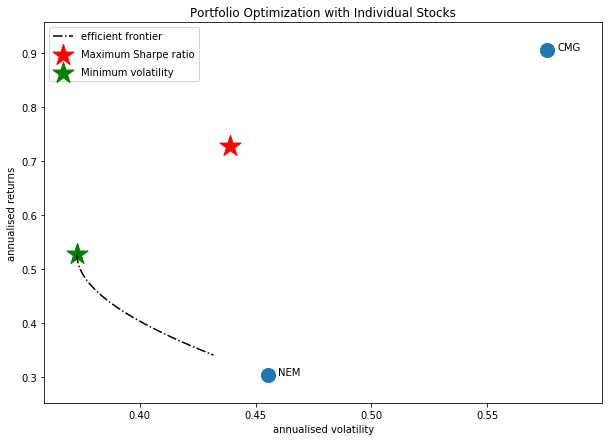

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CMG', 'FCX']


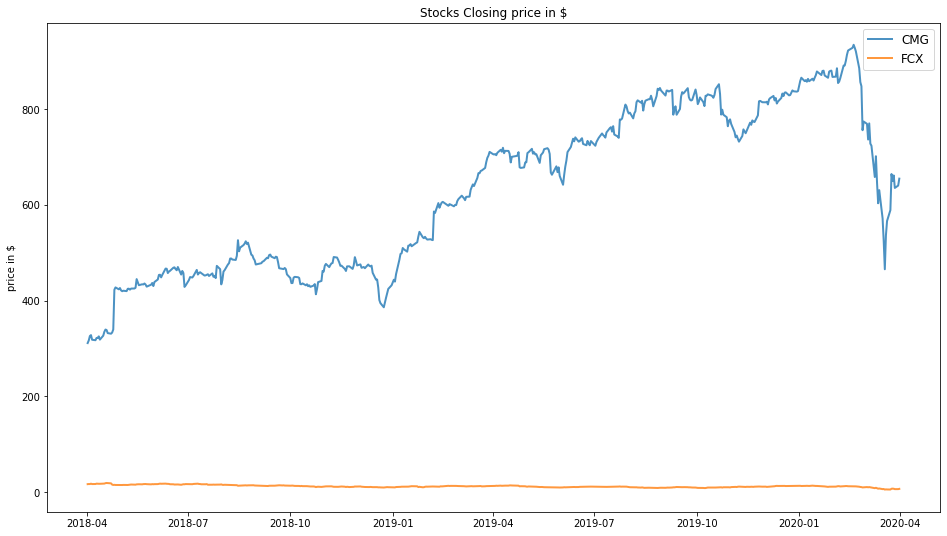

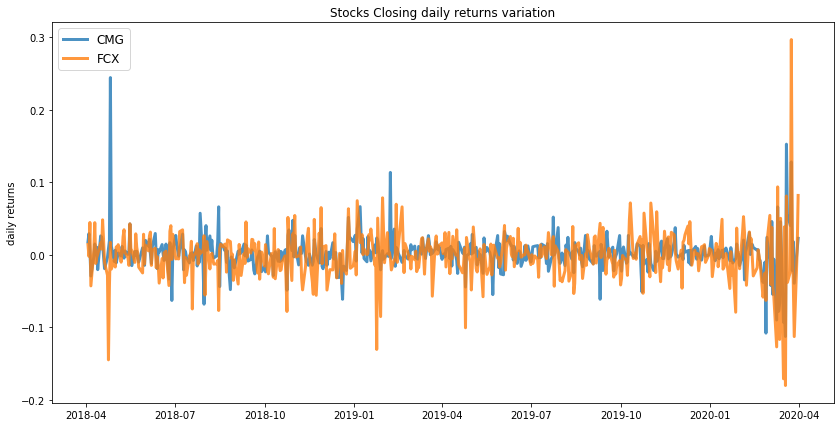

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.91
Annualised Volatility: 0.58


              CMG  FCX
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.5
Annualised Volatility: 0.54


              CMG    FCX
allocation  72.71  27.29


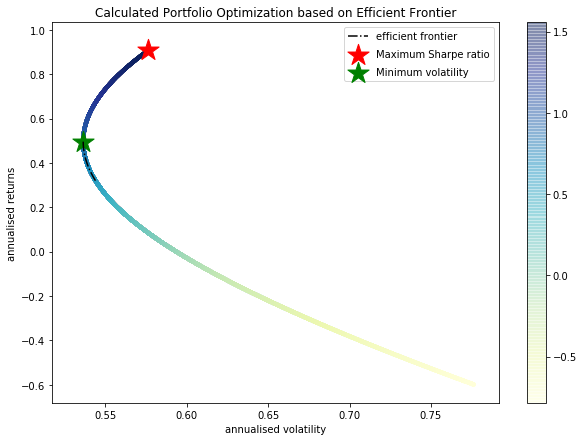

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

CMG : annuaised return 0.91 , annualised volatility: 0.58
FCX : annuaised return -0.6 , annualised volatility: 0.78
--------------------------------------------------------------------------------


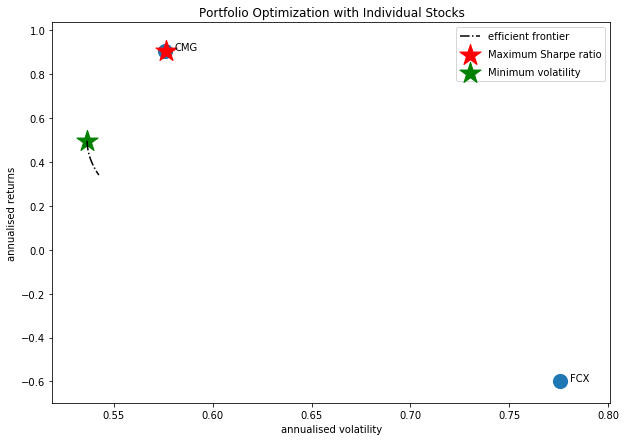

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'STZ']


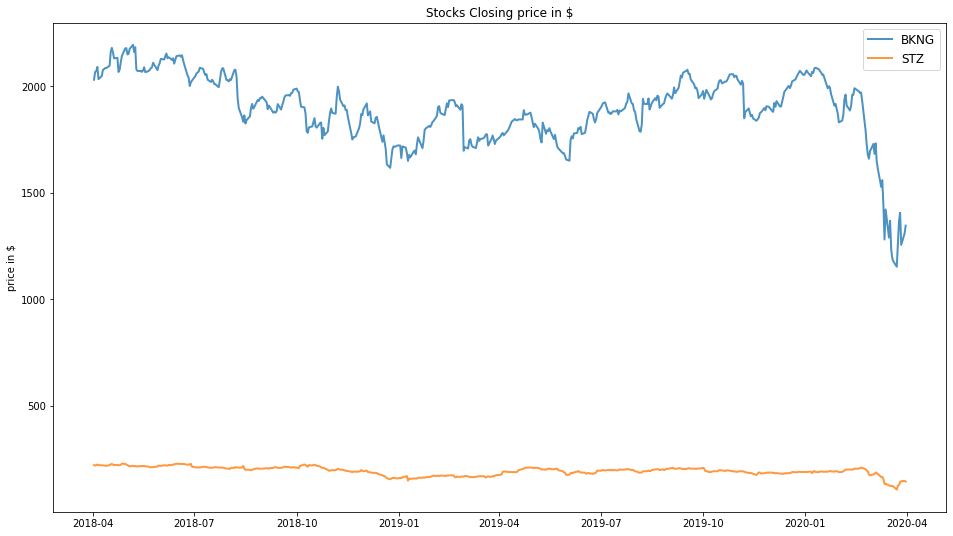

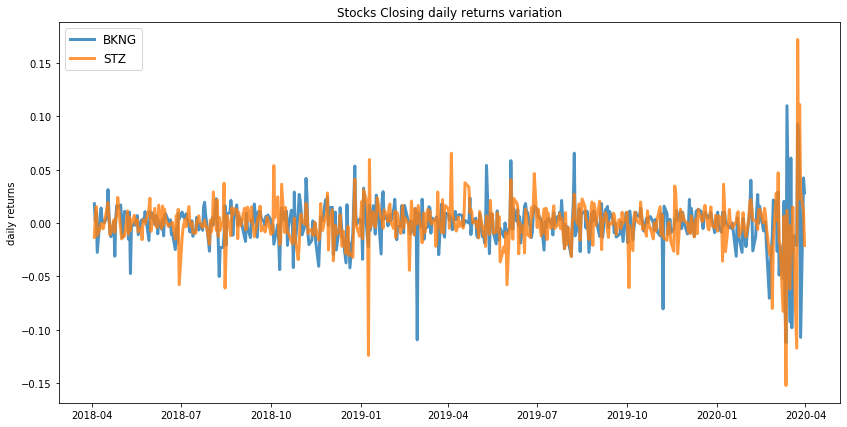

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: -0.32
Annualised Volatility: 0.49


            BKNG    STZ
allocation   0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.31
Annualised Volatility: 0.4


             BKNG    STZ
allocation  53.62  46.38


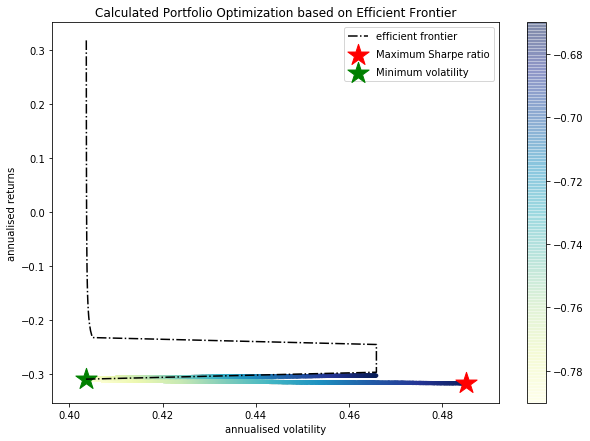

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BKNG : annuaised return -0.3 , annualised volatility: 0.47
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


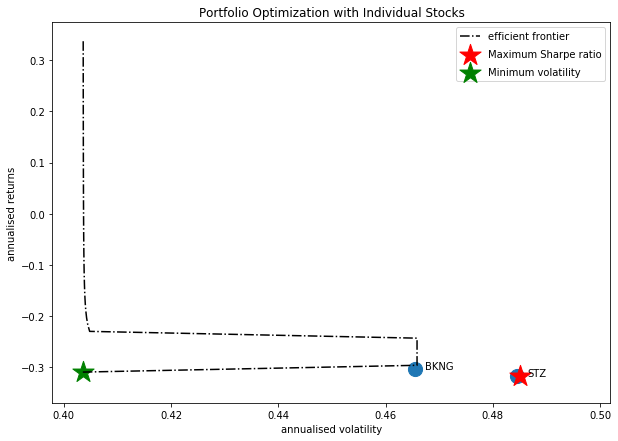

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AAP', 'BA', 'AMGN', 'BIIB', 'STZ', 'DVN', 'BHF', 'DISCK']


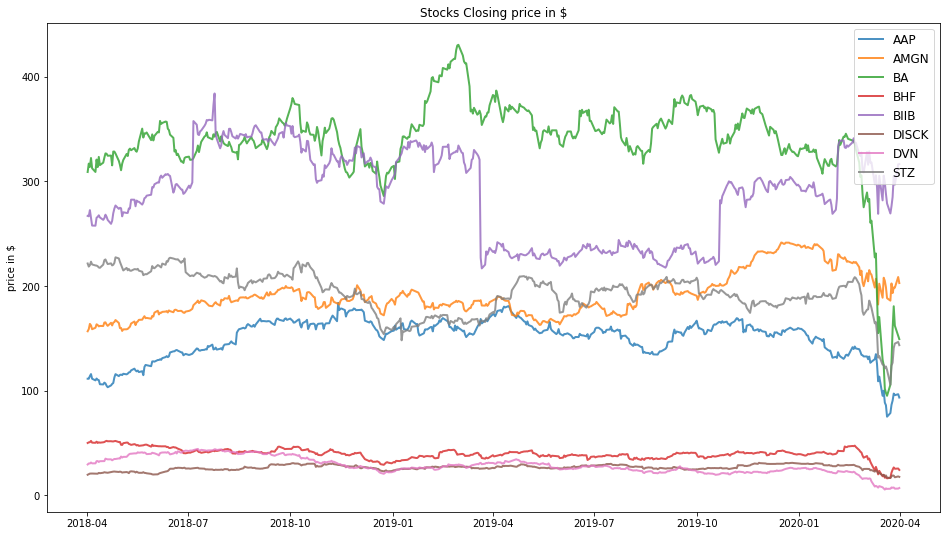

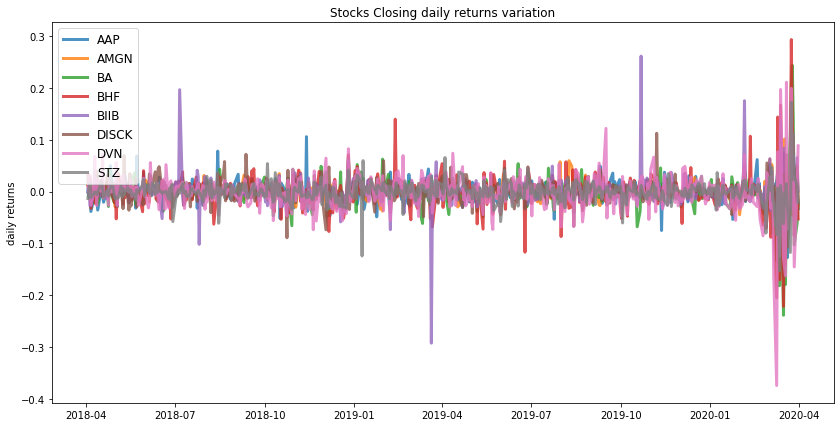

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.35
Annualised Volatility: 0.4


            AAP   AMGN   BA  BHF   BIIB  DISCK  DVN  STZ
allocation  0.0  83.72  0.0  0.0  16.28    0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.09
Annualised Volatility: 0.34


              AAP   AMGN   BA  BHF  BIIB  DISCK  DVN    STZ
allocation  16.02  41.69  0.0  0.0  3.97   16.9  0.0  21.41


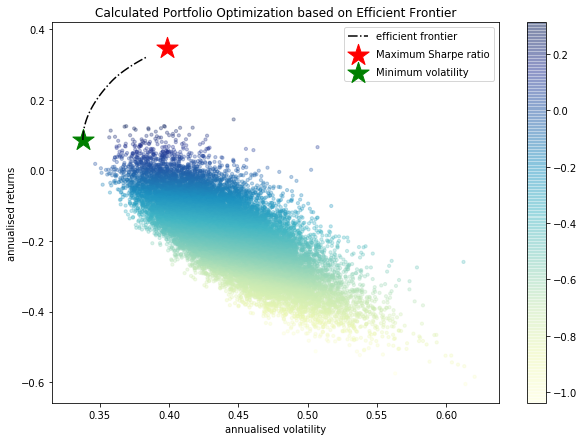

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAP : annuaised return -0.04 , annualised volatility: 0.51
AMGN : annuaised return 0.34 , annualised volatility: 0.4
BA : annuaised return -0.47 , annualised volatility: 0.72
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
DISCK : annuaised return 0.02 , annualised volatility: 0.52
DVN : annuaised return -1.05 , annualised volatility: 0.87
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


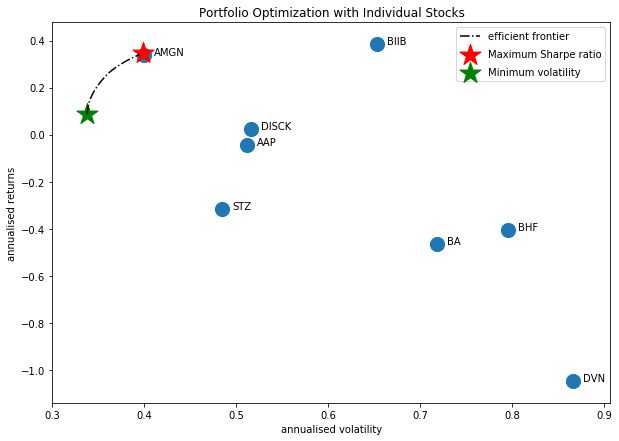

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AMZN', 'AAP', 'BA', 'AMGN', 'BIIB', 'STZ', 'BHF', 'DISCK']


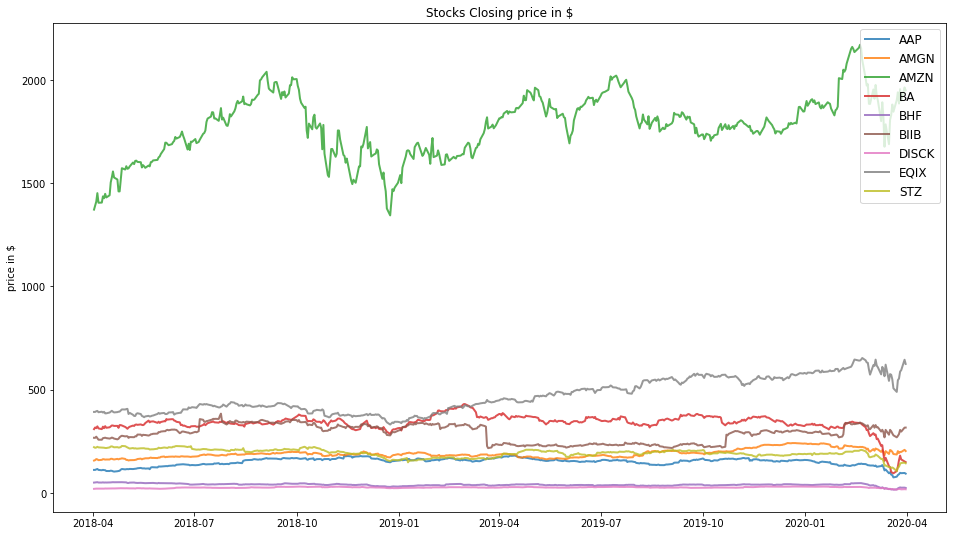

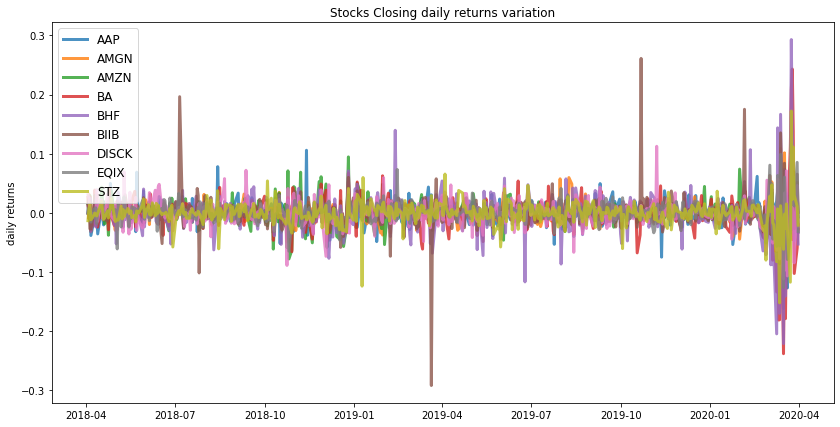

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.52
Annualised Volatility: 0.37


            AAP  AMGN   AMZN   BA  BHF  BIIB  DISCK   EQIX  STZ
allocation  0.0   0.0  30.37  0.0  0.0  4.06    0.0  65.56  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.24
Annualised Volatility: 0.32


              AAP   AMGN   AMZN   BA  BHF  BIIB  DISCK  EQIX    STZ
allocation  10.87  24.64  17.93  0.0  0.0   2.6  12.55  19.2  12.22


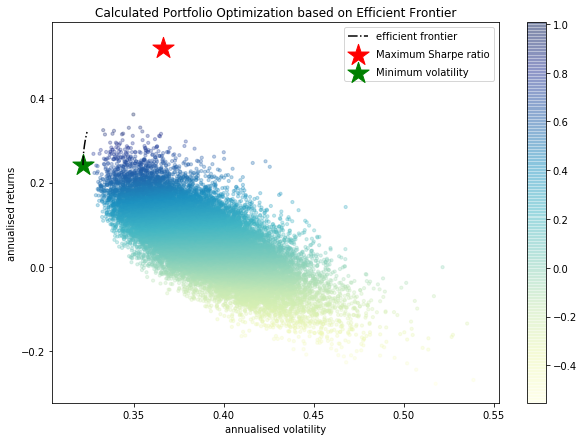

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAP : annuaised return -0.04 , annualised volatility: 0.51
AMGN : annuaised return 0.34 , annualised volatility: 0.4
AMZN : annuaised return 0.46 , annualised volatility: 0.45
BA : annuaised return -0.47 , annualised volatility: 0.72
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
DISCK : annuaised return 0.02 , annualised volatility: 0.52
EQIX : annuaised return 0.56 , annualised volatility: 0.42
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


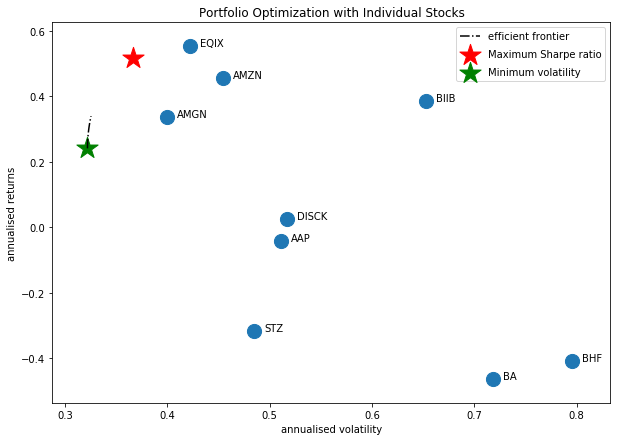

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AAP', 'BA', 'AMGN', 'BIIB', 'STZ', 'BHF', 'NEM', 'DISCK']


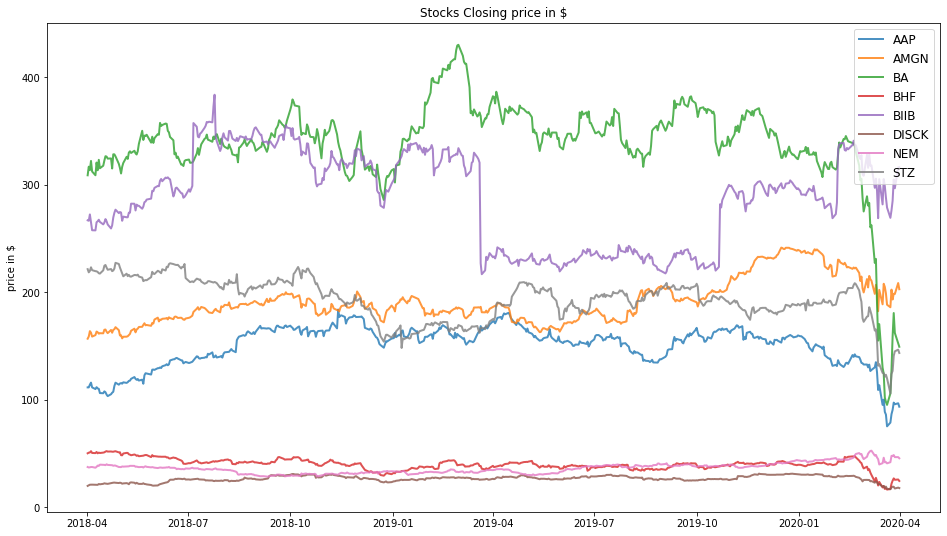

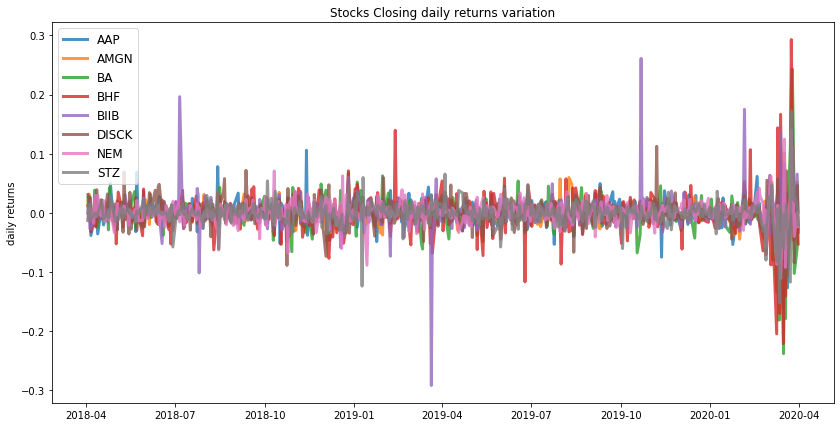

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.33
Annualised Volatility: 0.32


            AAP   AMGN   BA  BHF   BIIB  DISCK    NEM  STZ
allocation  0.0  48.71  0.0  0.0  12.73    0.0  38.55  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.17
Annualised Volatility: 0.29


              AAP   AMGN   BA  BHF  BIIB  DISCK    NEM    STZ
allocation  11.16  27.33  0.0  0.0  4.78  11.56  32.81  12.36


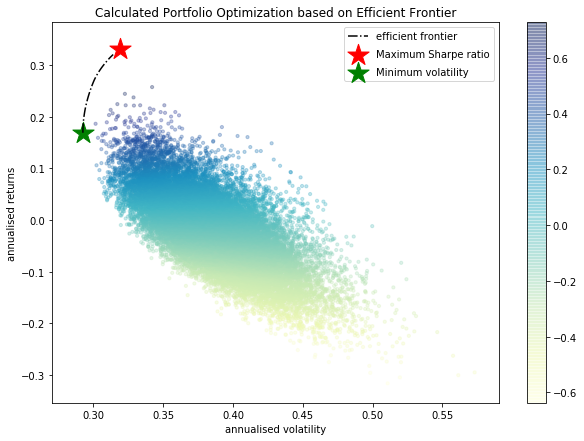

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAP : annuaised return -0.04 , annualised volatility: 0.51
AMGN : annuaised return 0.34 , annualised volatility: 0.4
BA : annuaised return -0.47 , annualised volatility: 0.72
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
DISCK : annuaised return 0.02 , annualised volatility: 0.52
NEM : annuaised return 0.3 , annualised volatility: 0.46
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


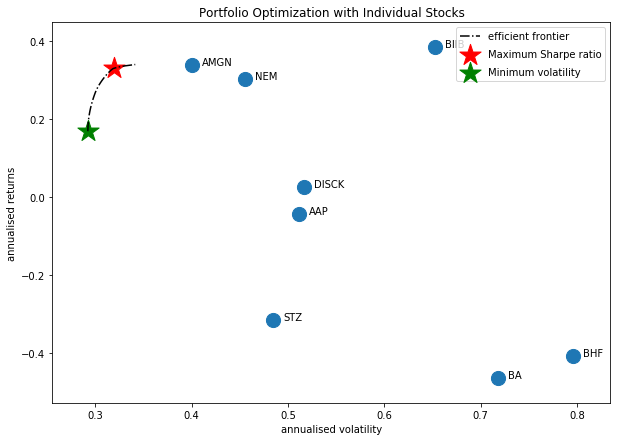

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AAP', 'BA', 'AMGN', 'BIIB', 'STZ', 'BHF', 'FCX', 'DISCK']


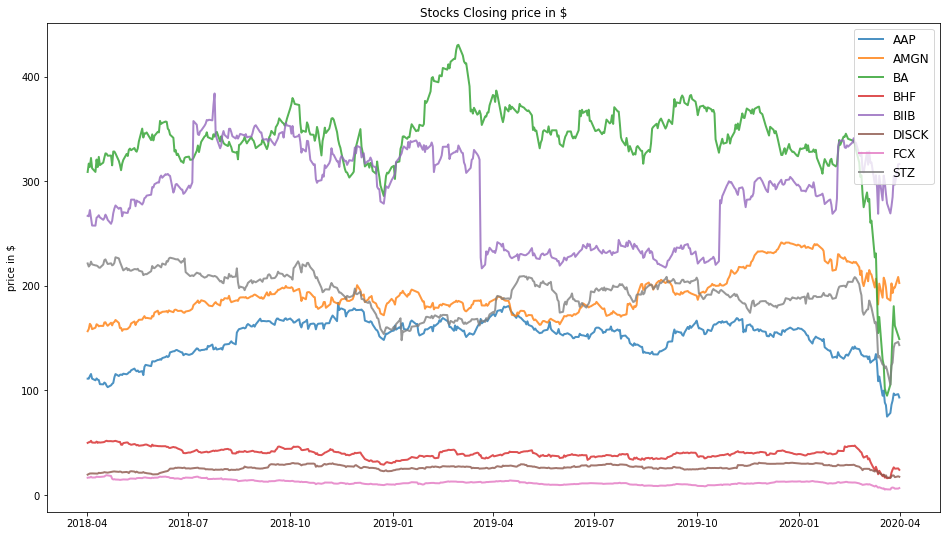

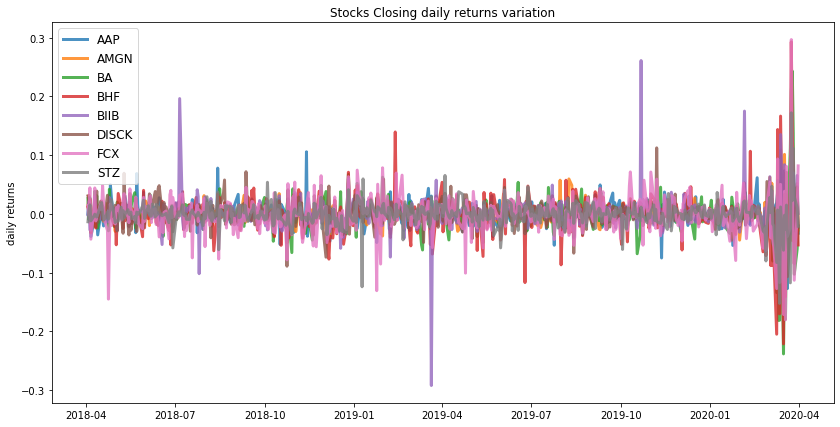

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.35
Annualised Volatility: 0.4


            AAP   AMGN   BA  BHF   BIIB  DISCK  FCX  STZ
allocation  0.0  83.74  0.0  0.0  16.26    0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.09
Annualised Volatility: 0.34


              AAP  AMGN   BA  BHF  BIIB  DISCK  FCX    STZ
allocation  16.02  41.7  0.0  0.0  3.96   16.9  0.0  21.42


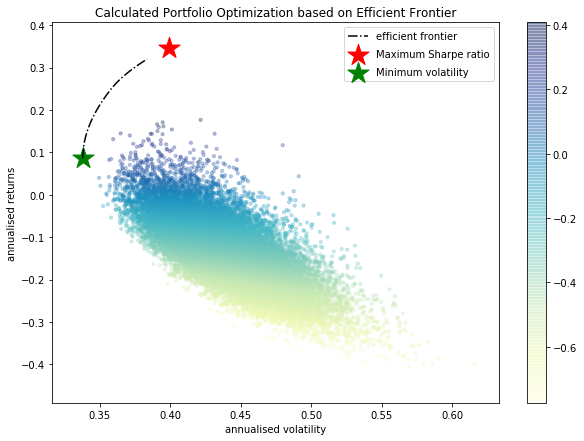

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAP : annuaised return -0.04 , annualised volatility: 0.51
AMGN : annuaised return 0.34 , annualised volatility: 0.4
BA : annuaised return -0.47 , annualised volatility: 0.72
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
DISCK : annuaised return 0.02 , annualised volatility: 0.52
FCX : annuaised return -0.6 , annualised volatility: 0.78
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


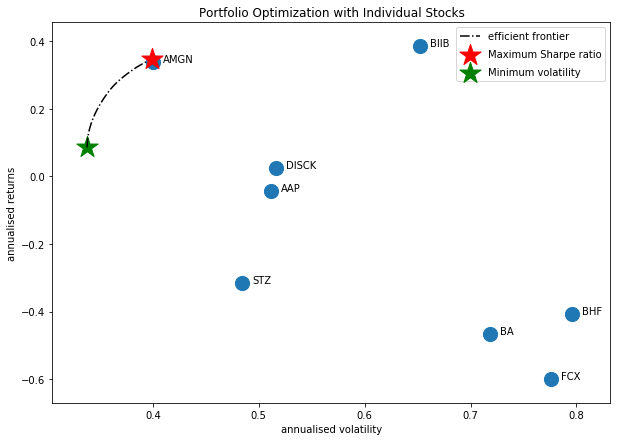

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BLK', 'BHF', 'BA']


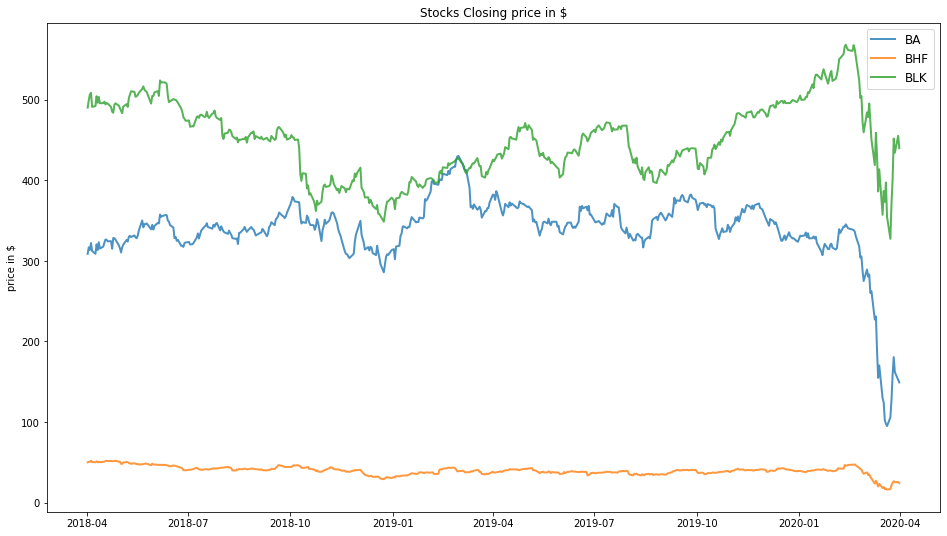

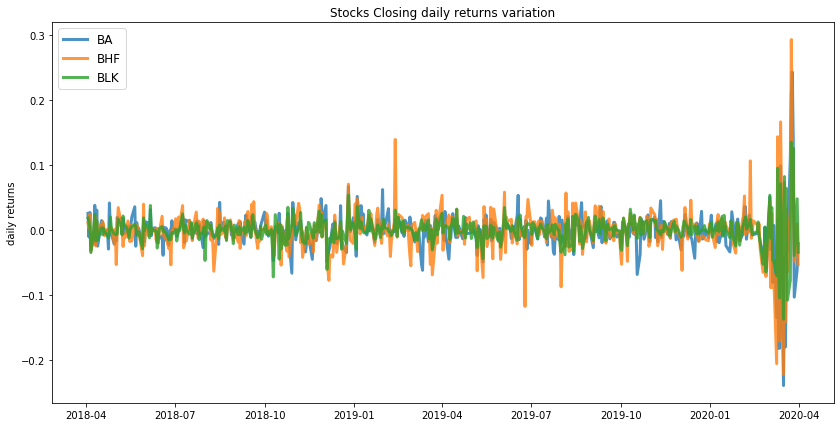

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.01
Annualised Volatility: 0.49


             BA  BHF    BLK
allocation  0.0  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.03
Annualised Volatility: 0.49


              BA  BHF    BLK
allocation  7.71  0.0  92.29


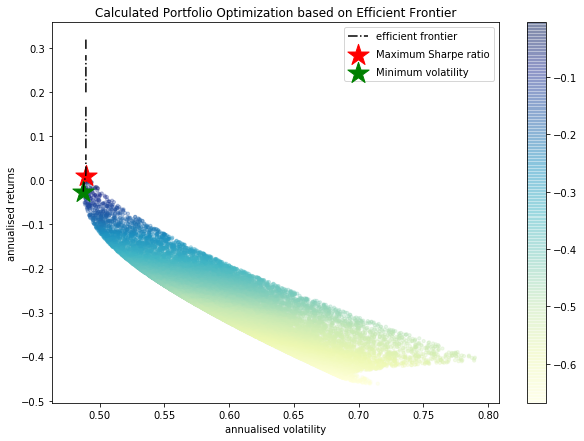

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BA : annuaised return -0.47 , annualised volatility: 0.72
BHF : annuaised return -0.41 , annualised volatility: 0.8
BLK : annuaised return 0.01 , annualised volatility: 0.49
--------------------------------------------------------------------------------


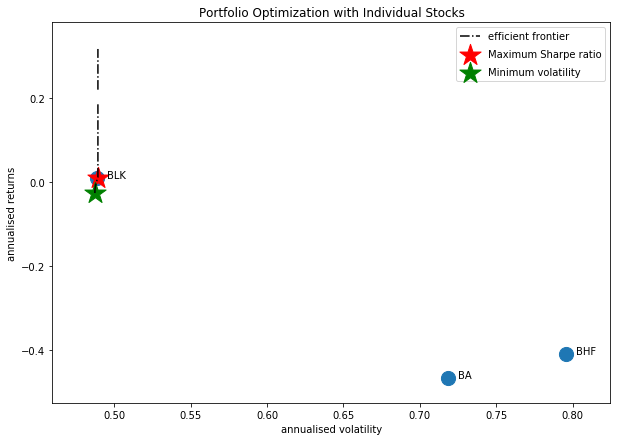

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AAPL', 'AYI', 'STZ', 'BA']


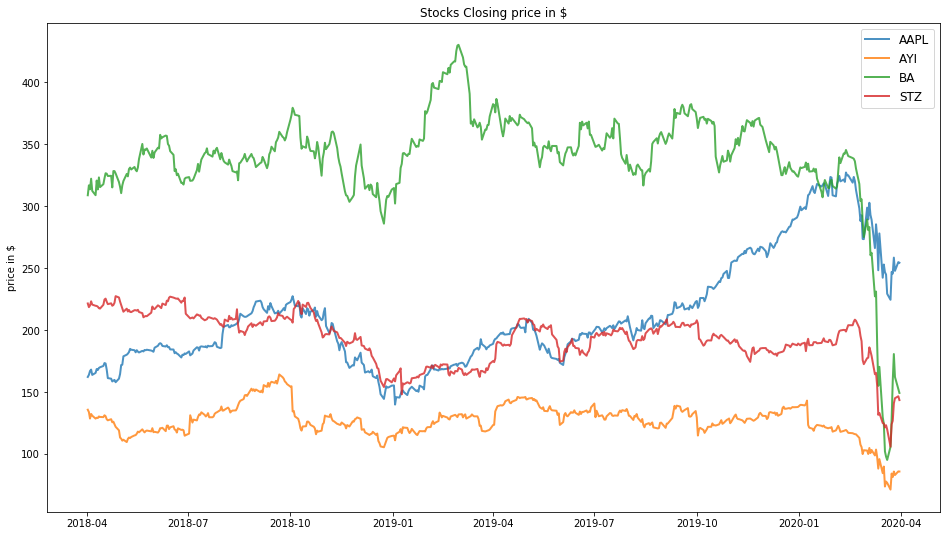

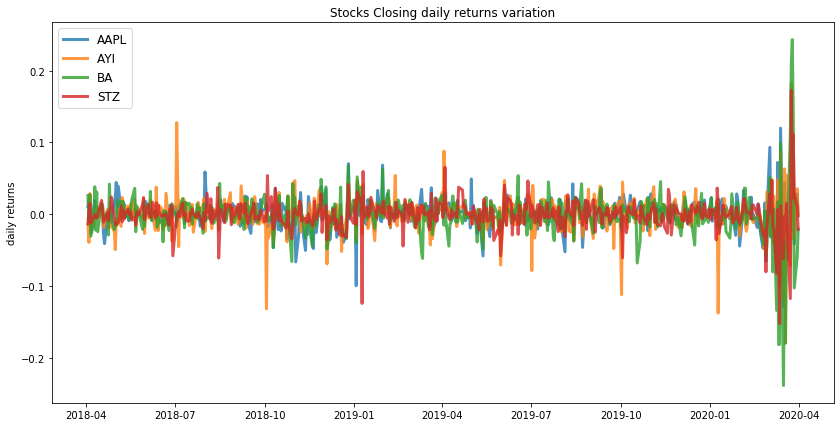

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.57
Annualised Volatility: 0.49


             AAPL  AYI   BA  STZ
allocation  100.0  0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.06
Annualised Volatility: 0.41


             AAPL    AYI   BA    STZ
allocation  41.29  14.74  0.0  43.97


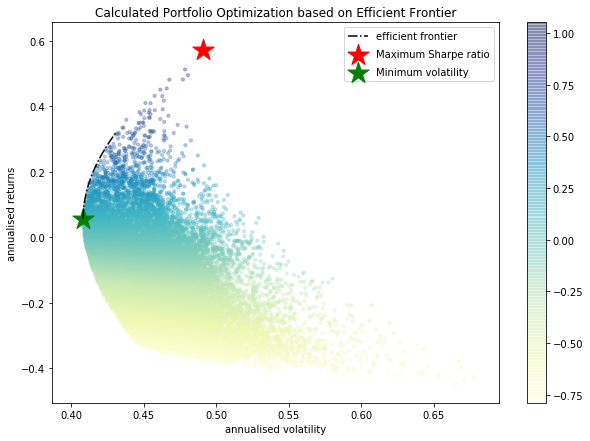

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
AYI : annuaised return -0.28 , annualised volatility: 0.6
BA : annuaised return -0.47 , annualised volatility: 0.72
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


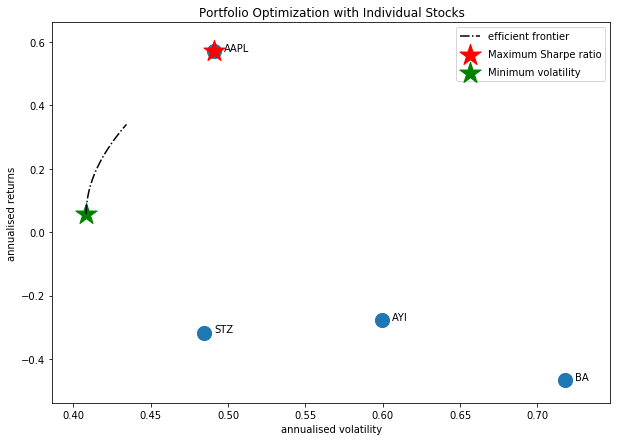

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AAP', 'BA', 'AMGN', 'AAPL', 'BIIB', 'STZ', 'DVN', 'BHF', 'DISCK']


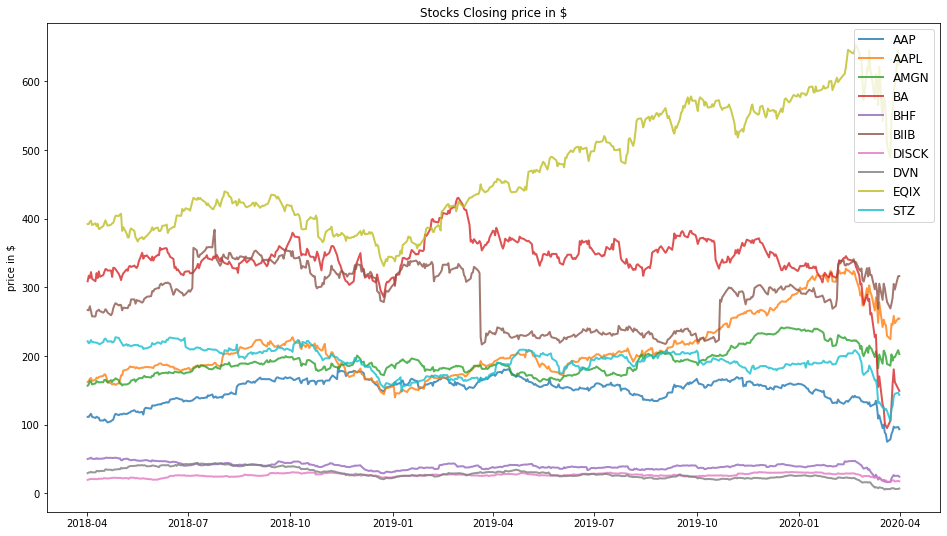

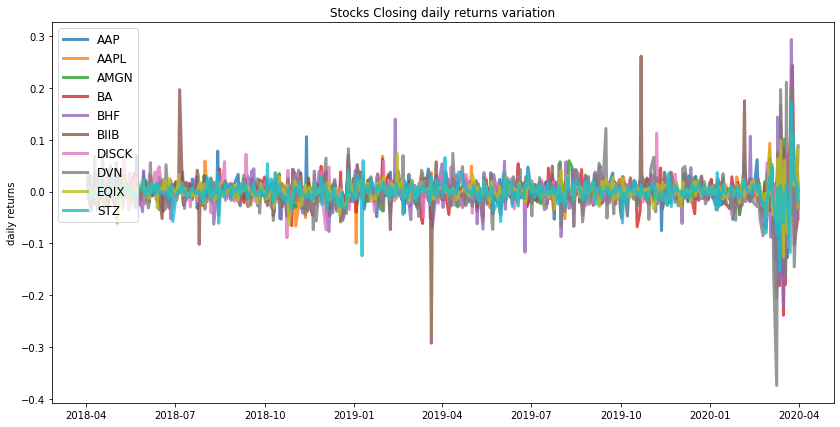

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.56
Annualised Volatility: 0.39


            AAP   AAPL  AMGN   BA  BHF  BIIB  DISCK  DVN  EQIX  STZ
allocation  0.0  34.78   0.0  0.0  0.0  3.42    0.0  0.0  61.8  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.19
Annualised Volatility: 0.33


              AAP  AAPL  AMGN   BA  BHF  BIIB  DISCK  DVN   EQIX    STZ
allocation  12.89   0.0  30.3  0.0  0.0  3.74  15.22  0.0  22.53  15.31


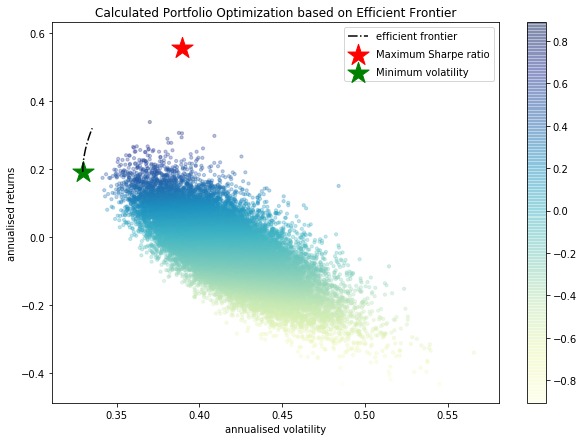

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAP : annuaised return -0.04 , annualised volatility: 0.51
AAPL : annuaised return 0.57 , annualised volatility: 0.49
AMGN : annuaised return 0.34 , annualised volatility: 0.4
BA : annuaised return -0.47 , annualised volatility: 0.72
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
DISCK : annuaised return 0.02 , annualised volatility: 0.52
DVN : annuaised return -1.05 , annualised volatility: 0.87
EQIX : annuaised return 0.56 , annualised volatility: 0.42
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


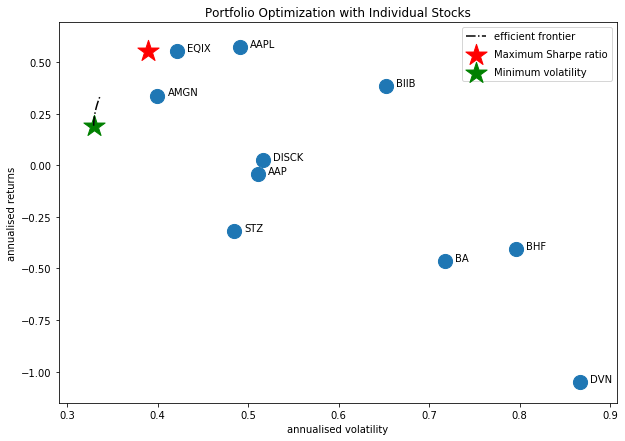

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AYI', 'STZ', 'BHF', 'BA']


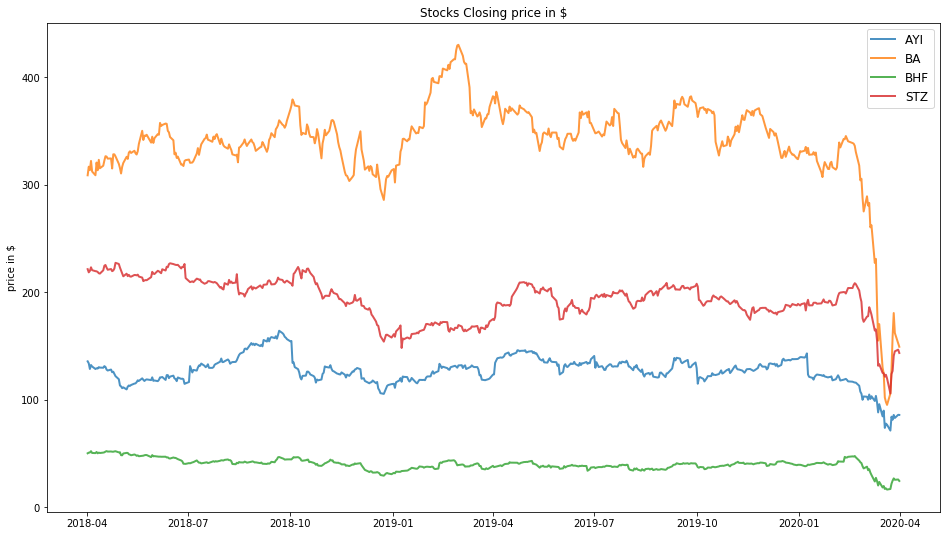

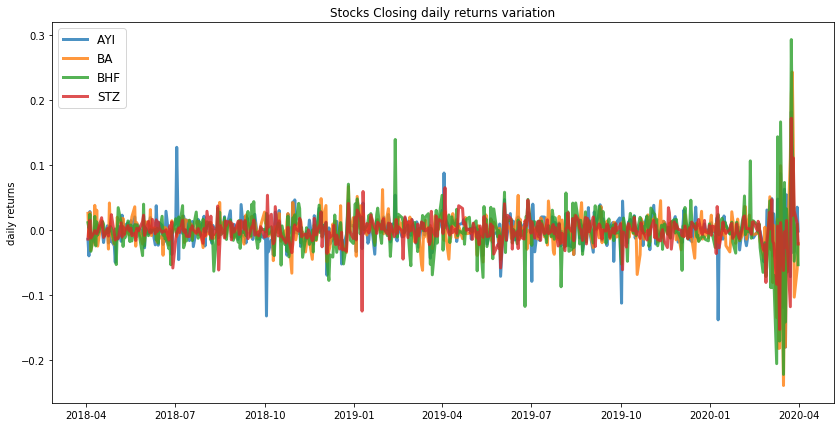

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: -0.41
Annualised Volatility: 0.8


            AYI   BA    BHF  STZ
allocation  0.0  0.0  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.32
Annualised Volatility: 0.45


              AYI     BA  BHF    STZ
allocation  26.91  10.28  0.0  62.81


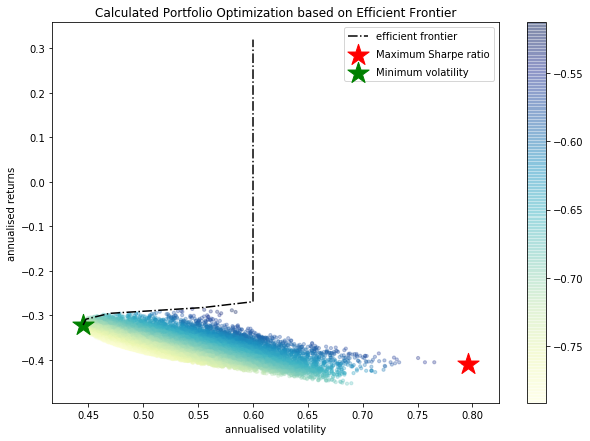

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AYI : annuaised return -0.28 , annualised volatility: 0.6
BA : annuaised return -0.47 , annualised volatility: 0.72
BHF : annuaised return -0.41 , annualised volatility: 0.8
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


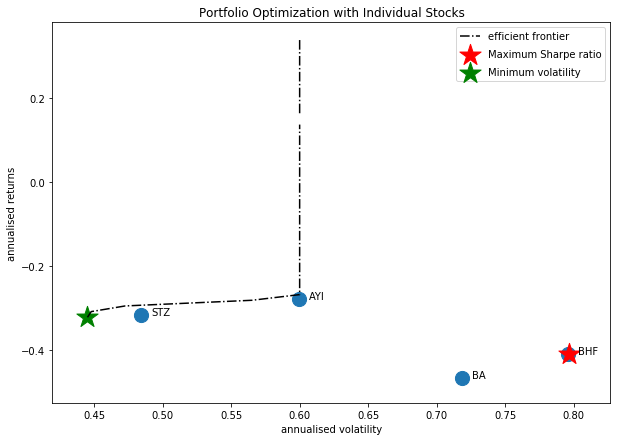

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BLK', 'AMGN', 'BHF']


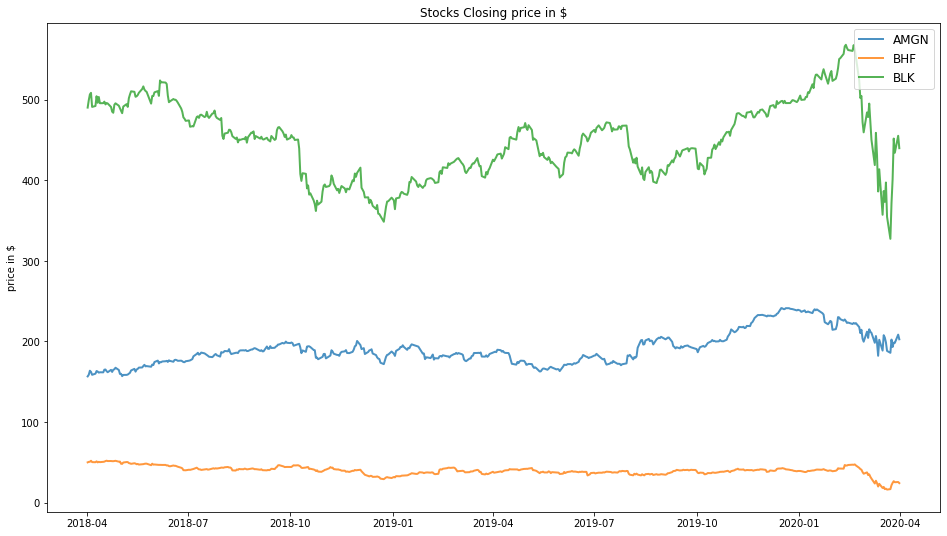

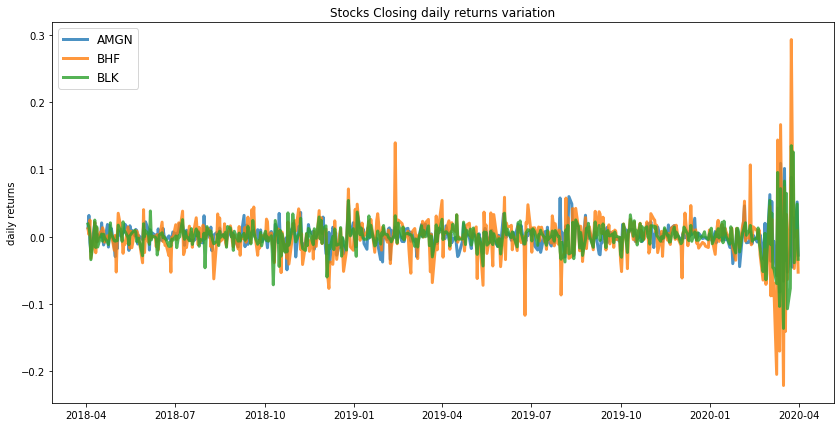

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.34
Annualised Volatility: 0.4


             AMGN  BHF  BLK
allocation  100.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.25
Annualised Volatility: 0.38


             AMGN  BHF    BLK
allocation  72.87  0.0  27.13


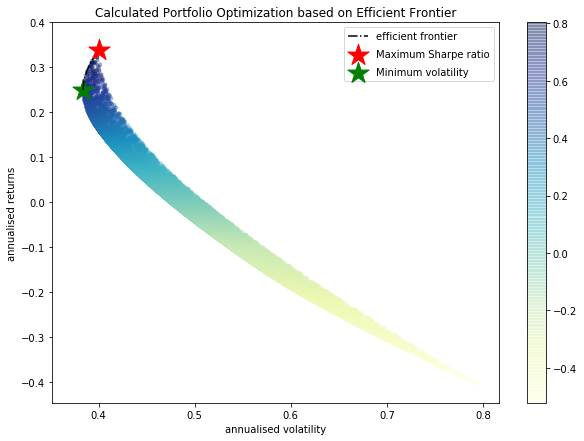

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.34 , annualised volatility: 0.4
BHF : annuaised return -0.41 , annualised volatility: 0.8
BLK : annuaised return 0.01 , annualised volatility: 0.49
--------------------------------------------------------------------------------


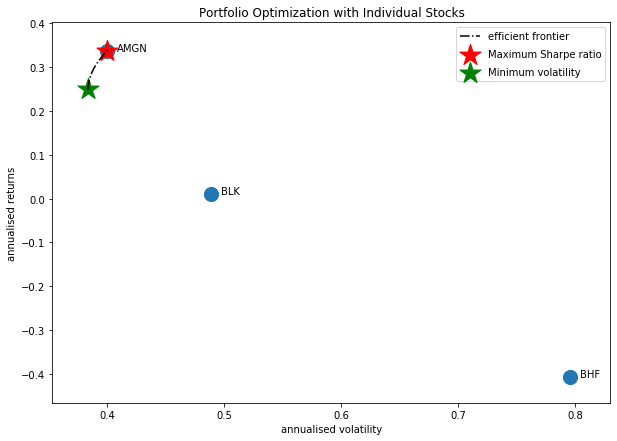

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CMG', 'BA', 'BLK', 'BIIB', 'STZ', 'BHF']


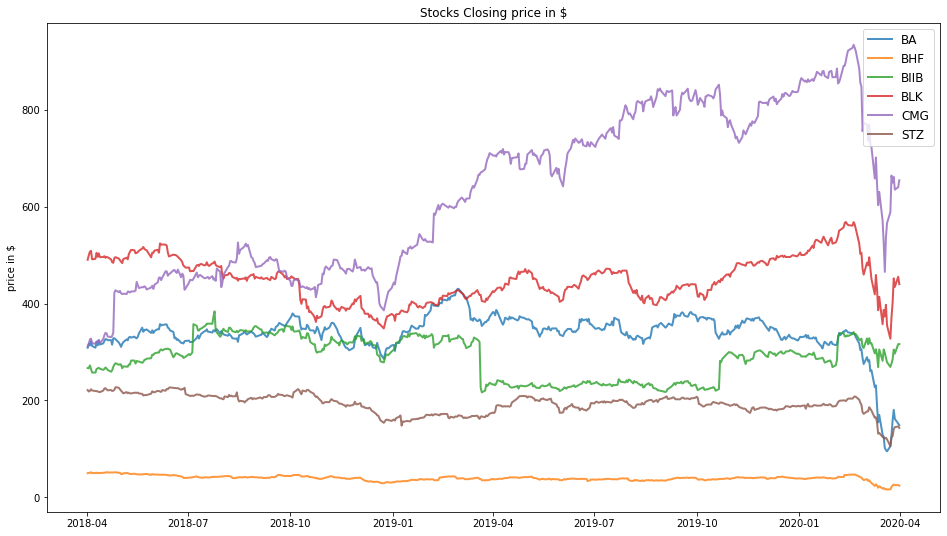

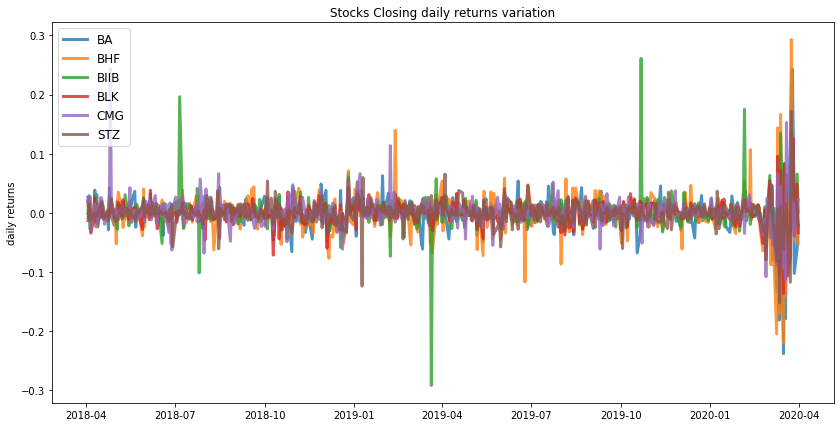

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.81
Annualised Volatility: 0.5


             BA  BHF   BIIB  BLK    CMG  STZ
allocation  0.0  0.0  19.02  0.0  80.98  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.2
Annualised Volatility: 0.38


             BA  BHF   BIIB    BLK    CMG    STZ
allocation  0.0  0.0  19.37  21.47  25.38  33.78


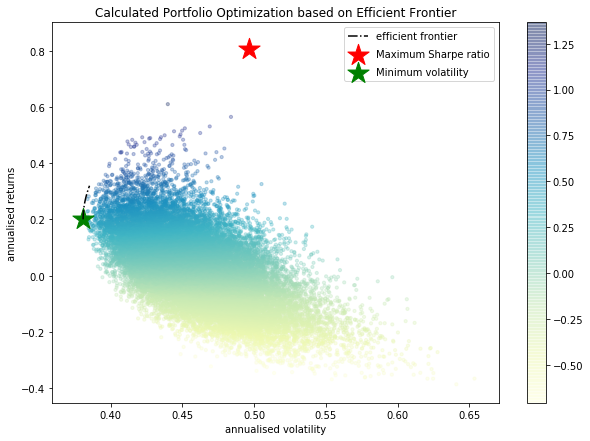

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BA : annuaised return -0.47 , annualised volatility: 0.72
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
BLK : annuaised return 0.01 , annualised volatility: 0.49
CMG : annuaised return 0.91 , annualised volatility: 0.58
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


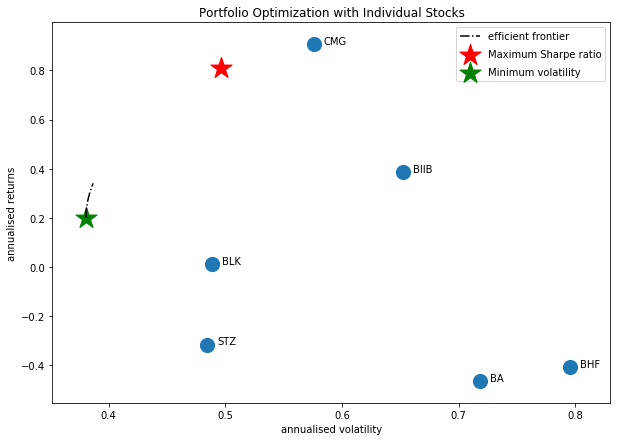

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'AAP', 'AMGN', 'BIIB', 'BHF', 'FCX', 'DISCK']


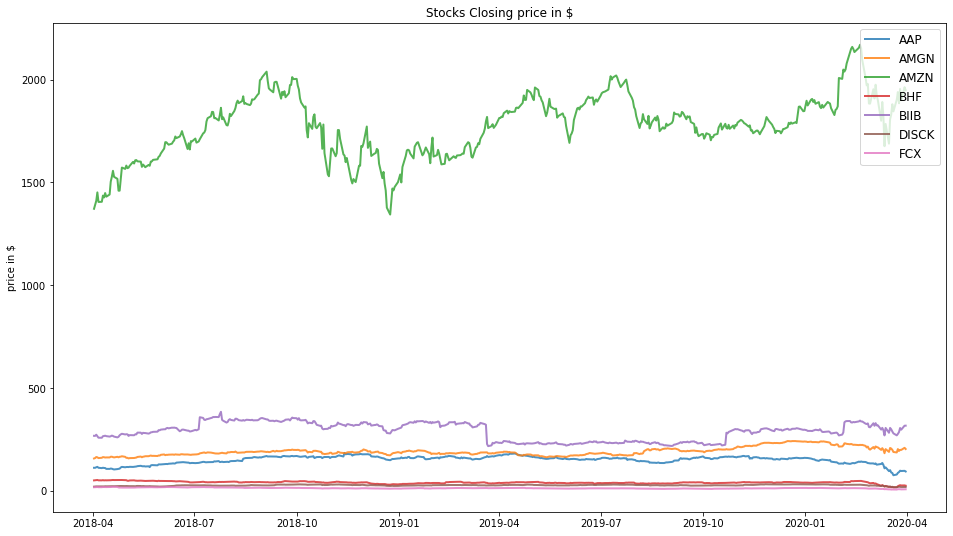

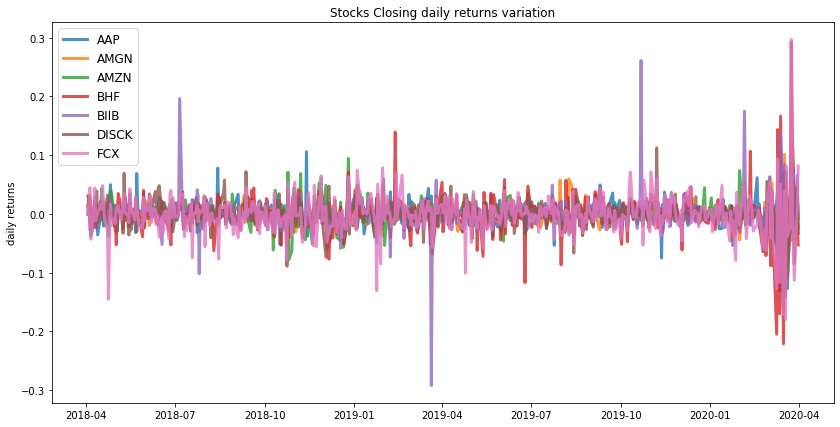

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.41
Annualised Volatility: 0.37


            AAP   AMGN   AMZN  BHF  BIIB  DISCK  FCX
allocation  0.0  35.42  57.06  0.0  7.52    0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.25
Annualised Volatility: 0.34


             AAP   AMGN   AMZN  BHF  BIIB  DISCK  FCX
allocation  16.5  39.07  24.93  0.0  2.88  16.62  0.0


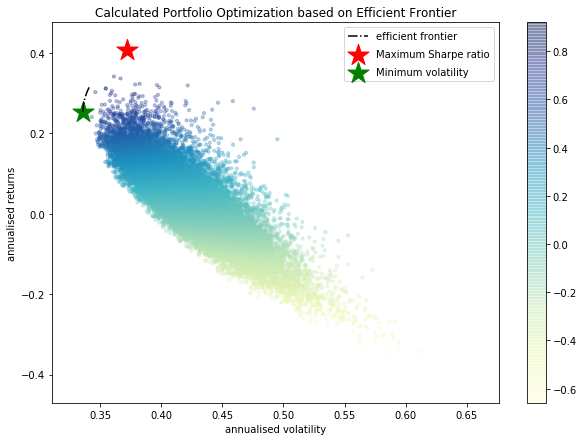

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAP : annuaised return -0.04 , annualised volatility: 0.51
AMGN : annuaised return 0.34 , annualised volatility: 0.4
AMZN : annuaised return 0.46 , annualised volatility: 0.45
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
DISCK : annuaised return 0.02 , annualised volatility: 0.52
FCX : annuaised return -0.6 , annualised volatility: 0.78
--------------------------------------------------------------------------------


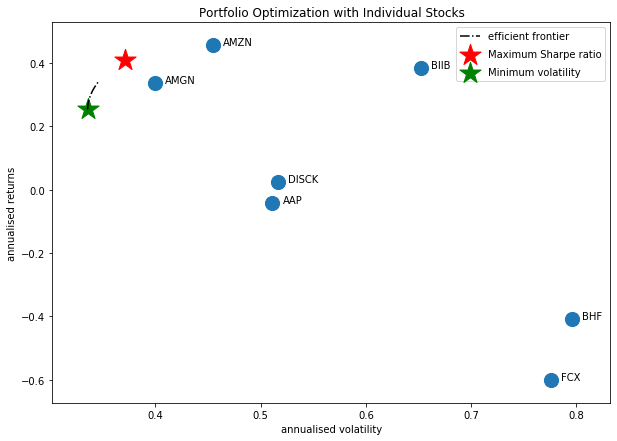

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMGN', 'BHF', 'ANTM']


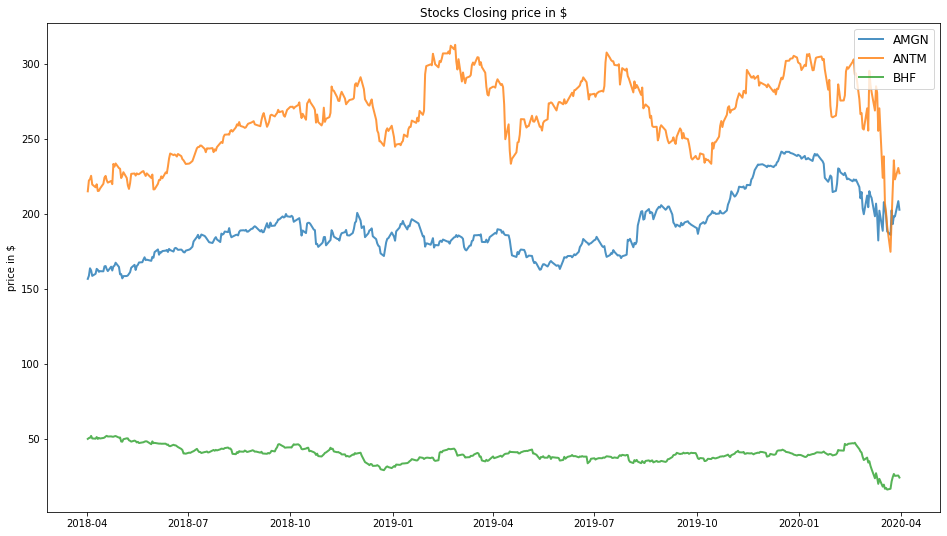

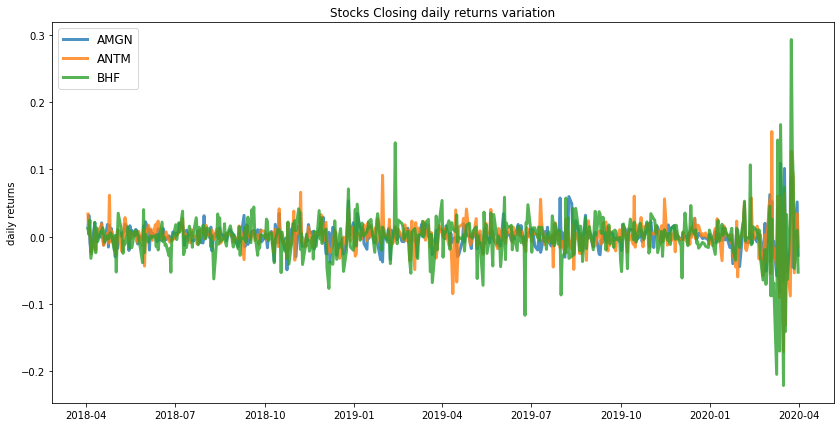

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.34
Annualised Volatility: 0.4


             AMGN  ANTM  BHF
allocation  100.0   0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.31
Annualised Volatility: 0.39


             AMGN   ANTM  BHF
allocation  78.17  21.83  0.0


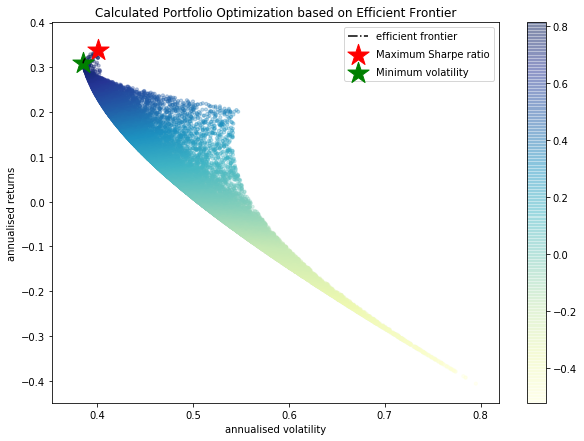

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.34 , annualised volatility: 0.4
ANTM : annuaised return 0.21 , annualised volatility: 0.55
BHF : annuaised return -0.41 , annualised volatility: 0.8
--------------------------------------------------------------------------------


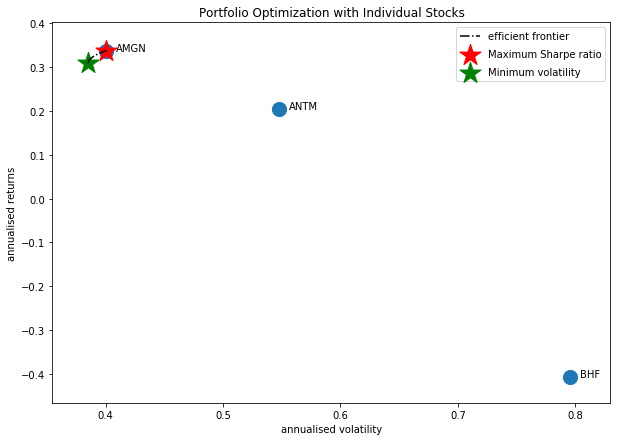

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AMZN', 'AMGN', 'AAPL', 'BIIB', 'STZ', 'BHF', 'DISCK']


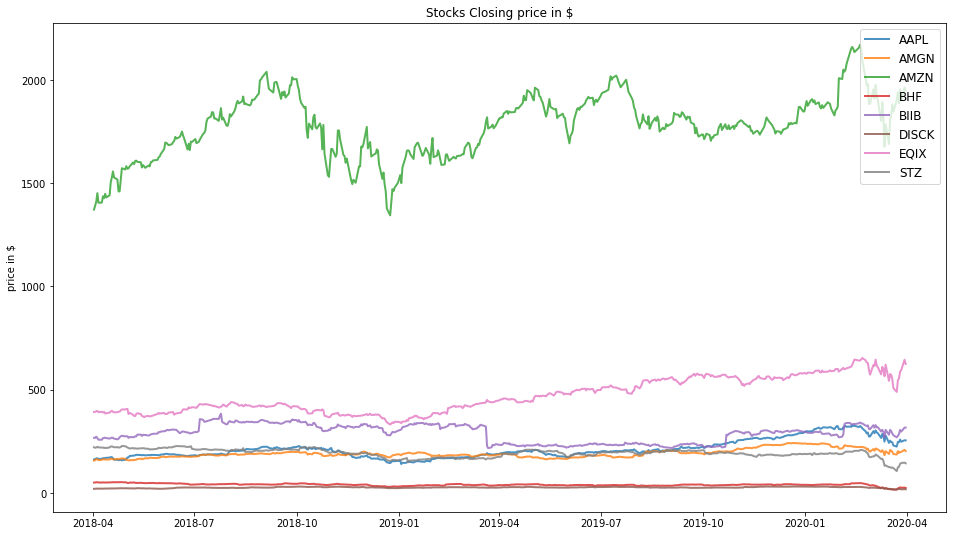

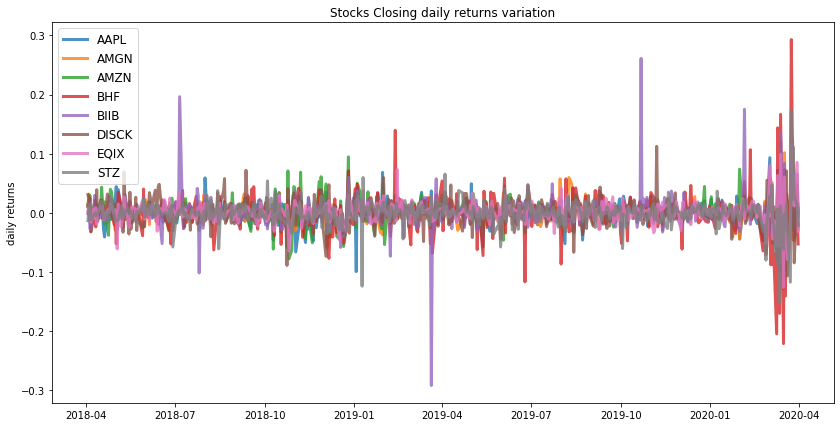

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.54
Annualised Volatility: 0.37


             AAPL  AMGN   AMZN  BHF  BIIB  DISCK   EQIX  STZ
allocation  22.98   0.0  17.79  0.0  2.21    0.0  57.02  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.27
Annualised Volatility: 0.33


            AAPL   AMGN   AMZN  BHF  BIIB  DISCK   EQIX    STZ
allocation   0.0  26.94  19.57  0.0  3.06  14.87  21.52  14.04


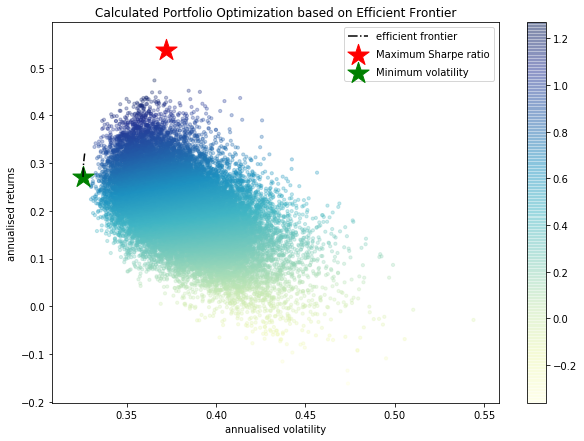

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
AMGN : annuaised return 0.34 , annualised volatility: 0.4
AMZN : annuaised return 0.46 , annualised volatility: 0.45
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
DISCK : annuaised return 0.02 , annualised volatility: 0.52
EQIX : annuaised return 0.56 , annualised volatility: 0.42
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


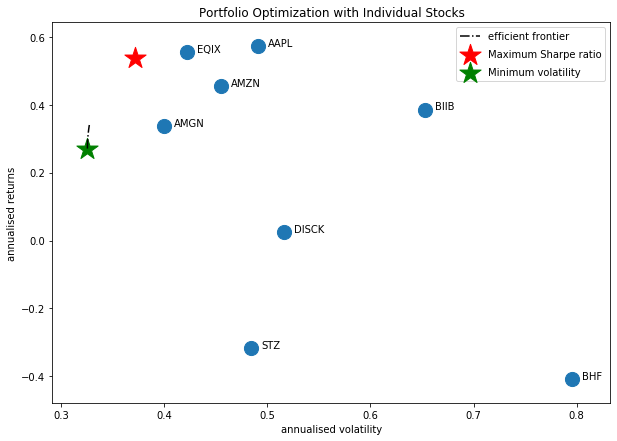

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AMZN', 'AMGN', 'BIIB', 'STZ', 'ECL', 'BHF', 'DISCK']


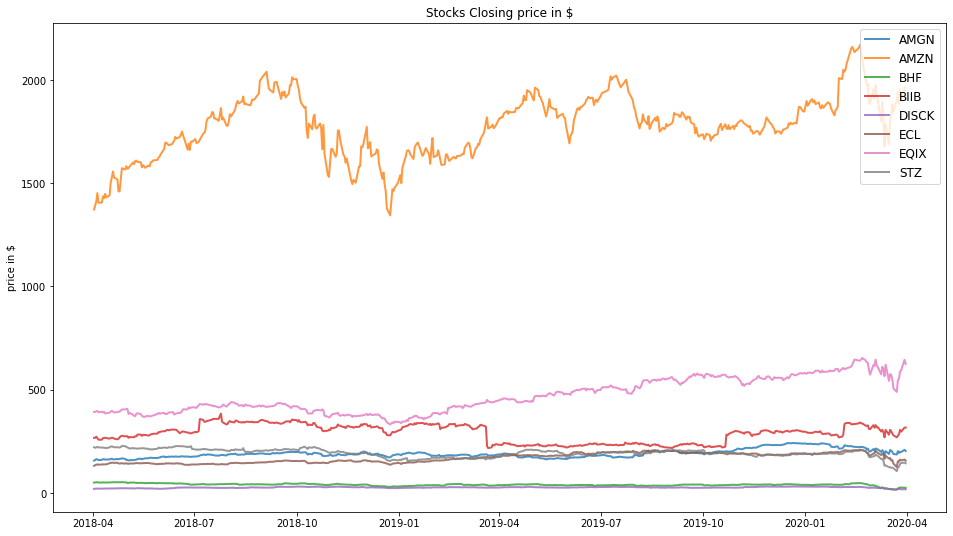

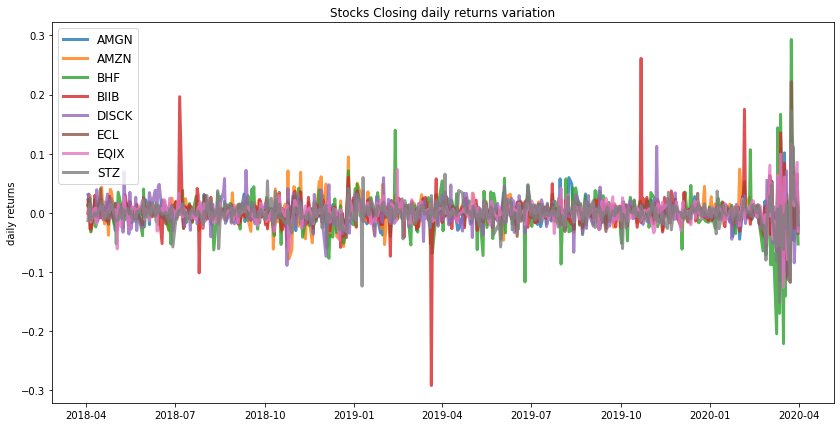

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.52
Annualised Volatility: 0.37


            AMGN   AMZN  BHF  BIIB  DISCK  ECL  EQIX  STZ
allocation   0.0  30.42  0.0  4.08    0.0  0.0  65.5  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.27
Annualised Volatility: 0.33


             AMGN   AMZN  BHF  BIIB  DISCK   ECL  EQIX    STZ
allocation  26.51  19.48  0.0  3.13  14.51  2.15  20.9  13.31


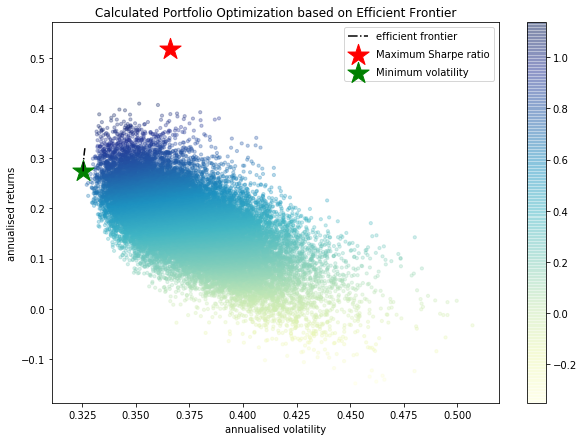

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.34 , annualised volatility: 0.4
AMZN : annuaised return 0.46 , annualised volatility: 0.45
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
DISCK : annuaised return 0.02 , annualised volatility: 0.52
ECL : annuaised return 0.27 , annualised volatility: 0.44
EQIX : annuaised return 0.56 , annualised volatility: 0.42
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


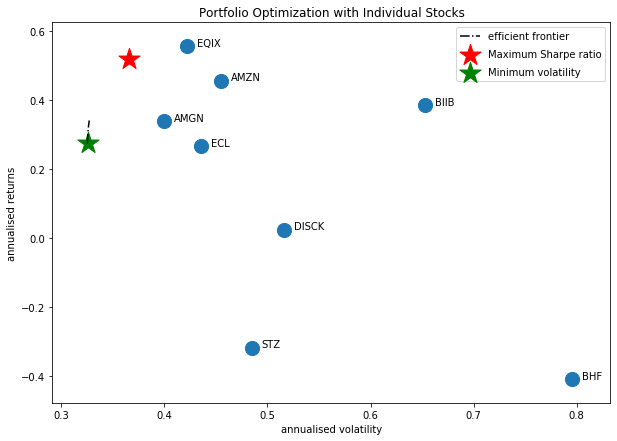

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMGN', 'ADSK']


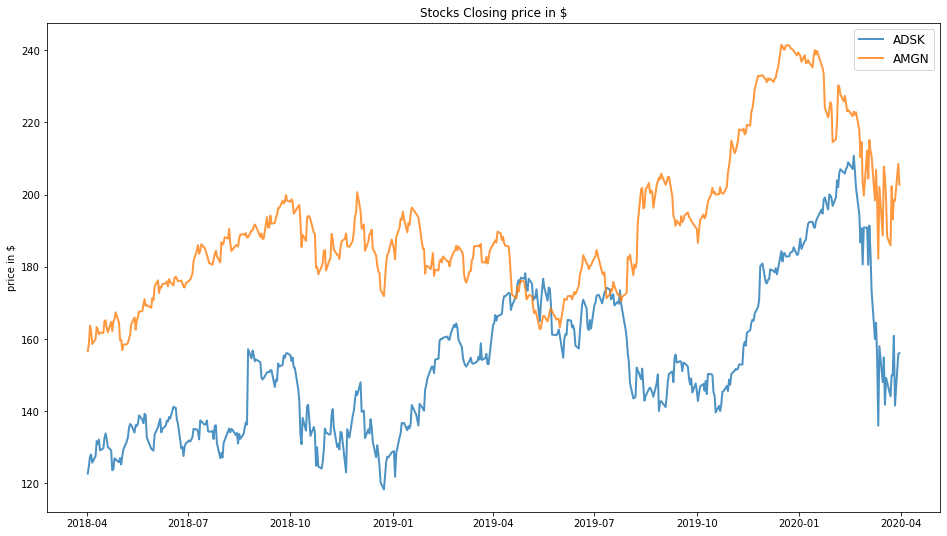

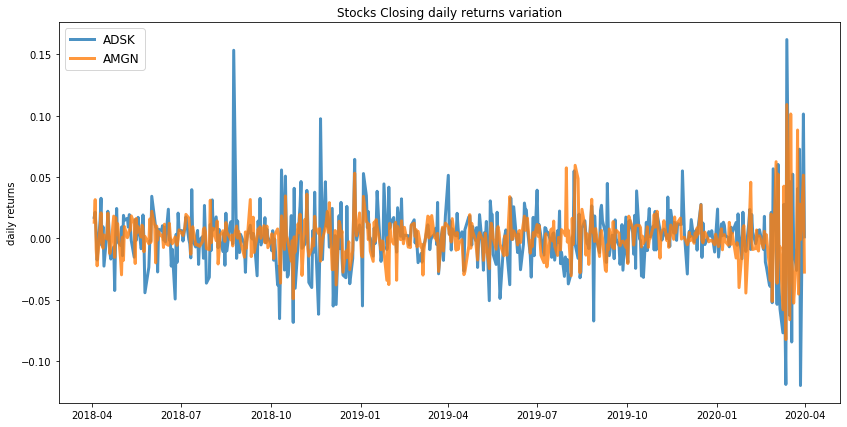

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.36
Annualised Volatility: 0.39


             ADSK   AMGN
allocation  29.35  70.65
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.35
Annualised Volatility: 0.39


             ADSK   AMGN
allocation  18.23  81.77


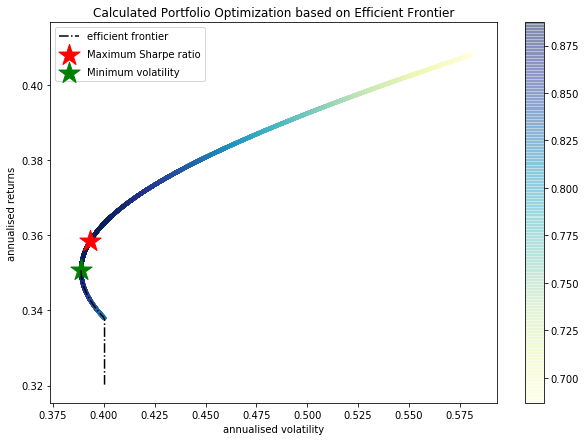

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ADSK : annuaised return 0.41 , annualised volatility: 0.58
AMGN : annuaised return 0.34 , annualised volatility: 0.4
--------------------------------------------------------------------------------


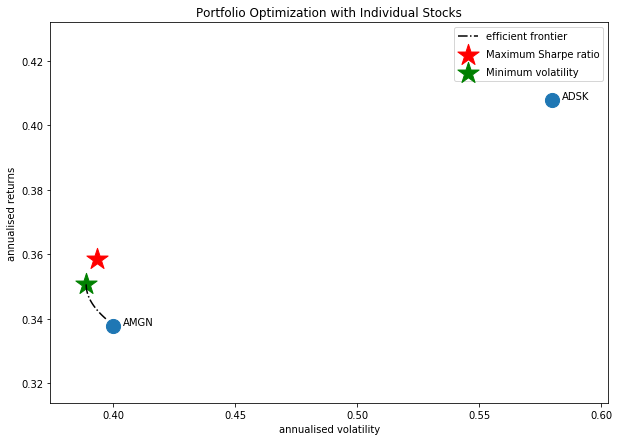

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AMZN', 'AMGN', 'BIIB', 'STZ', 'DVN', 'BHF', 'DISCK']


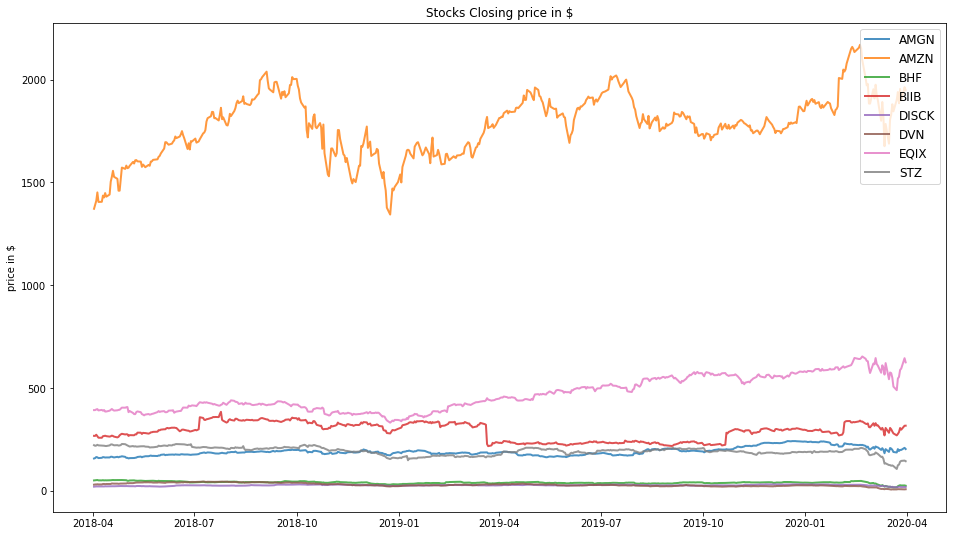

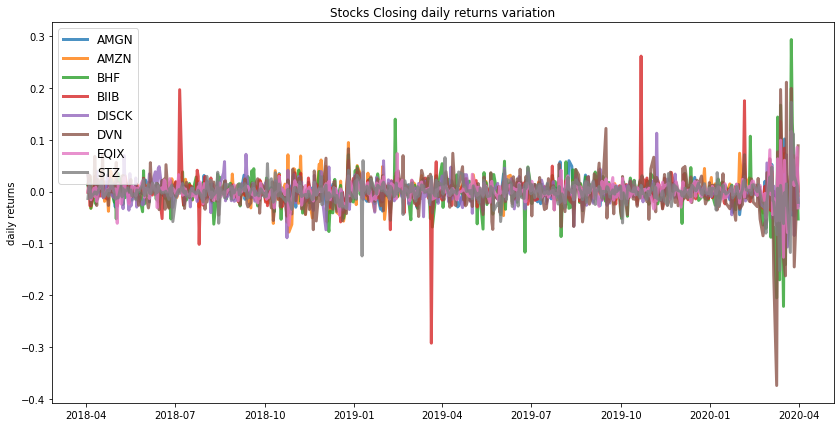

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.52
Annualised Volatility: 0.37


            AMGN   AMZN  BHF  BIIB  DISCK  DVN   EQIX  STZ
allocation   0.0  30.42  0.0  4.07    0.0  0.0  65.52  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.27
Annualised Volatility: 0.33


             AMGN   AMZN  BHF  BIIB  DISCK  DVN   EQIX    STZ
allocation  26.94  19.52  0.0   3.1  14.86  0.0  21.57  14.02


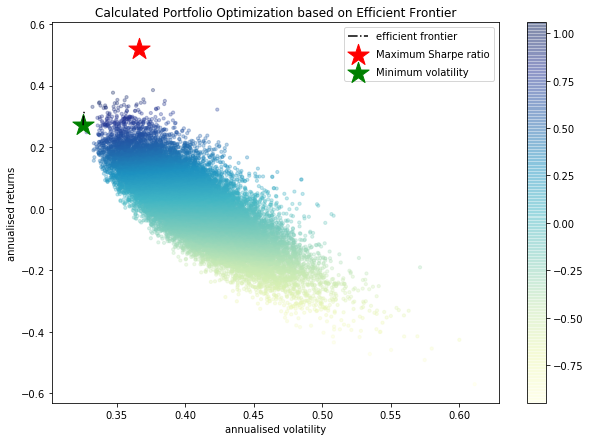

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.34 , annualised volatility: 0.4
AMZN : annuaised return 0.46 , annualised volatility: 0.45
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
DISCK : annuaised return 0.02 , annualised volatility: 0.52
DVN : annuaised return -1.05 , annualised volatility: 0.87
EQIX : annuaised return 0.56 , annualised volatility: 0.42
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


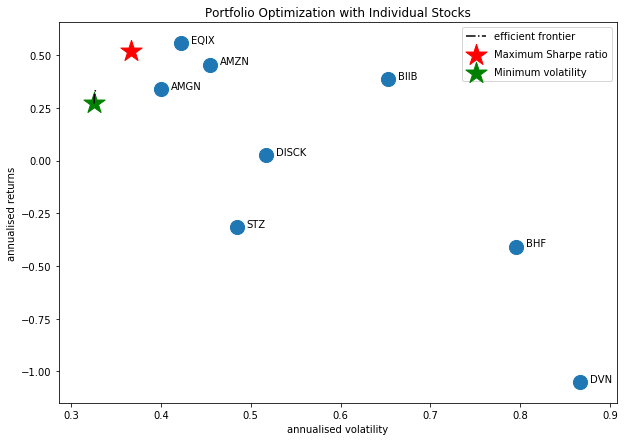

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMGN', 'AYI', 'BHF', 'STZ']


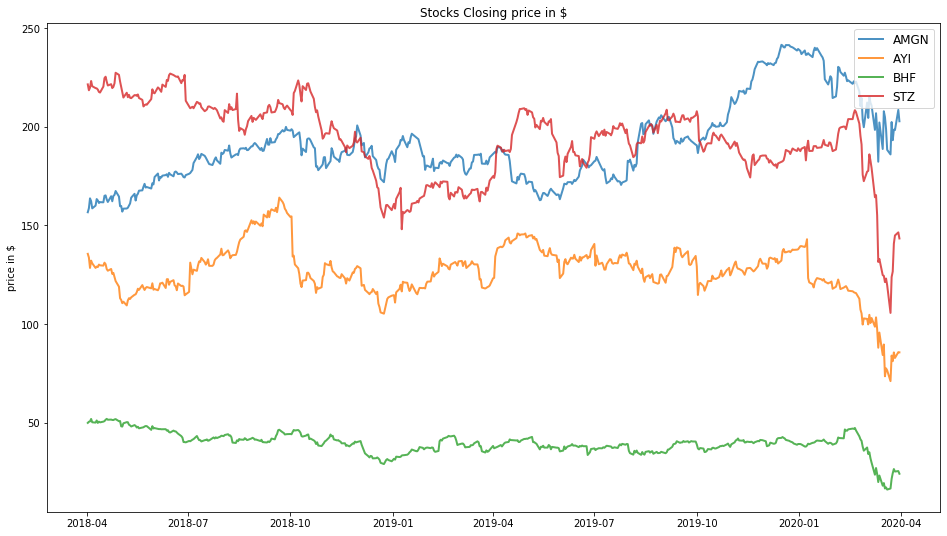

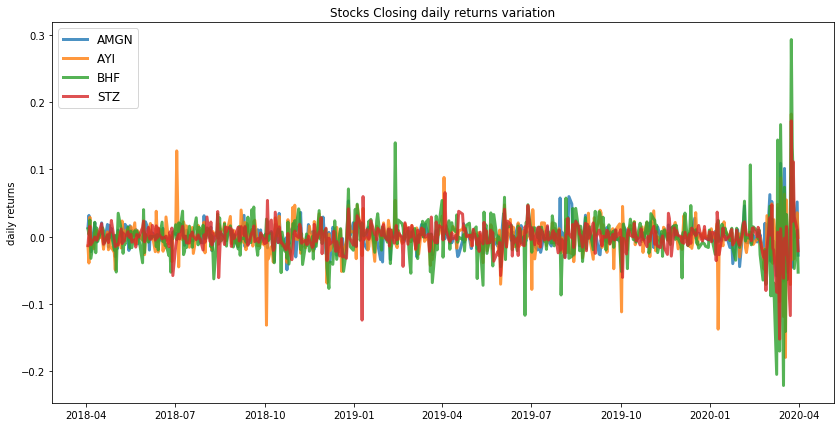

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.34
Annualised Volatility: 0.4


             AMGN  AYI  BHF  STZ
allocation  100.0  0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.09
Annualised Volatility: 0.36


            AMGN   AYI  BHF    STZ
allocation  61.8  6.73  0.0  31.48


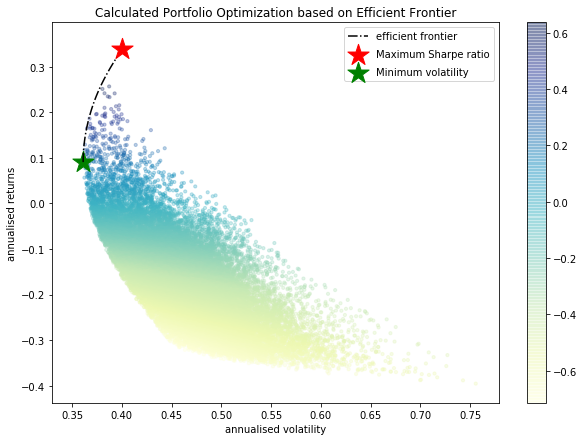

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.34 , annualised volatility: 0.4
AYI : annuaised return -0.28 , annualised volatility: 0.6
BHF : annuaised return -0.41 , annualised volatility: 0.8
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


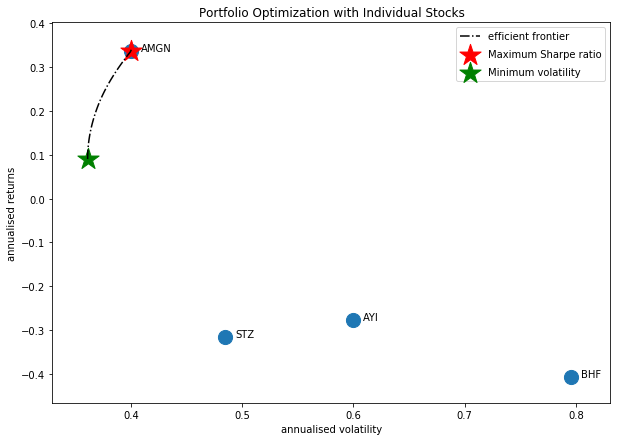

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMGN', 'AAPL', 'BIIB', 'STZ', 'BHF', 'COTY']


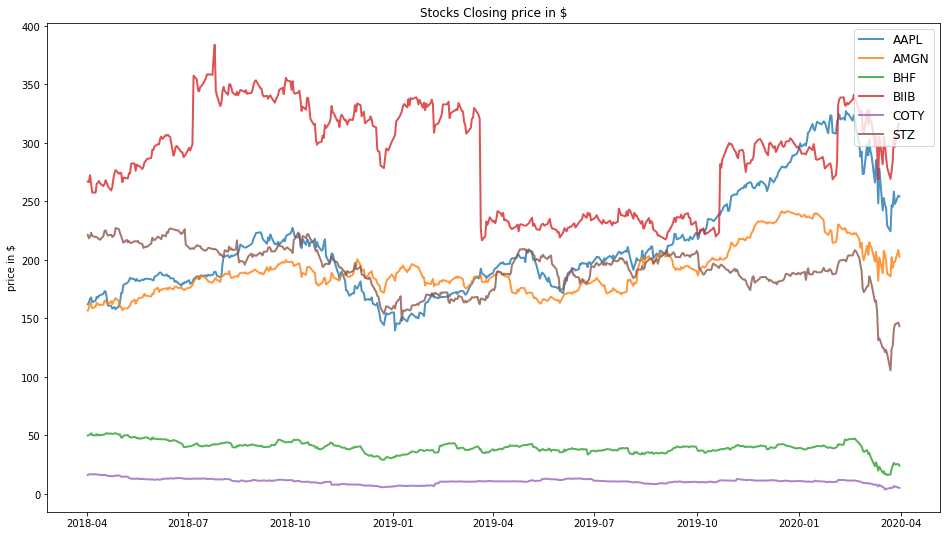

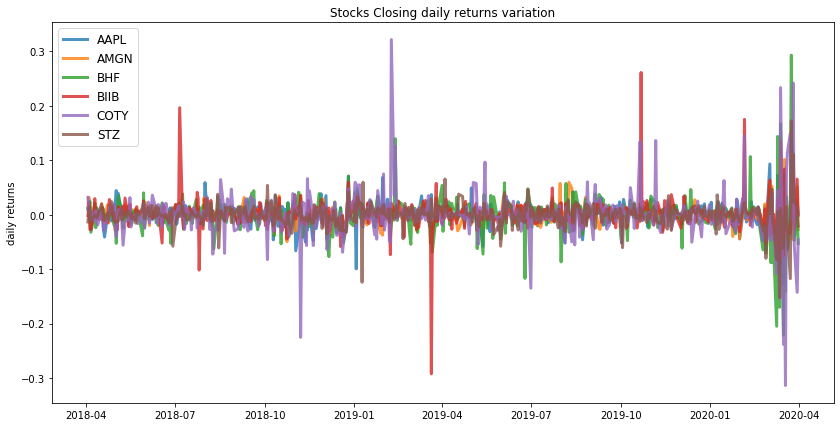

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.52
Annualised Volatility: 0.44


             AAPL  AMGN  BHF  BIIB  COTY  STZ
allocation  77.46  13.8  0.0  8.74   0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.14
Annualised Volatility: 0.36


             AAPL   AMGN  BHF  BIIB  COTY    STZ
allocation  10.64  52.13  0.0  5.07  2.71  29.45


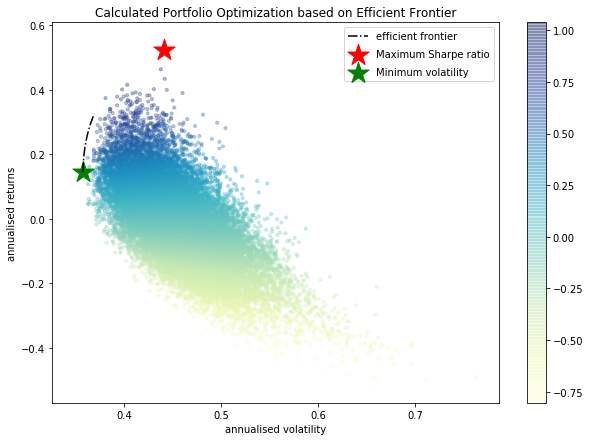

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
AMGN : annuaised return 0.34 , annualised volatility: 0.4
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
COTY : annuaised return -0.7 , annualised volatility: 0.94
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


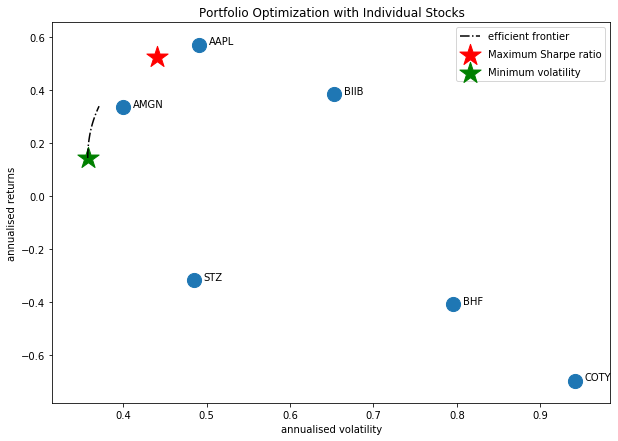

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AMZN', 'AMGN', 'BHF', 'DISCK', 'DHI']


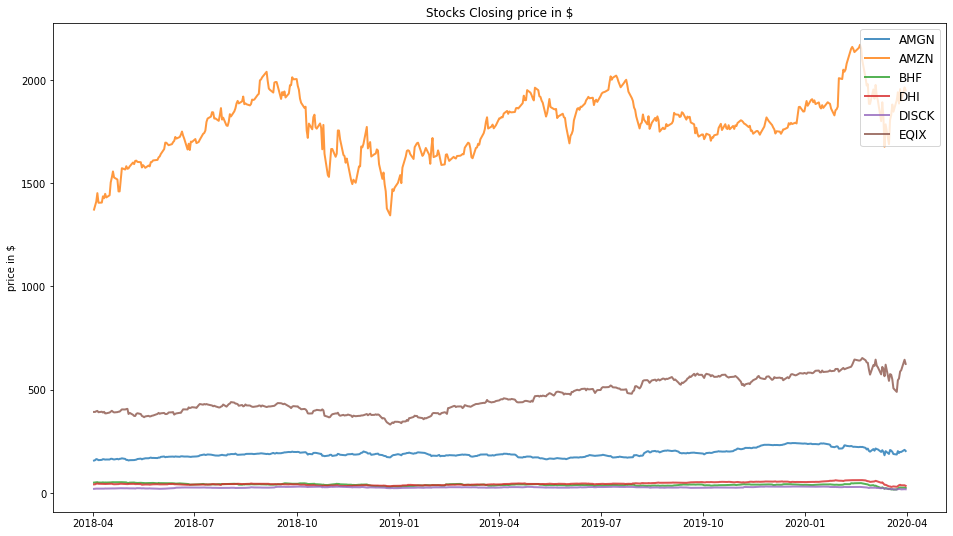

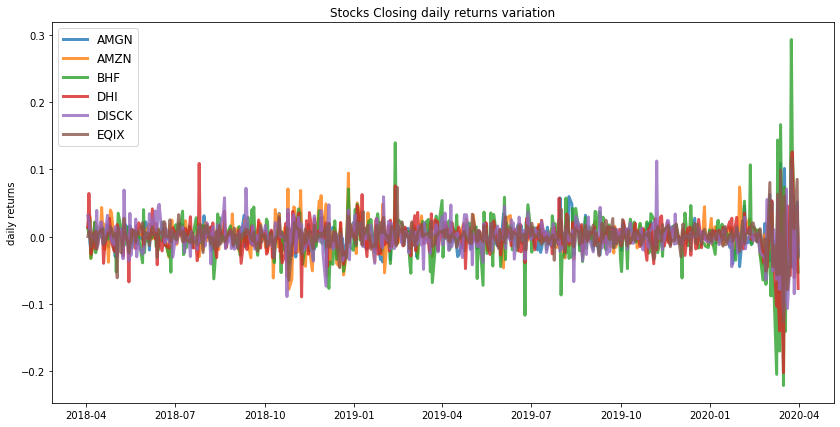

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.52
Annualised Volatility: 0.37


            AMGN   AMZN  BHF  DHI  DISCK   EQIX
allocation   0.0  32.14  0.0  0.0    0.0  67.86
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.33
Annualised Volatility: 0.33


             AMGN   AMZN  BHF   DHI  DISCK   EQIX
allocation  30.76  21.41  0.0  9.32  15.13  23.38


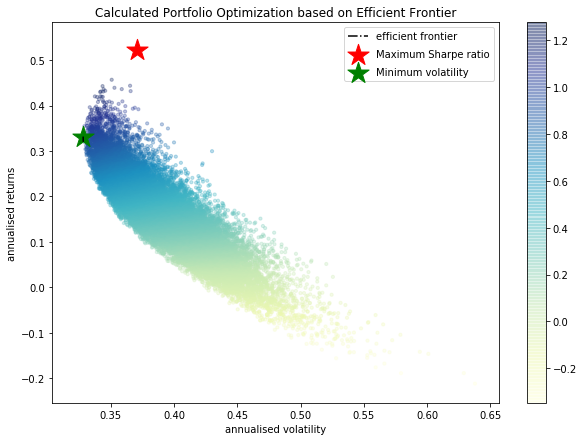

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.34 , annualised volatility: 0.4
AMZN : annuaised return 0.46 , annualised volatility: 0.45
BHF : annuaised return -0.41 , annualised volatility: 0.8
DHI : annuaised return -0.03 , annualised volatility: 0.55
DISCK : annuaised return 0.02 , annualised volatility: 0.52
EQIX : annuaised return 0.56 , annualised volatility: 0.42
--------------------------------------------------------------------------------


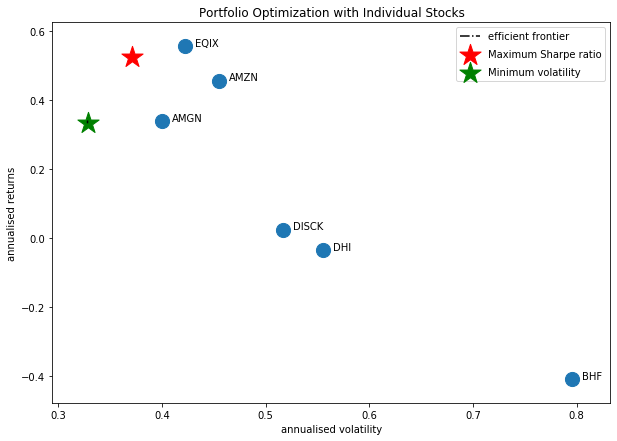

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BA', 'AMGN', 'AAPL', 'BIIB', 'STZ', 'DVN', 'BHF']


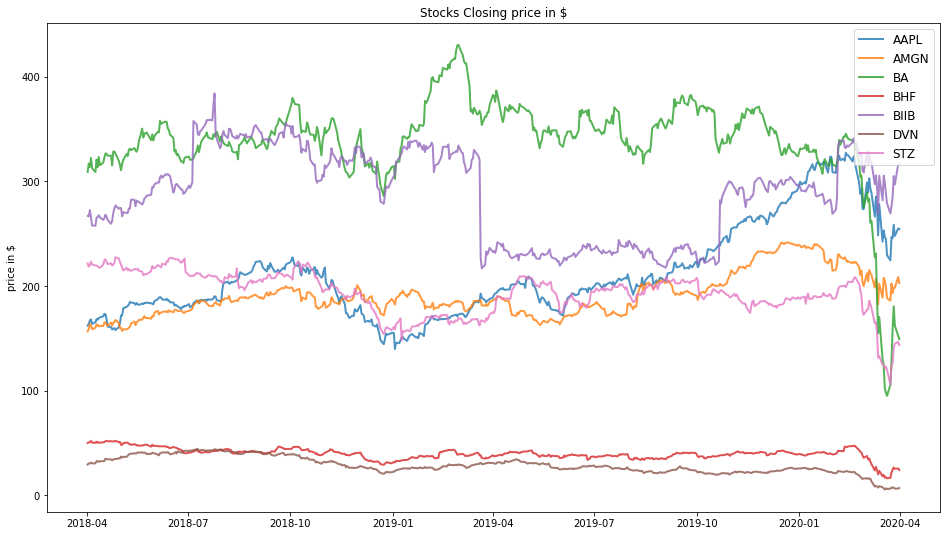

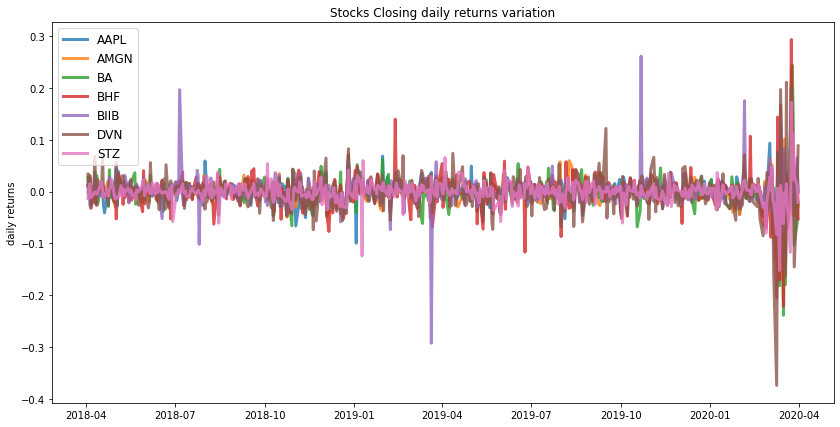

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.52
Annualised Volatility: 0.44


             AAPL   AMGN   BA  BHF  BIIB  DVN  STZ
allocation  77.47  13.77  0.0  0.0  8.76  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.17
Annualised Volatility: 0.36


             AAPL   AMGN   BA  BHF  BIIB  DVN    STZ
allocation  11.78  52.32  0.0  0.0  5.73  0.0  30.17


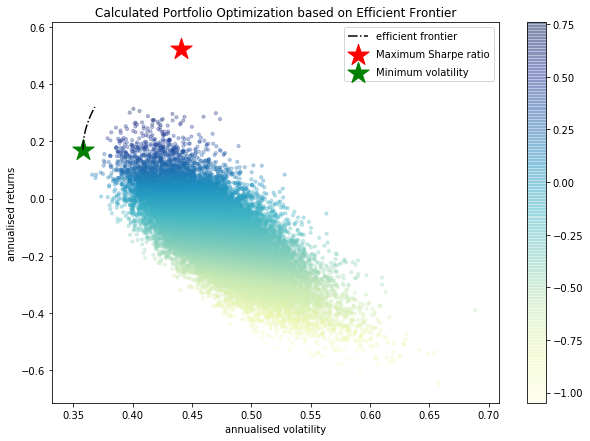

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
AMGN : annuaised return 0.34 , annualised volatility: 0.4
BA : annuaised return -0.47 , annualised volatility: 0.72
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
DVN : annuaised return -1.05 , annualised volatility: 0.87
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


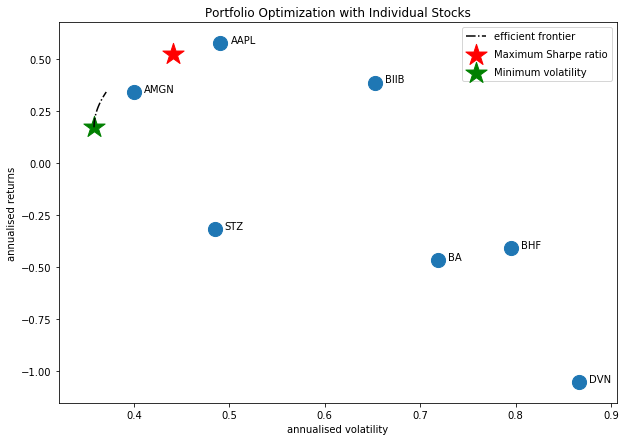

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMGN', 'BIIB', 'STZ', 'ECL', 'BHF']


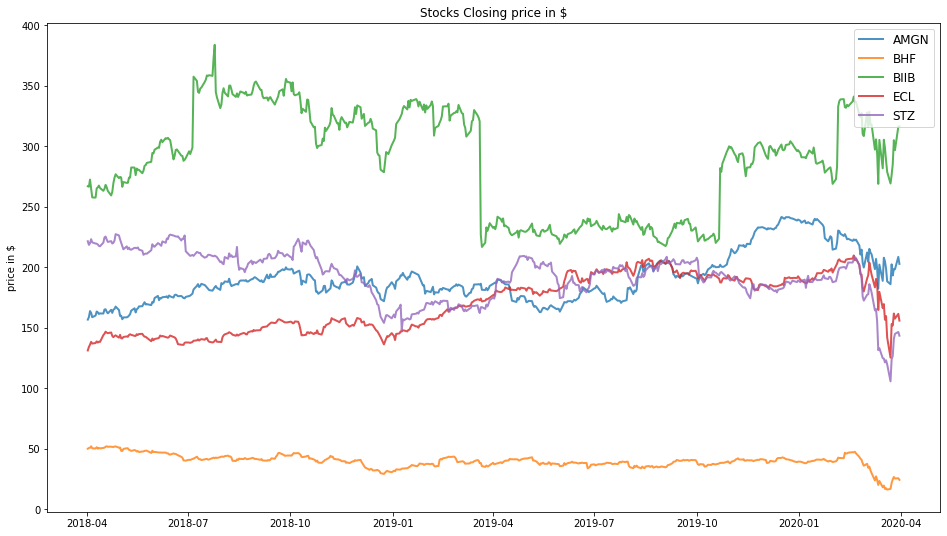

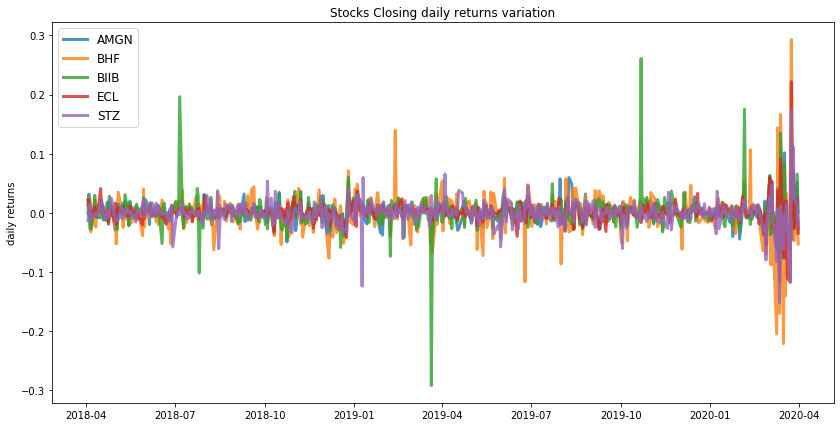

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.33
Annualised Volatility: 0.38


             AMGN  BHF   BIIB    ECL  STZ
allocation  67.65  0.0  15.13  17.22  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.17
Annualised Volatility: 0.35


            AMGN  BHF  BIIB    ECL    STZ
allocation  48.7  0.0  6.36  21.21  23.73


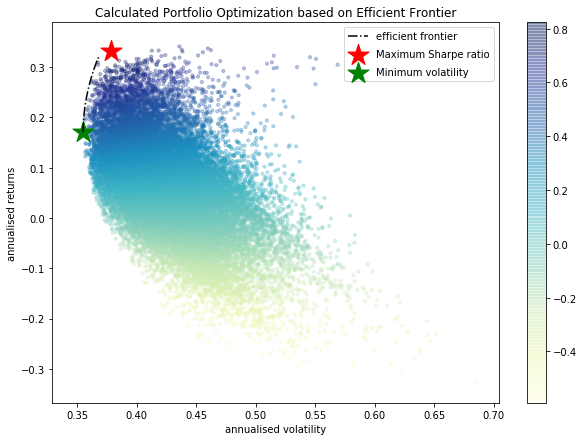

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.34 , annualised volatility: 0.4
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
ECL : annuaised return 0.27 , annualised volatility: 0.44
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


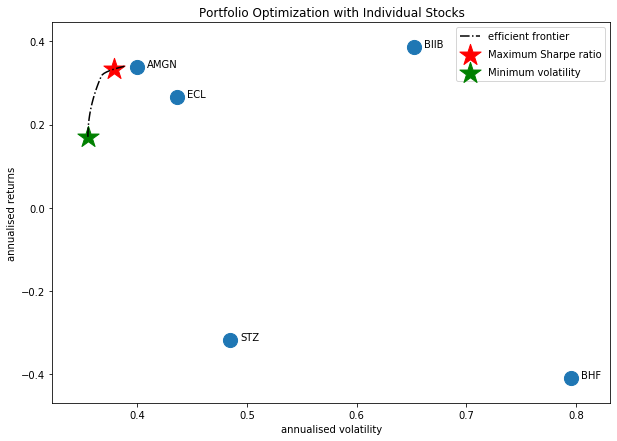

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BA', 'AMGN', 'BIIB', 'STZ', 'DVN', 'AYI', 'BHF']


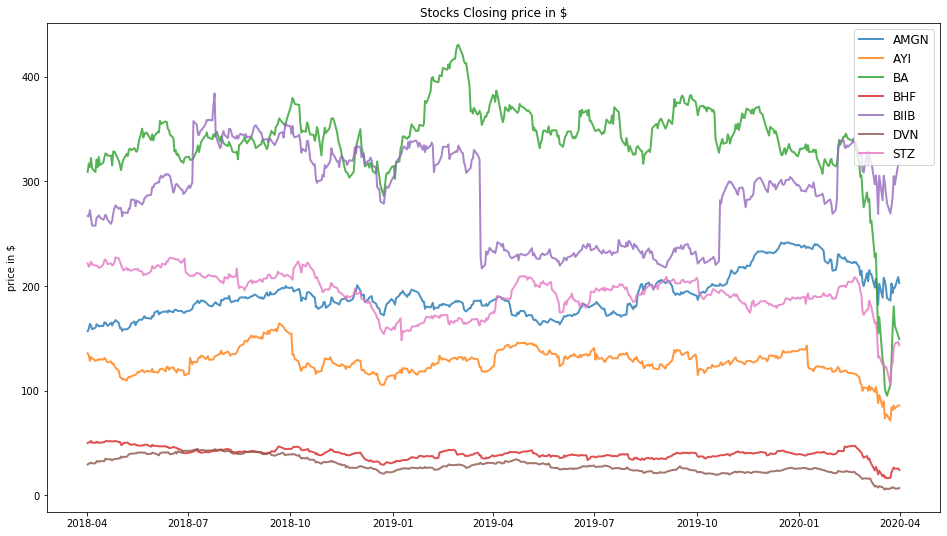

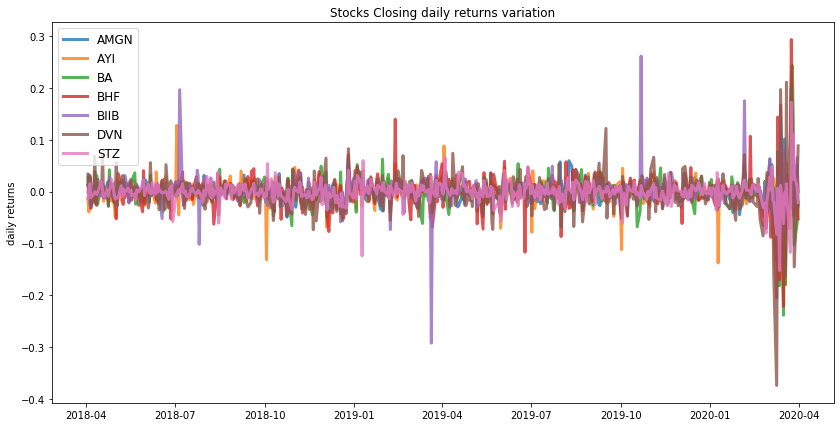

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.35
Annualised Volatility: 0.4


             AMGN  AYI   BA  BHF   BIIB  DVN  STZ
allocation  83.76  0.0  0.0  0.0  16.24  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.1
Annualised Volatility: 0.36


             AMGN   AYI    BA  BHF  BIIB  DVN   STZ
allocation  56.68  6.08  0.62  0.0  5.92  0.0  30.7


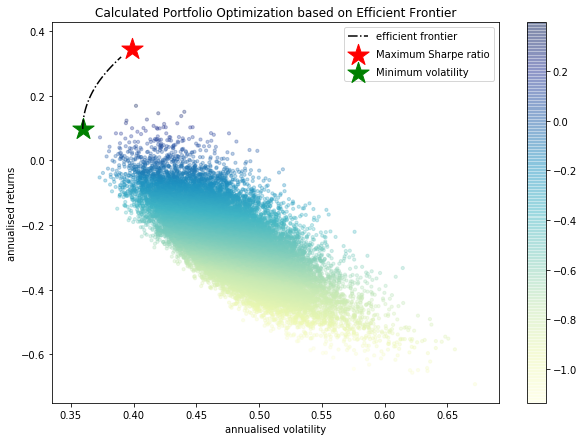

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.34 , annualised volatility: 0.4
AYI : annuaised return -0.28 , annualised volatility: 0.6
BA : annuaised return -0.47 , annualised volatility: 0.72
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
DVN : annuaised return -1.05 , annualised volatility: 0.87
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


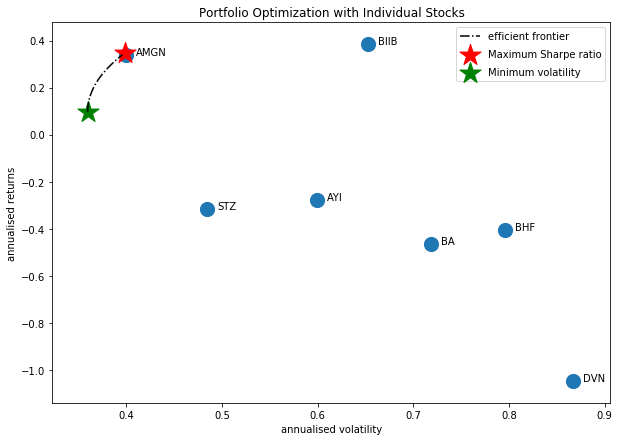

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'CMG', 'AMGN', 'AAPL', 'BIIB', 'STZ', 'BHF', 'DISCK']


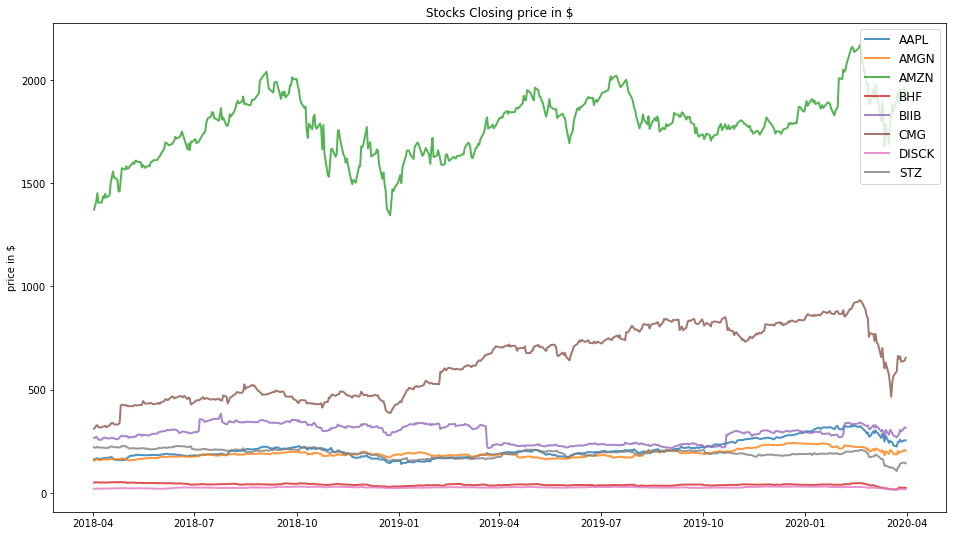

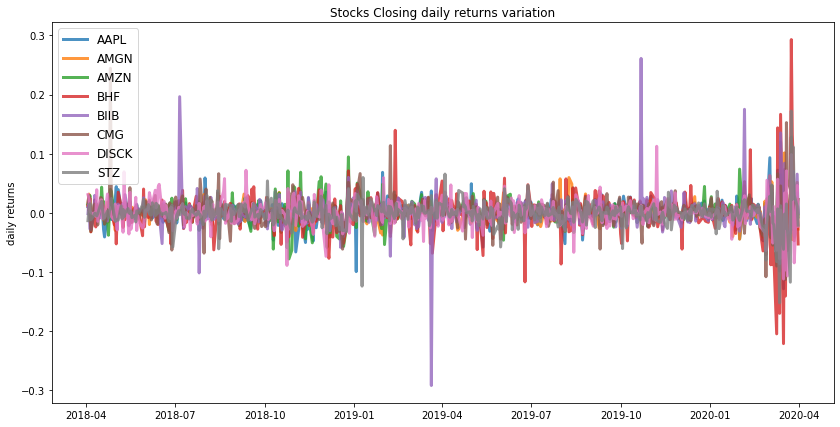

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.73
Annualised Volatility: 0.42


             AAPL  AMGN  AMZN  BHF  BIIB    CMG  DISCK  STZ
allocation  25.41  7.98  3.58  0.0   6.4  56.62    0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.29
Annualised Volatility: 0.33


            AAPL   AMGN   AMZN  BHF  BIIB    CMG  DISCK    STZ
allocation   0.0  36.34  17.83  0.0  3.49  12.89   13.3  16.15


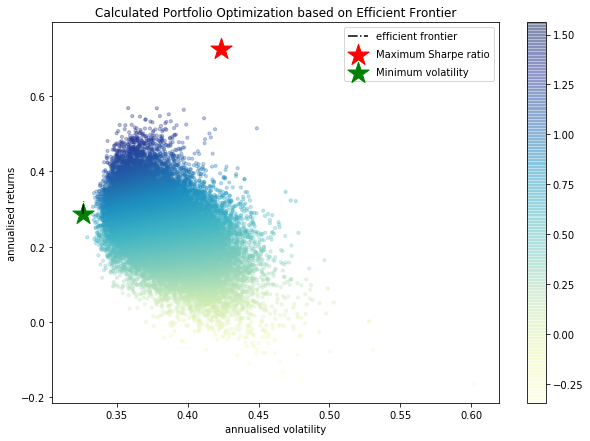

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
AMGN : annuaised return 0.34 , annualised volatility: 0.4
AMZN : annuaised return 0.46 , annualised volatility: 0.45
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CMG : annuaised return 0.91 , annualised volatility: 0.58
DISCK : annuaised return 0.02 , annualised volatility: 0.52
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


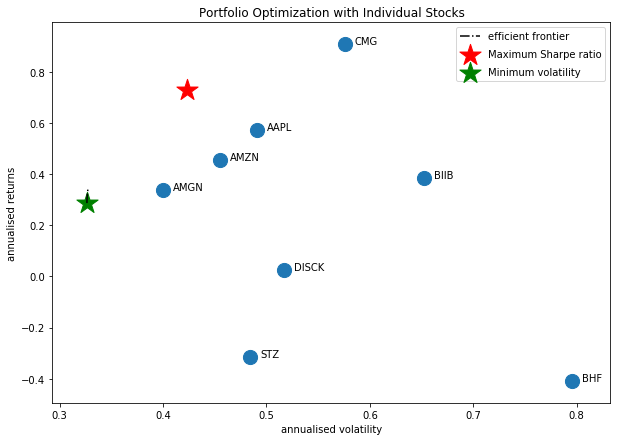

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'CMG', 'AMGN', 'AAPL', 'BIIB', 'BHF', 'DISCK']


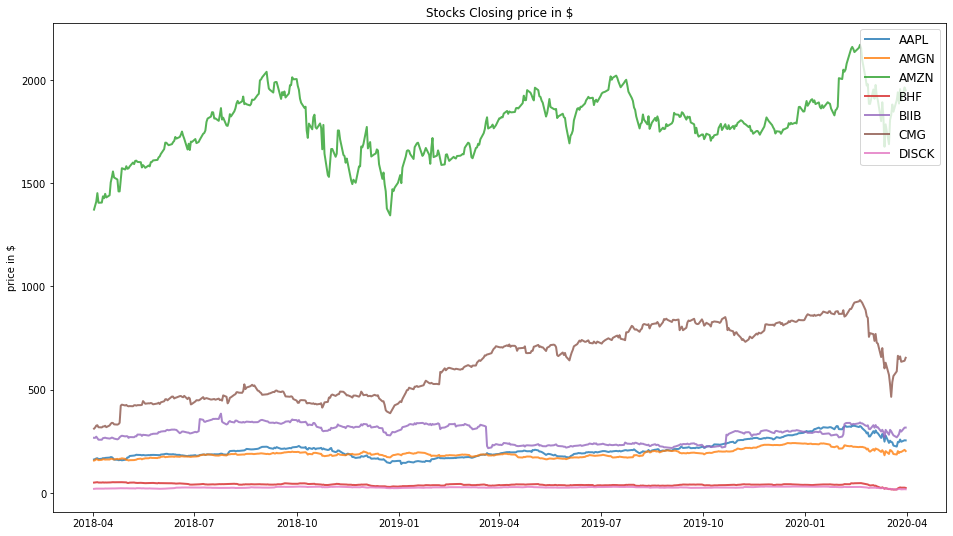

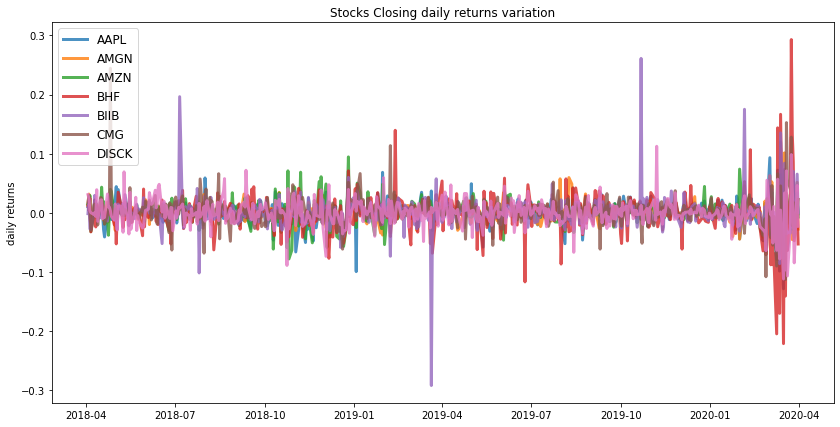

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.73
Annualised Volatility: 0.42


             AAPL  AMGN  AMZN  BHF  BIIB    CMG  DISCK
allocation  25.41  7.99  3.58  0.0   6.4  56.62    0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.4
Annualised Volatility: 0.33


            AAPL   AMGN   AMZN  BHF  BIIB    CMG  DISCK
allocation   0.0  42.53  21.36  0.0  3.99  15.83  16.29


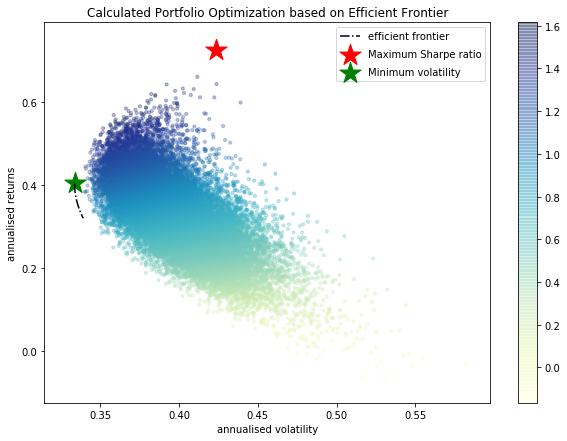

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
AMGN : annuaised return 0.34 , annualised volatility: 0.4
AMZN : annuaised return 0.46 , annualised volatility: 0.45
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CMG : annuaised return 0.91 , annualised volatility: 0.58
DISCK : annuaised return 0.02 , annualised volatility: 0.52
--------------------------------------------------------------------------------


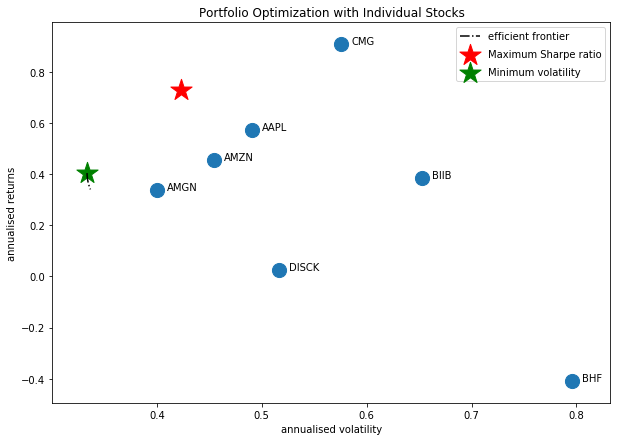

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMGN', 'BIIB', 'ANTM', 'STZ', 'BHF']


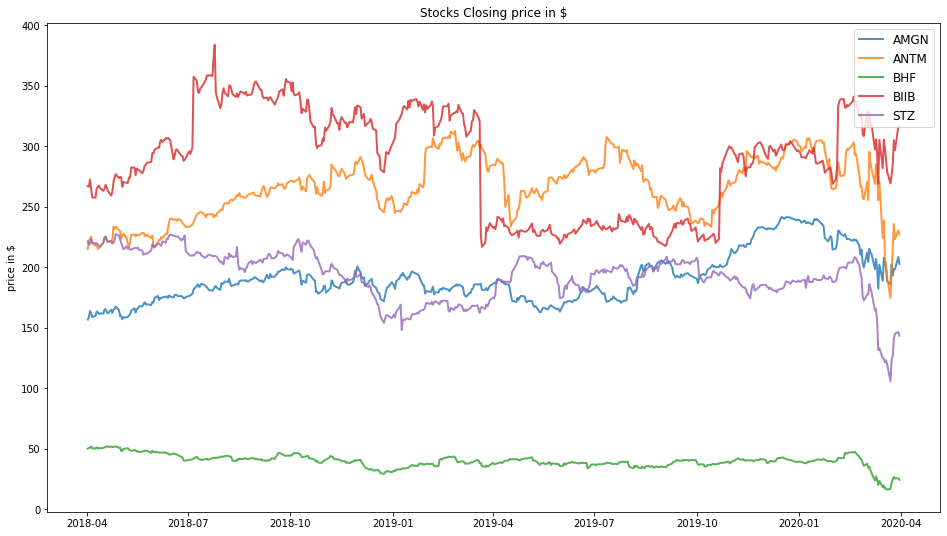

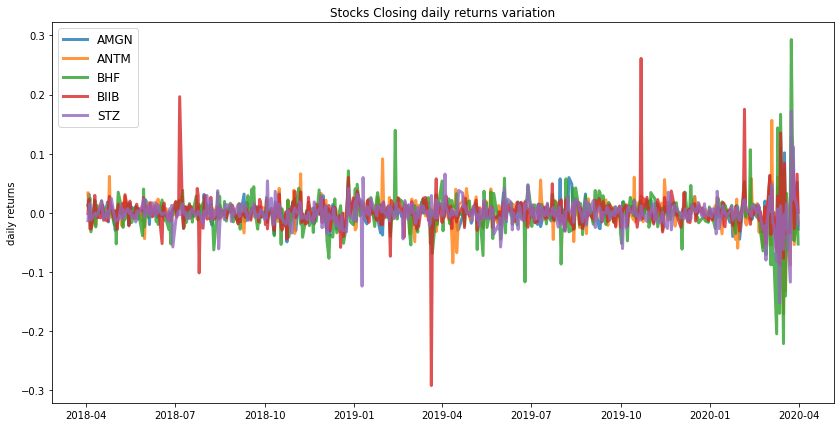

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.35
Annualised Volatility: 0.4


             AMGN  ANTM  BHF   BIIB  STZ
allocation  83.76   0.0  0.0  16.24  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.13
Annualised Volatility: 0.36


             AMGN  ANTM  BHF  BIIB    STZ
allocation  55.79   8.7  0.0  5.22  30.28


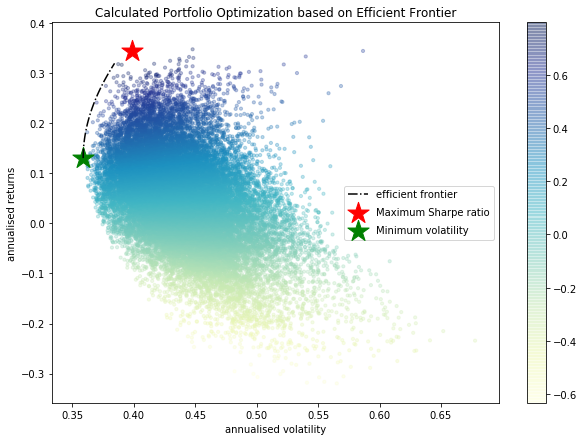

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.34 , annualised volatility: 0.4
ANTM : annuaised return 0.21 , annualised volatility: 0.55
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


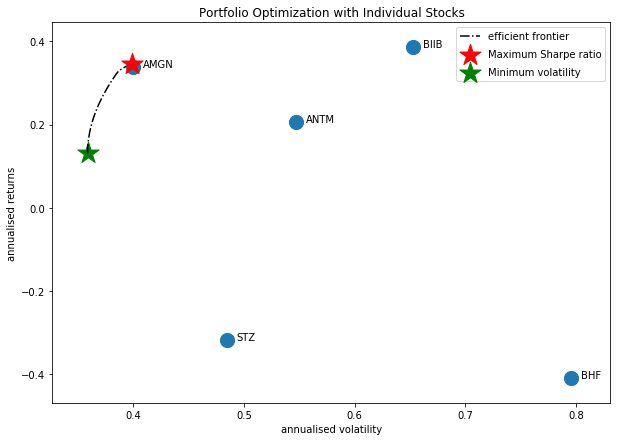

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BA', 'AMGN', 'AAPL', 'BIIB', 'STZ', 'AYI', 'BHF']


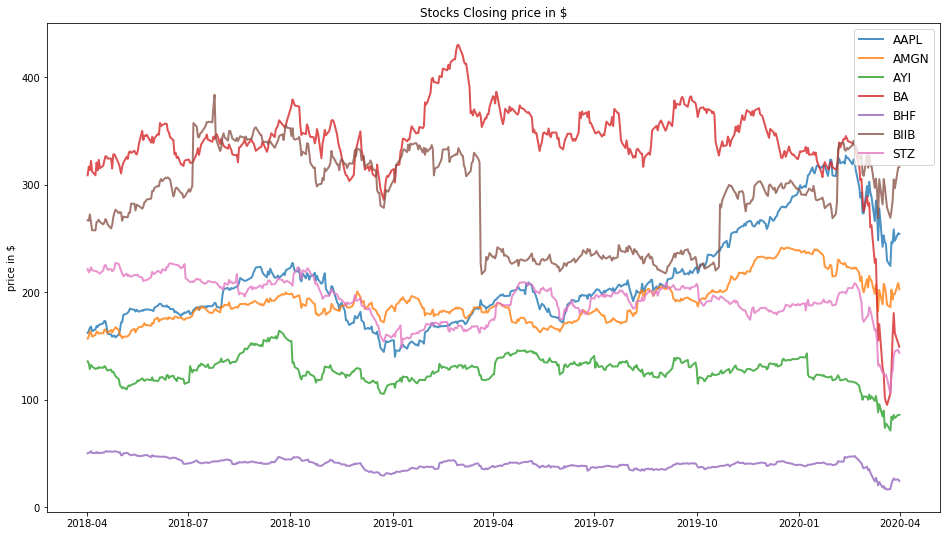

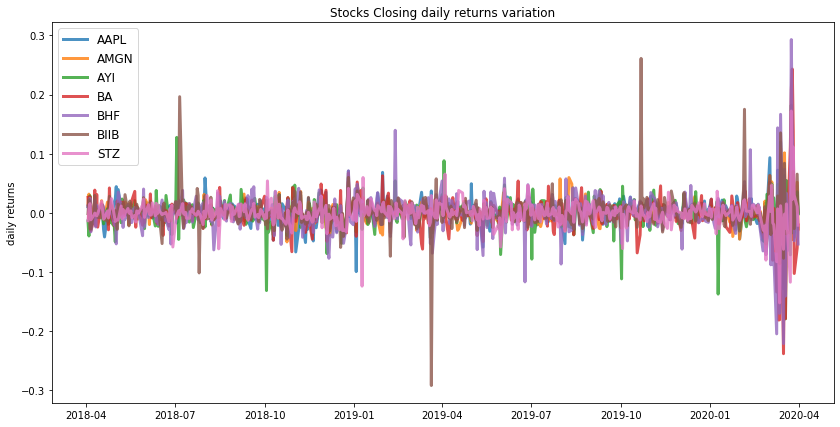

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.52
Annualised Volatility: 0.44


             AAPL   AMGN  AYI   BA  BHF  BIIB  STZ
allocation  77.47  13.79  0.0  0.0  0.0  8.74  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.15
Annualised Volatility: 0.36


             AAPL   AMGN   AYI   BA  BHF  BIIB    STZ
allocation  10.43  50.83  4.65  0.0  0.0  5.55  28.54


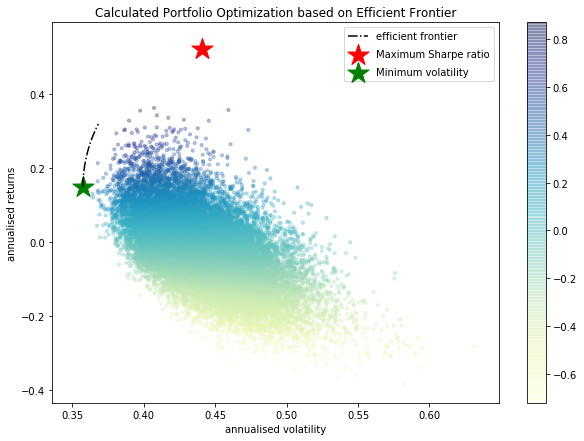

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
AMGN : annuaised return 0.34 , annualised volatility: 0.4
AYI : annuaised return -0.28 , annualised volatility: 0.6
BA : annuaised return -0.47 , annualised volatility: 0.72
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


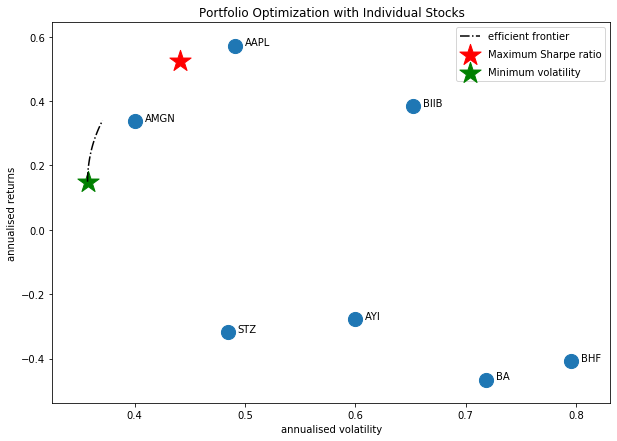

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AMZN', 'BA', 'AMGN', 'AAPL', 'BIIB', 'STZ', 'BHF', 'DISCK']


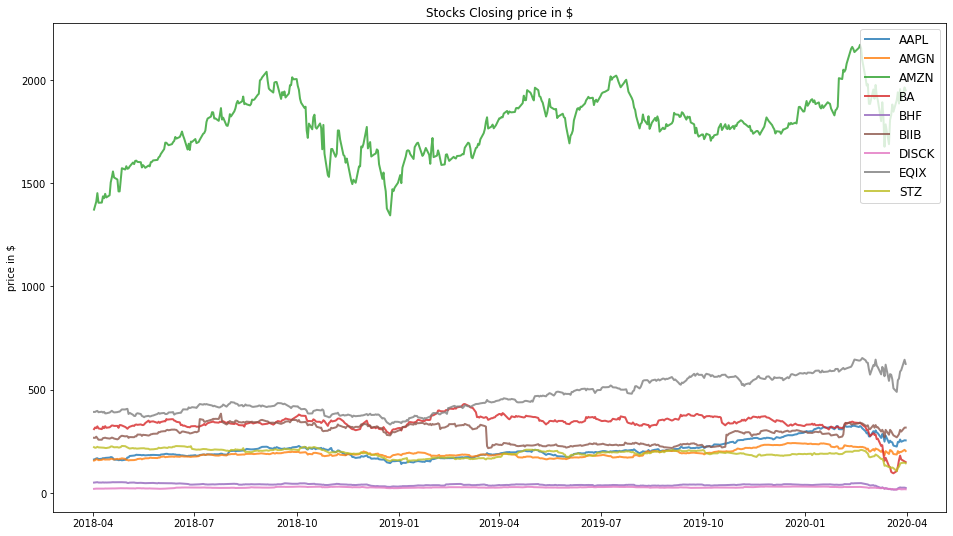

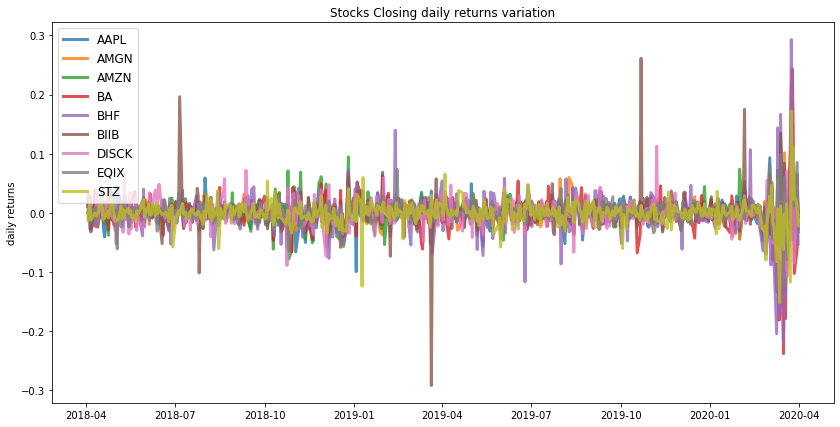

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.54
Annualised Volatility: 0.37


             AAPL  AMGN   AMZN   BA  BHF  BIIB  DISCK   EQIX  STZ
allocation  22.98   0.0  17.79  0.0  0.0   2.2    0.0  57.03  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.27
Annualised Volatility: 0.33


            AAPL   AMGN   AMZN   BA  BHF  BIIB  DISCK   EQIX    STZ
allocation   0.0  26.94  19.57  0.0  0.0  3.07  14.86  21.52  14.03


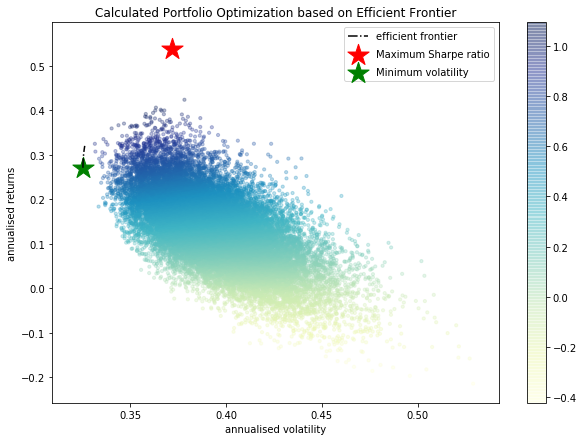

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
AMGN : annuaised return 0.34 , annualised volatility: 0.4
AMZN : annuaised return 0.46 , annualised volatility: 0.45
BA : annuaised return -0.47 , annualised volatility: 0.72
BHF : annuaised return -0.41 , annualised volatility: 0.8
BIIB : annuaised return 0.39 , annualised volatility: 0.65
DISCK : annuaised return 0.02 , annualised volatility: 0.52
EQIX : annuaised return 0.56 , annualised volatility: 0.42
STZ : annuaised return -0.32 , annualised volatility: 0.48
--------------------------------------------------------------------------------


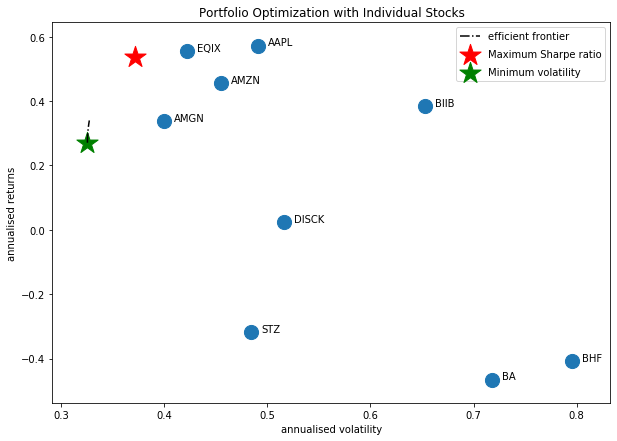

In [31]:
returns_sharpe_company_list = []
start_date = "2018-04-01"
end_date = "2020-04-01"
risk_free_rate = 0.0095
#generate the stocks pairs which are uncorrelated and having covariance less than mean covariance 
stocks_pair = get_portfolio_pairs(portfolio_list)
#print(stocks_pair)
for stock_list in stocks_pair:
    print("perform efficient_frontier_stock_portfolio Pairs of the companies we got {}".format(stock_list))
    pos_sharpe, Annualised_Return, Annualised_Volatility, allocation_weights = efficient_frontier_stock_portfolio(stock_list, len(stock_list), risk_free_rate, start_date, end_date)
    returns_sharpe_company_list.append([pos_sharpe, Annualised_Return, Annualised_Volatility, stock_list, allocation_weights])

In [32]:
shortlisted_portfolio_df = pd.DataFrame(returns_sharpe_company_list)

In [33]:
shortlisted_portfolio_df.columns = ["Sharpe Ratio", "Portfolio Annualised Return", "Portfolio Annualised_Volatility", "Stock Portfolio", "Stocks Weight Allocation"]

In [34]:
shortlisted_portfolio_df

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation
0,1.419693,0.54,0.37,"[EQIX, AMZN, AMGN, AAPL, STZ, BHF]","[[23.7, 0.0, 18.35, 0.0, 57.96, 0.0]]"
1,1.358557,0.52,0.37,"[EQIX, AZO, GOOG]","[[28.28, 71.72, 0.0]]"
2,1.802658,0.73,0.40,"[EQIX, DISCK, CMG, BHF]","[[0.0, 50.35, 0.0, 49.65]]"
3,1.308302,0.53,0.40,"[EQIX, AAP, BA, AMGN, BIIB, STZ, DVN, BHF, DISCK]","[[0.0, 3.24, 0.0, 0.0, 9.03, 0.0, 0.0, 87.73, ..."
4,1.389392,0.52,0.37,"[EQIX, AMZN, AAP, AMGN, BIIB, STZ, BHF, DISCK]","[[0.0, 0.0, 30.37, 0.0, 4.04, 0.0, 65.59, 0.0]]"
5,1.401494,0.56,0.39,"[EQIX, BA, AMGN, AAPL, BIIB, STZ, DVN, BHF]","[[34.73, 0.0, 0.0, 0.0, 3.45, 0.0, 61.82, 0.0]]"
6,1.308302,0.53,0.40,"[EQIX, AMGN, BIIB, STZ, ECL, DVN, BHF]","[[3.15, 0.0, 9.04, 0.0, 0.0, 87.81, 0.0]]"
7,1.308302,0.53,0.40,"[EQIX, BA, AMGN, BIIB, STZ, DVN, BHF, DISCK]","[[3.22, 0.0, 0.0, 9.0, 0.0, 0.0, 87.78, 0.0]]"
8,1.818140,0.71,0.39,"[EQIX, AMZN, CMG, AMGN, AAPL, BIIB, STZ, BHF, ...","[[9.19, 0.0, 1.31, 0.0, 3.6, 45.73, 0.0, 40.18..."
9,1.802658,0.73,0.40,"[EQIX, CMG, BA, BHF, DISCK, DHI]","[[0.0, 0.0, 50.39, 0.0, 0.0, 49.61]]"


In [35]:
# creating a blank series 
Portfolio_Tag = pd.Series([]) 

for row in range(len(shortlisted_portfolio_df)):
    if (shortlisted_portfolio_df["Sharpe Ratio"][row] >= 3):
        Portfolio_Tag[row] = "Excellent"
    elif (shortlisted_portfolio_df["Sharpe Ratio"][row] >= 2 and (shortlisted_portfolio_df["Sharpe Ratio"][row] < 3)):
        Portfolio_Tag[row] = "Very Good"
    elif ((shortlisted_portfolio_df["Sharpe Ratio"][row] >= 1)  and (shortlisted_portfolio_df["Sharpe Ratio"][row] < 2)):
        Portfolio_Tag[row] = "Good"
    else:
        Portfolio_Tag[row] = "Bad"
        
# inserting new column with values of list made above         
shortlisted_portfolio_df.insert(5, "Portfolio Tag", Portfolio_Tag) 

In [36]:
shortlisted_portfolio_df

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag
0,1.419693,0.54,0.37,"[EQIX, AMZN, AMGN, AAPL, STZ, BHF]","[[23.7, 0.0, 18.35, 0.0, 57.96, 0.0]]",Good
1,1.358557,0.52,0.37,"[EQIX, AZO, GOOG]","[[28.28, 71.72, 0.0]]",Good
2,1.802658,0.73,0.40,"[EQIX, DISCK, CMG, BHF]","[[0.0, 50.35, 0.0, 49.65]]",Good
3,1.308302,0.53,0.40,"[EQIX, AAP, BA, AMGN, BIIB, STZ, DVN, BHF, DISCK]","[[0.0, 3.24, 0.0, 0.0, 9.03, 0.0, 0.0, 87.73, ...",Good
4,1.389392,0.52,0.37,"[EQIX, AMZN, AAP, AMGN, BIIB, STZ, BHF, DISCK]","[[0.0, 0.0, 30.37, 0.0, 4.04, 0.0, 65.59, 0.0]]",Good
5,1.401494,0.56,0.39,"[EQIX, BA, AMGN, AAPL, BIIB, STZ, DVN, BHF]","[[34.73, 0.0, 0.0, 0.0, 3.45, 0.0, 61.82, 0.0]]",Good
6,1.308302,0.53,0.40,"[EQIX, AMGN, BIIB, STZ, ECL, DVN, BHF]","[[3.15, 0.0, 9.04, 0.0, 0.0, 87.81, 0.0]]",Good
7,1.308302,0.53,0.40,"[EQIX, BA, AMGN, BIIB, STZ, DVN, BHF, DISCK]","[[3.22, 0.0, 0.0, 9.0, 0.0, 0.0, 87.78, 0.0]]",Good
8,1.818140,0.71,0.39,"[EQIX, AMZN, CMG, AMGN, AAPL, BIIB, STZ, BHF, ...","[[9.19, 0.0, 1.31, 0.0, 3.6, 45.73, 0.0, 40.18...",Good
9,1.802658,0.73,0.40,"[EQIX, CMG, BA, BHF, DISCK, DHI]","[[0.0, 0.0, 50.39, 0.0, 0.0, 49.61]]",Good


In [37]:
shortlisted_portfolio = shortlisted_portfolio_df[(shortlisted_portfolio_df["Portfolio Tag"] == "Excellent") | (shortlisted_portfolio_df["Portfolio Tag"] == "Very Good") |
                                                    (shortlisted_portfolio_df["Portfolio Tag"] == "Good")]

In [38]:
shortlisted_portfolio = shortlisted_portfolio.sort_values(by="Sharpe Ratio", ascending=False)

In [39]:
shortlisted_portfolio

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag
8,1.818140,0.71,0.39,"[EQIX, AMZN, CMG, AMGN, AAPL, BIIB, STZ, BHF, ...","[[9.19, 0.0, 1.31, 0.0, 3.6, 45.73, 0.0, 40.18...",Good
2,1.802658,0.73,0.40,"[EQIX, DISCK, CMG, BHF]","[[0.0, 50.35, 0.0, 49.65]]",Good
13,1.802658,0.73,0.40,"[EQIX, CMG, BHF, BXP]","[[0.0, 0.0, 50.36, 49.64]]",Good
9,1.802658,0.73,0.40,"[EQIX, CMG, BA, BHF, DISCK, DHI]","[[0.0, 0.0, 50.39, 0.0, 0.0, 49.61]]",Good
10,1.802658,0.73,0.40,"[EQIX, CMG, BA, BHF, DISCK, ALXN]","[[0.0, 0.0, 0.0, 50.39, 0.0, 49.61]]",Good
52,1.695362,0.73,0.42,"[AMZN, CMG, AMGN, AAPL, BIIB, STZ, BHF, DISCK]","[[25.41, 7.98, 3.58, 0.0, 6.4, 56.62, 0.0, 0.0]]",Good
53,1.695362,0.73,0.42,"[AMZN, CMG, AMGN, AAPL, BIIB, BHF, DISCK]","[[25.41, 7.99, 3.58, 0.0, 6.4, 56.62, 0.0]]",Good
24,1.679748,0.78,0.46,"[AAPL, CMG]","[[37.57, 62.43]]",Good
27,1.636148,0.73,0.44,"[CMG, NEM]","[[70.34, 29.66]]",Good
11,1.634855,0.53,0.32,"[EQIX, CTXS]","[[62.25, 37.75]]",Good


In [49]:
pd.set_option('display.max_colwidth', -1)

## Top 5 portfolios generated for the shortlisted companies for overall 2 yr period

In [50]:
shortlisted_portfolio[:5]

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag
8,1.818140,0.71,0.39,"[EQIX, AMZN, CMG, AMGN, AAPL, BIIB, STZ, BHF, DISCK]","[[9.19, 0.0, 1.31, 0.0, 3.6, 45.73, 0.0, 40.18, 0.0]]",Good
2,1.802658,0.73,0.40,"[EQIX, DISCK, CMG, BHF]","[[0.0, 50.35, 0.0, 49.65]]",Good
13,1.802658,0.73,0.40,"[EQIX, CMG, BHF, BXP]","[[0.0, 0.0, 50.36, 49.64]]",Good
9,1.802658,0.73,0.40,"[EQIX, CMG, BA, BHF, DISCK, DHI]","[[0.0, 0.0, 50.39, 0.0, 0.0, 49.61]]",Good
10,1.802658,0.73,0.40,"[EQIX, CMG, BA, BHF, DISCK, ALXN]","[[0.0, 0.0, 0.0, 50.39, 0.0, 49.61]]",Good


## Min - Max reduction technique to identify the portfolio's Goodness

In [41]:
new_df = new_df.drop(["Unnamed: 0"], axis=1)
new_df_group = new_df.groupby("symbol").count().reset_index()

In [42]:
portfolio_list=new_df["symbol"]

portfolio_count = portfolio_list.value_counts()

min_occurences = min(portfolio_count)

max_occurences = max(portfolio_count)

middle = (min_occurences + max_occurences)/2

#print all the companies whose no of occurences have been higher than the (min+max)/2 no. of times.
stock_portfolio_df = new_df_group[new_df_group["start_date"] > middle]

#make the list of the companies in this portfolio.
stock_portfolio_list = list(stock_portfolio_df["symbol"])

print("Reduced portfolio list for the period of 2 years:")
print(stock_portfolio_list)

Reduced portfolio list for the period of 2 years:
['AMD', 'AMZN', 'AZO', 'BKNG', 'BLK', 'EQIX']


perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMD', 'AMZN', 'AZO', 'BKNG', 'BLK', 'EQIX']


/home/abhishek/anaconda3/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



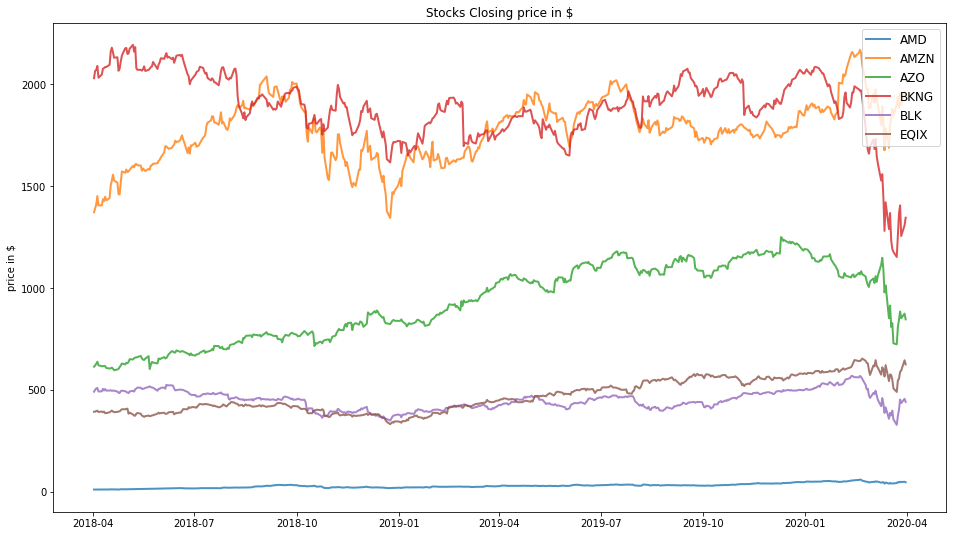

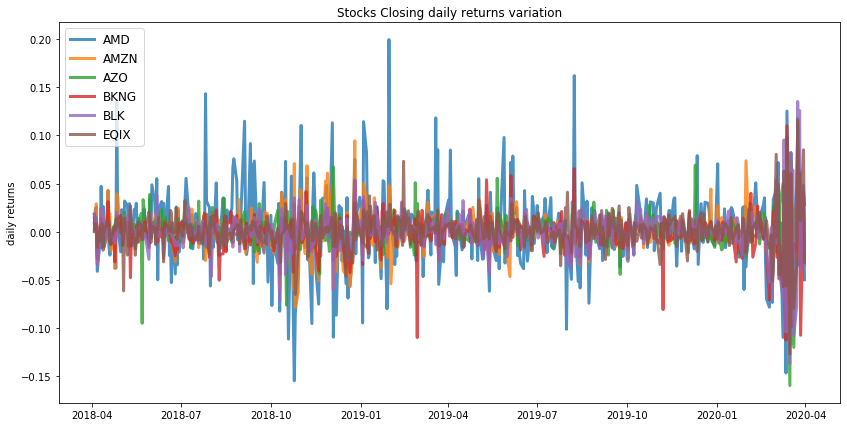

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.37
Annualised Volatility: 0.6


              AMD  AMZN   AZO  BKNG  BLK   EQIX
allocation  58.77   0.0  9.17   0.0  0.0  32.06
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.38
Annualised Volatility: 0.33


            AMD   AMZN    AZO  BKNG  BLK   EQIX
allocation  0.0  27.54  29.48  12.9  0.0  30.08


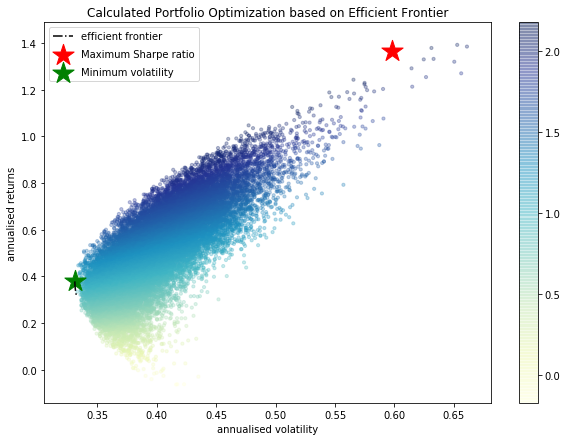

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
AMZN : annuaised return 0.46 , annualised volatility: 0.45
AZO : annuaised return 0.43 , annualised volatility: 0.45
BKNG : annuaised return -0.3 , annualised volatility: 0.47
BLK : annuaised return 0.01 , annualised volatility: 0.49
EQIX : annuaised return 0.56 , annualised volatility: 0.42
--------------------------------------------------------------------------------


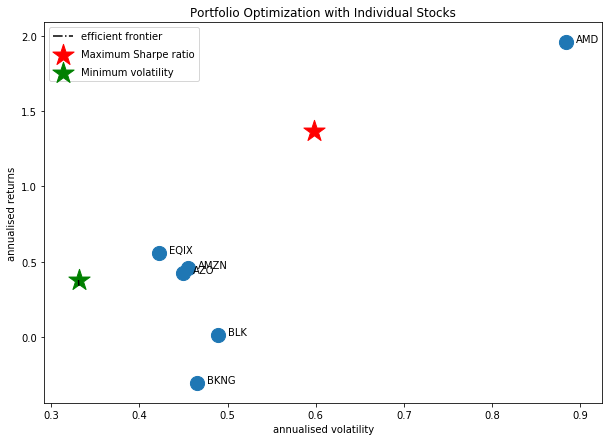

In [43]:
returns_sharpe_company_list = []
start_date = "2018-04-01"
end_date = "2020-04-01"
risk_free_rate = 0.0095
print("perform efficient_frontier_stock_portfolio Pairs of the companies we got {}".format(stock_portfolio_list))
pos_sharpe, Annualised_Return, Annualised_Volatility, allocation_weights = efficient_frontier_stock_portfolio(stock_portfolio_list, len(stock_portfolio_list), risk_free_rate, start_date, end_date)
returns_sharpe_company_list.append([pos_sharpe, Annualised_Return, Annualised_Volatility, stock_portfolio_list, allocation_weights])

In [44]:
shortlisted_portfolio_df = pd.DataFrame(returns_sharpe_company_list)

In [45]:
shortlisted_portfolio_df

,0,1,2,3,4
0,2.269009,1.37,0.6,"[AMD, AMZN, AZO, BKNG, BLK, EQIX]","[[58.77, 0.0, 9.17, 0.0, 0.0, 32.06]]"


In [46]:
shortlisted_portfolio_df.columns = ["Sharpe Ratio", "Portfolio Annualised Return", "Portfolio Annualised_Volatility", "Stock Portfolio", "Stocks Weight Allocation"]

In [47]:
# creating a blank series 
Portfolio_Tag = pd.Series([]) 

for row in range(len(shortlisted_portfolio_df)):
    if (shortlisted_portfolio_df["Sharpe Ratio"][row] >= 3):
        Portfolio_Tag[row] = "Excellent"
    elif (shortlisted_portfolio_df["Sharpe Ratio"][row] >= 2 and (shortlisted_portfolio_df["Sharpe Ratio"][row] < 3)):
        Portfolio_Tag[row] = "Very Good"
    elif ((shortlisted_portfolio_df["Sharpe Ratio"][row] >= 1)  and (shortlisted_portfolio_df["Sharpe Ratio"][row] < 2)):
        Portfolio_Tag[row] = "Good"
    else:
        Portfolio_Tag[row] = "Bad"
        
# inserting new column with values of list made above         
shortlisted_portfolio_df.insert(5, "Portfolio Tag", Portfolio_Tag) 

In [48]:
shortlisted_portfolio_df

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag
0,2.269009,1.37,0.6,"[AMD, AMZN, AZO, BKNG, BLK, EQIX]","[[58.77, 0.0, 9.17, 0.0, 0.0, 32.06]]",Very Good
